In [1]:
## Analysing BES f2f datasets


In [1]:
%%time
dataset_name = "W19_only"
df_list = []

%matplotlib inline 
%run f2f_header.py {dataset_name} {df_list}
# (var_type, cat_dictionary, new_old_col_names, old_new_col_names) = get_small_files(data_subfolder, encoding)    
# get full set of inferred "cross wave" auth-lib/left-right values and ages
# pan_dataset_allr_values = pd.read_pickle(BES_small_data_files + "pan_dataset_allr_valuesW19"+".zip",compression='zip')
# # pan_dataset_allr_values = pan_dataset_allr_values.loc[BES_Panel.index].sort_index()
# pan_dataset_ages = pd.read_pickle(BES_small_data_files + "pan_dataset_ages"+".zip", compression='zip')
# pan_dataset_votes = pd.read_pickle(BES_small_data_files+"pan_dataset_votes"+".zip",compression='zip')
# del BES_Panel

Toggle code

Wall time: 48.4 s


In [2]:
BES_df_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_df_list.pickle", "rb" ) )
f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')
BES_label_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_label_list.pickle", "rb" ) )

In [3]:
generic_cols = f2f_harmonised.columns

In [6]:
# generic_cols

In [4]:
def rep_char(x):
    return x.replace('[', '{').replace(']', '}').replace('<', '{').replace('>', '}')

def replace_var_names(labels):
    varname_replace_dict = {}
    replace_char_dict = {"[":"{","]":"}"}
    for col in df_simp.columns:
        if np.any([x in col for x in generic_cols]) or (col =="Age"):
            # 'age' is a problem as a common word component
            varname_replace_dict[col] = rep_char(col)
            
        elif "|" not in col:
            varname_replace_dict[col] = rep_char(labels[col])
        elif len(col.split("|"))==2:
            varname_replace_dict[col] = rep_char(labels[col.split("|")[0]])\
                +"("+ rep_char(col.split("|")[1]) +")"
        if varname_replace_dict[col]=="":
            varname_replace_dict[col] = rep_char(col)
    return varname_replace_dict

In [8]:
ge = "2019"
# df_simp = df_f2f[[
# #  'dataset',
# #  'uid',
#  'housing_det',
# #  'housing',
#  'inc',
# #  'vote',
# #  'year',
#  'wt',
#  'age',
# #  'vote_simple',
#  'bloc',
# #  'birth_year'
# ]][df_f2f["dataset"]==ge]

df_simp = f2f_harmonised[["housing_det","inc","wt","age","bloc"]][f2f_harmonised["dataset"]==ge]
df_simp = df_simp.replace("Neither",np.nan).dropna()
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)
# df_simp

[0]	validation_0-rmse:0.49820
[1]	validation_0-rmse:0.49658
[2]	validation_0-rmse:0.49589
[3]	validation_0-rmse:0.49534
[4]	validation_0-rmse:0.49420
[5]	validation_0-rmse:0.49365
[6]	validation_0-rmse:0.49262
[7]	validation_0-rmse:0.49164
[8]	validation_0-rmse:0.49116
[9]	validation_0-rmse:0.49016
[10]	validation_0-rmse:0.48983
[11]	validation_0-rmse:0.48955
[12]	validation_0-rmse:0.48873
[13]	validation_0-rmse:0.48803
[14]	validation_0-rmse:0.48747
[15]	validation_0-rmse:0.48731
[16]	validation_0-rmse:0.48684
[17]	validation_0-rmse:0.48651
[18]	validation_0-rmse:0.48621
[19]	validation_0-rmse:0.48591
[20]	validation_0-rmse:0.48572
[21]	validation_0-rmse:0.48557
[22]	validation_0-rmse:0.48534
[23]	validation_0-rmse:0.48519
[24]	validation_0-rmse:0.48506
[25]	validation_0-rmse:0.48493
[26]	validation_0-rmse:0.48479
[27]	validation_0-rmse:0.48476
[28]	validation_0-rmse:0.48476
[29]	validation_0-rmse:0.48469
[30]	validation_0-rmse:0.48454
[31]	validation_0-rmse:0.48438
[32]	validation_0-

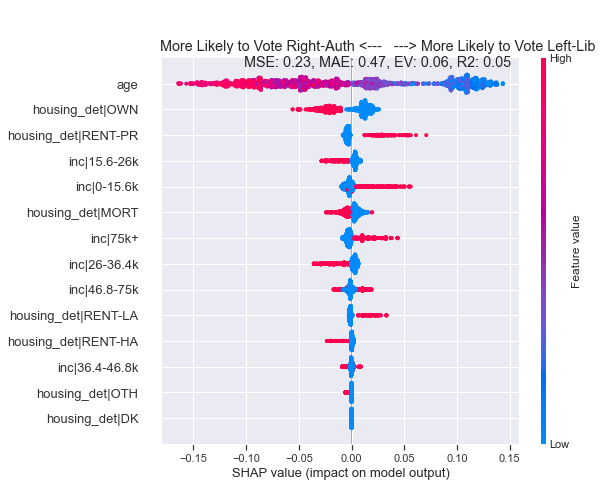

(<shap.explainers._tree.Tree at 0x1d45f869c88>,
 array([[ 1.3655375e-01,  0.0000000e+00, -7.2073946e-03, ...,
         -6.3881517e-04, -5.0314227e-03, -6.0913013e-04],
        [-8.0102980e-02,  0.0000000e+00,  7.9716812e-04, ...,
         -6.5637485e-04, -7.3418971e-03, -3.7192616e-03],
        [ 1.1681352e-01,  0.0000000e+00, -6.4288871e-04, ...,
         -1.8559741e-04,  1.5609808e-02, -1.2017145e-03],
        ...,
        [ 1.8122612e-02,  0.0000000e+00, -1.0957607e-02, ...,
          7.5401552e-04, -1.6237214e-03, -5.9434013e-03],
        [-1.4593433e-02,  0.0000000e+00,  6.3299304e-03, ...,
          7.0444326e-04,  4.3851283e-04, -3.0142569e-03],
        [ 1.0197673e-01,  0.0000000e+00, -4.3969974e-03, ...,
          1.0474032e-06, -3.2727066e-03,  9.9251429e-03]], dtype=float32),
 Index(['age', 'housing_det|DK', 'housing_det|MORT', 'housing_det|OTH',
        'housing_det|OWN', 'housing_det|RENT-HA', 'housing_det|RENT-LA',
        'housing_det|RENT-PR', 'inc|0-15.6k', 'inc|15.6-2

In [9]:
# %%time

var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
#             use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,30),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [10]:
f2f_harmonised["dataset"].unique()

array(['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992',
       '1987', '1983', '1979', '1974_feb', '1974_oct', '1970', '1966',
       '1964'], dtype=object)

2019
MSE: 0.23, MAE: 0.47, EV: 0.06, R2: 0.05


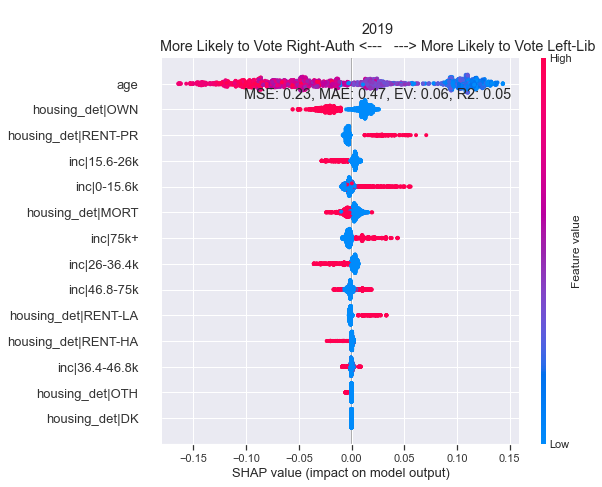

2017
MSE: 0.22, MAE: 0.44, EV: 0.10, R2: 0.10


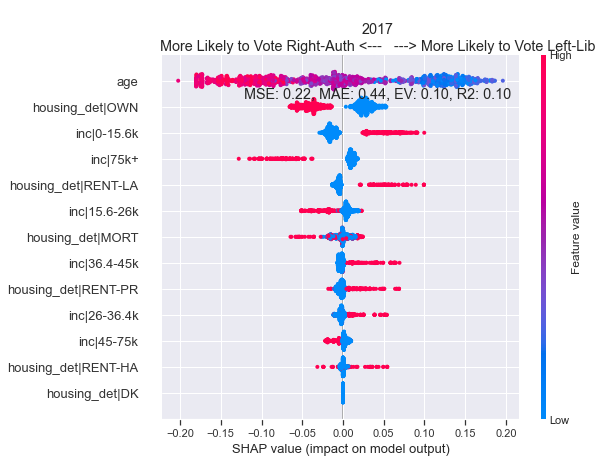

2015
MSE: 0.24, MAE: 0.49, EV: 0.03, R2: 0.02


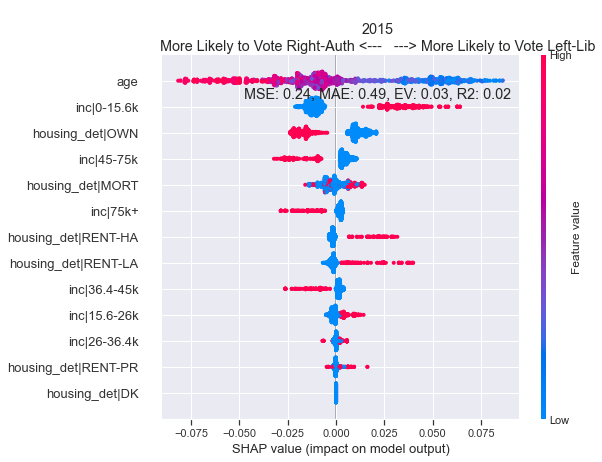

2010
MSE: 0.23, MAE: 0.46, EV: 0.04, R2: 0.04


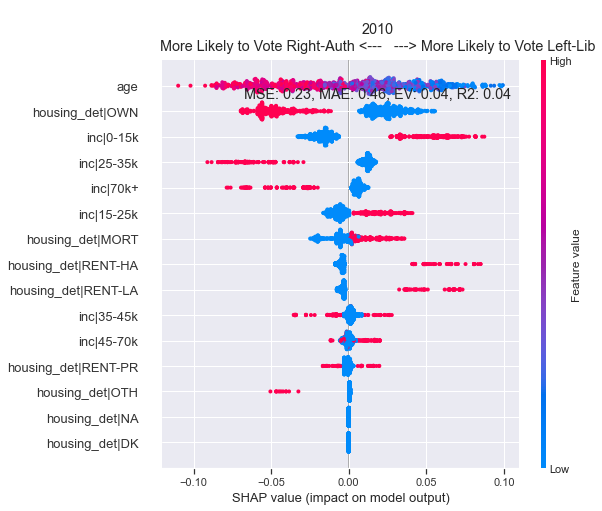

2005
MSE: 0.20, MAE: 0.40, EV: 0.06, R2: 0.06


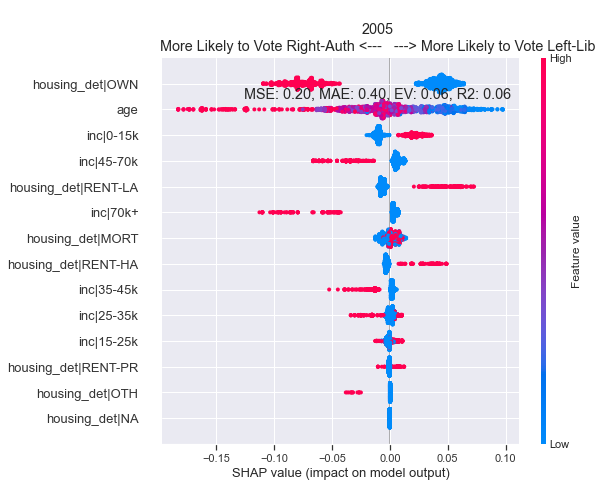

2001
MSE: 0.17, MAE: 0.35, EV: 0.04, R2: 0.04


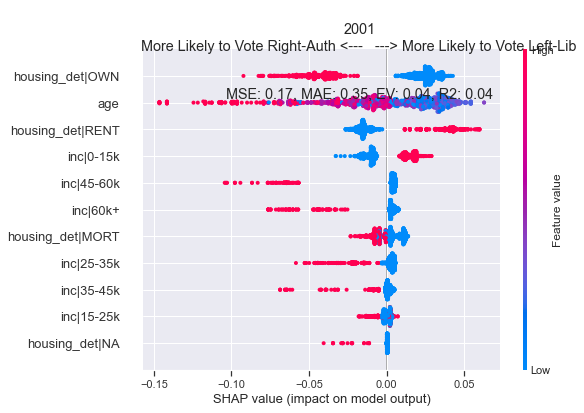

1997
MSE: 0.18, MAE: 0.38, EV: 0.06, R2: 0.06


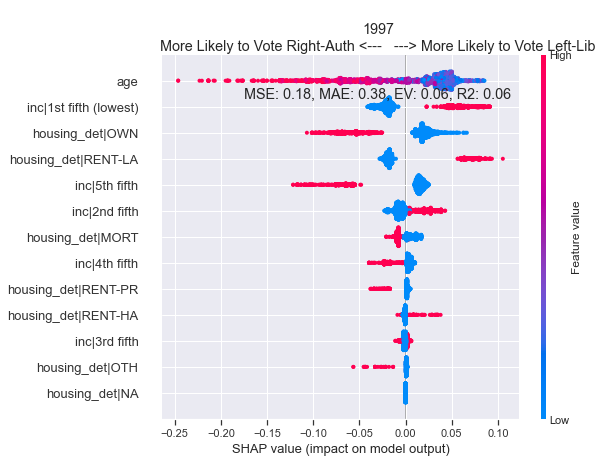

1992
MSE: 0.22, MAE: 0.45, EV: 0.09, R2: 0.09


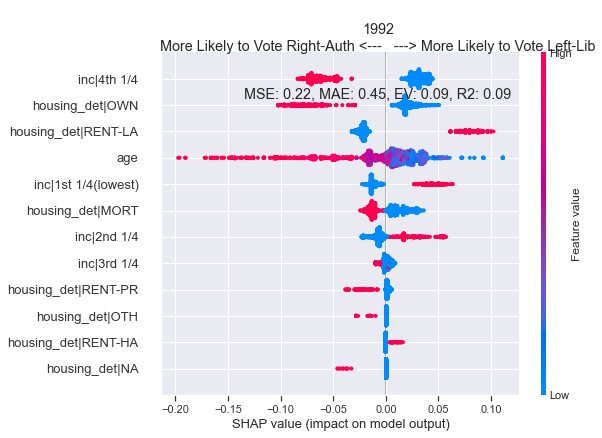

1987
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


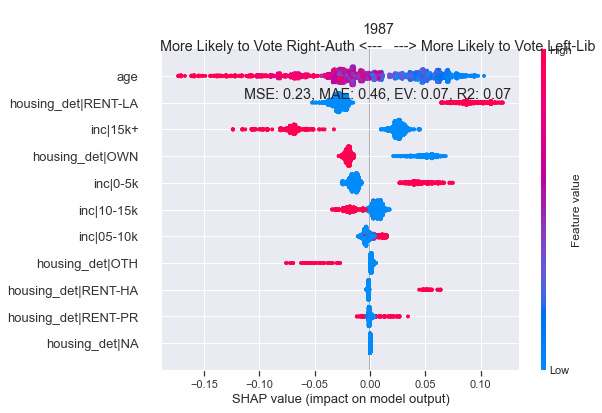

1983
MSE: 0.23, MAE: 0.46, EV: 0.08, R2: 0.08


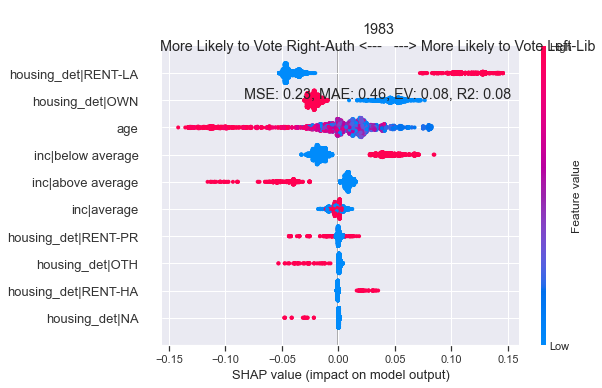

1979
MSE: 0.23, MAE: 0.47, EV: 0.06, R2: 0.06


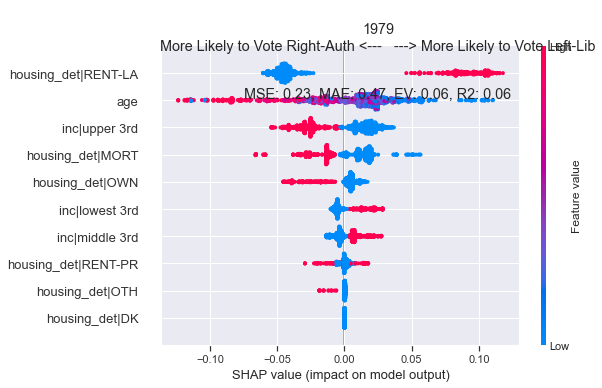

1974_feb
MSE: 0.21, MAE: 0.41, EV: 0.12, R2: 0.12


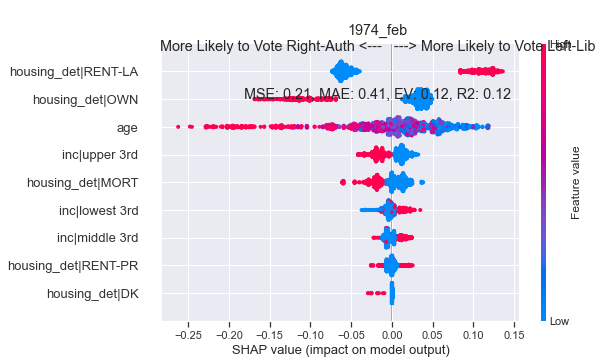

1974_oct
MSE: 0.22, MAE: 0.45, EV: 0.06, R2: 0.06


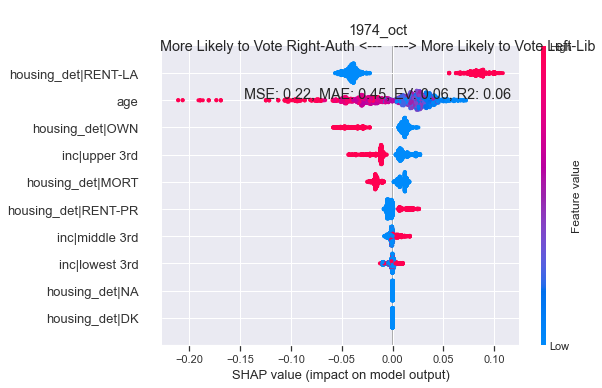

1970
MSE: 0.23, MAE: 0.48, EV: 0.05, R2: 0.05


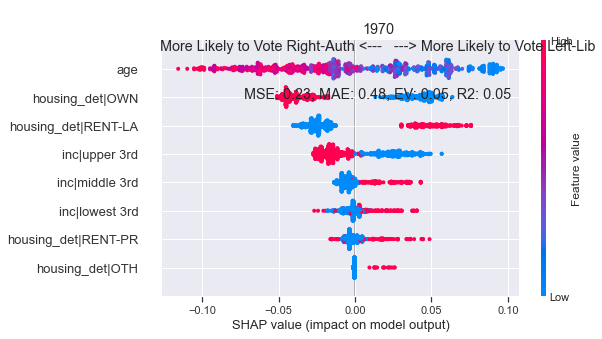

1966
MSE: 0.22, MAE: 0.44, EV: 0.05, R2: 0.05


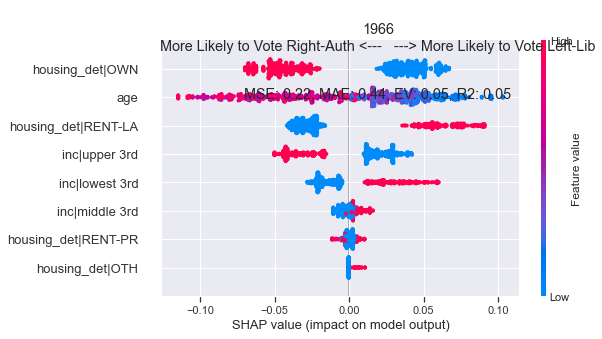

1964
MSE: 0.22, MAE: 0.44, EV: 0.08, R2: 0.08


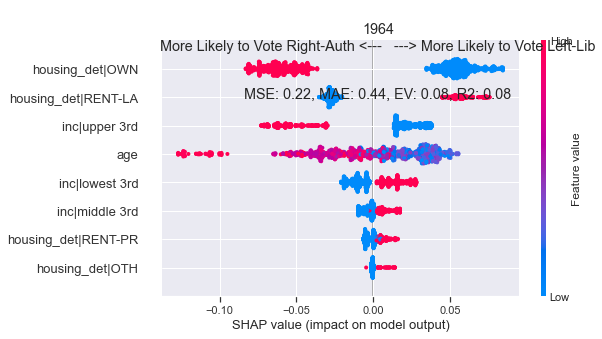

In [11]:


# ge = "2019"
for ge in f2f_harmonised["dataset"].unique():
    print(ge)
    df_simp = f2f_harmonised[[
     'housing_det',
     'inc',
     'wt',
     'age',
     'bloc',
    ]][f2f_harmonised["dataset"]==ge]
    df_simp = df_simp.replace("Neither",np.nan).dropna()
    df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)


    var_stub = "bloc|Left-Lib"
    Treatment = var_stub+"_"+ge

    var_list = [var_stub]
    var_stub_list = [var_stub,]
    df_simp = df_simp.astype('float')
    mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
    colname = var_stub
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
                var_list=var_list,var_stub_list=var_stub_list,
    #             use_specific_weights=df_simp["wt"][mask],
                min_features = min(df_simp.shape[1]-1,30),
                title = "\n"+ge+"\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib\n\n", verbosity=0)    

In [12]:
fn = "E:\\BES_analysis_data\\Face_to_face\\74_february\\74feb.dta"
BES_Panel_74_feb = pd.read_stata(fn)

data = pd.read_stata(fn, iterator = True)
labels_74_feb = data.variable_labels()

In [13]:
# f2f_harmonised["dataset"].value_counts()

In [14]:
# len([x for x in df_f2f.columns if "1974_feb|" in x])

In [15]:
# [x for x in df_f2f.columns if "bloc" in x]
# f2f_harmonised,BES_df_list


In [16]:
ge = "1974_feb"
# BES_df_list[ge]
f2f_harmonised[f2f_harmonised["dataset"]==ge]

,dataset,uid,housing_det,housing,inc,vote,year,wt,age,vote_simple,bloc,birth_year
0,1974_feb,1974_feb|0,RENT-LA,RENT,middle 3rd,DNV,1974,1.0,43.0,DNV,Neither,1931.0
1,1974_feb,1974_feb|1,RENT-LA,RENT,lowest 3rd,LAB,1974,1.0,72.0,LAB,Left-Lib,1902.0
2,1974_feb,1974_feb|2,RENT-LA,RENT,upper 3rd,SNP,1974,1.0,24.0,SNP,Left-Lib,1950.0
3,1974_feb,1974_feb|3,RENT-LA,RENT,lowest 3rd,DK,1974,1.0,87.0,DK,Neither,1887.0
4,1974_feb,1974_feb|4,RENT-LA,RENT,lowest 3rd,CON,1974,1.0,76.0,CON,Right-Auth,1898.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2457,1974_feb,1974_feb|2457,RENT-PR,RENT,middle 3rd,LAB,1974,1.0,27.0,LAB,Left-Lib,1947.0
2458,1974_feb,1974_feb|2458,RENT-PR,RENT,upper 3rd,LAB,1974,1.0,51.0,LAB,Left-Lib,1923.0
2459,1974_feb,1974_feb|2459,RENT-PR,RENT,upper 3rd,CON,1974,1.0,35.0,CON,Right-Auth,1939.0
2460,1974_feb,1974_feb|2460,RENT-PR,RENT,lowest 3rd,LAB,1974,1.0,26.0,LAB,Left-Lib,1948.0


In [17]:
df_1974feb = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][["vote","vote_simple","bloc","wt","age","housing_det","inc"]]
                       ],axis=1)

In [18]:
party_spec_pattern = "(conservative|conservatives|cons |con |lab |labour|lib |liberal|heath|wilson|thorpe|powell)"
party_specific_by_labels = [x for x in labels_74_feb.keys() if re.search(party_spec_pattern,labels_74_feb[x])]
party_specific = [x.split("_")[0] for x in pd.get_dummies(df_1974feb).columns if re.search(party_spec_pattern,x)]
drop_vars = [x for x in ["feb115",# vote variable
                                     "feb129","feb276","feb277","feb114","feb116","feb117","feb119","feb131","feb132","feb133","feb134",
                                     "feb111","feb112","feb122","feb140","feb141","feb135","feb136","feb290","feb297","feb120","feb121",
                                     ]+party_specific+party_specific_by_labels]


In [19]:
ge = "1974_feb"
# df_1974feb["bloc"]=df_1974feb["bloc"].replace("Neither",np.nan)
# df_1974feb = df_1974feb.replace("Neither",np.nan).dropna()
df_simp = df_1974feb.copy()
df_simp = df_simp.drop(["vote","vote_simple",
                       ]+drop_vars,axis=1)
df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep="|").drop("bloc|Right-Auth",axis=1)
# df_simp

In [20]:
# generic_cols

In [21]:
df_simp = df_simp.rename(columns = replace_var_names(labels_74_feb))    

In [22]:
# [(x,varname_replace_dict[x]) for x in varname_replace_dict.keys() if varname_replace_dict[x]==""]

In [23]:
# pd.Series( df_simp.columns ).value_counts()

[0]	validation_0-rmse:0.49385
[1]	validation_0-rmse:0.48898
[2]	validation_0-rmse:0.48525
[3]	validation_0-rmse:0.48120
[4]	validation_0-rmse:0.47718
[5]	validation_0-rmse:0.47328
[6]	validation_0-rmse:0.46941
[7]	validation_0-rmse:0.46673
[8]	validation_0-rmse:0.46338
[9]	validation_0-rmse:0.46031
[10]	validation_0-rmse:0.45781
[11]	validation_0-rmse:0.45586
[12]	validation_0-rmse:0.45357
[13]	validation_0-rmse:0.45080
[14]	validation_0-rmse:0.44904
[15]	validation_0-rmse:0.44709
[16]	validation_0-rmse:0.44502
[17]	validation_0-rmse:0.44357
[18]	validation_0-rmse:0.44195
[19]	validation_0-rmse:0.44019
[20]	validation_0-rmse:0.43831
[21]	validation_0-rmse:0.43661
[22]	validation_0-rmse:0.43535
[23]	validation_0-rmse:0.43400
[24]	validation_0-rmse:0.43241
[25]	validation_0-rmse:0.43073
[26]	validation_0-rmse:0.42907
[27]	validation_0-rmse:0.42774
[28]	validation_0-rmse:0.42678
[29]	validation_0-rmse:0.42555
[30]	validation_0-rmse:0.42444
[31]	validation_0-rmse:0.42413
[32]	validation_0-

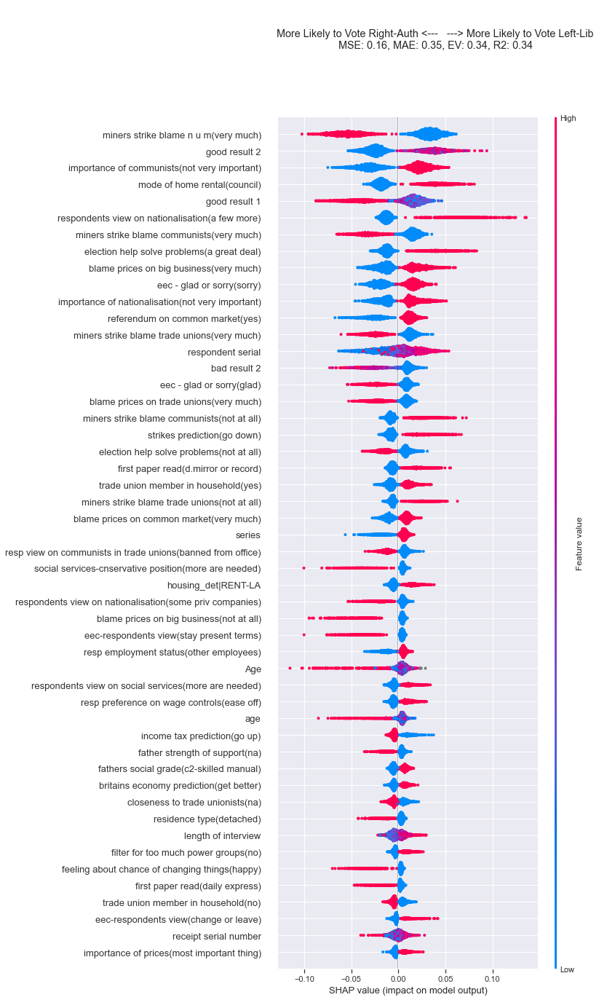

In [24]:
# %%time
ge = "1974_feb"

var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
#             use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [25]:
# mode of home rental, income tax prediction,trade union member in household,residence type,mode of home ownership,home owned or rented

# feb188,feb098,feb170,feb189,feb215


In [26]:
# demographic variables


# feb071 # region
# FE8145 # constituency code

# FEB183-FEB195 # starts on education, all demographic, finishes with vocational training
# PE6196-FEB215 # more demographic
# FEB245-FEB248 # which trade union
# FEB249-FEB274 # more demographics!

In [27]:
# [("feb"+x,labels_74_feb["feb"+x]) for x in ([str(x) for x in (list(range(183,196))+list(range(196,216))+list(range(245,249))+list(range(249,274)))]+["071"])]
demo_vars = ["feb"+x for x in ([str(x) for x in (list(range(183,196))+list(range(196,216))+list(range(245,249))+list(range(249,274)))]+["071"])]

In [28]:
ge = "1974_feb"
df_simp = df_1974feb[demo_vars+["bloc","wt","age","housing_det","inc"]].copy()
df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

In [29]:
varname_replace_dict = {}
for col in df_simp.columns:
    if "_" not in col or "bloc" in col or "housing_det" in col or "inc_" in col:
        varname_replace_dict[col] = col
    elif len(col.split("|"))==1:
        varname_replace_dict[col] = labels_74_feb[col]
    elif len(col.split("|"))==2:
        varname_replace_dict[col] = labels_74_feb[col.split("|")[0]]+"("+ col.split("|")[1] +")"
df_simp = df_simp.rename(columns = varname_replace_dict)    

In [30]:
# varname_replace_dict["housing_det_MORT"]

In [31]:

# pd.Series(df_1974feb.columns).value_counts()

In [32]:
# pd.Series(df_simp.columns).value_counts()

[0]	validation_0-rmse:0.49748
[1]	validation_0-rmse:0.49448
[2]	validation_0-rmse:0.49213
[3]	validation_0-rmse:0.48990
[4]	validation_0-rmse:0.48812
[5]	validation_0-rmse:0.48709
[6]	validation_0-rmse:0.48551
[7]	validation_0-rmse:0.48438
[8]	validation_0-rmse:0.48351
[9]	validation_0-rmse:0.48250
[10]	validation_0-rmse:0.48175
[11]	validation_0-rmse:0.48050
[12]	validation_0-rmse:0.47941
[13]	validation_0-rmse:0.47828
[14]	validation_0-rmse:0.47729
[15]	validation_0-rmse:0.47633
[16]	validation_0-rmse:0.47563
[17]	validation_0-rmse:0.47506
[18]	validation_0-rmse:0.47449
[19]	validation_0-rmse:0.47394
[20]	validation_0-rmse:0.47359
[21]	validation_0-rmse:0.47297
[22]	validation_0-rmse:0.47292
[23]	validation_0-rmse:0.47290
[24]	validation_0-rmse:0.47274
[25]	validation_0-rmse:0.47263
[26]	validation_0-rmse:0.47215
[27]	validation_0-rmse:0.47187
[28]	validation_0-rmse:0.47139
[29]	validation_0-rmse:0.47106
[30]	validation_0-rmse:0.47093
[31]	validation_0-rmse:0.47101
[32]	validation_0-

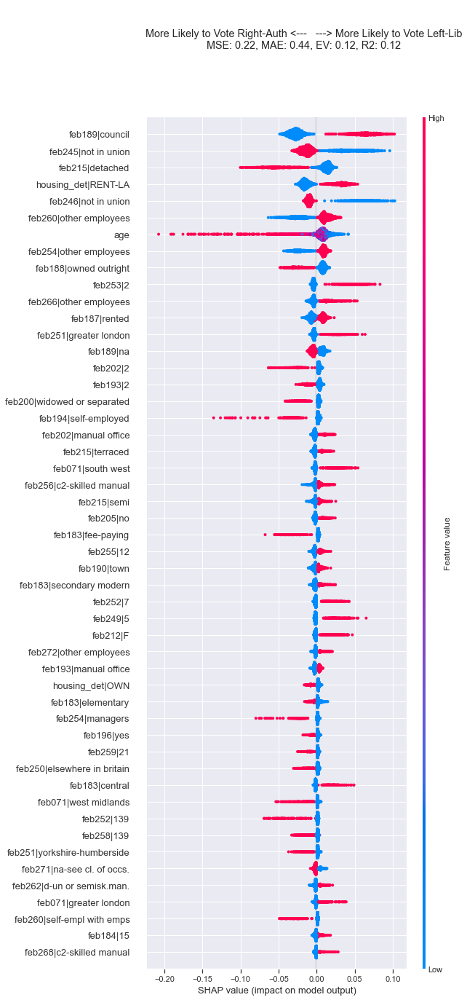

In [33]:
# %%time
ge = "1974_feb"

var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
#             use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [34]:
# %debug

In [35]:
# n_top_features = 50
# global_shap_vals = np.abs(shap_values).mean(0)
# inds = np.argsort(global_shap_vals)[-n_top_features:]
# top_predictors = [x.split("|")[1].split("_")[0] for x in train_columns[inds][::-1]]

# for pred in top_predictors:
#     if pred=="Age" or pred=="index":
#         continue
#     print(pred,labels_74_feb[pred])

In [36]:
## same again with 74_oct

In [37]:
# fn = "E:\\BES_analysis_data\\Face_to_face\\74_october\\74oct.dta"
# BES_Panel_74_oct = pd.read_stata(fn)

# data = pd.read_stata(fn, iterator = True)
# labels_74_oct = data.variable_labels()
labels_74_oct = BES_label_list["1974_oct"]

In [38]:
pd.Series(labels_74_oct).sort_index()[162:183].index



# list(range(245,268))

Index(['oct245', 'oct246', 'oct247', 'oct248', 'oct249', 'oct250', 'oct251',
       'oct252', 'oct254', 'oct255', 'oct256', 'oct257', 'oct258', 'oct260',
       'oct261', 'oct262', 'oct263', 'oct264', 'oct266', 'oct267', 'oct268'],
      dtype='object')

In [39]:
ge = "1974_oct"
list( BES_label_list[ge].keys() )[150:199]

['oct124a',
 'oct125',
 'oct127',
 'oct128',
 'oct129',
 'oct130',
 'oct131',
 'oct132',
 'oct133',
 'oct134',
 'oct135',
 'oct136',
 'oct137',
 'oct138',
 'oct139',
 'oct477',
 'oct478',
 'oct479',
 'oct480',
 'oct481',
 'oct482',
 'oct140',
 'oct141',
 'oct142',
 'oct143',
 'oct144',
 'oct147',
 'oct148',
 'oct149',
 'oct150',
 'oct150a',
 'oct483',
 'oct484',
 'oct485',
 'oct486',
 'oct487',
 'oct488',
 'oct489',
 'oct490',
 'oct491',
 'oct174',
 'oct243',
 'oct244',
 'oct154a',
 'oct154',
 'oct492',
 'oct156a',
 'oct156',
 'oct493']

In [40]:
demo_vars = ["oct"+x for x in ([str(x) for x in (list(range(183,215))+list(range(245,268)))]+["071"])]

In [41]:
# df_1974oct = df_f2f[[x for x in df_f2f.columns if "1974_oct|" in x]+["vote","vote_simple","bloc","wt","age","housing_det","inc"]][df_f2f["dataset"]=="1974_oct"].copy()
ge = "1974_oct"
df_1974oct = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][["vote","vote_simple","bloc","wt","age","housing_det","inc"]]
                       ],axis=1)

In [42]:
ge = "1974_oct"
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df_1974oct.columns))

df_simp = df_1974oct[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)


In [43]:
# varname_replace_dict = {}
# for col in df_simp.columns:
#     if "_" not in col or "bloc" in col or "housing_det" in col or "inc_" in col:
#         varname_replace_dict[col] = col
#     elif len(col.split("_"))==2:
#         varname_replace_dict[col] = labels_74_oct[col.split("|")[1]]
#     elif len(col.split("_"))==3:
#         varname_replace_dict[col] = labels_74_oct[col.split("|")[1].split("_")[0]]+"("+ col.split("|")[1].split("_")[1] +")"
        

In [44]:
# df_simp = df_simp.rename(columns = varname_replace_dict)

df_simp = df_simp.rename(columns = replace_var_names(labels_74_oct))  

[0]	validation_0-rmse:0.49760
[1]	validation_0-rmse:0.49524
[2]	validation_0-rmse:0.49266
[3]	validation_0-rmse:0.49019
[4]	validation_0-rmse:0.48807
[5]	validation_0-rmse:0.48539
[6]	validation_0-rmse:0.48320
[7]	validation_0-rmse:0.48173
[8]	validation_0-rmse:0.48028
[9]	validation_0-rmse:0.47924
[10]	validation_0-rmse:0.47771
[11]	validation_0-rmse:0.47661
[12]	validation_0-rmse:0.47538
[13]	validation_0-rmse:0.47409
[14]	validation_0-rmse:0.47314
[15]	validation_0-rmse:0.47274
[16]	validation_0-rmse:0.47176
[17]	validation_0-rmse:0.47091
[18]	validation_0-rmse:0.47043
[19]	validation_0-rmse:0.46945
[20]	validation_0-rmse:0.46883
[21]	validation_0-rmse:0.46836
[22]	validation_0-rmse:0.46787
[23]	validation_0-rmse:0.46710
[24]	validation_0-rmse:0.46658
[25]	validation_0-rmse:0.46606
[26]	validation_0-rmse:0.46528
[27]	validation_0-rmse:0.46473
[28]	validation_0-rmse:0.46445
[29]	validation_0-rmse:0.46424
[30]	validation_0-rmse:0.46400
[31]	validation_0-rmse:0.46364
[32]	validation_0-

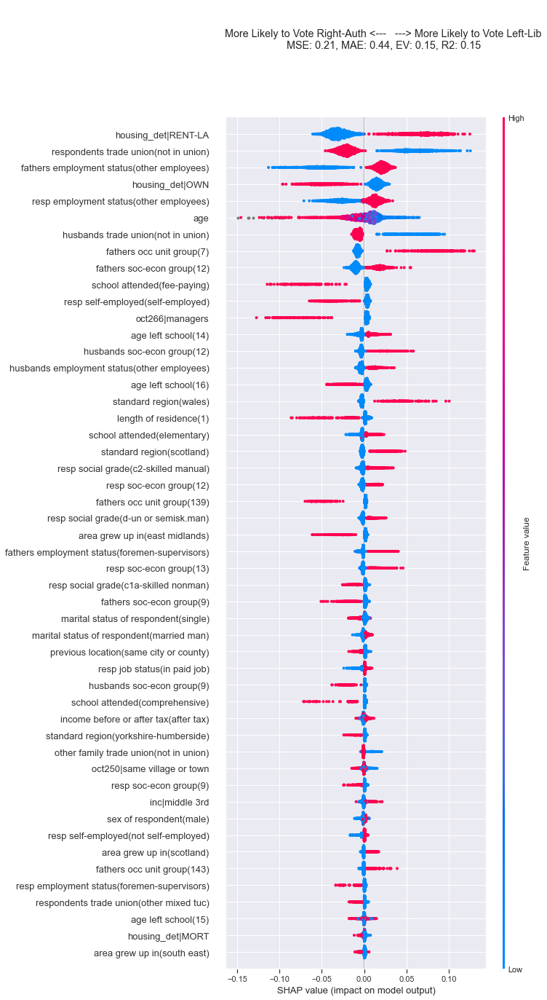

In [45]:
# %%time
ge = "1974_oct"

var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
#             use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [46]:
# search(df_simp,"age")

In [47]:
# search(df_simp,"age")

In [48]:
## maybe ordinal??
# oct249_49': 'length of residence(49)'
# oct264_213': 'husbands occ unit group(213)'
# oct255_10': 'fathers soc-econ group(10)'
# oct258_199': 'resp occ unit group(199)',
# oct261_10': 'resp soc-econ group(10)',
# oct191_1948': 'year of birth(1948)',
# oct267_9': 'husbands soc-econ group(9)',
# oct252_212': 'fathers occ unit group(212)',

# '1974_oct|oct212_7': 'family income(7)',
#  '1974_oct|oct212_8': 'family income(8)',
#  '1974_oct|oct212_A': 'family income(A)',

In [49]:
# n_top_features = 50
# global_shap_vals = np.abs(shap_values).mean(0)
# inds = np.argsort(global_shap_vals)[-n_top_features:]
# top_predictors = [x.split("|")[1].split("_")[0] for x in train_columns[inds][::-1]]

# for pred in top_predictors:
#     if pred=="Age" or pred=="index":
#         continue
#     print(pred,labels_74_oct[pred])

In [50]:
# f2f_harmonised = df_f2f[[x for x in df_f2f.columns if "|" not in x]].copy()
# f2f_harmonised.to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')

In [51]:
# del df_f2f

In [52]:
# 1979

# # tu member
# 'm245190': 'r member of trade union q61',
# # religion
# 'm495234': "r's church or religious group-q82",
# 'm000235': 'how often r attends place of worship-q83',
# 'm497236': 'r brought up as practising religion-q84',
# # education
# 'm000237': 'exam to enter last school attended:-q86a',
# 'm000238': 'tuition fees charged at school:-q86b',
# 'm184239': 'age left school-q87',
# 'm000240': 'did r have further educatn or traing-q88',
# 'm000241': 'age r completed full-time education-q90',
# 'm000242': 'rsa or city & guilds-q91',
# 'm000243': 'cse-q91',
# 'm000244': 'o levels or scot lower-q91',
# 'm000245': 'school certificate or matric-q91',
# 'm000246': 'a levels or scot higher-q91',
# 'm000247': "teachers' training qual-q91",
# 'm000248': 'degree-q91',
# 'm000249': 'professional qualification-q91',
# 'm000250': 'apprenticeship-q91',
# 'm000251': 'special qual. gained at work-q91',
# 'm000252': 'other qualification-q91',
# # work status (+ marital status!)
# 'm192253': 'does r have job,retired,unemplyd etc-q92',
# 'm000254': 'does r work full- or part-time-q93a',
# 'm000255': 'if part-time:n of hours per week-q93b',
# 'm194256': 'r self-employed or by someone else-q94a',
# 'm000257': 'if s.employed:does r have employees-q94b',
# 'm000258': "n of r's employees-q94c",
# 'm194a259': 'sort of firm or orgzn r works for-q95a',
# 'm000260': 'is r a supervisor-q95b',
# 'm194b261': 'n persons employed where r works-q96d',
# 'm200262': "r's marital status-q97",
# 'm201263': "does r's spouse have job,retired etc-q98",
# 'm000264': 'spouse works full- or part-time-q99a',
# 'm000265': 'if spouse p-time:no hours per week-q99b',
# 'm203266': 'spouse self-emplyd or not-q100a',
# 'm000267': "if s'empyld:has spouse employees-q100b",
# 'm000268': "n of spouse's employees-q100c",
# 'm203a269': 'sort of firm or ogn spse works for-q101a',
# 'm000270': 'is spouse a supervisor-q101b',
# 'm203b271': 'n employed where spouse works-q102d',
# # children
# 'm498272': 'does r have children-q103a',
# 'm499273': 'how many children does r have-q103b',
# 'm500274': "are any of r's children under 18-q103c",    
# # economic amenities
# 'm000275': 'has r a private telephone-q104a',
# 'm000276': "has anyone in r's hh a car or van-q104b",
# 'm000277': 'is r in private medical scheme-q104c',
# 'm000278': 'does r pay for help to clean house-q104d',
# # age
# 'm191279': 'in what year r born-q105',
# # housing
# 'm187a280': "r's home owned or rented-q106a",
# 'm187a281': 'if owned:outright or mortgage-q106b',
# 'm187a282': 'if rented:from council or private-q106c',
# 'm249283': 'how long lived in area:decimal years',
# 'm212284': "r's income or if married:both incs-q109",
# 'm215285': 'type of house r lives in-q110a',
# 'm000286': 'if flat or tenement:n of floors-q110b',
# 'm000287': 'is r living in parents home-q110c',
# # gender
# 'm199288': 'sex-q111',
# # ... more work status variables? / socioeconomic grade
# 'm260292': "r's employment status",
# 'm258293': "r's occupational unit -see rg class.",
# 'm261294': "r's socio-economic group",
# 'm262295': "r's social grade",
# 'm266296': 'spouses employment status',
# 'm264297': "sp's occupational unit-see rg class.",
# 'm267298': 'spouses socio-economic group',
# 'm268299': 'spouses social grade',
# # region
# 'm071300': 'standard region',
# # more trade unions details
# 'm000301': 'n of trade union members in household',
#     ## whole bunch of specifics about who they are/which union!
# # father's employment status/seg
# 'm254310': "father's employment status",
# 'm252311': "father's occupational unit group",
# 'm255312': "father's socio-economic group",
# 'm256313': "father's social grade",    
# # school/fe types
# 'm183314': 'school attended',
# 'm185a315': 'further education and type',
# # area grew up in (region not city/town!)
# 'm251316': 'area grew up in',
# # ethnicity
# 'm000317': 'ethnic origin',

In [53]:
pfix_dict = {x[-3:]:x for x in BES_label_list["1979"].keys()}
demo_vars = [190]+list(range(234,288))+list(range(292,301))+list(range(310,317))
demo_vars = [pfix_dict[str(x)] for x in demo_vars]

In [54]:
ge = "1979"
labels_79 = BES_label_list[ge]
df_1979 = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][["vote","vote_simple","bloc","wt","age","housing_det","inc"]]
                       ],axis=1)

demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df_1979.columns))

df_simp = df_1979[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels_79))  

[0]	validation_0-rmse:0.49702
[1]	validation_0-rmse:0.49481
[2]	validation_0-rmse:0.49298
[3]	validation_0-rmse:0.49126
[4]	validation_0-rmse:0.48963
[5]	validation_0-rmse:0.48793
[6]	validation_0-rmse:0.48660
[7]	validation_0-rmse:0.48538
[8]	validation_0-rmse:0.48417
[9]	validation_0-rmse:0.48295
[10]	validation_0-rmse:0.48206
[11]	validation_0-rmse:0.48138
[12]	validation_0-rmse:0.48045
[13]	validation_0-rmse:0.47926
[14]	validation_0-rmse:0.47874
[15]	validation_0-rmse:0.47763
[16]	validation_0-rmse:0.47678
[17]	validation_0-rmse:0.47610
[18]	validation_0-rmse:0.47560
[19]	validation_0-rmse:0.47500
[20]	validation_0-rmse:0.47418
[21]	validation_0-rmse:0.47343
[22]	validation_0-rmse:0.47326
[23]	validation_0-rmse:0.47298
[24]	validation_0-rmse:0.47262
[25]	validation_0-rmse:0.47231
[26]	validation_0-rmse:0.47189
[27]	validation_0-rmse:0.47169
[28]	validation_0-rmse:0.47163
[29]	validation_0-rmse:0.47143
[30]	validation_0-rmse:0.47164
[31]	validation_0-rmse:0.47135
[32]	validation_0-

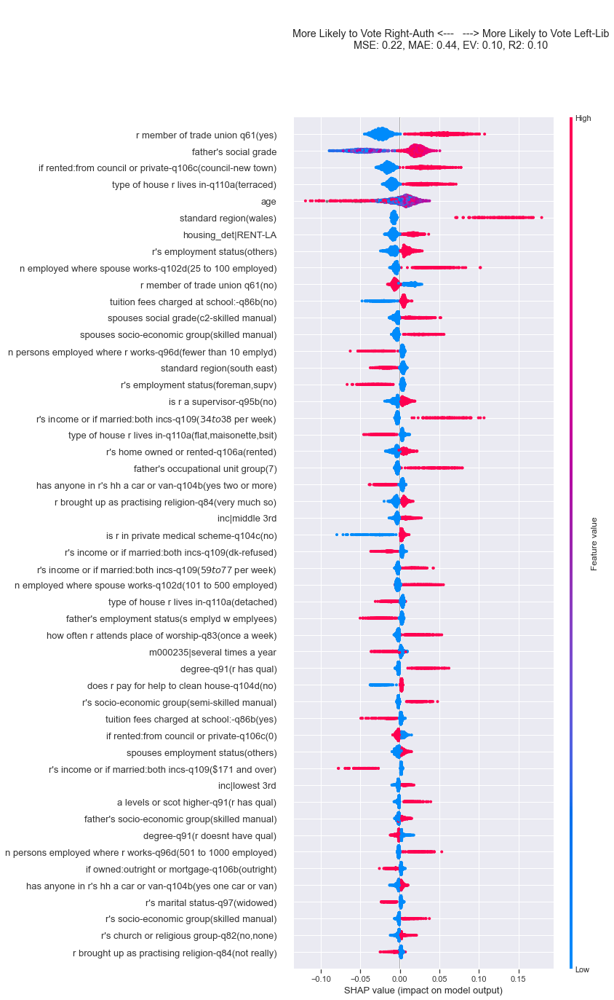

In [55]:
# %%time
ge = "1979"

var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [56]:
### 1983 demographic variables

# pol specific terms: thatcher|foot|jenkins|steel

demo_vars = []

# goldthorpe class! 
# 'fglclass': "father's goldthorpe-llewellyn class",
# 'rglclass': "respondent's goldthorpe-llewellyn class",
# 'sglclass': "spouse's goldthorpe-llewellyn class",
# 'fghclass': "father's goldthorpe-heath class",
# 'rghclass': "respondent's goldthorpe-heath class",
# 'sghclass': "spouse's goldthorpe-heath class",
demo_vars += ['fglclass','rglclass','sglclass','fghclass','rghclass','sghclass']

# fathers job/employ stat/seg
# 'q48': "no details father's job",
# 'q48a1': "father's occup group [1980 scheme]",
# 'q48a2': "father's employment status",
# 'q48a3': "father's socio-econ grp [1980 scheme]",
# 'q48a4': "father's social class [1980 scheme]",
# 'q48a5': 'father: manual,non-manual [1980 scheme]',
# 'q48a6': "father's occup grp [1970 scheme]",
# 'q48a7': "father's socio-econ grp [1970 scheme]",
# 'q48a8': "father's social class [1970 scheme]",
# 'q48a9': 'father: manual,non-manual [1970 scheme]',
# 'q48f': 'father: industry class',
# 'q48d': 'number of people father supervised',
# 'q48e': 'father an employee or self employed',
# 'q48g': 'number of employees fathers workplace',
demo_vars += ['q48','q48a1','q48a2','q48a3','q48a4','q48a5','q48a6','q48a7','q48a8','q48a9','q48f','q48d','q48e','q48g',]

# only inc variables this wave ... but quite subjective!
# 'q50a': 'thinks hhold income above,below average',
# 'q50b': 'hhold income gt-lt prices, last year',
# 'q50c': 'hhold income gt-lt prices, next year',
demo_vars += ['q50a']
#               [,'q50b','q50c',]
    
# economic amenities
# 'q51a': 'number cars, vans household owns, uses',
# 'q51b': 'household has private health insurance',
demo_vars += ['q51a','q51b']

# respondent job/employ stat/seg / trade union memb
# 'q52a': "r's economic activity past week",
# 'q52b': "[if no work nor ft ed] when r's last job",
# 'q52c': '[if ever worked] r member of trade union',
# 'q53a1': '[if ever wrkd] r occup grp [1980 scheme]',
# 'q53a2': '[if ever wrkd] r employment status',
# 'q53a3': '[if ever wrkd] r socio-econ group [1980]',
# 'q53a4': "[if ever wrkd] r's social class [1980]",
# 'q53a5': '[if ever wrkd] r manual,non-man [1980]',
# 'q53a6': '[if ever wrkd] r occup grp [1970 scheme]',
# 'q53a7': '[if ever wrkd] r socio-econ group [1970]',
# 'q53a8': "[if ever wrkd]r's social class [1970]",
# 'q53a9': '[if ever wrkd]r manual,non-man [1970]',
# 'q53g': "[if ever worked] r's industry class",
# 'q53d': '[if ever worked] number r supervises',
# 'q53e': '[if ever wrkd] r employee or self empld',
# 'q53f': '[if r employee] private firm or not',
# 'q53h': '[if ever wrkd] no employees r workplace',
# 'q53i': "[if ever wrkd] r's job full or part time",
demo_vars += ['q52a','q52b','q52c','q53a1','q53a1','q53a2','q53a3','q53a4','q53a5','q53a6','q53a7','q53a8','q53a9','q53g','q53d',
 'q53e','q53f','q53h','q53i',]

# spouse job/employ stat/seg 
# 'q54a': "respondent's marital status",
# 'q54b': '[if married] spouse ecn actvty past week',
# 'q54c': '[if no wrk nor ft ed] when spse last job',
# 'q54d': '[if ever wrkd] spouse member tu',
# 'q55a1': '[if ever wrkd] spouse occup grp [1980]',
# 'q55a2': '[if ever wrkd] spouse emplyt status',
# 'q55a3': '[if ever wrkd] spouse soc-ecn grp [1980]',
# 'q55a4': "[if ever wrkd] spouse's soc class [1980]",
# 'q55a5': '[if ever wrkd] spouse man,non-man [1980]',
# 'q55a6': '[if ever wrkd] spouse occup grp [1970]',
# 'q55a7': '[if ever wrkd] spouse soc-ecn grp [1970]',
# 'q55a8': "[if ever wrkd]spouse's soc class [1970]",
# 'q55a9': '[if ever wrkd]spouse man,non-man [1970]',
# 'q55g': "[if ever wrkd] spouse's industry class",
# 'q55d': '[if ever wrkd] number spouse supervises',
# 'q55e': '[if ever wrkd] spouse emplee or self emp',
# 'q55f': '[if spouse employee] private firm or not',
# 'q55h': '[if ever wrkd] no emplees spouse wrkplce',
# 'q55i': '[if ever wrkd] spouse job full,part time',
demo_vars += ['q54a','q54b','q54c','q54d','q55a1','q55a2','q55a3','q55a4','q55a5','q55a6','q55a7','q55a8','q55a9','q55g','q55d',
              'q55e','q55f','q55h','q55i',]
    
# age (indirect)
# 'q56': "respondent's age last birthday",
demo_vars += ['q56']

# respondent unemployment history
# 'q57ab': '[if r undr 70,etc] freq unemp 13wk 78-83',
# 'q57c': '[if r unempl 1978-83] number of months',
demo_vars += ['q57ab','q57c',]
    
# resp/spouse benefits access
# 'q58a': 'resp,spouse rcvd child benefit',
# 'q58b': 'resp,spouse rcvd maternity benefit',
# 'q58c': 'resp,spouse rcvd 1-parent benefit',
# 'q58d': 'resp,spouse rcvd fis',
# 'q58e': 'resp,spouse rcvd state pension',
# 'q58f': 'resp,spouse rcvd supplementary pension',
# 'q58g': 'resp,spouse rcvd invalidity benefit etc',
# 'q58h': 'resp,spouse rcvd attendance allow etc',
# 'q58i': 'resp,spouse rcvd sickness,inj benefit',
# 'q58j': 'resp,spouse rcvd unemployment benefit',
# 'q58k': 'resp,spouse rcvd supplementary benefit',
# 'q58l': 'resp,spouse rcvd rate,rent rebate,allow',
# 'q58m': 'resp,spouse rcvd other benefit',
# 'q58n': 'resp,spouse rcvd no state benefits',
# 'q58o': 'resp,spouse rcvd other state pension',
# 'q58p': 'resp,spouse rcvd student grant',
demo_vars += ['q58a','q58b','q58c','q58d','q58e','q58f','q58g','q58h','q58i','q58j','q58k','q58l','q58m','q58n','q58o','q58p',]
    
# respondent education    
# 'q59a': 'age respondent left school',
# 'q59b': '[unless no schoolng] r last school in uk',
# 'q60a': '[if uk] type of school r last attended',
# 'q60b': '[unless primry,specl sch] entrance exam',
# 'q60c': '[if uk] did f pay fees: prim,sec school',
# 'q61a': 'did r have further education, & type',
demo_vars += ['q59a','q59b','q60a','q60b','q60c','q61a',]

# fee paying education for kids (have/would you?)
# 'q61b': '[unless rcvng fe] chldrn at feepayng sch',
    
# respondent qualifications
# 'q62b': 'qual obtnd: cse 2-5',
# 'q62c': 'qual obtnd: cse1,o level,scot lower, etc',
# 'q62d': 'qual obtnd: gce a level, scot higher',
# 'q62e': 'qual obtnd: degree',
# 'q62f': 'qual obtnd: rsa or similar clerical qual',
# 'q62g': 'qual obtnd: c & guilds craft,ordinary',
# 'q62h': 'qual obtnd: c & guilds advanced,final',
# 'q62i': 'qual obtnd: c & guilds full technologcl',
# 'q62j': 'qual obtnd: onc ond bec tec ord,general',
# 'q62k': 'qual obtnd: hnc hnd bec tec higher',
# 'q62l': 'qual obtnd: full apprenticeship qual',
# 'q62m': 'qual obtnd: teachers training qual',
# 'q62n': 'qual obtnd: nursing qual',
# 'q62o': 'other professional qual obtained',
# 'q62p': 'other diploma,certificate obtained',
# 'q62q': 'overseas school leaving qual obtained',
# 'q62r': 'overseas degree obtained',
# 'q62s': 'overseas other post-school qual obtained',
demo_vars += ['q62b','q62c','q62d','q62e','q62f','q62g','q62h','q62i','q62j','q62k','q62l','q62m','q62n','q62o','q62p','q62q','q62r','q62s',]
    
# religion    
# 'q63a': "respondent's religion",
# 'q63b': '[if religion] frequency of attendance',
demo_vars += ['q63a','q63b']
    
# ethnicity
# 'q64a': "respondent's ethnic origin",
demo_vars += ['q64a']
    
# gender
# 'q64b': "respondent's sex",
demo_vars += ['q64b']
    
# housing tenure
# 'q65ab': 'household housing tenure',
# 'q65c': '[if household owns] has been la tenant',
# 'q65d': '[if yes at 65c] la tenant prior hse buy',
# 'q65e': '[if hhold rents from la] buy in next 5yr',
# 'q65f': '[if private house] number in household',
# 'q65g': '[if private house] number under age 16',
# 'q65h': '[if private house] who owns or rents',
demo_vars += ['q65ab','q65c','q65d','q65e','q65f','q65g','q65h',]
    
# indirect, tu memb question
# 'q66a': 'r member of any political party',
# 'q66b': '[if lab pty membr] thru tu or as individ',
# demo_vars += ['q66a','q66b']
    
# indirectly, amenity question
# 'q67ab': "a telephone at r's accommodation",    
demo_vars += ['q67ab']
    

In [57]:
ge = "1983"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][["vote","vote_simple","bloc","wt","age","housing_det","inc"]]
                       ],axis=1)

demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

[0]	validation_0-rmse:0.49810
[1]	validation_0-rmse:0.49604
[2]	validation_0-rmse:0.49435
[3]	validation_0-rmse:0.49257
[4]	validation_0-rmse:0.49114
[5]	validation_0-rmse:0.48977
[6]	validation_0-rmse:0.48845
[7]	validation_0-rmse:0.48733
[8]	validation_0-rmse:0.48648
[9]	validation_0-rmse:0.48550
[10]	validation_0-rmse:0.48435
[11]	validation_0-rmse:0.48374
[12]	validation_0-rmse:0.48320
[13]	validation_0-rmse:0.48268
[14]	validation_0-rmse:0.48210
[15]	validation_0-rmse:0.48171
[16]	validation_0-rmse:0.48101
[17]	validation_0-rmse:0.48040
[18]	validation_0-rmse:0.47984
[19]	validation_0-rmse:0.47930
[20]	validation_0-rmse:0.47915
[21]	validation_0-rmse:0.47887
[22]	validation_0-rmse:0.47859
[23]	validation_0-rmse:0.47837
[24]	validation_0-rmse:0.47815
[25]	validation_0-rmse:0.47785
[26]	validation_0-rmse:0.47767
[27]	validation_0-rmse:0.47751
[28]	validation_0-rmse:0.47731
[29]	validation_0-rmse:0.47728
[30]	validation_0-rmse:0.47718
[31]	validation_0-rmse:0.47709
[32]	validation_0-

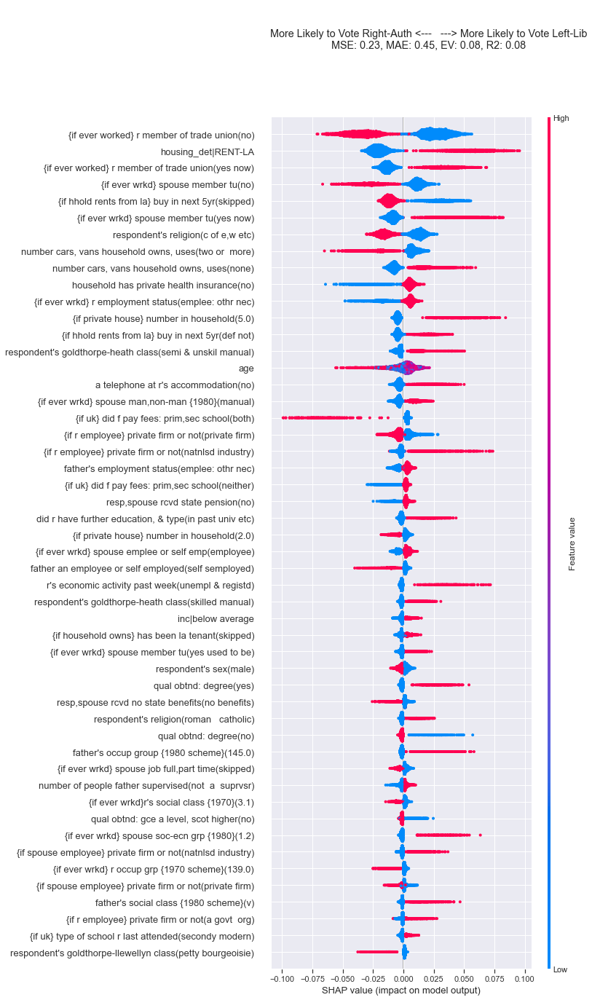

In [58]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [59]:
# 1987

# 'v471': "no details of father's job",
# 'v472': "reasons why no details of father's job",
# 'v47a1': "father's occupational group - 1980 status",
# 'v47a2': "father's employment status",
# 'v47a3': "father's socio-economic group",
# 'v47a4a': "father's social class",
# 'v47a4b': "father's manual/non manual",
# 'v47f': "father's standard industry code",
# 'v47a5': "father's heath-goldthorpe class",
# 'v47d': 'no. of people father supervised',
# 'v47e': 'father employee or self-employed',
# 'v47g': "no. of employees at father's workplace",

# 'v48': "respondent's address at 14",
# 'v49a': "respondent's economic activity, past seven days",
# 'v49b': "respondent's last paid job (10+ hours)",
# 'v49c': "respondent's t.u. membership",
# 'v49d': 'past membership of t.u.s.',

# 'v50a1': "if ever worked: respondent's occupation group",
# 'v50a2': "if ever worked: respondent's employment status",
# 'v50a3': "if ever worked: respondent's socio-economic group",
# 'v50a4a': "if ever worked: respondent's social class",
# 'v50a4b': "if ever worked: respondent's manual/non manual",
# 'v50g': "if ever worked: no. of employees at r's work",
# 'v50a5': "if ever worked: respondent's heath-goldthorpe class",
# 'v50d': 'if ever worked: no. of people respondent supervises',
# 'v50e': 'if ever worked: respondent employee or self-employed',
# 'v50f': 'if ever worked: type of org. respondent works for',
# 'v50h': "if ever worked: no. of employees at respondent's work",
# 'v50i': "if ever worked: respondent's job full-time/part-time",

# 'v51a': "respondent's marital status",
# 'v51b': "spouse's economic activity, past 7 days",
# 'v51c': "spouse's last paid job",
# 'v51d': "spouse's t.u. membership",
# 'v52a1': "if ever worked: spouse's occupation group",
# 'v52a2': "if ever worked: spouse's employment status",
# 'v52a3': "if ever worked: spouse's socio-economic group",
# 'v52a4a': "if ever worked: spouse's social class",
# 'v52a4b': "if ever worked: spouse's manual/non manual",
# 'v52g': "if ever worked: spouse's industry code",
# 'v52a5': "if ever worked: spouse's heath-goldthorpe class",
# 'v52d': 'if ever worked: no. spouse supervises',
# 'v52e': 'if ever worked: spouse employed or self-employed',
# 'v52f': 'if ever worked: type of org. spouse works for',
# 'v52h': "if ever worked: no. of employees at spouse's work",
# 'v52i': "if ever worked: spouse's job full-time or part-time",

# 'v53a': 'thinks household income above/below average',
# 'v53b': 'no. of cars/vans household owns/uses',
# 'v53c': 'household has private health insurance',
# 'v53d': 'owns shares in privatised company',
# 'v53e': 'owns any other shares/unit trusts',

# 'v54a1': 'children under 16',
# 'v54a2': 'children over 16 in full-time education',
# 'v54b': 'any children at/been to private school',

# 'v55': "respondent's age when completed full-time education",
# 'v56a': "resp's exams/quals: no qualifications",
# 'v56b': "resp's exams/quals: cse grades 2-5",
# 'v56c': 'exams o level scottish low',
# 'v56d': 'exams o level scottish higher',
# 'v56e': "resp's exams/quals: trade apprenticeship",
# 'v56f': 'exams rsa/other commercial quals',
# 'v56g': 'exams city/guilds certificate',
# 'v56h': 'exams city/guilds advanced',
# 'v56i': 'exams city/guilds technological',
# 'v56j': 'exams bec/tec ond/onc',
# 'v56k': "resp's exams/quals: hnc/hnd",
# 'v56l': "resp's exams/quals: teacher training certificate",
# 'v56m': "resp's exams/quals: nursing qualification",
# 'v56n': "resp's exams/quals: other tech/business/professional",
# 'v56o': "resp's exams/quals: university or cnaa degree",
# 'v56p': "resp's exams/quals: other",
# 'v56q': "resp's overseas exams/quals: school leaving cert.",
# 'v56r': "resp's overseas exams/quals: degree",
# 'v56s': "resp's overseas exams/quals: other post school",
# 'v57': "resp's private primary/secondary school",

# 'v58a': "resp's race/ethnicity",
# 'v58b': "resp's sex",
# 'v58c': "resp's age last birthday",
# 'v59a': "resp's religion",
# 'v59b': 'religious attendance',

# 'v60ab': 'housing tenure',
# 'v60c': 'ever been local authority tenant',
# 'v60d': 'local authority tenant prior to buying',
# 'v60e': 'ever bought a council house/flat',
# 'v60f': 'when was accommodation bought from council?',
# 'v61': 'how will try to buy council house in next 5 years',
# 'v62': 'whose name is accommodation in?',

# 'v63': 'main source of income',
# 'v64': 'total household income before tax',

###### 'v65a': 'party respondent voted for in 1983 election',
######  'v65b': 'party respondent voted for in 1979 election',

# 'v66b': 'length of time at present address',
# 'v66c': 'length of time in present neighbourhood',

#####  'v67a': 'respondent member of any political party',
#####  'v67b': 'if labour party member: through t.u. or individual',
#####  'v68': "does any party represent respondent's views",

# 'v69a': 'telephone in accommodation',
# 'v69b': 'easy access to phone',

###########

# 'v119a': 'self-coded: socio-economic group',
# 'v119b': 'self-coded: employee/self-employed',
# 'v119c': 'self-coded: supervisory/non-supervisory',
# 'v120a': 'self-coded: socio-economic group first job',
# 'v120b': 'self-coded: employee/self-employed first job',
# 'v120c': 'self-coded: supervisory/non-supervisory first job',

#########

# 'v126': 'type of school respondent last attended full-time'

In [60]:
# list( BES_label_list[ge].keys() ).index('v471'),list( BES_label_list[ge].keys() ).index('v64')

In [61]:
#owen|steele|thatcher|kinnock

# 'v2c': 'daily morning paper read most',
# 'v6a': 'respondent voted in general election',
# 'v6b1': 'reason 1 for not voting',
# 'v6b2': 'reason 2 for not voting',
# 'v6b3': 'reason 3 for not voting',
# 'v6b4': 'reason 4 for not voting',
# 'v6b5': 'reason 5 for not voting',
# 'v6c': 'nonvoters probable party preference',
# 'v7': 'when decided to vote as did',
# 'v8a': 'party voted for in general election',
# 'v8b': 'other party seriously considered voting for',
# 'v8c': 'second preference party',
# 'v9a': 'main reason why voted as did',
# 'v9b': 'party really preferred',
# 'v9c': 'if preferred other party, which?',
# 'v10a': 'party thought would win constituency',
# 'v10b': 'party thought would win nationally',
# 'v11': 'proportional representation',
# 'v12a': 'party identification',
# 'v12b': 'if no identification, closer to which party',
# 'v12c': 'strength of party identification',

# 'v16a': 'have voted for other party since 1964',
# 'v16b1': 'have voted con since 1964',
# 'v16b2': 'have voted lab since 1964',
# 'v16b3': 'have voted lib/sdp/alliance since 1964',

In [62]:
demo_vars = list( BES_label_list[ge].keys() )[258:346]
demo_vars += ['v66b','v66c']
demo_vars += ['v69a','v69b']
demo_vars += ['v119a','v119b','v119c','v120a','v120b','v120c',]


In [63]:
ge = "1987"

labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)

demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

[0]	validation_0-rmse:0.49851
[1]	validation_0-rmse:0.49746
[2]	validation_0-rmse:0.49630
[3]	validation_0-rmse:0.49537
[4]	validation_0-rmse:0.49427
[5]	validation_0-rmse:0.49330
[6]	validation_0-rmse:0.49238
[7]	validation_0-rmse:0.49155
[8]	validation_0-rmse:0.49072
[9]	validation_0-rmse:0.49001
[10]	validation_0-rmse:0.48929
[11]	validation_0-rmse:0.48864
[12]	validation_0-rmse:0.48808
[13]	validation_0-rmse:0.48762
[14]	validation_0-rmse:0.48727
[15]	validation_0-rmse:0.48695
[16]	validation_0-rmse:0.48643
[17]	validation_0-rmse:0.48602
[18]	validation_0-rmse:0.48566
[19]	validation_0-rmse:0.48545
[20]	validation_0-rmse:0.48524
[21]	validation_0-rmse:0.48494
[22]	validation_0-rmse:0.48458
[23]	validation_0-rmse:0.48423
[24]	validation_0-rmse:0.48390
[25]	validation_0-rmse:0.48365
[26]	validation_0-rmse:0.48342
[27]	validation_0-rmse:0.48340
[28]	validation_0-rmse:0.48328
[29]	validation_0-rmse:0.48293
[30]	validation_0-rmse:0.48278
[31]	validation_0-rmse:0.48248
[32]	validation_0-

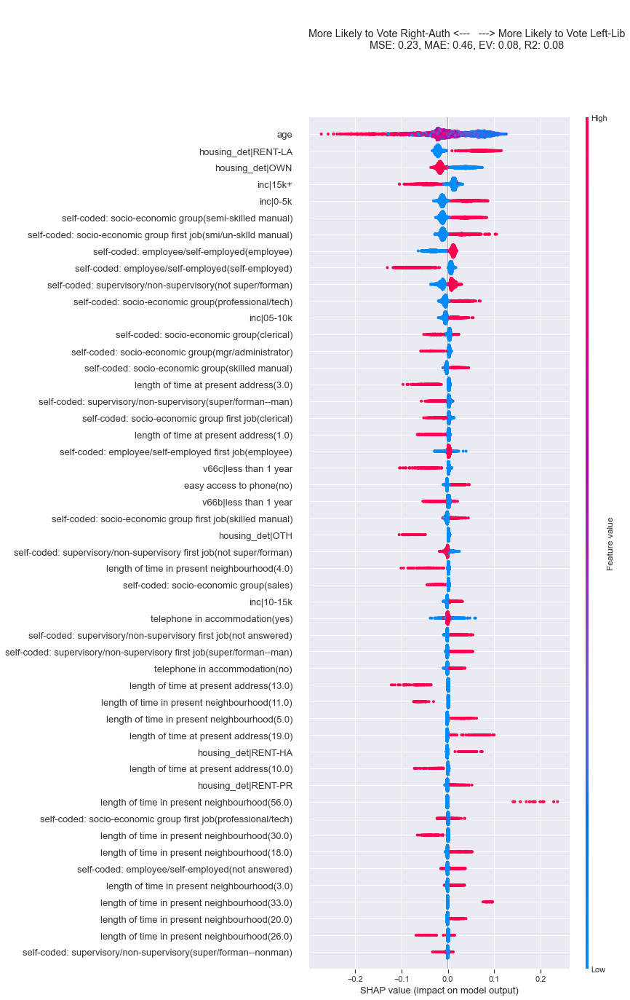

In [64]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [65]:
# labels['v53a']

In [66]:
## 1992
# major|kinnock|ashdown|

# 'arfc': 'field area (first coding)            arfc',
# 'arfe': "registrar general's standard region arfe",
# 'arff': 'opcs constitituency no.                   arff',
# 'arfg': 'old opcs constituency no.                 arfg',
# 'arfh': 'pa constitituency no.                     arfh',
# 'arfi': 'old pa constitituency no.                 arfi',

# 'area': 'constituency of sample point',
# 'ward': 'ward of sample point',
# 'polldist': 'polling district of sample point',
### confusing!



# 'v902a': "father's job details obtained?      q902",
# 'v902b': "father's job reason no details?     q902",
# 'v902d': 'father supervise how many people?  q902d',
# 'v902e': 'father was employee or self-employed q902e',
# 'v902g': "how many employed at father's work? q902g",
# 'v902_h': "father's soc                      q902.h",
# 'v902_i': "father's employment status        q902.i",
# 'v902_j': "father's seg                      q902.j",
# 'v902_k': "father's social class             q902.k",
# 'v902_l': 'father manual or non-manual       q902.l',
# 'v902_m': "father's sic                      q902.m",
# 'v902_n': "father's goldthorpe-heath class   q902.n",
# 'v902_o': "father's occupation code          q902.o",
# 'v903a': "r's doing in last seven days?      q903a",
# 'v903b': 'when r last have a paid job [notnow] q903b',
# 'v903c': 'r now a member of a tu or staff association? q903c',
# 'v903d': 'r ever been member of tu/sa [notnow] q903d',

# 'v905d': 'r supervise how many people?       q905d',
# 'v905e': 'r employee or self-employed?       q905e',
# 'v905f': 'r: type of organisation you work for q905f',
# 'v905h': "how many employed at r's work?     q905h",
# 'v905i': "is r's job full-time or part-time? q905i",
# 'v905_j': "r's soc                           q905.j",
# 'v905_k': "r's employment status             q905.k",
# 'v905_l': "r's seg     [20 categories]       q905.l",
# 'v905_m': "r's social class                  q905.m",
# 'v905_n': 'r manual or non-manual?           q905.n',
# 'v905_o': "r's sic                           q905.o",
# 'v905_p': "r's goldthorpe-heath class        q905.p",
# 'v905_q': "r's occupation code               q905.q",
# 'v906a': "r's marital status?                q906a",
# 'v906b': 'spouse was doing last week[if marr]q906b',
# 'v906c': 'spouse:time since paid job[if marr]q906c',
# 'v906d': 'spouse is/was tu member?  [if marr]q906d',

# 'v908d': 'spouse:how many supervises[if marr]q908d',
# 'v908e': 'spouse:employee/self-emp? [if marr]q908e',
# 'v908f': 'spouse:typ of organisation[if marr]q908f',
# 'v908h': 'spouse:how many employed? [if marr]q908h',
# 'v908i': 'spouse:is the job fulltime[if marr]q908i',
# 'v908_j': "spouse's soc             [if marr]q908.j",
# 'v908_k': 'spouses employment status[if marr]q908.k',
# 'v908_l': "spouse's seg             [if marr]q908.l",
# 'v908_m': "spouse's social class    [if marr]q908.m",
# 'v908_n': 'spouse is manual/non-manl[if marr]q908.n',
# 'v908_o': "spouse's sic             [if marr]q908.o",
# 'v908_p': "spouse's gh class        [if marr]q908.p",
# 'v908_q': 'spouses occupational code[if marr]q908.q',
# 'v909a': 'r/household own/have use of a car? q909a',
# 'v909b': 'r/household private health insurancq909b',
# 'v910a': 'r/spouse buy any privatised shares?q910a',
# 'v910b': 'when did buy privatised shares?    q910b',
# 'v910c': 'r/spouse own other(non-priv)shares?q910c',
# 'v910d': 'did you own privatised shares 1st? q910d',
# 'v911': 'age r completed fulltime education? q911',
# 'v912a': 'have you passed any school quals?  q912a',
# 'v913a': 'have passed post school quals?     q913a',

# 'v914a': 'r go to private, fee-paying school? q914a',
# 'v914b': 'considered private school for child q914b',
# 'v915a': 'which ethnic group do you belong to q915a',
# 'v915b': "respondent's sex by observation    q915b",
# 'v915c': "respondent's age last birthday?    q915c",
# 'v916': 'do you belong to a religion? which?  q916',
# 'v917': 'what religion were you brought up?  q917',
# 'v918': 'how often attend religion services? q918',
# 'v919a': 'do you live in an institution?     q919a',
# 'v919b': 'hhold own or rent accomodationn[private] q919b',
# 'v919c': 'how r/hhold coping with mortgage?  q919c',
# 'v919d': 'did you/respondent buy as local authority tenant? q919d',
# 'v919e': 'have you ever bought past local authority home? q919e',
# 'v919f': 'ever bought a ;ocal authority council house/flat? q919f',
# 'v919g': 'when did buy council accommodation? q919g',
# 'v920': 'main source of household income?    q920',
# 'v921': 'total income of household all source q921',

# 'v923a': 'is there a telephone in your accommodation? q923a',

# 'hedqual': 'highest educational qualification     dv',
# 'ragecat': 'age of respondent (banded)            dv',
# 'rsexage': 'age within gender of respondent       dv',
# 'religsum': 'religion with which r affiliated      dv',
# 'famrlsum': 'religion in which r brought up        dv',
# 'tenure2': "respondent's accommodation tenure     dv",
# 'evrbyla': 'ever bought house from a local authority? dv',
# 'hhincqua': 'household income quartile             dv',
# 'fseggrp': "father's socio-economic group(compressd)",
# 'rseggrp': "r's socio-economic group (compressed)  dv",
# 'sseggrp': "spouse's socio-economic group (compressd)",
# 'frgclass': "father's registrargeneral's social class",
# 'rrgclass': "r's registrar general's social class  dv",
# 'srgclass': "spouse's registrar general's social class",
# 'fghgrp': "father's goldthorpe-heath classification (compressed)",
# 'rghgrp': "r's goldthorpe-heath classification (compressed)",
# 'sghgrp': "spouse's goldthorpe-heath classification (compressed)",
# 'finddiv': "father's industrial division",
# 'rinddiv': "r's industrial division",
# 'sinddiv': "spouse's industrial division",
# 'v912b_01': 'qual obtained:cse grade 2-5     q912b.01',
# 'v912b_02': 'qual obtained:cse grade 1,o-level q912b.02',
# 'v912b_03': 'qual obtained:a-level etc       q912b.03',
# 'v912b_04': 'qual obtained:overseas school leaving q912b.04',
# 'v913b_01': 'qual obtained:trade apprenticeship q913b.01',
# 'v913b_02': 'qual obtained:rsa, similar clerical q913b.02',
# 'v913b_03': 'qual obtained:city+guilds craft q913b.03',
# 'v913b_04': 'qual obtained:city+guilds advanced q913b.04',
# 'v913b_05': 'qual obtained:city+guilds full tech q913b.05',
# 'v913b_06': 'qual obtained: bec ordinary onc,ond  q913b.06',
# 'v913b_07': 'qual obtained:bec higher,hnc,hnd   q913b.07',
# 'v913b_08': 'qual obtained:teacher training  q913b.08',
# 'v913b_09': 'qual obtained:nursing qualification q913b.09',
# 'v913b_10': 'qual obtained:univ/cnaa degree  q913b.10',
# 'v913b_11': 'qual obtained:other tech.business  q913b.11',
# 'v913b_12': 'qual obtained:other academic/vocational q913b.12',

# 'fmingrp': "r's r.g.constituent minor groups      dv",
# 'fsmajgrp': "dad's r.g. sub-major groups           dv",
# 'fmajgrp': "dad's r.g.major group                 dv",
# 'fseg': 'respondent:r.g.socio-economic group q910bni908b',
# 'fsocclas': 'respondent:r.g. social class       q902.k',
# 'rmingrp': "r's r.g.constituent minor groups      dv",
# 'smingrp': 'spouse:r.g.constt minor group [if marr] dv',
# 'rsmajgrp': "r's r.g. sub-major groups             dv",
# 'ssmajgrp': 'spouse:r.g.sub-major groups? [if marr] dv',
# 'rmajgrp': "r's r.g.major group                   dv",
# 'smajgrp': 'spouse:r.g. major group      [if marr] dv',
# 'rseg': 'respondent:r.g.socio-economic group q905.l',
# 'rsocclas': 'respondent:r.g. social class       q905.m',
# 'sseg': 'spouse:r.g.socio-economic group    q908.l',
# 'ssocclas': 'spouse:r.g. social class           q908.m'

In [67]:
## bug in labels!

BES_label_list["1992"]['fmingrp'] = "f's r.g.constituent minor groups      dv"

In [68]:
#v902a,v903d
#v905d,v906d
#v908d,v913a
#v914a,v921
#'v923a'
#'hedqual','v913b_12'
#'fmingrp','ssocclas'

In [69]:
# list( BES_label_list[ge].keys() ).index('fmingrp'),list( BES_label_list[ge].keys() ).index('ssocclas'),

In [70]:
# list( BES_label_list[ge].keys() )[512:527]

In [71]:
demo_vars = list( BES_label_list[ge].keys() )[256:273]
demo_vars +=list( BES_label_list[ge].keys() )[274:291]
demo_vars +=list( BES_label_list[ge].keys() )[292:314]
demo_vars +=list( BES_label_list[ge].keys() )[315:332]
demo_vars += ['v923a']
demo_vars +=list( BES_label_list[ge].keys() )[471:507]
demo_vars +=list( BES_label_list[ge].keys() )[512:527]


In [72]:
ge = "1992"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)

demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

In [73]:
# pd.Series(df_simp.columns).value_counts()

[0]	validation_0-rmse:0.49333
[1]	validation_0-rmse:0.48686
[2]	validation_0-rmse:0.48086
[3]	validation_0-rmse:0.47546
[4]	validation_0-rmse:0.47109
[5]	validation_0-rmse:0.46717
[6]	validation_0-rmse:0.46352
[7]	validation_0-rmse:0.46019
[8]	validation_0-rmse:0.45670
[9]	validation_0-rmse:0.45382
[10]	validation_0-rmse:0.45071
[11]	validation_0-rmse:0.44768
[12]	validation_0-rmse:0.44532
[13]	validation_0-rmse:0.44225
[14]	validation_0-rmse:0.43969
[15]	validation_0-rmse:0.43740
[16]	validation_0-rmse:0.43533
[17]	validation_0-rmse:0.43337
[18]	validation_0-rmse:0.43178
[19]	validation_0-rmse:0.43011
[20]	validation_0-rmse:0.42887
[21]	validation_0-rmse:0.42746
[22]	validation_0-rmse:0.42589
[23]	validation_0-rmse:0.42446
[24]	validation_0-rmse:0.42322
[25]	validation_0-rmse:0.42177
[26]	validation_0-rmse:0.42075
[27]	validation_0-rmse:0.41975
[28]	validation_0-rmse:0.41905
[29]	validation_0-rmse:0.41849
[30]	validation_0-rmse:0.41777
[31]	validation_0-rmse:0.41665
[32]	validation_0-

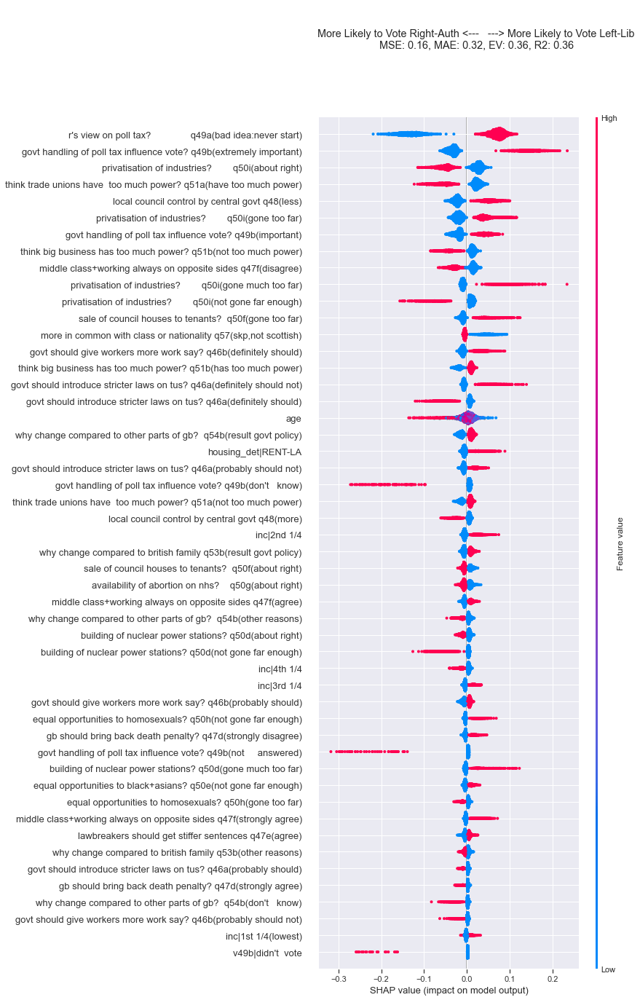

In [74]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [75]:
# %debug

In [76]:
## 1997

In [77]:
# 'stregion': 'standard region  dv',
# 'locauth': 'local authority code (from the sample)',

## 'popden': 'population density (from the sample)',
## 'popband': 'population density in quartiles (gb) dv',
## 'popbands': 'population density in quartiles (scot)dv',
## 'popbande': 'population density quartiles (ethnic)dv',
## 'hhhemp': '% head of household employers & managers',
## 'ethnall': '% ethnic minority [census eng+wales]  ',
## 'ethnads': '% ethnic minority adults [eng+wales]  ',

# 'entphone': 'does the address have an entry phone? q135',
# 'nosecure': 'no security devices visible address? ',

# 'alarm': 'burglar alarm visible at address?   ',
# 'gate': 'security gate over front door?      ',
# 'grilles': 'bars/grilles on any windows?         ',
# 'securoth': 'other security devices visible?      ',
# 'guards': 'estate/block security lodge/guards?',
# 'homenr': 'record sampled dwelling type  q141',
# 'flatnr': 'is flat self-contained or not self-contained q142',
# 'floornr': 'building has fewer than 5 floors? q143',
# 'locknr': 'building has common lockable entrance q144',
# 'levelnr': 'floor level of main accommodation?  q145',

# 'ethnr': 'record ethnic origin of selected person  q148',

# 'citizen': 'are you a british citizen? q156',
# 'country': 'r citizen of other country? [grouped] q158',
# 'elregon': "is r's name on electoral register? q159",
# 'elregnot': "why is r's name not on electoral register? q160",
# 'elregtxt': 'other reason not on electoral register? q161',
# 'elregoct': 'living at this address in oct 1996? q177',
# 'elreg2': 'where living in oct 1996? q178',

# 'raceori2': "respondent's race self-rated   q480",
# 'ethminq': 'is r eligible to be asked ethnic minority module? ',

# 'rsex': "respondent's sex by observation  q628",
# 'rage': "respondent's age in years last birthday? q630",
# 'ragecat': "respondent's age(grouped)   dv q631",
# 'rsexage': 'age grouped within gender    dv q632',
# 'househld': 'how many in household *including r*? q634',
# 'numch18': 'number of people under 18 in household? q636',
# 'numch5': 'number of people over 5 yrs in household? q638',
# 'marstat2': 'marital status of respondent [full]  q639',
# 'marstat': 'marital status  dv q640',
# 'married': 'marital status [grouped] dv q641',

# 'fjobobt': "father's job details obtained?  q647",
# 'mjobobt': "mum's job details obtained? (not father) q648",
# 'femploye': 'was your father an employee? q654',
# 'fsupman': 'was your father a supervisor or manager? q655',
# 'fempwork': 'size of establishment where your father worked? q656',
# 'fsoc': "father's standard occupational class 1990? q657",
# 'fempstat': 'employment status of father? q659',
# 'frempee': 'is father an employee or self-employed? q665',
# 'fmingrp': "father's soc minor group  dv  q667",
# 'fsmajgrp': 'father: r.g. sub-major groups? q668',
# 'fmajgrp': 'father: r.g. major group    dv  q669',
# 'fseg2': "father's socio-economic group? [20cat] q670",
# 'fseg': "father's socio-economic group? [17cat] q671",
# 'fseggrp': "father's socio-economic group? [ 9cat]  q672",
# 'fsoccla2': "father's r.g. social class        [7cat] q674",
# 'fsocclas': "father's r.g. social class        [5cat] q675",
# 'frgclass': "father's r.g. social class        [6cat] q676",
# 'fghclass': "father's goldthorpe-heath class schema  q677",
# 'fghgrp': "father's goldthorpe-heath class [compressed] q678",
# 'memploye': 'was your mother an employee? q684',
# 'msupman': 'was your mother a supervisor or manager? q685',
# 'mempwork': 'size of establishment where your mother worked? q686',
# 'msoc': "mother's standard occupational class 1990? q687",
# 'mempstat': 'employment status of mother [no father job] q689',
# 'mrempee': 'is the mother an employee or self-employed? q695',
# 'mmingrp': 'mother: r.g. constituent minor group [no father] q697',
# 'msmajgrp': 'mother: r.g. sub-major groups? [no father] q698',
# 'mmajgrp': "mother: r.g. major group [no father's jb] q699",
# 'mseg2': "mother's socio-economic [20cat] [no father] q700",
# 'mseg': "mother's socio-economic [17cat] [no father] q701",
# 'mseggrp': "mother's socio-economic [ 9cat] [no father] q702",
# 'msoccla2': "mother's r.g. social class [7 cat] q703",
# 'msocclas': "mother's r.g. social class [5cat] [no father] q705",
# 'mrgclass': "mother's r.g. social class [6cat] [no father] q706",
# 'mghclass': "mother's goldthorpe heath class [no father] q707",
# 'mghgrp': "mother's goldthorpe heath class [no father] q708",
# 'reconact': "r's main economic activity last week? q724",
# 'rlastjob': 'how long ago did r last have a paid job? q726',
# 'unionsa2': 'are you now a member of a trade union? q727',
# 'unionsa': 'now member trade union? [ever had job] q728',
# 'tusaoth': 'anyone in household tu/staff assoc. member? [not mar] q730',
# 'tusaever': 'r ever been a tu member or staff association member? q731',
# 'remploye': "r's main job now: r employee/self-employed? q735",
# 'rsupman': 'r manager, foreman, supervisor? [if ever worked] q736',
# 'rocsect2': 'r works for organisation type? [emp] q737',
# 'rempwork': 'size of establishment that r works for? q741',
# 'rjbhrsi': 'how many hours respondent worked? q742',
# 'rjbhrcat': 'hours worked by respondent (grouped)',
# 'rpartful': 'full-time (30+hours) / part-time (10-29hours)',
# 'rsoc': 'standard occupational classification 1990  q745',
# 'rempstat': 'employment status of respondent  q748',
# 'rrempee': "r's employment status   q754",
# 'rsic92': "standard industrial classification '92 q755",
# 'rsic92gp': "standard industrial classification '92 (comm)  dv q756",
# 'rmingrp': "r's r.g. constituent minor groups dv q761",
# 'rsmajgrp': "r's r.g. sub-major groups  dv  q762",
# 'rmajgrp': "r's r.g. major group  dv  q763",
# 'rseg2': "r's socio-economic group [20cat] q764",
# 'rseg': "r's socio-economic group [17cat] q765",
# 'rseggrp': "r's socio-economic group [ 9cat] q766",
# 'rsoccla2': 'r.g. social class of respondent [7cat] q768',
# 'rsocclas': 'r.g. social class of respondent [5cat] q769',
# 'rrgclass': 'r.g. social class of respondent [6cat] q770',
# 'rghclass': "r's goldthorpe-heath class schema   q771",
# 'rghgrp': "r's goldthorpe-heath class schema [com] q772",
# 'risco': 'isco88com code of respondent  dv  q759',

# 'seconact': 'partners economic activity [mar/live as married] q795',
# 'slastjob': 'spouse: when last had a job? [mar/live as married] q796',
# 'suniosa2': 'partner/spouse now trade union member? q797',
# 'sunionsa': 'partner now tu member? [ever had job] q798',
# 'tusaoth2': 'whether anyone else in household tu member? q799',
# 'tusahhld': 'cses anyone else in household tu member? q800',
# 'stusaevr': 'partner/spouse ever been tu member? q801',
# 'semploye': 'in your main job are you an employee q805',
# 'ssupman': 'spouse is/was manager/supervisor [mar] q806',
# 'socsect2': "spouse's occupational sector [sp emp] q807",
# 'sempwork': "no of employees at spouse's workplace [ever work] q810",
# 'sjbhrsi': 'how many hours spouse/partner worked? q811',
# 'sjbhrcat': 'hours worked spouse/partner (grouped)',
# 'spartful': 'spouse/partner full-time (30+hr) part-time (10-29hr)',
# 'ssoc': 'spouse/partner standard occupational class 1990  q813',
# 'sempstat': 'employment status of spouse/partner? q816',
# 'srempee': "spouse's employment status q822",
# 'ssic92': "spouse/partner sic '92? [if married] q823",
# 'ssic92gp': "spouse/partner sic '92 (compressed) [married]  q824",
# 'smingrp': 'spouse: r.g. constituent minor group [if married]  q829',
# 'ssmajgrp': 'spouse: r.g. sub-major groups [if married]  q830',
# 'smajgrp': 'spouse: r.g. major group [if married]  q831',
# 'sseg2': 'spouse/partner socio-economic group [20cat]  q832',
# 'sseg': 'spouse/partner socio-economic group [17cat]  q833',
# 'sseggrp': 'spouse/partner socio-economic group [ 9cat]  q834',
# 'ssoccla2': 'spouse/partner r.g. social class [7 cat]  q836',
# 'ssocclas': 'spouse/partner r.g. social class [5 cat]  q837',
# 'srgclass': 'spouse/partner r.g. social class [6 cat]  q838',
# 'sghclass': 'spouse/partner goldthorpe-heath class schema  q839',
# 'sghgrp': 'spouse/partner goldthorpe-heath class [com]  q840',
# 'sisco': 'isco88com (spouse)  dv  q827',
# 'sschrsi': 'spouse/partner hours worked on training scheme? q812',
# 'snpwk10': 'spouses work less than 10hrs in past seven days? q843',
# 'sraceori': 'spouse/partner belong to ethnic group? q844',
# 'incmsrc': 'main source of income for r+partner now? q852',
# 'hhincver': 'version of income question used? q855',
# 'hhincoma': 'total income per household before tax [card]? q856',
# 'hhincomb': 'total income per household before tax [ballot]? q856',
# 'hhincome': 'household income total before tax  dv  q860',
# 'hhincqua': 'household income quartiles (gb sample) q861',
# 'hhincqus': 'household income quartiles (scottish sample) q861',
# 'hhincque': 'household income quartiles (ethnic)  dv  q861',
# 'hhincqui': 'cses: household income quintiles (gb) q862',
# 'hhinquis': 'cses: household income quintile (scotland) q862',
# 'hhinquie': 'cses: household income quintile (ethnic)  862',
# 'carown': "r or r's household have use of car? q863",
# 'hprivmed': "r or r's household have private medical insurance? q864",
# 'ownshare': "r or r's spouse/partner own any shares? q865",
# 'tea': 'terminal education age? q866',
# 'schqual': 'does r have school qualifications? q867',
# 'edqual1': 'qual obtained: cse grade 2-5 q885',
# 'edqual2': 'qual obtained: cse grade1,o-level, etc. q886',
# 'edqual3': 'qual obtained: a-level etc. q887',
# 'edqual4': 'qual obtained: overseas school leaving exam q888',
# 'pschqual': 'r passed any work exams/qualifications? q889',
# 'edqual5': 'qual obtained: trade apprenticeship q910',
# 'edqual6': 'qual obtained: rsa, similar clerical q911',
# 'edqual10': 'qual obtained: bec ordinary, onc, ond q915',
# 'edqual11': 'qual obtained: bec higher, hnc, hnd q916',
# 'edqual12': 'qual obtained: teacher training qualification q917',
# 'edqual13': 'qual obtained: nursing qualification q918',
# 'edqual14': 'qual obtained: other tech, business qualification q919',
# 'edqual15': 'qual obtained: univ, cnaa degree, diploma q920',
# 'edqual16': 'qual obtained: other academic/vocational q921',
# 'edqual17': 'qual obtained: nvq/svq l1/gnvq foundation q922',
# 'edqual18': 'qual obtained: nvq/svq l2/gnvq intermediate q923',
# 'edqual19': 'qual obtained: nvq/svq l3/gnvq advanced q924',
# 'edqual20': 'qual obtained: nvq/svq level 4 q925',
# 'edqual21': 'qual obtained: nvq/svq level 5 q926',
# 'edqual22': 'qual obtained: city & guilds certificate - part i q927',
# 'edqual23': 'qual obtained: city+guilds craft etc. q927',
# 'edqual24': 'qual obtained: city+guilds advanced etc. q927',
# 'edqual25': 'qual obtained: city+guilds full technical q927',
# 'hedqual': 'highest educational qualification? q928',
# 'rprivsch': 'r go to a private, fee-paying school? q930',
# 'prvedcon': 'r sent/consider sending child to private school? q931',
# 'religion': 'r belongs to a religion? q932',
# 'religsum': "respondent's religion [grouped] q936",
# 'cses104': 'religious denomination of respondent? q937',
# 'famrelig': "respondent's upbringing religion? q938",
# 'rlfamsum': "r's upbringing religion [grouped]  dv  q942",
# 'churchat': 'how often attend church? q943',
# 'religius': 'r religious nowadays? [self-rated] q945',
# 'langhom1': 'speak english/not english at home? q947',
# 'langhom2': 'which language spoken at home? [coded] q949',
# 'tenurtyp': 'does r live in private household? q950',
# 'tenure1': 'tenure of accommodation?  dv  q953',
# 'tenure2': 'tenure of accommodation (grouped)  dv  q954',
# 'evrbylah': 'r/person responsible for accom. ever bought as tenant? q955',
# 'nghbrhd': 'how long have you lived in this neighbourhood? q956',

In [78]:
ge = "1997"
# list( BES_label_list[ge].keys() ).index('popden'),list( BES_label_list[ge].keys() ).index('popden'),

In [79]:
# list( BES_label_list[ge].keys() )[38]
# demo_vars

In [80]:
demo_vars = list( BES_label_list[ge].keys() )[5:7]
demo_vars +=list( BES_label_list[ge].keys() )[24:26]
demo_vars +=list( BES_label_list[ge].keys() )[26:36]
demo_vars += ['ethnr']
demo_vars +=list( BES_label_list[ge].keys() )[71:78]

demo_vars +=list( BES_label_list[ge].keys() )[244:246]
demo_vars +=list( BES_label_list[ge].keys() )[368:378]
demo_vars +=list( BES_label_list[ge].keys() )[380:446]
demo_vars +=list( BES_label_list[ge].keys() )[453:543]



In [81]:
ge = "1997"
labels = BES_label_list[ge]

df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)

demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

[0]	validation_0-rmse:0.49851
[1]	validation_0-rmse:0.49687
[2]	validation_0-rmse:0.49509
[3]	validation_0-rmse:0.49315
[4]	validation_0-rmse:0.49160
[5]	validation_0-rmse:0.49052
[6]	validation_0-rmse:0.48973
[7]	validation_0-rmse:0.48910
[8]	validation_0-rmse:0.48813
[9]	validation_0-rmse:0.48689
[10]	validation_0-rmse:0.48567
[11]	validation_0-rmse:0.48459
[12]	validation_0-rmse:0.48399
[13]	validation_0-rmse:0.48321
[14]	validation_0-rmse:0.48246
[15]	validation_0-rmse:0.48189
[16]	validation_0-rmse:0.48144
[17]	validation_0-rmse:0.48137
[18]	validation_0-rmse:0.48089
[19]	validation_0-rmse:0.48027
[20]	validation_0-rmse:0.47950
[21]	validation_0-rmse:0.47895
[22]	validation_0-rmse:0.47911
[23]	validation_0-rmse:0.47916
[24]	validation_0-rmse:0.47878
[25]	validation_0-rmse:0.47842
[26]	validation_0-rmse:0.47801
[27]	validation_0-rmse:0.47758
[28]	validation_0-rmse:0.47764
[29]	validation_0-rmse:0.47746
[30]	validation_0-rmse:0.47724
[31]	validation_0-rmse:0.47717
[32]	validation_0-

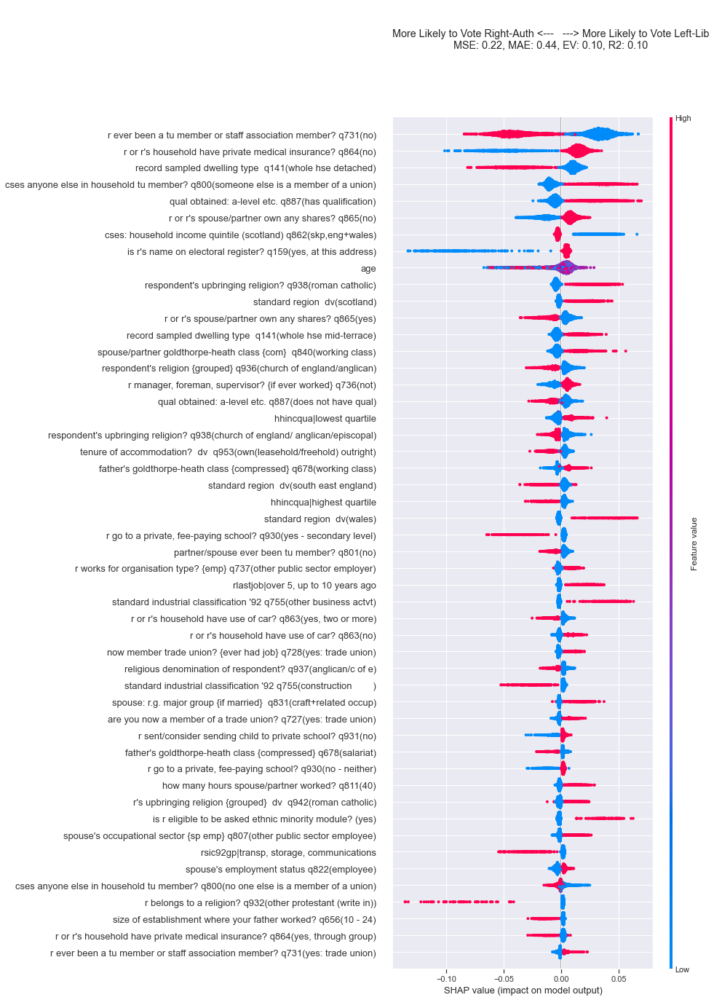

In [82]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [83]:
## 2001

In [84]:
# hague|swinney|jones|blair|kennedy

## 'ref': 'standard pa constituency reference number', (this becomes a significant ordinal!!!)
# 'seatname': 'name of constituency',
# 'region': 'major census region (britain)',
# 'county': 'county',

# 'aregion': 'region coded from nop constituency',
# 'aconstit': 'constituency',
# 'constrev': 'corrected constituency codes (see value labels)',
### 'award': 'ward',

# 'aq38': 'age in years',
# 'aq39': 'marital status',
# 'aq40a': 'own or rent',
# 'aq40b': 'own outright or mortgage',
# 'aq41': 'trade union member',
# 'aq42': 'age completed full-time education',
# 'aq43a': 'have educational/work qualifications',
# 'aq43b': 'highest qualification',
# 'aq44a': 'belong to a religion',
# 'aq44b': 'religious denomination',
# 'aq44baux': 'religious denomination-other',
# 'aq45': 'annual household income',
# 'aq46': 'main source of income',
# 'aq47a': 'number people in household',
# 'aq47b': 'number people in household < 18',
# 'aq48a': 'r-occupation',
# 'aq48b': 'spouse-occupation',
# 'aq49a': 'r-occupation sector',
# 'aq49b': 'spouse-occupation sector',
# 'aq50': 'ethnicity',
# 'aq50aux1': 'ethnicity-other 1',
# 'aq50aux2': 'ethnicity-other 2',
# 'aq50aux3': 'ethicity-other 3',
# 'aq50aux4': 'ethncity-other 4',
# 'aq50aux5': 'ethnicity-other 5',
# 'aq51a': 'wales-speak welsh',
# 'aq51b': 'wales-speak welsh fluently',
# 'aq52a': 'telephone in this accommodation',
# 'agender': 'gender',
# 'aclass': 'market research class location',

# 'bward': 'ward'

# 'bq7': 'on electoral register',

# 'bq72': 'age',
# 'bq73': 'marital status',
# 'bq74a': 'own or rent',
# 'bq74b': 'own outright or mortgage',
# 'bq75a': 'trade union member',
# 'bq75b': 'age complete full-time education',
# 'bq76a': 'any educational/work qualificiations',
# 'bq76b': 'educational/work qualifications',
# 'bq77a': 'belong to religion',
# 'bq77b': 'which religious denomination',
# 'bq77c': 'which religious denomination-other',
# 'bq78': 'annual household income',
# 'bq79': 'main source of income',
# 'bq80a': 'number people in household',
# 'bq80b': 'number in household under 18',
# 'bq80c': 'number in household need special care',
# 'bq81': 'leisure time',
# 'bq82': 'r-occupational sector',
# 'bq83': 'spouse-occupational sector',
# 'bq84': 'r workforce status',
# 'bq85': 'r employee or self-employed',
# 'bq88': 'r supervise other employees',
# 'bq90a': 'if r self-employed-how many employees',
# 'bq90b': 'if r employed-how many employees',
# 'bq91': 'r-how many hours worked',
# 'bq92': 'spouse work',
# 'bq93': 'spouse employeed or self-employed',
# 'bq96': 'spouse a supervisor',
# 'bq98a': 'if spouse self-employed-how many employees',
# 'bq98b': 'if spouse employed-how many employees',
# 'bq99': 'spouse-how many hours worked',
# 'bq100': 'ethnicity',
# 'bq100ax1': 'ethnicity-other 1',
# 'bq100ax2': 'ethnicity-other 2',
# 'bq100ax3': 'ethnicity-other 3',
# 'bq100ax4': 'ethnicity-other 4',
# 'bq100ax5': 'ethnicity-other 5',
# 'bq101': 'language usually spoken at home',
# 'bq101aux': 'language usually spoken at home-other',
# 'bq102a': 'wales-speak welsh',
# 'bq102b': 'wales-speak welsh fluently',
# 'bq103a': 'telphone in this accommodation',
# 'bq104': 'gender',

## 'bclass': 'market research class location',
# 'soc1990r': "respondent's standard occupational classification 1990 coding",
# 'soc2000r': "respondent's standard occupational classification 2000 coding",
# 'gld11r': "respondent's location in goldthorpe's 11-class scheme",
# 'gld5r': "respondent's location in goldthorpe's 5-class scheme",
# 'nssecr': "respondent's location in national statistics socio-economic classification - ope",
# 'nssecacr': "respondent's location in national statistics socio-economic classification - ana",
# 'soc1990s': "spouse's standard occupational classification 1990 coding",
# 'soc2000s': "spouse's standard occupational classification 2000 coding",
# 'gld11s': "spouse's location in goldthorpe's 11-class scheme",
# 'gld5s': "spouse's location in goldthorpe's 5-class scheme",
# 'nssecs': "spouse's location in national statistics socio-economic classification - operati",
# 'nssecacs': "spouse's location in national statistics socio-economic classification - analyti",

# 'owns': 'own or rent-summary',
# 'morts': 'own outright or mortgage-summary',
# 'trades': 'trade union member-summary',
# 'edquals': 'educational/work qualifications-summary',
# 'religs': 'belong to religion-summary',
# 'wreligs': 'religious denomination-summary',
# 'incomes': 'annual household income-summary',
# 'rsectors': 'r-occupational sector-summary',
# 'ssectors': 'spouse-occupational sector-summary',
# 'ethns': 'ethnicity-summary',
# 'mains': 'main source of income-summary',

## problem - really should try to merge these two datasets!

In [85]:
# ge = "2001"
# list( BES_label_list[ge].keys() ).index('owns'),list( BES_label_list[ge].keys() ).index('mains'),

In [86]:
# BES_label_list[ge]["agender"]

In [87]:
ge = "2001"

demo_vars = list( BES_label_list[ge].keys() )[3:4]
# demo_vars +=list( BES_label_list[ge].keys() )[142:145]
# demo_vars +=list( BES_label_list[ge].keys() )[284:314]
# demo_vars += ['bq7'] # 'bward',
# demo_vars +=list( BES_label_list[ge].keys() )[599:642]

demo_vars +=list( BES_label_list[ge].keys() )[646:658]
demo_vars +=list( BES_label_list[ge].keys() )[689:700]


In [88]:
ge = "2001"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)

demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

In [89]:
df_simp.stack().value_counts()
df_simp = df_simp.replace(99,np.nan).replace(999,np.nan)
df_simp.stack().value_counts()

0.000000     5435487
1.000000       83013
0.308935         120
36.000000         96
37.000000         88
              ...   
12.000000          1
96.000000          1
3.210624           1
1.704283           1
3.927400           1
Length: 213, dtype: int64

In [90]:
pd.Series(df_simp.columns).value_counts().head(50)

respondent's standard occupational classification 2000 coding(8124.0)                    1
spouse's standard occupational classification 1990 coding(214.0)                         1
spouse's standard occupational classification 1990 coding(526.0)                         1
spouse's standard occupational classification 1990 coding(234.0)                         1
respondent's standard occupational classification 2000 coding(7211.0)                    1
spouse's standard occupational classification 1990 coding(839.0)                         1
spouse's standard occupational classification 1990 coding(515.0)                         1
respondent's standard occupational classification 2000 coding(1234.0)                    1
spouse's standard occupational classification 1990 coding(531.0)                         1
respondent's standard occupational classification 1990 coding(642.0)                     1
spouse's standard occupational classification 1990 coding(202.0)                         1

[0]	validation_0-rmse:0.49935
[1]	validation_0-rmse:0.49872
[2]	validation_0-rmse:0.49792
[3]	validation_0-rmse:0.49730
[4]	validation_0-rmse:0.49717
[5]	validation_0-rmse:0.49633
[6]	validation_0-rmse:0.49588
[7]	validation_0-rmse:0.49547
[8]	validation_0-rmse:0.49515
[9]	validation_0-rmse:0.49507
[10]	validation_0-rmse:0.49464
[11]	validation_0-rmse:0.49423
[12]	validation_0-rmse:0.49371
[13]	validation_0-rmse:0.49332
[14]	validation_0-rmse:0.49329
[15]	validation_0-rmse:0.49316
[16]	validation_0-rmse:0.49290
[17]	validation_0-rmse:0.49291
[18]	validation_0-rmse:0.49252
[19]	validation_0-rmse:0.49267
[20]	validation_0-rmse:0.49273
[21]	validation_0-rmse:0.49264
[22]	validation_0-rmse:0.49246
[23]	validation_0-rmse:0.49256
[24]	validation_0-rmse:0.49259
[25]	validation_0-rmse:0.49239
[26]	validation_0-rmse:0.49219
[27]	validation_0-rmse:0.49234
[28]	validation_0-rmse:0.49225
[29]	validation_0-rmse:0.49231
[30]	validation_0-rmse:0.49215
[31]	validation_0-rmse:0.49229
[32]	validation_0-

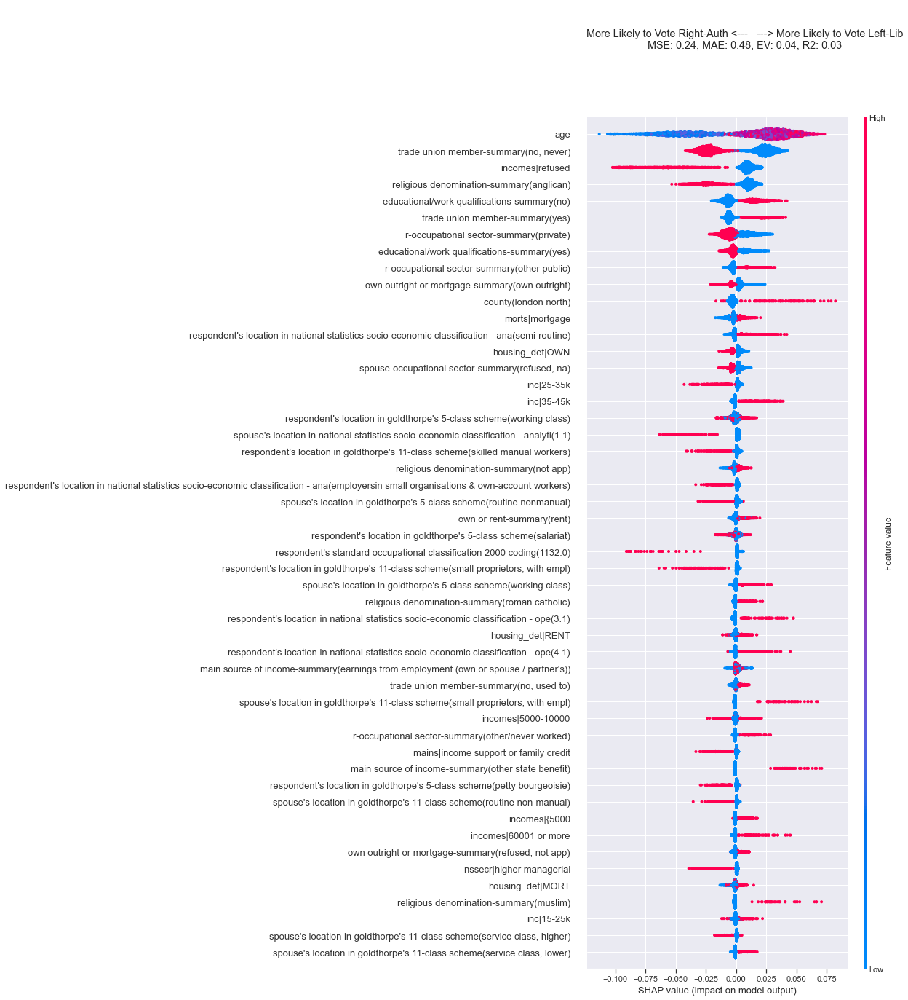

In [91]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [92]:
## 2005

In [93]:
# 'tq77': 'combined age',
# 'tq76': 'combined gender',
# 'tregion': 'combined region',
## 'es2000': 'employment status',
# 'nssec': 'respondent: ons socio-economic classification',
# 'seg': 'respondent: socio-economic group',
# 'sc': "respondent: registrar general's social class",
# 'sic2003': 'respondent: standard industrial classification 2003',
# 'es2001': 'employment status',
# 'nssec2': 'spouse/partner: ons socio-economic classification',
# 'seg2': 'spouse/partner: socio-economic group',
# 'sc2': "spouse/partner: registrar general's social class",
# 'sic2004': 'spouse/partner: standard industrial classifcation 2003',



# 'duno2': 'record no of occupied dwelling units',
# 'dusel2': 'record no of selected dwelling unit',
# 'persno2': 'enter n0 of people aged 18+',
# 'perssel2': 'enter `person no  of selected person',
## 'sabarr1': 'physical barriers to entry',
## 'sabarr2': 'physical barriers to entry',
## 'sabarr3': 'physical barriers to entry',
## 'sabarr4': 'physical barriers to entry',
# 'sadtype': 'description of accommodation',

# 'rgoldth': 'respondent goldthorpe class',
# 'sgoldth': 'spouse/partner goldtorpe class',
# 'tq78': 'combined-marital status',
# 'tq79a': 'combined-own or rent',
# 'tq79b': 'combined-own outright or mortgage',
# 'tq79c': 'combined-rent from whom',
# 'tq80a': 'combined-trade union member now',
# 'tq80b': 'combined-ever trade union member',
# 'tq81': 'combined-age finish full-time education',
# 'tq82a': 'combined-have educational qualification',
# 'tq82b': 'combined-highest educational qualification',
# 'tq83a': 'combined-religion',
# 'tq83b': 'combined-which religion',
# 'tq84': 'combined-annual household income',
# 'tq85': 'combined-main source of household income',
# 'tq86a': 'combined-number of people in household',
# 'tq86b': 'combined-number in household under 18',
# 'tq88a': "combined-r's occupation",
# 'tq88b': "combined-partner's occupation",
# 'tq89a': 'combined-r-type organization work for',
# 'tq89b': 'combined-partner-type organization work for',
# 'tq108': 'combined-ethnicity',

# 'cesw': 'england/scotland/wales',

# 'cgender': "r's gender",
# 'cage': "r's age",

# 'rgoldnew': 'resp-heath-goldthorpe 5 categories',
# 'sgoldnew': 'partner-heath-goldthorpe 5 categories',
## 'voteval3': 'validated vote jan 14',
# 'seat05': 'name of constituency 2005',
# 'region': 'major census region (britain)',
# 'county': 'county',

In [94]:
# ge = "2005"
# labels = BES_label_list[ge]
# # labels(list(labels.keys())[1000:])

In [95]:
# labels.keys()
# pd.Series(labels).tail(500).to_dict()

In [96]:
# ge = "2005"
# list( BES_label_list[ge].keys() ).index('nssec2'),list( BES_label_list[ge].keys() ).index('sic2004'),

In [97]:
ge = "2005"

demo_vars = list( BES_label_list[ge].keys() )[691:694]
demo_vars = list( BES_label_list[ge].keys() )[700:704]
demo_vars +=list( BES_label_list[ge].keys() )[707:711]
demo_vars +=list( BES_label_list[ge].keys() )[718:740]
demo_vars += ['cesw','cgender','cage','sadtype','rgoldnew','sgoldnew','region','county'] # 'bward',,'seat05',
# demo_vars +=list( BES_label_list[ge].keys() )[963:969]



In [98]:
# list( BES_label_list[ge].keys() )[691:694]

In [99]:
# BES_label_list[ge]

In [100]:
# demo_vars

In [101]:
ge = "2005"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)
old_demo_vars = demo_vars.copy()
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

In [102]:
df_simp = df_simp.replace(99,np.nan).replace(999,np.nan)

In [103]:
# old_demo_vars

In [104]:
# demo_vars

In [105]:
pd.Series(df_simp.columns).value_counts()

county(55)                                                      1
spouse/partner: standard industrial classifcation 2003(64.0)    1
cage|45                                                         1
cage|76                                                         1
cage|80                                                         1
                                                               ..
england/scotland/wales(2)                                       1
county(51)                                                      1
combined-which religion(5)                                      1
cage|62                                                         1
spouse/partner: standard industrial classifcation 2003(1.0)     1
Length: 576, dtype: int64

[0]	validation_0-rmse:0.49528
[1]	validation_0-rmse:0.49042
[2]	validation_0-rmse:0.48594
[3]	validation_0-rmse:0.48157
[4]	validation_0-rmse:0.47803
[5]	validation_0-rmse:0.47519
[6]	validation_0-rmse:0.47212
[7]	validation_0-rmse:0.46918
[8]	validation_0-rmse:0.46626
[9]	validation_0-rmse:0.46425
[10]	validation_0-rmse:0.46223
[11]	validation_0-rmse:0.45997
[12]	validation_0-rmse:0.45752
[13]	validation_0-rmse:0.45587
[14]	validation_0-rmse:0.45424
[15]	validation_0-rmse:0.45304
[16]	validation_0-rmse:0.45190
[17]	validation_0-rmse:0.45060
[18]	validation_0-rmse:0.44965
[19]	validation_0-rmse:0.44850
[20]	validation_0-rmse:0.44742
[21]	validation_0-rmse:0.44635
[22]	validation_0-rmse:0.44577
[23]	validation_0-rmse:0.44526
[24]	validation_0-rmse:0.44462
[25]	validation_0-rmse:0.44420
[26]	validation_0-rmse:0.44368
[27]	validation_0-rmse:0.44326
[28]	validation_0-rmse:0.44252
[29]	validation_0-rmse:0.44210
[30]	validation_0-rmse:0.44189
[31]	validation_0-rmse:0.44141
[32]	validation_0-

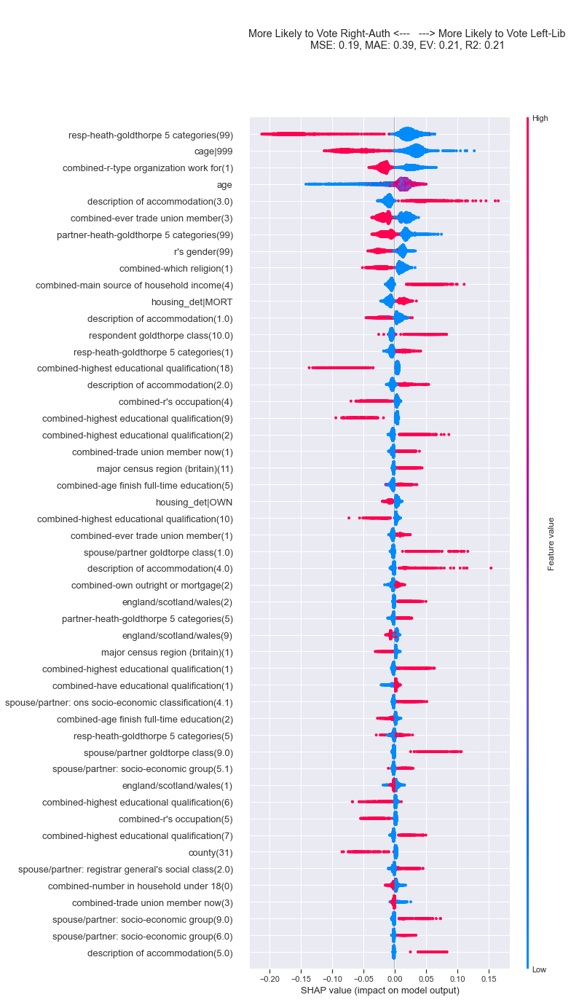

In [106]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [107]:
## 2010
ge = "2010"

In [108]:
# 'agor': 'region',

# 'aq62': 'gender',
# 'aq63': 'age',
# 'aq64': 'marital status',
# 'aq65_1': 'own or rent',
# 'aq65_2': 'own outright or mortgage',
# 'aq65_3': 'rent from whom',
# 'aq66_1': 'member trade union, staff assoc',
# 'aq66_2': 'ever member tu, staff assoc',
# 'aq67': 'age finish full-time education',
# 'aq68_1': 'have educ, work qualifications',
# 'aq68_2': 'highest qualification',
# 'aq69_1': 'belong to religion',
# 'aq69_2': 'which religion',
# 'aq69_4': 'how often participate religion',
# 'aq69_5': 'how often personal rel acitivites',
# 'aq70': 'annual family income',
# 'aq71': 'main source of income',
# 'aq72_1': 'how many people in household',
# 'aq72_2': 'people in household < 18',
# 'aq73_1': "r's occupation",
# 'aq73_2': 'spouse, partner occupation',
# 'aq74_1': "r's occupation sector",
# 'aq74_2': 'spouse, partner occup sector',
# 'aq75': 'ethnic group',

# 'aconsnam': 'constituency name',
# 'awardid': 'ward id',
# 'awardnam': 'ward name',
### 'tserial': '',
# 'region': 'region',
# 'bgor': 'standard region',

# 'consname': 'constituency name',
# 'wardid': 'ward id',
# 'wardname': 'ward name',
### 'prepost': 'pre-election & post-election respondents',
### 'prefilt': 'pre-election respondent filter',
### 'postfilt': 'post-election respondent filter',
### 'hserial': '',
# 'panumber': 'press association constituency number',
# 'seat': 'seat ',
# 'pregion': 'census region',


### confusing multiple sub-questionnaires!

In [109]:
# ge = "2005"
list( BES_label_list[ge].keys() ).index('aq62'),list( BES_label_list[ge].keys() ).index('aq75'),

(340, 363)

In [110]:
demo_vars = list( BES_label_list[ge].keys() )[340:364]
# demo_vars = list( BES_label_list[ge].keys() )[700:704]
# demo_vars +=list( BES_label_list[ge].keys() )[707:711]
# demo_vars +=list( BES_label_list[ge].keys() )[718:740]
demo_vars += ['agor','pregion','seat','panumber','bgor',
             'awardnam','awardid','aconsnam',] # 'bward',

# labels = BES_label_list[ge]
# pd.Series(labels).tail(500).to_dict()

In [111]:
# ge = "2005"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)
old_demo_vars = demo_vars.copy()
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

In [112]:
df_simp = df_simp.replace(99,np.nan).replace(999,np.nan)

In [113]:
pd.Series(df_simp.columns).value_counts()

ward id(00BRGN)                                       1
ward id(19UHGR)                                       1
ward id(00NNSZ)                                       1
constituency name(Sheffield South East Boro Const)    1
seat (Morley and Outwood)                             1
                                                     ..
age(90.0)                                             1
ward name(Airyhall/Broomhill/Garthdee Ward)           1
ward name(Tasburgh Ward)                              1
ward name(Beighton Ward)                              1
constituency name(East Renfrewshire Co Const)         1
Length: 1735, dtype: int64

[0]	validation_0-rmse:0.49906
[1]	validation_0-rmse:0.49841
[2]	validation_0-rmse:0.49779
[3]	validation_0-rmse:0.49717
[4]	validation_0-rmse:0.49675
[5]	validation_0-rmse:0.49558
[6]	validation_0-rmse:0.49488
[7]	validation_0-rmse:0.49401
[8]	validation_0-rmse:0.49291
[9]	validation_0-rmse:0.49182
[10]	validation_0-rmse:0.49084
[11]	validation_0-rmse:0.49038
[12]	validation_0-rmse:0.49027
[13]	validation_0-rmse:0.49017
[14]	validation_0-rmse:0.48980
[15]	validation_0-rmse:0.48908
[16]	validation_0-rmse:0.48922
[17]	validation_0-rmse:0.48867
[18]	validation_0-rmse:0.48820
[19]	validation_0-rmse:0.48795
[20]	validation_0-rmse:0.48745
[21]	validation_0-rmse:0.48709
[22]	validation_0-rmse:0.48730
[23]	validation_0-rmse:0.48720
[24]	validation_0-rmse:0.48669
[25]	validation_0-rmse:0.48649
[26]	validation_0-rmse:0.48654
[27]	validation_0-rmse:0.48641
[28]	validation_0-rmse:0.48638
[29]	validation_0-rmse:0.48611
[30]	validation_0-rmse:0.48588
[31]	validation_0-rmse:0.48552
[32]	validation_0-

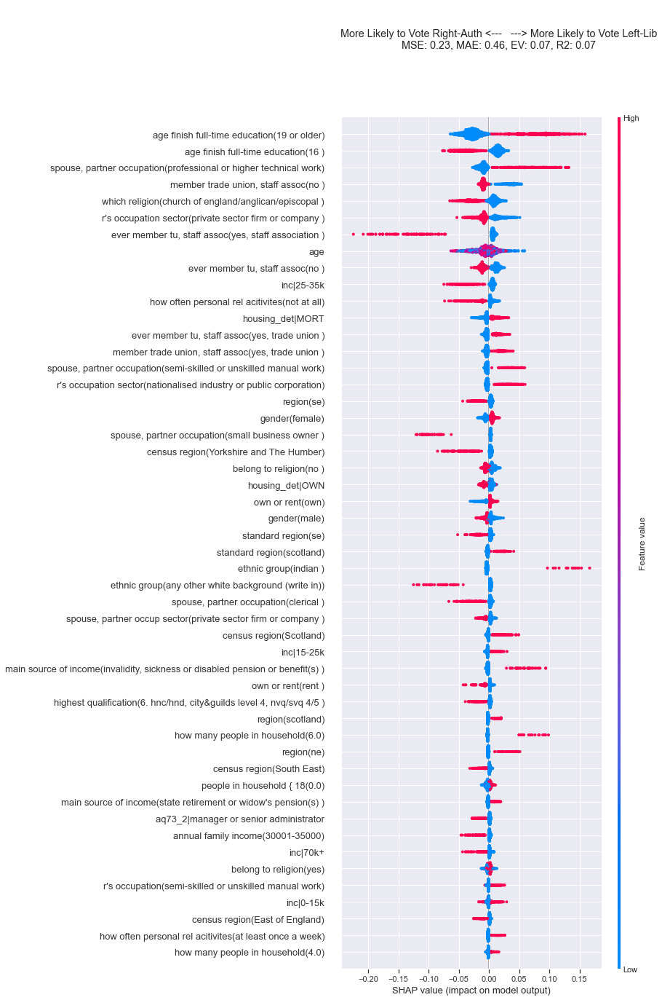

In [114]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [115]:
## 2015
ge = "2015"

In [116]:
# 'y01': 'Income - gross household',
# 'y02': 'Main source of income',
# 'y03': 'Y3 Which of these best describes where you live?',
# 'y04_01': 'Dependents: pre-school children',
# 'y04_02': 'Dependents: school children',
# 'y04_03': 'Dependents: Sick, disabled or elderly',
# 'y04_04': 'Dependents: None of the above',
# 'y04_05': "Dependents: Don't know",
# 'y04_06': 'Dependents: Not stated',
# 'y05': 'Y5 Did you ever go to a private fee-paying school in Britain?',
# 'y06': 'Y6 Do you regard yourself as belonging to any particular religion?',
# 'y07': 'Religious attendance',
# 'y08': 'Trade union/staff association member',
# 'y09': 'Gender',
# 'y11': 'Y11 Please choose one option that best describes your ethnic group or background',
# 'y12a': 'Y12A Do you have any educational or work-related qualifications?',
# 'education': 'Y13A What is the highest qualification you have?',
# 'y17': 'Working status',
# 'y17a': 'Y17A Have you been unemployed for less than 1 year or longer than that?',
# 'y18': 'Y18 Have you ever had a paid job at all, apart from any casual or holiday work?',
# 'y18a': 'Y18A Were you an employee or self employed?',
# 'y22': 'Y22 In your job, do/did you have any formal responsibility for supervising the w',
# 'y23': 'Y23 How many people work(ed) for your employer at the place where you work(ed)?',
# 'y24': 'Y24 Are/Were you working on your own or do/did you have employees?',
# 'y25': 'Y25 How many people do/did you employ at the place where you work(ed)?',
# 'y26': 'Marital Status',
# 'y27': 'Y27 What best describes what your spouse or partner does, or what they did last ',
# 'y36': 'Thinking back to when you were 16, who was Chief Income Earner (that is the pers',
# 'y37': 'Parent class',
# 'y45': 'Y45 Finally, as far as you know, is your name on the electoral register, that is',

# 'Age': 'Age at last birthday',

## look to be labels for type of constituency contest (Lab-LD)
## 'Stratum': 'Stratum',
## 'Stratumlabel': 'Stratum label',

# 'IMDquintile': 'IMD quintile 1 = most deprived through to 5 = least deprived. While ranking is s',
# 'Constit_Code': 'Constit_Code',
# 'Constit_Name': 'Constit_Name',
# 'LA_UA_Code': 'Local Authority Unitary Area code',
# 'LA_UA_Name': 'Local Authority Unitary Area name',

# 'Floor_of_dwelling': 'Floor of dwelling',

# 'pano': 'Press Association Constituency ID',

# 'gor': 'Government Office Region',
    
# 'dwel_type': 'Select dwelling type',
# 'ns_sec': 'NS-SEC occupational classification',
# 'ns_sec_analytic': 'NS-SEC occupational classification analytic class',
# 'edlevel': '',
# 'turnoutValidationReg': 'Vote validation outcome',

In [117]:
# ge = "2015"365
list( BES_label_list[ge].keys() ).index('IMDquintile'),list( BES_label_list[ge].keys() ).index('turnoutValidationReg'),

(454, 477)

In [118]:
demo_vars = list( BES_label_list[ge].keys() )[335:365]
demo_vars = list( BES_label_list[ge].keys() )[454:459]
demo_vars +=list( BES_label_list[ge].keys() )[473:477]
demo_vars += ['Floor_of_dwelling','pano','gor','Age'] # 'bward',

# labels = BES_label_list[ge]
# pd.Series(labels).tail(500).to_dict()

In [119]:
# ge = "2005"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)
old_demo_vars = demo_vars.copy()
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

[0]	validation_0-rmse:0.49707
[1]	validation_0-rmse:0.49388
[2]	validation_0-rmse:0.49145
[3]	validation_0-rmse:0.48919
[4]	validation_0-rmse:0.48770
[5]	validation_0-rmse:0.48625
[6]	validation_0-rmse:0.48472
[7]	validation_0-rmse:0.48333
[8]	validation_0-rmse:0.48198
[9]	validation_0-rmse:0.48073
[10]	validation_0-rmse:0.47995
[11]	validation_0-rmse:0.47934
[12]	validation_0-rmse:0.47880
[13]	validation_0-rmse:0.47808
[14]	validation_0-rmse:0.47733
[15]	validation_0-rmse:0.47634
[16]	validation_0-rmse:0.47581
[17]	validation_0-rmse:0.47532
[18]	validation_0-rmse:0.47503
[19]	validation_0-rmse:0.47449
[20]	validation_0-rmse:0.47406
[21]	validation_0-rmse:0.47378
[22]	validation_0-rmse:0.47340
[23]	validation_0-rmse:0.47298
[24]	validation_0-rmse:0.47274
[25]	validation_0-rmse:0.47277
[26]	validation_0-rmse:0.47259
[27]	validation_0-rmse:0.47260
[28]	validation_0-rmse:0.47243
[29]	validation_0-rmse:0.47207
[30]	validation_0-rmse:0.47207
[31]	validation_0-rmse:0.47203
[32]	validation_0-

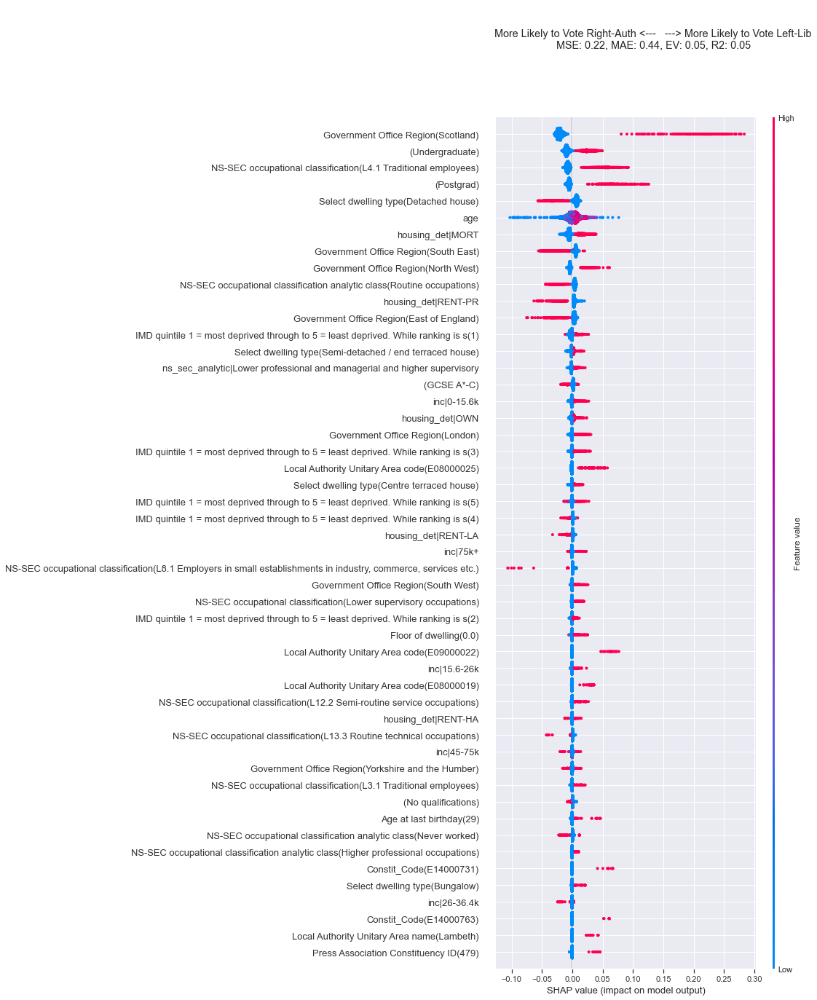

In [120]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [121]:
## 2017
ge = "2017"

In [122]:
# 'y01': 'Income - gross household',
# 'y03': 'Y3 Which of these best describes where you live?',
# 'y04_01': 'Dependents: pre-school children',
# 'y04_02': 'Dependents: school children',
# 'y04_03': 'Dependents: Sick, disabled or elderly',
# 'y04_04': 'Dependents: None of the above',
# 'y04_05': "Dependents: Don't know",
# 'y06': 'Y6 Do you regard yourself as belonging to any particular religion?',
# 'y07': 'Religious attendance',
# 'y08': 'Trade union/staff association member',
# 'y09': 'Gender',
# 'y10_banded': 'Y10. Please can you tell me your age at your last birthday',
# 'Age': 'Age at last birthday',
# 'y11': 'Y11. Please choose one option that best describes your ethnic group or backgroun',
# 'y12a': 'Y12A Do you have any educational or work-related qualifications?',
# 'education': 'Y13A. What is the highest qualification you have?',
# 'y17': 'Working status',
# 'y17a': 'Y17A Have you been unemployed for less than 1 year or longer than that?',
# 'y18': 'Y18 Have you ever had a paid job at all, apart from any casual or holiday work?',
# 'y18a': 'Y18A Were you an employee or self employed?',
# 'y22': 'Y22 In your job, do/did you have any formal responsibility for supervising the w',
# 'y23': 'Y23 How many people work(ed) for your employer at the place where you work(ed)?',
# 'y24': 'Y24 Are/Were you working on your own or do/did you have employees?',
# 'y25': 'Y25 How many people do/did you employ at the place where you work(ed)?',
# 'y26': 'Marital Status',
# 'y45': 'Y45 Finally, as far as you know, is your name on the electoral register, that is',

# 'q24_cses': 'CSES: Gender',
# 'q25_cses': 'Q25_CSES. And what was your age last birthday? Enter years YY',
# 'region': 'Region',

# 'Constit_Name': 'Parliamentary Constituency Name',
# 'Constit_Code': 'ONS Parliamentary Constituency identifier',
# 'pano': 'Press Association Constituency ID',

# 'ns_sec': 'NS-SEC occupational classification',
# 'ns_sec_analytic': 'NS-SEC occupational classification analytic class',
# 'seg': 'Socio-economic group',
# 'sc': 'Social Class based on Occupation',

In [123]:
# ge = "2015"365
list( BES_label_list[ge].keys() ).index('ns_sec'),list( BES_label_list[ge].keys() ).index('sc'),

(358, 361)

In [124]:
ge="2017"
list( BES_label_list[ge].keys() )[238:266]

['y01',
 'y03',
 'y04_01',
 'y04_02',
 'y04_03',
 'y04_04',
 'y04_05',
 'y06',
 'y07',
 'y08',
 'y09',
 'y10_banded',
 'Age',
 'y11',
 'y12a',
 'education',
 'y17',
 'y17a',
 'y18',
 'y18a',
 'y22',
 'y23',
 'y24',
 'y25',
 'y26',
 'y45',
 'y46a',
 'y47']

In [125]:
demo_vars = list( BES_label_list[ge].keys() )[238:266]
demo_vars = list( BES_label_list[ge].keys() )[335:338]
demo_vars +=list( BES_label_list[ge].keys() )[340:343]
demo_vars +=list( BES_label_list[ge].keys() )[358:362]
# demo_vars += ['Floor_of_dwelling','pano','gor','Age'] # 'bward',

# labels = BES_label_list[ge]
# pd.Series(labels).tail(500).to_dict()

In [126]:
# ge = "2005"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)
old_demo_vars = demo_vars.copy()
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

[0]	validation_0-rmse:0.49912
[1]	validation_0-rmse:0.49758
[2]	validation_0-rmse:0.49650
[3]	validation_0-rmse:0.49580
[4]	validation_0-rmse:0.49486
[5]	validation_0-rmse:0.49446
[6]	validation_0-rmse:0.49423
[7]	validation_0-rmse:0.49315
[8]	validation_0-rmse:0.49276
[9]	validation_0-rmse:0.49239
[10]	validation_0-rmse:0.49180
[11]	validation_0-rmse:0.49153
[12]	validation_0-rmse:0.49100
[13]	validation_0-rmse:0.49071
[14]	validation_0-rmse:0.49044
[15]	validation_0-rmse:0.49033
[16]	validation_0-rmse:0.49034
[17]	validation_0-rmse:0.49028
[18]	validation_0-rmse:0.49024
[19]	validation_0-rmse:0.49023
[20]	validation_0-rmse:0.49022
[21]	validation_0-rmse:0.48978
[22]	validation_0-rmse:0.48979
[23]	validation_0-rmse:0.48979
[24]	validation_0-rmse:0.48971
[25]	validation_0-rmse:0.48979
[26]	validation_0-rmse:0.48962
[27]	validation_0-rmse:0.48948
[28]	validation_0-rmse:0.48917
[29]	validation_0-rmse:0.48916
[30]	validation_0-rmse:0.48916
[31]	validation_0-rmse:0.48884
[32]	validation_0-

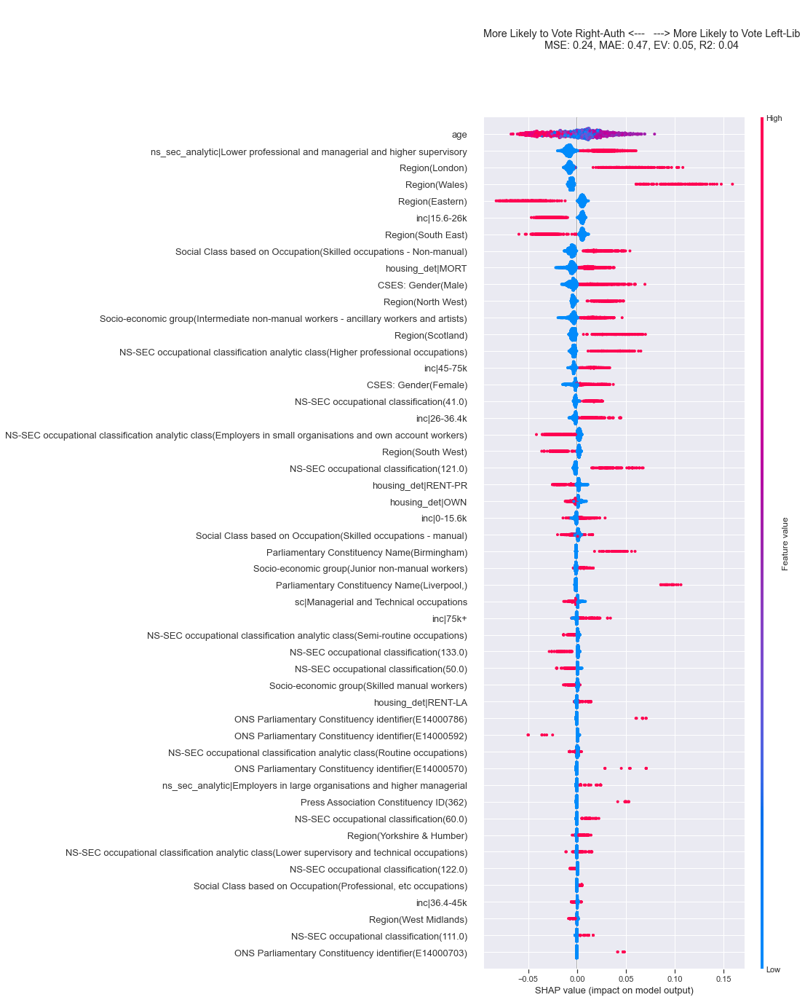

In [127]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [128]:
## 2019
ge = "2019"

In [129]:
# 'Y10B1': 'A British Citizen',
# 'Y10B2': 'A Citizen of the Republic of Ireland',
# 'Y10B3': 'A Citizen of a Commonwealth country who has a ?right to remain? in the UK',
# 'Y10B4': 'A Citizen of an EU country',
# 'Y10B5': 'None of these',

# 'y01a': 'Thinking about the total income of your household from all sources before tax - ',
# 'Y01_detailed': 'What is the total annual income of your household from all sources before tax - ',
# 'y01_Annual': 'Income - gross household (Annual)',
# 'y01_Weekly': 'Income - gross household (Weekly)',
# 'y01_Monthly': 'Income - gross household (Monthly)',
# 'y02_1': 'Main source of income: Earnings from employment',
# 'y02_2': 'Main source of income: Occupational pension',
# 'y02_3': 'Main source of income: Private pension',
# 'y02_4': 'Main source of income: State retirement or bereavement allowance',
# 'y02_5': "Main source of income: Jobseeker's Allowance/unemployment benefits",
# 'y02_6': 'Main source of income: Pensioner credit/income support/Minimum Income Guarantee',
# 'y02_7': 'Main source of income: Invalidity, sickness, or disabled pension or benefits',
# 'y02_8': 'Main source of income: Other state benefit or tax credit',
# 'y02_9': 'Main source of income: Interest from savings or investments',
# 'y02_10': 'Main source of income: Student grant, bursary, or loans',
# 'y02_11': 'Main source of income: Dependent on parents/other relatives',
# 'y02_12': 'Main source of income: Other main source',
# 'y02_13': 'Main source of income: Prefer not to say',
# 'y02_14': 'Main source of income: Property/rental income',
# 'y02_15': 'Main source of income: Refused/no answer',
# 'y02_16': 'Main source of income: Benefit/allowance/UC/tax credit',
# 'y03': 'Which of these best describes where you live?',
# 'y04_01': 'Dependents: Pre-school children',
# 'y04_02': 'Dependents: School children',
# 'y04_03': 'Dependents: Sick, disabled or elderly',
# 'y04_04': 'Dependents: None of the above',
# 'y04_05': "Dependents: Don't know",
# 'y05': 'Did you ever go to a private fee-paying school in the UK?',
# 'y06': 'Do you regard yourself as belonging to any particular religion?',
# 'y06b': 'Which religion do you consider yourself as belonging to?',
# 'y07': 'Religious attendance',
# 'y08': 'Trade union/staff association member',
# 'y09': 'Gender',
# 'Age': 'Age at last birthday',
# 'y10_banded': 'Age at last birthday (banded)',
# 'y11': 'Ethnic group or background',
# 'y12a': 'Do you have any educational or work-related qualifications?',
# 'education': 'What is the highest qualification you have?',
# 'y17': 'Working status',
# 'y17a': 'Have you been unemployed for less than 1 year or longer than that?',
# 'y18': 'Have you ever had a paid job? (Excluding from casual/holiday work)',
# 'y18a': 'Were you an employee or self employed?',
# 'y22': 'Do you supervise or are you responsible for the work of other people?',
# 'y23': 'How many people work[ed] for your employer at the place where you work[ed]?',
# 'y24': 'Do/did you work on your own or do/did you have employees?',
# 'y25': 'How many people do/did you employ at the place where you work[ed]?',
# 'y25a': 'Which of these types of organisation do/will/did you work[ed] for?',
# 'y26': 'Marital status',
# 'y27': 'Which of the following best describes your sexuality?',
# 'y45': 'Is your name on the electoral register?',   

# 'Q20_CSES': 'Were either or both of your parents born outside of Britain?',
# 'Q21_CSES': 'What language do you usually speak at home?',
# 'Q22_CSES': 'What date did you complete this questionnaire?',
## 'Q23_CSES': 'Gender',
# 'Q24_CSES': 'Age',

# 'region': 'Region',

# 'Constit_Code': 'Constituency code',
# 'Constit_Name': 'Constituency name',
# 'LA_UA_Code': 'Local Authority Unitary Area code',
# 'LA_UA_Name': 'Local Authority Unitary Area name',

# 'dwelling_type': 'Type of dwelling',
# 'total_num_dwel': 'Total number of dwellings',
# 'total_num_hous': 'Total number of households',
# 'num_elig_people': 'Number of eligible people',

# 'ns_sec': 'NS-SEC code',
# 'ns_sec_analytic': 'NS-SEC code (analytic version)',
# 'edlevel': 'Education level (summary)',
# 'pano': 'Press Association Constituency ID',    

In [130]:
# ge = "2015"365
list( BES_label_list[ge].keys() ).index('ns_sec'),list( BES_label_list[ge].keys() ).index('Q22_CSES'),

(405, 385)

In [131]:
demo_vars = list( BES_label_list[ge].keys() )[3:8]
demo_vars = list( BES_label_list[ge].keys() )[273:323]
demo_vars +=list( BES_label_list[ge].keys() )[383:386]
demo_vars +=list( BES_label_list[ge].keys() )[394:398]

demo_vars +=list( BES_label_list[ge].keys() )[400:404]
demo_vars +=list( BES_label_list[ge].keys() )[405:409]
demo_vars += ['region','Q24_CSES']

# labels = BES_label_list[ge]
# pd.Series(labels).tail(500).to_dict()

In [132]:
# ge = "2005"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)
old_demo_vars = demo_vars.copy()
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

In [133]:
# pd.Series(df_simp.columns).value_counts()

[0]	validation_0-rmse:0.49611
[1]	validation_0-rmse:0.49347
[2]	validation_0-rmse:0.48959
[3]	validation_0-rmse:0.48707
[4]	validation_0-rmse:0.48434
[5]	validation_0-rmse:0.48210
[6]	validation_0-rmse:0.47957
[7]	validation_0-rmse:0.47760
[8]	validation_0-rmse:0.47595
[9]	validation_0-rmse:0.47440
[10]	validation_0-rmse:0.47316
[11]	validation_0-rmse:0.47168
[12]	validation_0-rmse:0.47046
[13]	validation_0-rmse:0.46936
[14]	validation_0-rmse:0.46824
[15]	validation_0-rmse:0.46726
[16]	validation_0-rmse:0.46627
[17]	validation_0-rmse:0.46572
[18]	validation_0-rmse:0.46486
[19]	validation_0-rmse:0.46468
[20]	validation_0-rmse:0.46387
[21]	validation_0-rmse:0.46330
[22]	validation_0-rmse:0.46276
[23]	validation_0-rmse:0.46226
[24]	validation_0-rmse:0.46165
[25]	validation_0-rmse:0.46158
[26]	validation_0-rmse:0.46130
[27]	validation_0-rmse:0.46090
[28]	validation_0-rmse:0.46055
[29]	validation_0-rmse:0.46031
[30]	validation_0-rmse:0.46032
[31]	validation_0-rmse:0.46006
[32]	validation_0-

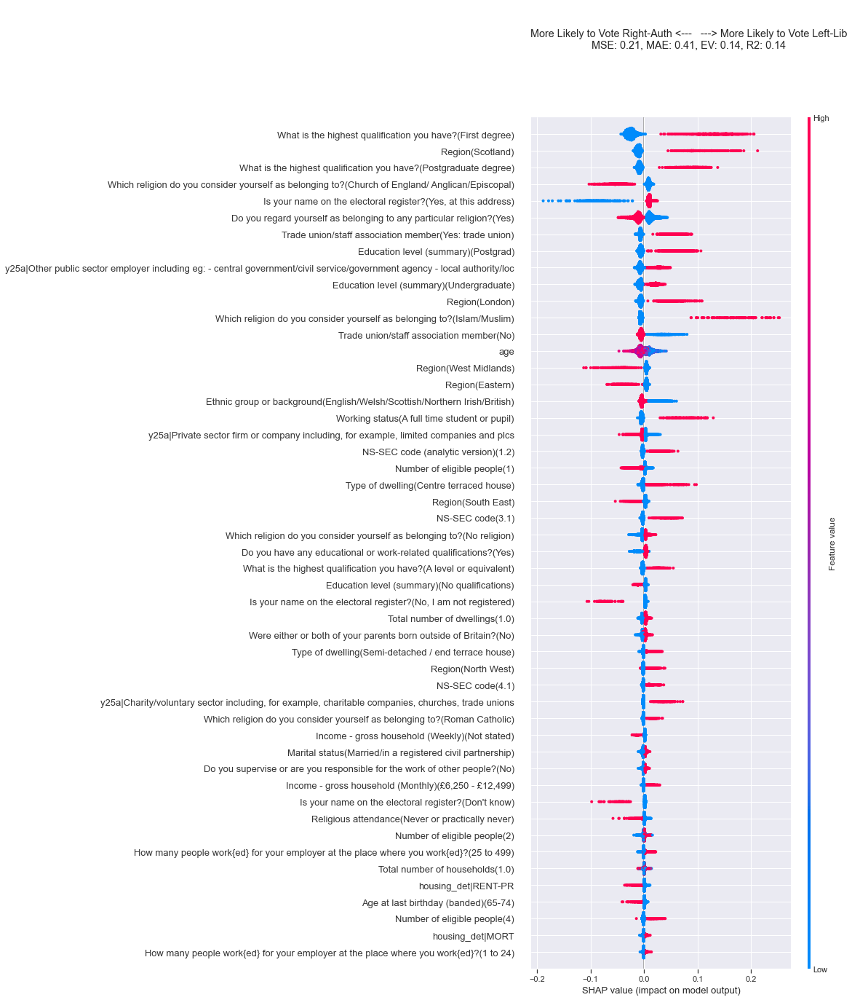

In [134]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [135]:
##### 64-70
ge = "1964"

In [136]:
# 'v31': 'CONSTITUENCY NUMBER 1963',
# 'v32': 'CONSTITUENCY NUMBER 1964',
# 'v33': 'CONSTITUENCY NUMBER 1966',
# 'v34': 'CONSTITUENCY NUMBER 1970',
# 'v35': 'REGION              1963',
# 'v36': 'REGION              1964',
# 'v37': 'REGION              1966',
# 'v38': 'REGION              1970',
# 'v39': 'TYPE OF CONSTITUENCY  63',
# 'v40': 'TYPE OF CONSTITUENCY  64',
# 'v41': 'TYPE OF CONSTITUENCY  66',
# 'v42': 'TYPE OF CONSTITUENCY  70',
    
# 'v851': 'AGE LEFT SCHOOL',
# 'v852': 'AGE LEFT SCHOOL     1970',
# 'v853': 'KIND OF SCHOOL',
# 'v854': 'KIND OF SCHOOL      1970',
# 'v855': 'STAY SCHL PAST MIN AGE70',
# 'v856': 'ED AFTER LEAVING SCHOOL',
# 'v857a': 'POST-SCHOOL EDUC MR2 (1)',
# 'v857b': 'POST-SCHOOL EDUC MR2 (2)',
# 'v858': 'IF R HAS JOB        1964',
# 'v859': 'IF R IS MEMBER OF TU  64',
    
# 'v878': 'TU MBR IN HOUSEHOLD?  64',
    
# 'v890': 'WHERE PARENTS WHEN BORN',
# 'v891': 'WHERE WHEN BORN-EXPANDED',
# 'v892': 'SIZE OF PLACE OF BIRTH64',
# 'v893': 'PARENTS FR BIRTHPLACE 63',
# 'v894': 'FATHER WAS BROUGHT UP 63',
# 'v895': 'REGION FATHER FROM  1963',
# 'v896': 'WHERE FATHER BROUGHT UP',
# 'v897': 'SIZE TOWN FATHER FROM 64',
# 'v898': 'MOTHER WAS BROUGHT UP 63',
# 'v899': 'REGION MOTHER FROM  1963',
# 'v900': 'WHERE MOTHER BROUGHT UP',
# 'v901': 'SIZE TOWN MOTHER FROM 64',
# 'v902': 'R LIVED IN CHILDHOOD',
# 'v903': 'REGION R LIVED (CHILD)',
# 'v904a': 'CNTYS R LIVED (CHILD) (1)',
# 'v904b': 'CNTYS R LIVED (CHILD) (2)',
# 'v905': 'SIZE OF PLACE R LIVED 64',
# 'v906': 'WHERE R HAS LIVED',
# 'v907': 'REGIONS R HAS LIVED 1963',
# 'v908a': 'R LIVED SINCE CHILD MR66 (1)',
# 'v908b': 'R LIVED SINCE CHILD MR66 (2)',
# 'v909': 'R NOW LIVES         1963',
# 'v910': 'RESIDENTIAL MOBILITY  66',
# 'v911': 'YRS R LIVED IN AREA',
# 'v912': 'YRS R LIVED IN HOUSE  63',
# 'v913': 'YRS R LIVED IN HOUSE  64',
# 'v914': 'YRS R LIVED IN HOUSE  70',
# 'v915': 'IF RENTS OR OWNS HOME 63',
# 'v916': 'IF RENTS OR OWNS HOME 64',
# 'v917': 'IF RENTS OR OWNS HOME 70',
# 'v918': 'EXPECT TO MOVE NXT YR 70',
# 'v919': 'WHERE MOVING TO     1970',
# 'v920': "RESPONDENT'S RELIGION",
# 'v921': 'PARENTS SHARE RELIGION',
# 'v922': 'RELIGION OF FATHER',
# 'v923': 'RELIGION OF MOTHER',
# 'v924': 'ATTEND CHURCH/SYNAGOGUE',
# 'v925': 'SERVED IN MILITARY',
# 'v926': 'TYPE MILITARY SERVICE 64',
# 'v927': 'TIME OF MILITARY SERVICE',
# 'v928': 'SERVED OVERSEAS',
# 'v929': 'SEX                 1963',
# 'v930': 'SEX                 1964',
# 'v931': 'SEX                 1966',
# 'v932': 'SEX                 1970',
# 'v933': 'MARITAL STATUS      1963',
# 'v934': 'MARITAL STATUS      1964',
# 'v935': 'MARITAL STATUS      1966',
# 'v936': 'MARITAL STATUS      1970',
# 'v937': 'DATE OF BIRTH       1970',
# 'v938': 'AGE IN YEARS        1963',
# 'v939': 'AGE IN YEARS        1964',
# 'v940': 'AGE IN YEARS        1966',
# 'v941': 'AGE IN YEARS        1970',
# 'v942': 'AGE IN DECADES      1963',
# 'v943': 'AGE IN DECADES      1964',
# 'v944': 'AGE IN DECADES      1966',
# 'v945': 'AGE IN DECADES      1970',
# 'v946': 'NO. CHILDREN IN HOME  63',
# 'v947': 'NO. CHILDREN IN HOME  64',
# 'v948': 'NO. CHILDREN IN HOME  66',
# 'v949': 'NO. CHILDREN IN HOME  70',
# 'v950': 'NO. OTHER CHILDREN  1970',
# 'v951': 'PERSON TO BE GRADED 1963',
# 'v952': 'PERSON TO BE GRADED 1964',
# 'v953': 'PERSON TO BE GRADED 1966',
# 'v954': 'PERSON TO BE GRADED 1970',
# 'v955': 'OCCUPATION - H.H    1963',
# 'v956': 'OCCUPATION - H.H    1964',
# 'v957': 'OCCUPATION - H.H    1966',
# 'v958': 'OCCUPATION - H.H    1970',
# 'v959': 'ECONOMIC STATUS - H.H 63',
# 'v960': 'ECONOMIC STATUS - H.H 64',
# 'v961': 'ECONOMIC STATUS - H.H 66',
# 'v962': 'ECONOMIC STATUS - H.H 70',
# 'v963': 'OCCUPATION GRADE- H.H 63',
# 'v964': 'OCCUPATION GRADE- H.H 64',
# 'v965': 'OCCUPATION GRADE- H.H 66',
# 'v966': 'OCCUPATION GRADE- H.H 70',
# 'v967': 'SOCIO-ECON GROUP- H.H 63',
# 'v968': 'SOCIO-ECON GROUP- H.H 64',
# 'v969': 'SOCIO-ECON GROUP- H.H 66',
# 'v970': 'SOCIO-ECON GROUP- H.H 70',
# 'v971': 'OCCUPATION - R      1963',
# 'v972': 'OCCUPATION - R      1964',
# 'v973': 'OCCUPATION - R      1966',
# 'v974': 'OCCUPATION - R      1970',
# 'v975': 'ECONOMIC STATUS - R 1963',
# 'v976': 'ECONOMIC STATUS - R 1964',
# 'v977': 'ECONOMIC STATUS - R 1966',
# 'v978': 'ECONOMIC STATUS - R 1970',
# 'v979': 'OCCUP GRADE(6) - R  1963',
# 'v980': 'OCCUP GRADE(6) - R  1964',
# 'v981': 'OCCUPATION GRADE - R  66',
# 'v982': 'OCCUPATION GRADE - R  70',
# 'v983': 'SOCIO-ECON GROUP - R  63',
# 'v984': 'SOCIO-ECON GROUP - R  64',
# 'v985': 'SOCIO-ECON GROUP - R  66',
# 'v986': 'SOCIO-ECON GROUP - R  70',
# 'v987': 'OCCUPATION - HUSBAND  70',
# 'v988': 'ECON STATUS - HUSBAND 70',
# 'v989': 'OCCUP GRADE - HUSBAND 70',
# 'v990': 'SOCIO-ECON GROUP-HSBD 70',
# 'v991': 'OCCUPATION - FATHER   63',
# 'v992': 'OCCUPATION - FATHER   64',
# 'v993': 'OCCUPATION - FATHER   66',
# 'v994': 'ECON STATUS - FATHER  63',
# 'v995': 'ECON STATUS - FATHER  64',
# 'v996': 'ECON STATUS - FATHER  66',
# 'v997': 'OCCUP GRADE(6)-FATHER 63',
# 'v998': 'OCCUP GRADE(7)-FATHER 63',
# 'v999': 'OCCUP GRADE(7)-FATHER 64',
# 'v1000': 'OCCUP GRADE(7)-FATHER 66',
# 'v1001': 'SOCIO-ECON GRP-FATHER 63',
# 'v1002': 'SOCIO-ECON GRP-FATHER 64',
# 'v1003': 'SOCIO-ECON GRP-FATHER 66',
# 'v1004': 'INCOME GROUP - H.H    63',
# 'v1005': 'INCOME GROUP - H.H    64',
# 'v1006': 'INCOME GROUP - H.H    66',
# 'v1007': 'INCOME GROUP - H.H    70',
# 'v1008': 'IS INCOME ESTIMATED-HH63',
# 'v1009': 'IS INCOME ESTIMATED-HH64',
# 'v1010': 'IS INCOME ESTIMATED-HH66',
# 'v1011': 'IS INCOME ESTIMATED-HH70',
# 'v1012': 'IS INCOME NOT FOR H.H?63',
# 'v1013': 'INCOME GROUP - R    1964',
# 'v1014': 'INCOME GROUP - R    1966',
# 'v1015': 'INCOME GROUP - R    1970',
# 'v1016': 'IS INCOME ESTIMATED-R 64',
# 'v1017': 'IS INCOME ESTIMATED-R 70',
# 'v1018': 'OCCUP-HRS/WEEK - R  1966',
# 'v1019': 'OCCUP-HRS/WEEK - R  1970',    


# 'v1125': 'LOCAL WARD          1963',


# 'v1208': 'AGE COHORTS         1963',
# 'v1209': 'AGE COHORTS         1964',
# 'v1210': 'AGE COHORTS         1966',
# 'v1211': 'AGE COHORTS         1970',
# 'v1212': 'EDUCATION GENERATIONS 63',
# 'v1213': 'EDUCATION GENERATIONS 66',
# 'v1214': 'SCHOOL LEAVING INDEX',
# 'v1215': 'INCOME - 5 GROUPS   1963',
# 'v1216': 'INCOME - 5 GROUPS   1964',
# 'v1217': 'INCOME - 5 GROUPS   1966',
# 'v1218': 'INCOME - 5 GROUPS   1970',
    
# 'v1222': 'EMPLOYMENT STATUS OF R64',
# 'v1223': 'URBAN/RURAL CODE    1964',
# 'v1224': 'MINING/RESORT/AGRIC   64',

# 'v1231': 'IRISH ORIGIN        1963',
# 'v1232': 'RESIDENTIAL MOBILITY  63',    

In [137]:
# len(BES_label_list["1964"]),len(BES_label_list["1966"]),len(BES_label_list["1970"]),
# ge = "2015"365
list( BES_label_list[ge].keys() ).index('v1208'),list( BES_label_list[ge].keys() ).index('v1218'),

(1428, 1438)

In [138]:
demo_vars = list( BES_label_list[ge].keys() )[34:42]
demo_vars = list( BES_label_list[ge].keys() )[1068:1078]
demo_vars +=list( BES_label_list[ge].keys() )[1108:1240]
demo_vars +=list( BES_label_list[ge].keys() )[1428:1439]

# demo_vars +=list( BES_label_list[ge].keys() )[400:404]
# demo_vars +=list( BES_label_list[ge].keys() )[405:409]
demo_vars += ['v878','v1125','v1231','v1232','v1222','v1223','v1224']

# labels = BES_label_list[ge]
# pd.Series(labels).tail(500).to_dict()

In [139]:
# BES_df_list[ge]["v524"].value_counts()

## some information about 1959 through recall vote!

# BES_df_list[ge]["v1165"].value_counts() ## all past votes pre war???

In [140]:
# ge = "2005"
labels = BES_label_list[ge]
df = pd.concat([BES_df_list[ge],
                        f2f_harmonised[f2f_harmonised["dataset"]==ge][
                            ["vote","vote_simple","bloc","wt","age","housing_det","inc"]
                        ]
                       ],axis=1)
old_demo_vars = demo_vars.copy()
demo_vars = demo_vars+["bloc","wt","age","housing_det","inc"]
demo_vars = list(set(demo_vars).intersection(df.columns))

df_simp = df[demo_vars].copy()

df_simp["bloc"] = df_simp["bloc"].replace({"Neither":np.nan})
df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')
df_simp = pd.get_dummies(df_simp,prefix_sep='|').drop("bloc|Right-Auth",axis=1)

df_simp = df_simp.rename(columns = replace_var_names(labels))  

[0]	validation_0-rmse:0.49726
[1]	validation_0-rmse:0.49495
[2]	validation_0-rmse:0.49317
[3]	validation_0-rmse:0.49166
[4]	validation_0-rmse:0.48937
[5]	validation_0-rmse:0.48760
[6]	validation_0-rmse:0.48583
[7]	validation_0-rmse:0.48454
[8]	validation_0-rmse:0.48284
[9]	validation_0-rmse:0.48103
[10]	validation_0-rmse:0.47968
[11]	validation_0-rmse:0.47784
[12]	validation_0-rmse:0.47736
[13]	validation_0-rmse:0.47660
[14]	validation_0-rmse:0.47555
[15]	validation_0-rmse:0.47449
[16]	validation_0-rmse:0.47447
[17]	validation_0-rmse:0.47365
[18]	validation_0-rmse:0.47293
[19]	validation_0-rmse:0.47220
[20]	validation_0-rmse:0.47146
[21]	validation_0-rmse:0.47137
[22]	validation_0-rmse:0.47075
[23]	validation_0-rmse:0.47010
[24]	validation_0-rmse:0.46929
[25]	validation_0-rmse:0.46892
[26]	validation_0-rmse:0.46880
[27]	validation_0-rmse:0.46852
[28]	validation_0-rmse:0.46829
[29]	validation_0-rmse:0.46820
[30]	validation_0-rmse:0.46784
[31]	validation_0-rmse:0.46754
[32]	validation_0-

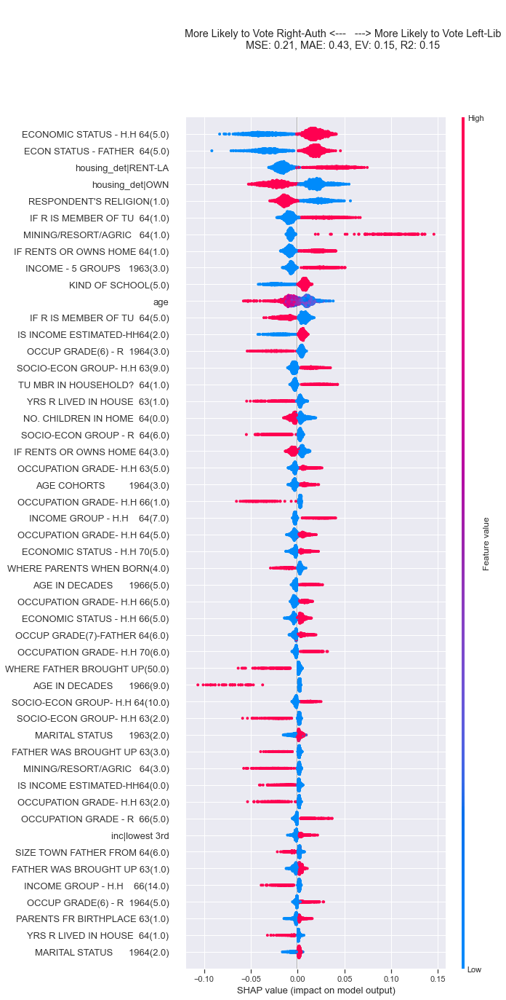

In [141]:
var_stub = "bloc|Left-Lib"
Treatment = var_stub+"_"+ge

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp = df_simp.astype('float')
mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
colname = var_stub
(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=df_simp["wt"][mask],
            min_features = min(df_simp.shape[1]-1,50),
            title = "\n\nMore Likely to Vote Right-Auth <---   ---> More Likely to Vote Left-Lib")

In [142]:
import pyreadstat    
dataframe, meta = pyreadstat.read_dta("E:\\BES_analysis_data\\63-70\\STATA63-70PoliticalChangeinBritainData.dta")

In [143]:
import pyreadstat 
dataframe, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\63-70\\SPSS63-70PoliticalChangeinBritainData.sav", apply_value_formats=True)

In [144]:
meta.variable_value_labels

{}

In [145]:
meta.variable_measure

{'v1': 'nominal',
 'v2': 'scale',
 'v3': 'scale',
 'v4': 'scale',
 'v5': 'scale',
 'v6': 'nominal',
 'v7': 'nominal',
 'v8': 'nominal',
 'v9': 'nominal',
 'v10': 'nominal',
 'v11': 'nominal',
 'v12': 'nominal',
 'v13': 'nominal',
 'v14': 'nominal',
 'v15': 'nominal',
 'v16': 'nominal',
 'v17': 'nominal',
 'v18': 'nominal',
 'v19': 'nominal',
 'v20': 'nominal',
 'v21': 'nominal',
 'v22': 'nominal',
 'v23': 'nominal',
 'v24': 'nominal',
 'v25': 'nominal',
 'v26': 'nominal',
 'v27': 'nominal',
 'v28': 'nominal',
 'v29': 'nominal',
 'v30': 'nominal',
 'v31': 'scale',
 'v32': 'scale',
 'v33': 'scale',
 'v34': 'scale',
 'v35': 'nominal',
 'v36': 'nominal',
 'v37': 'nominal',
 'v38': 'nominal',
 'v39': 'nominal',
 'v40': 'nominal',
 'v41': 'nominal',
 'v42': 'nominal',
 'v43': 'scale',
 'v44': 'scale',
 'v45': 'scale',
 'v46': 'scale',
 'v47': 'scale',
 'v48': 'scale',
 'v49': 'scale',
 'v50': 'scale',
 'v51': 'scale',
 'v52': 'scale',
 'v53': 'scale',
 'v54': 'scale',
 'v55': 'nominal',
 'v5

In [146]:
dataframe.stack().value_counts()
dataframe.isnull().sum()

v1          0
v2          0
v3       1094
v4        840
v5       1567
         ... 
v1242    2294
v1243       0
v1244       0
v1245       0
v1246       0
Length: 1467, dtype: int64

In [147]:
### load and save 'variable type' information from sav meta dictionaries

In [148]:
import pyreadstat 
dataframe, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\63-70\\SPSS63-70PoliticalChangeinBritainData.sav")

In [149]:
# print(meta.column_names)
# print(meta.column_labels)
# print(meta.column_names_to_labels)
# print(meta.number_rows)
# print(meta.number_columns)
# print(meta.file_label)
print(meta.file_encoding)

WINDOWS-1252


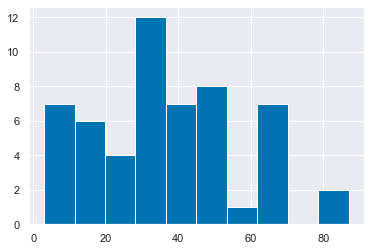

In [150]:
dataframe["v138c"].hist()

In [151]:
# dataframe.shape

In [152]:
# BES_df_list[ge_df].shape

In [153]:
# set(BES_df_list[ge_df].columns)-set(dataframe.columns)

In [154]:
## replace *scale* variables with spss versions? (ah, wait - *I* made those variables!)

In [155]:
# meta.missing_ranges
# meta.missing_user_values
# meta.notes
# meta.value_labels
# meta.variable_to_label
# meta.variable_value_labels
print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)
print(meta.value_labels)
print(meta.variable_to_label)
print(meta.variable_value_labels)

{}
{}
[]
{}
{}
{}


In [156]:
pd.Series(meta.original_variable_types).value_counts()

F1.0    1065
F2.0     348
F3.0      41
F4.1       7
F4.0       6
dtype: int64

In [157]:
# meta.variable_display_width
pd.Series(meta.variable_display_width).value_counts()

6    853
7    535
5     75
4      4
dtype: int64

In [158]:
meta.variable_storage_width
pd.Series(meta.variable_storage_width).value_counts()

8    1467
dtype: int64

In [159]:
meta.variable_measure
pd.Series(meta.variable_measure).value_counts()

nominal    1264
scale       203
dtype: int64

In [160]:
var_type_dict = {}

In [161]:
var_type_dict["1964"] = meta.variable_measure
var_type_dict["1966"] = meta.variable_measure
var_type_dict["1970"] = meta.variable_measure

In [162]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\74_february\\74feb.sav")

In [163]:
print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)
# print(meta.value_labels)
# print(meta.variable_to_label)
# print(meta.variable_value_labels)

{}
{}
[]


In [164]:
# BES_df_list["1974_feb"]
var_type_dict["1974_feb"] = meta.variable_measure


In [165]:
pd.Series(meta.variable_measure).value_counts()

ordinal    247
scale       37
nominal     22
dtype: int64

In [166]:
# var_type_dict["1974_feb"]

In [167]:
# BES_df_list[ge][pd.Series(meta.variable_measure)[pd.Series(meta.variable_measure)=="scale"].index]

In [168]:
# BES_df_list["1974_feb"][list(pd.Series(meta.variable_measure)[pd.Series(meta.variable_measure)=="scale"].index)]

In [169]:
# pd.Series(BES_label_list["1974_feb"]).loc[list(pd.Series(meta.variable_measure)[pd.Series(meta.variable_measure)=="scale"].index)]

In [170]:
# pd.Series(BES_label_list["1974_feb"]).loc[list(pd.Series(meta.variable_measure)[pd.Series(meta.variable_measure)=="ordinal"].index)]

In [171]:
# pd.Series(BES_label_list["1974_feb"]).loc[list(pd.Series(meta.variable_measure)[pd.Series(meta.variable_measure)=="nominal"].index)]

In [172]:
# BES_df_list["1974_feb"]["feb280"].value_counts()

In [173]:
# BES_df_list["1974_feb"]["feb281"].value_counts()

In [174]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\74_october\\74oct.sav")
var_type_dict["1974_oct"] = meta.variable_measure

print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [175]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\79\\79BES.sav")
var_type_dict["1979"] = meta.variable_measure

print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [176]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\83\\83BES_resaved.sav")
var_type_dict["1983"] = meta.variable_measure
## bug with original file!


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [177]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\87\\87BES_resaved.sav")
var_type_dict["1987"] = meta.variable_measure
## bug with original file!


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [178]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\92\\92BES_resaved.sav")
var_type_dict["1992"] = meta.variable_measure
## bug with original file!


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [179]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\97\\97BES.sav")
var_type_dict["1997"] = meta.variable_measure
## bug with original file!


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [180]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\01\\prepostagg_resaved.sav", encoding="latin1")
var_type_dict["2001"] = meta.variable_measure
## bug with original file!


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [181]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\05_post_election\\2005BESb.sav")
#, encoding="latin1")
var_type_dict["2005"] = meta.variable_measure


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes) # finally some notes!

{}
{}
['The British Parliamentary Constituency Database, 1992-2005', 'Compiled by Pippa Norris', 'Release 1.2 12th May 2005', '-----------------------------------------------------------', 'Notes and sources:', '', 'It should be noted that a second version will be released in late summer', '2005, after the 2005 election results have been officially corrected by the', 'Press Association.', '', "Information about the notional '1992' vote under the revised boundaries in the", 'UK is based on Colin Rallings and Michael Thrasher Media Guide to the New', 'Parliamentary Constituencies (BBC/ITN.PA News/Sky 1995).', '', "Information about the notional '2001' vote under the revised boundaries in", 'Scotland is based on David Denver, Colin Rallings and Michael Thrasher. Eds.', '2004. Media Guide to the New Scottish Westminster Parliamentary Constituencies.', 'Plymouth: University of Plymouth.', '', 'The classification of the names, gender and ethnicity of prospective', 'parliamentary candidates w

In [182]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\10\\2010BESPreandPost.sav")
#, encoding="latin1")
var_type_dict["2010"] = meta.variable_measure
# mostly unknown


print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes) # big notes!

{}
{}
['The British Parliamentary Constituency Database, 1992-2005', 'Compiled by Pippa Norris', 'Release 1.3 13th June 2005', '-----------------------------------------------------------', 'Notes and sources:', '', 'It should be noted that a second version will be released in late summer', '2005, after the 2005 election results have been officially corrected by the', 'Press Association.', '', "Information about the notional '1992' vote under the revised boundaries in the", 'UK is based on Colin Rallings and Michael Thrasher Media Guide to the New', 'Parliamentary Constituencies (BBC/ITN.PA News/Sky 1995).', '', "Information about the notional '2001' vote under the revised boundaries in", 'Scotland is based on David Denver, Colin Rallings and Michael Thrasher. Eds.', '2004. Media Guide to the New Scottish Westminster Parliamentary Constituencies.', 'Plymouth: University of Plymouth.', '', 'The classification of the names, gender and ethnicity of prospective', 'parliamentary candidates 

In [183]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\15\\bes_f2f_2015_v4.0.sav")
#, encoding="latin1")
var_type_dict["2015"] = meta.variable_measure
# all unknown

print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [184]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\17\\bes_f2f_2017_v1.5.sav")
#, encoding="latin1")
var_type_dict["2017"] = meta.variable_measure
# mostly unknown

print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [185]:
import pyreadstat 
_, meta = pyreadstat.read_sav("E:\\BES_analysis_data\\Face_to_face\\19\\bes_rps_2019_1.1.1.sav")
#, encoding="latin1")
var_type_dict["2019"] = meta.variable_measure
# 406 scale/9 nominal? Seems not so credible!
# yeah - it's not right!

print(meta.missing_ranges)
print(meta.missing_user_values)
print(meta.notes)

{}
{}
[]


In [186]:
meta.value_labels

{'labels0': {1.0: 'Ipsos', 2.0: 'NatCen'},
 'labels1': {-999.0: 'Not stated', 0.0: 'No', 1.0: 'Yes'},
 'labels2': {-999.0: 'Not stated', 0.0: 'No', 1.0: 'Yes'},
 'labels3': {-999.0: 'Not stated', 0.0: 'No', 1.0: 'Yes'},
 'labels4': {-999.0: 'Not stated', 0.0: 'No', 1.0: 'Yes'},
 'labels5': {-999.0: 'Not stated', 0.0: 'No', 1.0: 'Yes'},
 'labels6': {1.0: 'Pensions/ageing',
  2.0: 'Brexit / leaving the EU / what happens after Brexit',
  3.0: 'Climate change / global warming / environment',
  4.0: 'Living costs',
  5.0: 'Covid-19 / coronavirus',
  6.0: 'Crime / law and order / violence / vandalism / anti-social behaviour',
  7.0: 'Defence',
  8.0: 'Societal Divides',
  9.0: 'Education',
  11.0: 'Finances',
  12.0: 'Flooding / sea defences',
  13.0: 'Funding / underfunding',
  14.0: 'Future of young people',
  15.0: 'Housing / homelessness',
  16.0: 'Economic consequences of Brexit',
  17.0: 'Immigration',
  18.0: 'Inequality',
  19.0: 'Instability / uncertainty',
  20.0: 'Foreign affairs'

In [187]:
pd.DataFrame(var_type_dict).stack().value_counts()

# unknowns all in 
# 2010        100.0
# 2015        100.0
# 2017         97.5

# ordinals only in
# 1974_feb    80.7
# 1974_oct    79.6
# 1979        83.5
# 1997        92.6
# 2005        72.7

# nominals in
# 1964        86.2
# 1966        86.2
# 1970        86.2
# 1974_feb     7.2
# 1974_oct     8.0
# 1979         7.3
# 1983        80.6
# 1987        84.9
# 1992        60.8
# 1997         5.1
# 2001        80.5
# 2005         2.0
# 2010         0.0
# 2015         0.0
# 2017         2.5
# 2019         2.2

# scale
# 1964        13.8
# 1966        13.8
# 1970        13.8
# 1974_feb    12.1
# 1974_oct    12.4
# 1979         9.2
# 1983        19.4
# 1987        15.1
# 1992        39.2
# 1997         2.3
# 2001        19.5
# 2005        25.2
# 2010         0.0
# 2015         0.0
# 2017         0.0
# 2019        97.8

nominal    5657
ordinal    2415
unknown    2137
scale      1991
dtype: int64

In [188]:
(pd.DataFrame(var_type_dict).melt().groupby("variable").apply(lambda x: sum(x["value"]=="unknown")/len(x["value"].dropna()))*100).round(1)

variable
1964          0.0
1966          0.0
1970          0.0
1974_feb      0.0
1974_oct      0.0
1979          0.0
1983          0.0
1987          0.0
1992          0.0
1997          0.0
2001          0.0
2005          0.0
2010        100.0
2015        100.0
2017         97.5
2019          0.0
dtype: float64

In [189]:
var_type_dict_nonans = var_type_dict.copy()

In [190]:
BES_df_list["2010"].select_dtypes('number').dtypes.value_counts().head(50)

float32    149
float64     27
int16       14
int32        7
int8         1
dtype: int64

In [191]:
BES_df_list["2010"].select_dtypes('category').shape

# 1081 cat
# float32    149
# float64     27
# int16       14
# int32        7
# int8         1

(3512, 1081)

In [192]:
BES_df_list["2010"].shape

(3512, 1301)

In [193]:
pd.Series()

BES_df_list["2010"].select_dtypes('float64').columns

Index(['aq72_1', 'aq72_2', 'ayymmdd', 'aqdwell', 'atokeep', 'tserial', 'bdate',
       'postcomp', 'hserial', 'byelecti', 'snpvt10', 'pcvt10', 'greenvt1',
       'bnpvt10', 'ukipvt10', 'convt05', 'ldvt05', 'snpvt05', 'pcvt05',
       'bnpvt05', 'grnvt05', 'ukipvt05', 'othvt05', 'pa05', 'bq55_2e',
       'bq55_3e', 'cq38w'],
      dtype='object')

In [194]:
pd.Series(BES_label_list["2010"]).loc[BES_df_list["2010"].select_dtypes('float64').columns]

aq72_1                           how many people in household
aq72_2                               people in household < 18
ayymmdd                               date in yyyymmdd format
aqdwell                        enter number of dwelling units
atokeep                                                      
tserial                                                      
bdate                            date in yyyymmdd format post
postcomp                                                     
hserial                                                      
byelecti                                 byelection 2005-2010
snpvt10                                           snp vt 2010
pcvt10                                             pc vt 2010
greenvt1                                        green vt 2010
bnpvt10                                           bnp vt 2010
ukipvt10                                         ukip vt 2010
convt05                               con vote 2005, notional
ldvt05  

In [195]:
# 1081 cat
# float32    149
# float64     27
# int16       14
# int32        7
# int8         1

type_dict = {"float32":"scale",
 "float64":"scale",
 "int8":"ordinal",
 "int16":"ordinal",
 "int32":"ordinal",
 "category":"nominal",
 "object":"nominal"}

In [196]:
var_type_dict_nonans["2010"] = pd.Series({k:v.name for k,v in zip(BES_df_list["2010"].columns,BES_df_list["2010"].dtypes)}).replace(type_dict).to_dict()

In [197]:
var_type_dict_nonans["2015"] = pd.Series({k:v.name for k,v in zip(BES_df_list["2015"].columns,BES_df_list["2015"].dtypes)}).replace(type_dict).to_dict()

In [198]:
var_type_dict_nonans["2017"] = pd.Series({k:v.name for k,v in zip(BES_df_list["2017"].columns,BES_df_list["2017"].dtypes)}).replace(type_dict).to_dict()

In [199]:
pd.Series({k:v.name for k,v in zip(BES_df_list["2017"].columns,BES_df_list["2017"].dtypes)}).replace(type_dict).loc[pd.Series(var_type_dict["2017"])[pd.Series(var_type_dict["2017"])!="unknown"].index]
#.to_dict()

serial             nominal
a01                nominal
region             nominal
Constit_Name       nominal
Constit_Code       nominal
Interview_Date     nominal
total_num_dwel     nominal
total_num_hous     nominal
num_elig_people    nominal
dtype: object

In [200]:
pd.Series(var_type_dict["2017"])[pd.Series(var_type_dict["2017"])!="unknown"]

serial             nominal
a01                nominal
region             nominal
Constit_Name       nominal
Constit_Code       nominal
Interview_Date     nominal
total_num_dwel     nominal
total_num_hous     nominal
num_elig_people    nominal
dtype: object

In [201]:
BES_df_list["2017"][pd.Series(var_type_dict["2017"])[pd.Series(var_type_dict["2017"])!="unknown"].index]

,serial,a01,region,Constit_Name,Constit_Code,Interview_Date,total_num_dwel,total_num_hous,num_elig_people
0,000000399,nhs,East Midlands,Ashfield,E14000535,06/09/2017,1,1,2
1,000000398,brexit,East Midlands,Ashfield,E14000535,06/09/2017,1,1,1
2,000000400,society,East Midlands,Ashfield,E14000535,06/09/2017,1,1,1
3,000000347,immigration,East Midlands,Ashfield,E14000535,24/08/2017,1,1,2
4,000000349,brexit,East Midlands,Ashfield,E14000535,24/08/2017,1,1,2
...,...,...,...,...,...,...,...,...,...
2189,000003665,TERRORISM - YOU SEE THE NEWS AND IT'S FRIGHTEN...,Yorkshire & Humber,York Outer,E14001062,20/09/2017,1,1,2
2190,000002803,brexit,Yorkshire & Humber,York Outer,E14001062,31/07/2017,1,1,1
2191,000003668,BREXIT - HOW IT WILL REDUCE THE NUMBERS OF PEO...,Yorkshire & Humber,York Outer,E14001062,19/09/2017,1,1,1
2192,000002902,brexit,Yorkshire & Humber,York Outer,E14001062,02/08/2017,1,1,1


In [202]:
### now find uncaptured 'missing value codes' in **scale** variables
#2019
# had some text variables! FIXED
# lot of ordinal-seeming nominals
#2017
# lot of ordinal-seeming nominals
#2015
# empty string ('')
# lot of ordinal-seeming nominals
#2010
# empty string ('')
# scale - negative values??
#2005
# 99.9,999.0,9999.0 (scale/ordinal)
# 110.0 ???
# suspiciously large number of 0.0s!
# empty string ('') nominal
#2001
# 9999.0
# some text variables
# suspiciously larger ratio of 0.0 to 1.0 (38711:1322)
# also 40.
# empty string ('') nominal
# lot of ordinal-seeming nominals
#1997
# 0.0:1.0 (6262:439)
# empty string ('') nominal
#1992
# 0.0                         22259 *nominal*
# 92.000      3579 *scale*
# 90.000       156 *scale*
#1987
#1983
# 0.0 3677 1.0 v small
# 0.0                   143679 *nominal*
# 2.0                    11063 *nominal*
#1979
# nominal - numbers only!
# scale - awful lot of 0.0s
# ordinal - appears to contain all the text answers
# ordinal 0                       50179
#1974_oct
# ordinal - 'na'
# nominal - numbers and letters only
   # 0,742,98 high freq
# scale high 0:1 ratio
#1974_feb
# same!
#1970/66/64
# nominal - all integers
    # 0.0, 98,99, 7250 high freq
# scale 0.0:1.0 (236885:5290)
    # 99.0,999.0,400.0

In [203]:
ge = "1970"
BES_df_list[ge][pd.Series(var_type_dict_nonans[ge])[pd.Series(var_type_dict_nonans[ge])=="scale"].index].stack().value_counts().head(20)

0.0      236885
99.0     144360
999.0     37274
11.0       5889
4.0        5564
1.0        5290
12.0       4932
21.0       4469
22.0       3523
17.0       3500
5.0        3488
2.0        2848
6.0        2771
66.0       2760
70.0       2461
400.0      2458
3.0        2347
14.0       2322
7.0        2235
13.0       2235
dtype: int64

In [204]:
# BES_df_list[ge][ pd.Series(var_type_dict_nonans[ge])[pd.Series(var_type_dict_nonans[ge])=="nominal"].index ].select_dtypes('number')
    #.stack().value_counts()

In [205]:
## manual bug fixes

temp = pd.Series(var_type_dict["1992"])
temp.index = [x.replace(".","_") for x in temp.index]
var_type_dict["1992"] = temp.to_dict()
var_type_dict_nonans["1992"] = temp.to_dict()
## already fixed in BES_label_list

# variables upper case should be lower!
temp = pd.Series(var_type_dict["2010"])
temp.index = [ x.lower() for x in var_type_dict["2010"].keys() ]
var_type_dict["2010"] = temp.to_dict()
var_type_dict_nonans["2010"] = temp.to_dict()

ge = "2019"
var_type_dict_nonans[ge] = pd.Series({k:v.name for k,v in zip(BES_df_list[ge].columns,BES_df_list[ge].dtypes)}).replace(type_dict).to_dict()

In [206]:
## we need to replace the scale columns with the 'directly loaded from spss dataset' versions (because they hold all the weird nan values)#
## guess this is better than blindly replacing values???

spss_file_dict = {"1964":"E:\\BES_analysis_data\\63-70\\SPSS63-70PoliticalChangeinBritainData.sav",
                  "1966":"E:\\BES_analysis_data\\63-70\\SPSS63-70PoliticalChangeinBritainData.sav",
                  "1970":"E:\\BES_analysis_data\\63-70\\SPSS63-70PoliticalChangeinBritainData.sav",
                  "1974_feb":"E:\\BES_analysis_data\\Face_to_face\\74_february\\74feb.sav",
                  "1974_oct":"E:\\BES_analysis_data\\Face_to_face\\74_october\\74oct.sav",
                  "1979":"E:\\BES_analysis_data\\Face_to_face\\79\\79BES.sav",
                  "1983":"E:\\BES_analysis_data\\Face_to_face\\83\\83BES_resaved.sav",
                  "1987":"E:\\BES_analysis_data\\Face_to_face\\87\\87BES_resaved.sav",
                  "1992":"E:\\BES_analysis_data\\Face_to_face\\92\\92BES_resaved.sav",
                  "1997":"E:\\BES_analysis_data\\Face_to_face\\97\\97BES.sav",
                  "2001":"E:\\BES_analysis_data\\Face_to_face\\01\\prepostagg_resaved.sav",
                  "2005":"E:\\BES_analysis_data\\Face_to_face\\05_post_election\\2005BESb.sav",
                  "2010":"E:\\BES_analysis_data\\Face_to_face\\10\\2010BESPreandPost.sav",
                  "2015":"E:\\BES_analysis_data\\Face_to_face\\15\\bes_f2f_2015_v4.0.sav",
                  "2017":"E:\\BES_analysis_data\\Face_to_face\\17\\bes_f2f_2017_v1.5.sav",
                  "2019":"E:\\BES_analysis_data\\Face_to_face\\19\\bes_rps_2019_1.1.1.sav",
                }
#"E:\\BES_analysis_data\\Face_to_face\\01\\prepostagg_resaved.sav", encoding="latin1"

In [207]:
scale_replace = {99.0:np.nan,999.0:np.nan,9999.0:np.nan,98:np.nan,'na':np.nan}
nominal_replace = {'':np.nan,'na':np.nan}

for ge_df in BES_label_list.keys():
    for ge_var in var_type_dict[ge_df].keys():
        if (var_type_dict_nonans[ge_df][ge_var]=="scale") & (BES_df_list[ge_df][ge_var].dtype.name in ["category","object"]):
            var_type_dict_nonans[ge_df][ge_var] = "nominal"
        if var_type_dict_nonans[ge_df][ge_var] == "scale":
#             BES_df_list[ge_df][ge_var] = BES_df_list[ge_df][ge_var].replace(scale_replace)
#             sns.histplot(BES_df_list[ge_df][ge_var])
            continue
        elif var_type_dict_nonans[ge_df][ge_var] == "nominal":
            BES_df_list[ge_df][ge_var] = BES_df_list[ge_df][ge_var].replace(nominal_replace)
        elif var_type_dict_nonans[ge_df][ge_var] == "ordinal":
            BES_df_list[ge_df][ge_var] = BES_df_list[ge_df][ge_var].replace(nominal_replace)
            
            
for ge_df in BES_label_list.keys():            
            
    if ge_df=="2001":
        dataframe,meta = pyreadstat.read_sav(spss_file_dict[ge_df],encoding="latin1")
    else:
        dataframe,meta = pyreadstat.read_sav(spss_file_dict[ge_df])
        
    shared_cols = list( set(dataframe.columns).intersection([x for x in var_type_dict_nonans[ge_df].keys() if var_type_dict_nonans[ge_df][x]=="scale"]) )
    BES_df_list[ge_df][shared_cols] = dataframe[shared_cols]

                        

In [208]:
BES_label_list["1992"]['fmingrp'] = "f's r.g.constituent minor groups      dv"

demo_var_dict = {}
ge = "1964"
demo_vars = list( BES_label_list[ge].keys() )[34:42]
demo_vars += list( BES_label_list[ge].keys() )[1068:1078]
demo_vars +=list( BES_label_list[ge].keys() )[1108:1240]
demo_vars +=list( BES_label_list[ge].keys() )[1428:1439]
demo_vars += ['v878','v1231','v1232','v1222','v1223','v1224']
demo_var_dict["1964"] = demo_vars
demo_var_dict["1966"] = demo_vars
demo_var_dict["1970"] = demo_vars

ge = "1974_feb"
demo_vars = ["feb"+x for x in ([str(x) for x in (list(range(183,196))+list(range(196,216))+list(range(245,249))+list(range(249,274)))]+["071"])]
demo_var_dict[ge] = demo_vars

ge = "1974_oct"
# demo_vars = ["oct"+x for x in ([str(x) for x in (list(range(183,215))+list(range(245,268)))]+["071"])]
demo_vars = ['oct183', 'oct184', 'oct185a', 'oct187a', 'oct191', 'oct192', 'oct194',
       'oct194a', 'oct194b', 'oct199', 'oct200', 'oct201', 'oct203', 'oct203a',
       'oct203b', 'oct210', 'oct211', 'oct212', 'oct213', 'oct215']
demo_vars+= ['oct245', 'oct246', 'oct247', 'oct248', 'oct249', 'oct250', 'oct251',
       'oct252', 'oct254', 'oct255', 'oct256', 'oct257', 'oct258', 'oct260',
       'oct261', 'oct262', 'oct263', 'oct264', 'oct266', 'oct267', 'oct268']
demo_vars+= ['oct071']
demo_var_dict[ge] = demo_vars

ge = "1979"
pfix_dict = {x[-3:]:x for x in BES_label_list[ge].keys()}
demo_vars = [190]+list(range(234,288))+list(range(292,301))+list(range(310,317))
demo_vars = [pfix_dict[str(x)] for x in demo_vars]
demo_var_dict[ge] = demo_vars

ge = "1983"
demo_vars = []
demo_vars += ['fglclass','rglclass','sglclass','fghclass','rghclass','sghclass']
demo_vars += ['q48','q48a1','q48a2','q48a3','q48a4','q48a5','q48a6','q48a7','q48a8','q48a9','q48f','q48d','q48e','q48g',]
demo_vars += ['q50a']
demo_vars += ['q51a','q51b']
demo_vars += ['q52a','q52b','q52c','q53a1','q53a1','q53a2','q53a3','q53a4','q53a5','q53a6','q53a7','q53a8','q53a9','q53g','q53d',
 'q53e','q53f','q53h','q53i',]
demo_vars += ['q54a','q54b','q54c','q54d','q55a1','q55a2','q55a3','q55a4','q55a5','q55a6','q55a7','q55a8','q55a9','q55g','q55d',
              'q55e','q55f','q55h','q55i',]
demo_vars += ['q56']
demo_vars += ['q57ab','q57c',]
demo_vars += ['q58a','q58b','q58c','q58d','q58e','q58f','q58g','q58h','q58i','q58j','q58k','q58l','q58m','q58n','q58o','q58p',]
demo_vars += ['q59a','q59b','q60a','q60b','q60c','q61a',]
demo_vars += ['q62b','q62c','q62d','q62e','q62f','q62g','q62h','q62i','q62j','q62k','q62l','q62m','q62n','q62o','q62p','q62q','q62r','q62s',]
demo_vars += ['q63a','q63b']
demo_vars += ['q64a']
demo_vars += ['q64b']
demo_vars += ['q65ab','q65c','q65d','q65e','q65f','q65g','q65h',]  
demo_vars += ['q67ab']
demo_var_dict[ge] = demo_vars

ge = "1987"
demo_vars = list( BES_label_list[ge].keys() )[258:346]
demo_vars += ['v66b','v66c']
demo_vars += ['v69a','v69b']
demo_vars += ['v119a','v119b','v119c','v120a','v120b','v120c',]
demo_var_dict[ge] = demo_vars

ge = "1992"
demo_vars = list( BES_label_list[ge].keys() )[256:273]
demo_vars +=list( BES_label_list[ge].keys() )[274:291]
demo_vars +=list( BES_label_list[ge].keys() )[292:314]
demo_vars +=list( BES_label_list[ge].keys() )[315:332]
demo_vars += ['v923a']
demo_vars +=list( BES_label_list[ge].keys() )[471:507]
demo_vars +=list( BES_label_list[ge].keys() )[512:527]
demo_var_dict[ge] = demo_vars

ge = "1997"
demo_vars = list( BES_label_list[ge].keys() )[5:7]
demo_vars +=list( BES_label_list[ge].keys() )[24:26]
demo_vars +=list( BES_label_list[ge].keys() )[26:36]
demo_vars += ['ethnr']
demo_vars +=list( BES_label_list[ge].keys() )[71:78]
demo_vars +=list( BES_label_list[ge].keys() )[244:246]
demo_vars +=list( BES_label_list[ge].keys() )[368:378]
demo_vars +=list( BES_label_list[ge].keys() )[380:446]
demo_vars +=list( BES_label_list[ge].keys() )[453:543]
demo_var_dict[ge] = demo_vars

ge = "2001"
demo_vars = list( BES_label_list[ge].keys() )[3:4]
demo_vars +=list( BES_label_list[ge].keys() )[646:658]
demo_vars +=list( BES_label_list[ge].keys() )[689:700]
demo_var_dict[ge] = demo_vars

ge = "2005"
demo_vars = list( BES_label_list[ge].keys() )[691:694]
demo_vars +=list( BES_label_list[ge].keys() )[700:704]
demo_vars +=list( BES_label_list[ge].keys() )[707:711]
demo_vars +=list( BES_label_list[ge].keys() )[718:740]
demo_vars += ['cesw','cgender','cage','sadtype','rgoldnew','sgoldnew','region','county']
#'seat05',
demo_var_dict[ge] = demo_vars

ge = "2010"
demo_vars = list( BES_label_list[ge].keys() )[340:364]
demo_vars += ['agor','pregion','bgor',
             'awardnam','awardid','aconsnam',]
# 'seat',
demo_var_dict[ge] = demo_vars

ge = "2015"
demo_vars = list( BES_label_list[ge].keys() )[335:365]
demo_vars += list( BES_label_list[ge].keys() )[455:459]
demo_vars +=list( BES_label_list[ge].keys() )[473:477]
demo_vars += ['Floor_of_dwelling','pano','gor','Age']
demo_var_dict[ge] = demo_vars

ge = "2017"
demo_vars = list( BES_label_list[ge].keys() )[238:264]
demo_vars +=list( BES_label_list[ge].keys() )[335:338]
demo_vars +=list( BES_label_list[ge].keys() )[340:343]
demo_vars +=list( BES_label_list[ge].keys() )[358:362]
demo_var_dict[ge] = demo_vars

ge = "2019"
demo_vars = list( BES_label_list[ge].keys() )[3:8]
demo_vars = list( BES_label_list[ge].keys() )[273:323]
demo_vars +=list( BES_label_list[ge].keys() )[383:386]
demo_vars +=list( BES_label_list[ge].keys() )[394:398]
demo_vars +=list( BES_label_list[ge].keys() )[400:404]
demo_vars +=list( BES_label_list[ge].keys() )[405:409]
demo_vars += ['region','Q24_CSES']
demo_var_dict[ge] = demo_vars




In [209]:
# BES_df_list[ge_df][temp[temp=="scale"][0:50].index].hist()

In [210]:
# BES_label_list["1964"]

In [5]:
def rep_char(x):
    return x.replace('[', '{').replace(']', '}').replace('<', '{').replace('>', '}')

def replace_var_names(labels,df_simp):
    varname_replace_dict = {}
    replace_char_dict = {"[":"{","]":"}"}
    for col in df_simp.columns:
        if np.any([x in col for x in generic_cols]) or (col =="Age"):
            # 'age' is a problem as a common word component
            varname_replace_dict[col] = rep_char(col)
            
        elif "|" not in col:
            varname_replace_dict[col] = rep_char(labels[col])
        elif len(col.split("|"))==2:
            varname_replace_dict[col] = rep_char(labels[col.split("|")[0]])\
                +"("+ rep_char(col.split("|")[1]) +")"
        if varname_replace_dict[col]=="":
            varname_replace_dict[col] = rep_char(col)
    return varname_replace_dict

def prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars = [],demo_var_only=True,
        multi_class_target=False,dummy_na=True):

    if demo_var_only:
        demo_vars = demo_var_dict[ge]
    else:
        demo_vars = list(BES_label_list[ge].keys())

#     labels = BES_label_list[ge]
    df = pd.concat([BES_df_list[ge],
                            f2f_harmonised[f2f_harmonised["dataset"]==ge][harm_vars]
                           ],axis=1)
    old_demo_vars = demo_vars.copy()
    demo_vars = demo_vars+harm_vars
    demo_vars = list(set(demo_vars).intersection(df.columns))
    if drop_vars:
        demo_vars = [x for x in demo_vars if x not in drop_vars]
        old_demo_vars = [x for x in old_demo_vars if x not in drop_vars]    

    df_simp = df[demo_vars].copy()

    df_simp[target_var] = df_simp[target_var].replace(target_var_replace_dict)
    # prep nominal and ordinal as categorical to be dummied
    old_demo_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["nominal","ordinal"]]
    scale_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["scale"]]
        
    if not multi_class_target:
        df_simp[target_var] = df_simp[target_var].replace(target_var_replace_dict)    
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')
        df_simp = pd.get_dummies(df_simp,prefix_sep='|',dummy_na=dummy_na).drop(target_var_drop_list,axis=1)
        if target_var+"|nan" in df_simp.columns:
            df_simp.loc[df_simp[target_var+"|nan"]==1,var_stub]=np.nan
            df_simp.drop(target_var+"|nan",axis=1,inplace=True,)
    else:
        old_demo_vars = [x for x in old_demo_vars if x !=target_var]
        scale_vars = [x for x in scale_vars if x !=target_var]   
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')        
        df_simp[target_var] = df_simp[target_var].astype('category')
        target_var_drop_list = [x for x in target_var_drop_list if x in df_simp[target_var].cat.categories]
        df_simp[target_var] = df_simp[target_var].cat.remove_categories(target_var_drop_list)        
        all_but_target = [x for x in df_simp.columns if x !=target_var]
        target_temp = df_simp[target_var].copy()
        df_simp = pd.get_dummies(df_simp[all_but_target],prefix_sep='|',dummy_na=dummy_na)
        df_simp[target_temp.name] = target_temp
        

    df_simp = df_simp.rename(columns = replace_var_names( BES_label_list[ge] , df_simp ))  
    

    Treatment = var_stub+"_"+ge

    var_list = [var_stub]
    var_stub_list = [var_stub,]
    if not multi_class_target:
        df_simp = df_simp.select_dtypes('number')
        df_simp = df_simp.astype('float')
#     mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
    return df_simp


def prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars = [],demo_var_only=True,alg=None,
           multi_class_target=False,dummy_na=True):

    # drop drop_var variables from demo_var list
    if demo_var_only:
        demo_vars = demo_var_dict[ge]
    else:
        demo_vars = list(BES_label_list[ge].keys())
        

#     labels = BES_label_list[ge]
    df = pd.concat([BES_df_list[ge],
                            f2f_harmonised[f2f_harmonised["dataset"]==ge][harm_vars]
                           ],axis=1)

    
    old_demo_vars = demo_vars.copy()
    demo_vars = demo_vars+harm_vars
    demo_vars = list(set(demo_vars).intersection(df.columns))
    # drop vars after adding harm/dropping ones not present
    if drop_vars:
        demo_vars = [x for x in demo_vars if x not in drop_vars]    
        old_demo_vars = [x for x in old_demo_vars if x not in drop_vars]    

    df_simp = df[demo_vars].copy()



    # prep nominal and ordinal as categorical to be dummied
    old_demo_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["nominal","ordinal"]]
    scale_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["scale"]]
    
    if not multi_class_target:
        df_simp[target_var] = df_simp[target_var].replace(target_var_replace_dict)    
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')
        df_simp = pd.get_dummies(df_simp,prefix_sep='|',dummy_na=dummy_na).drop(target_var_drop_list,axis=1)
        if target_var+"|nan" in df_simp.columns:
            df_simp.loc[df_simp[target_var+"|nan"]==1,var_stub]=np.nan
            df_simp.drop(target_var+"|nan",axis=1,inplace=True,)
        eval_metric='rmse'
    else:
        old_demo_vars = [x for x in old_demo_vars if x !=target_var]
        scale_vars = [x for x in scale_vars if x !=target_var]
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')
        df_simp[target_var] = df_simp[target_var].astype('category')
        target_var_drop_list = [x for x in target_var_drop_list if x in df_simp[target_var].cat.categories]
        df_simp[target_var] = df_simp[target_var].cat.remove_categories(target_var_drop_list)
        all_but_target = [x for x in df_simp.columns if x !=target_var]
        target_temp = df_simp[target_var].copy()
        df_simp = pd.get_dummies(df_simp[all_but_target],prefix_sep='|',dummy_na=dummy_na)
        df_simp[target_temp.name] = target_temp
        eval_metric='mlogloss'
    
    df_simp = df_simp.rename(columns = replace_var_names( BES_label_list[ge] , df_simp ))  
    

    Treatment = var_stub+"_"+ge

    var_list = [var_stub]
    var_stub_list = [var_stub,]
    
    if not multi_class_target:
        df_simp = df_simp.select_dtypes('number')
        df_simp = df_simp.astype('float')
        
    mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
    colname = var_stub
    (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
        xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
                var_list=var_list,var_stub_list=var_stub_list,
                use_specific_weights=df_simp["wt"][mask],
                min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                title = "\n\nMore Likely to "+target_var_title_pair[0]+" <---   ---> More Likely to"+target_var_title_pair[1])
    
    return (explainer, shap_values, train_columns, train_index, alg,output_subfolder)

In [213]:
f2f_harmonised["harmonised_voted"] = (f2f_harmonised["vote_simple"]!="DNV").astype('float')


2019
MSE: 0.14, MAE: 0.32, EV: 0.14, R2: 0.07


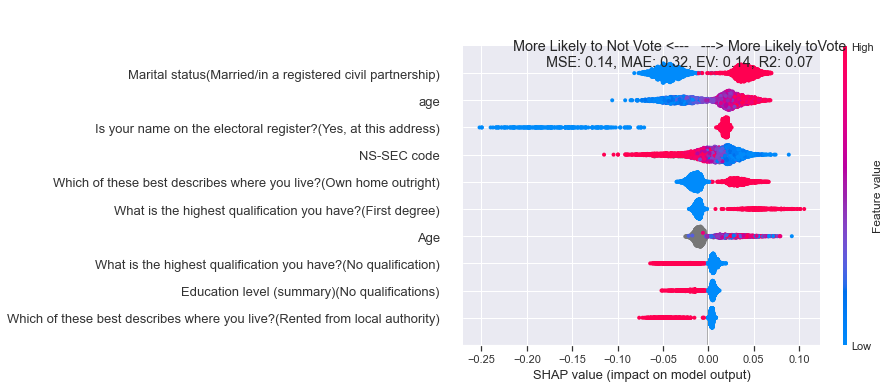

<Figure size 1152x720 with 0 Axes>

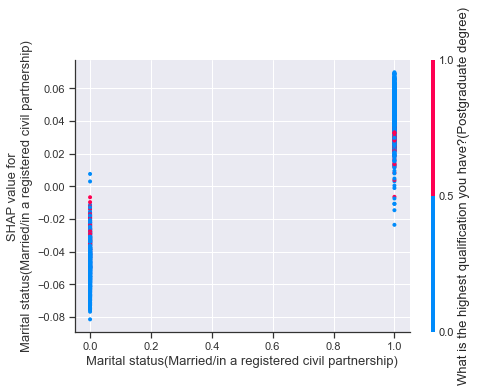

<Figure size 1152x720 with 0 Axes>

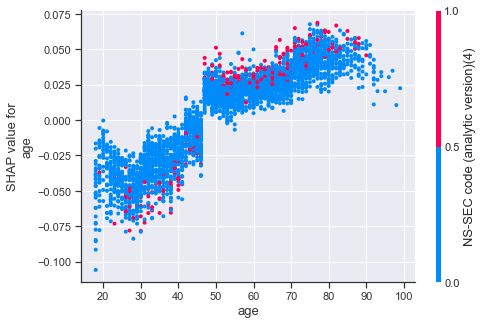

<Figure size 1152x720 with 0 Axes>

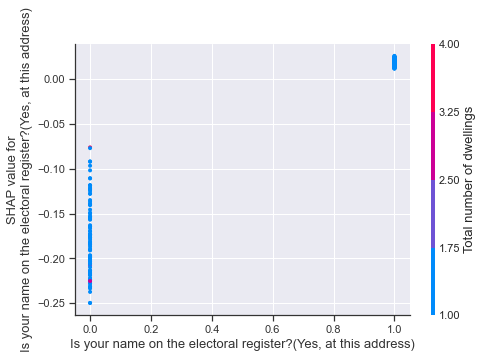

<Figure size 1152x720 with 0 Axes>

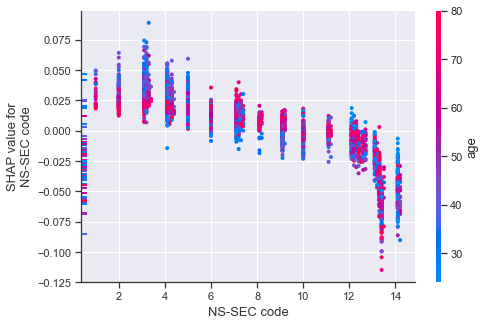

<Figure size 1152x720 with 0 Axes>

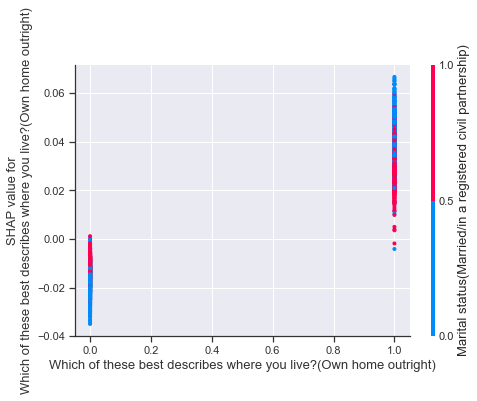

<Figure size 1152x720 with 0 Axes>

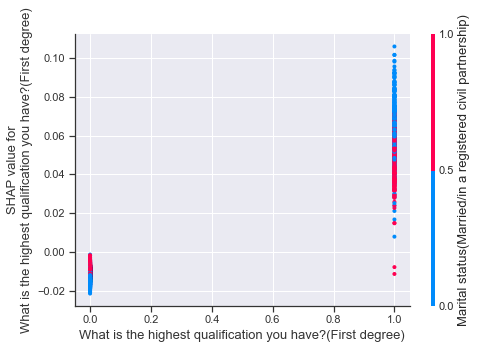

<Figure size 1152x720 with 0 Axes>

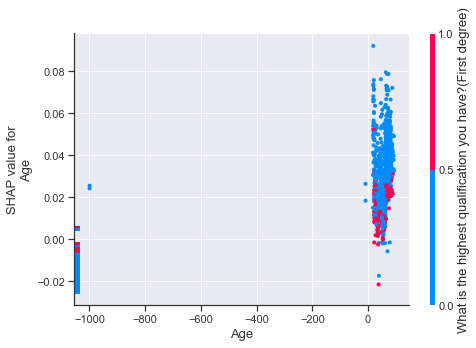

<Figure size 1152x720 with 0 Axes>

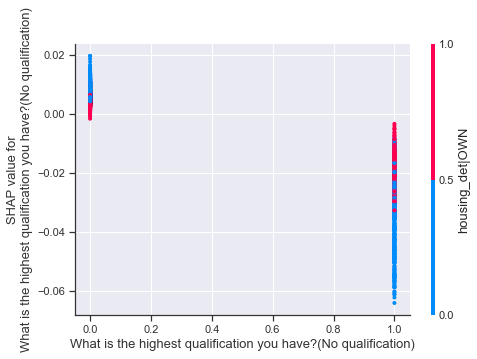

<Figure size 1152x720 with 0 Axes>

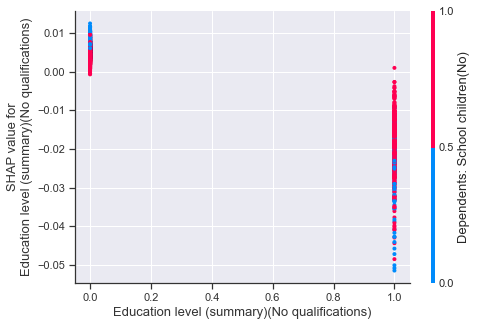

<Figure size 1152x720 with 0 Axes>

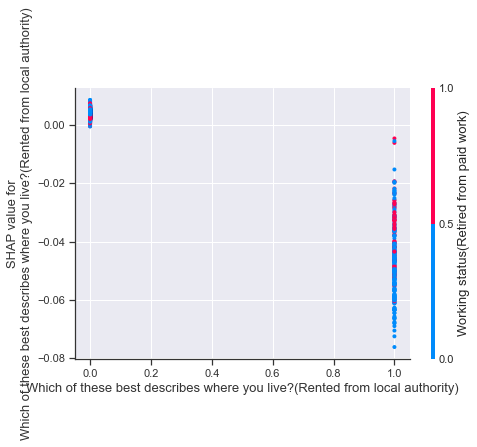

2017
MSE: 0.12, MAE: 0.28, EV: 0.25, R2: 0.22


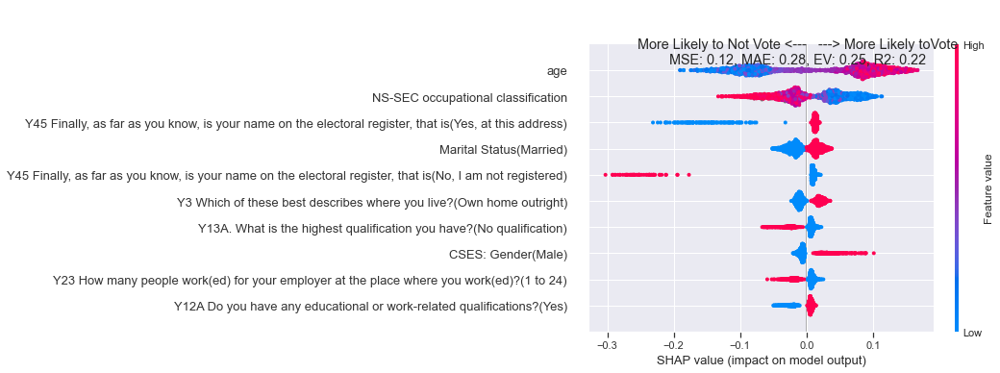

<Figure size 1152x720 with 0 Axes>

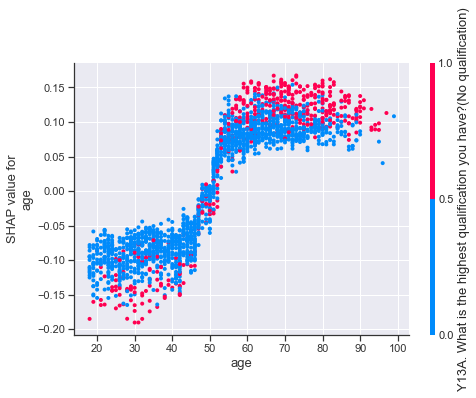

<Figure size 1152x720 with 0 Axes>

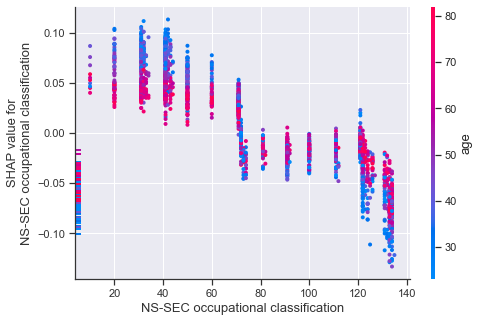

<Figure size 1152x720 with 0 Axes>

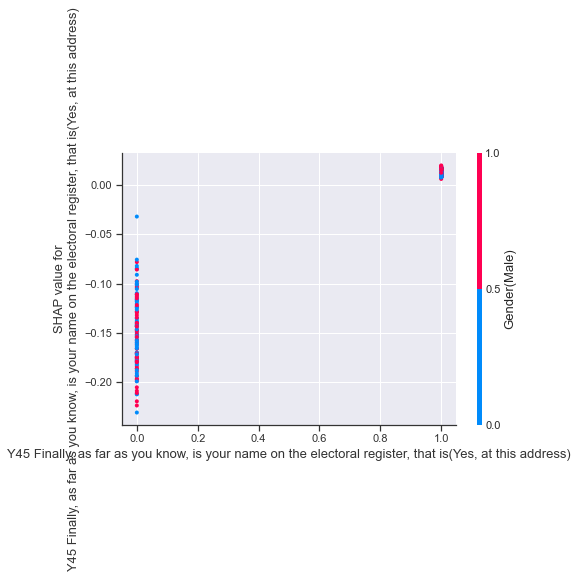

<Figure size 1152x720 with 0 Axes>

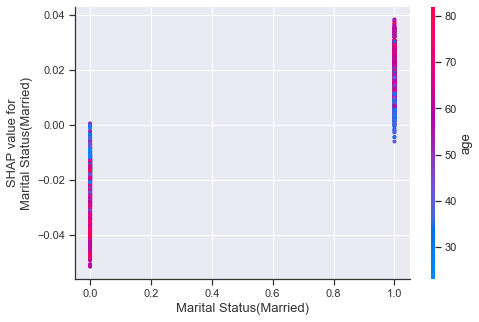

<Figure size 1152x720 with 0 Axes>

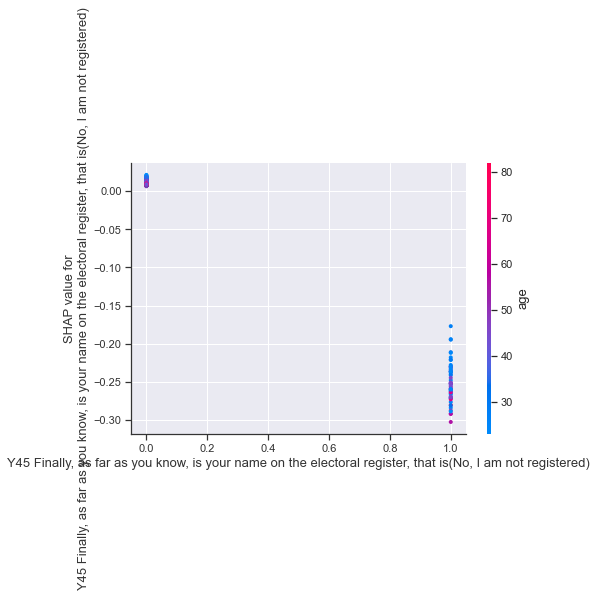

<Figure size 1152x720 with 0 Axes>

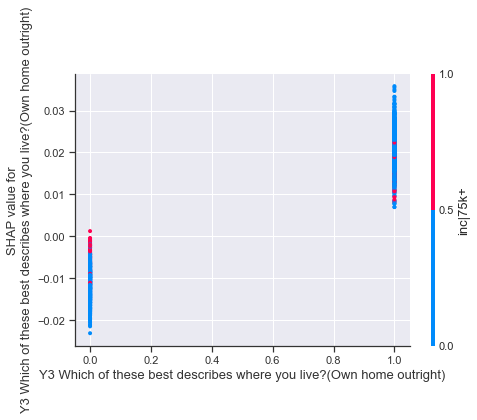

<Figure size 1152x720 with 0 Axes>

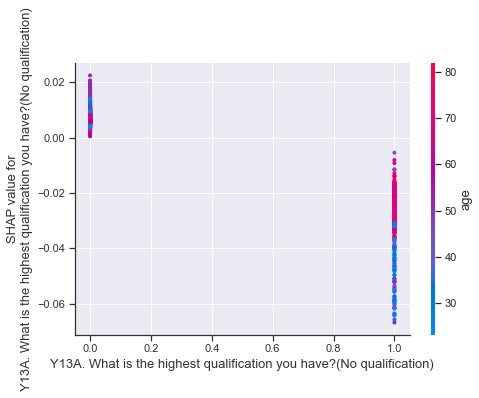

<Figure size 1152x720 with 0 Axes>

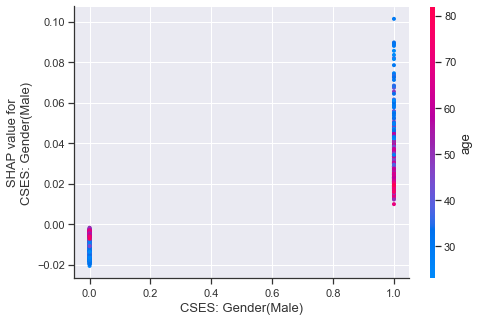

<Figure size 1152x720 with 0 Axes>

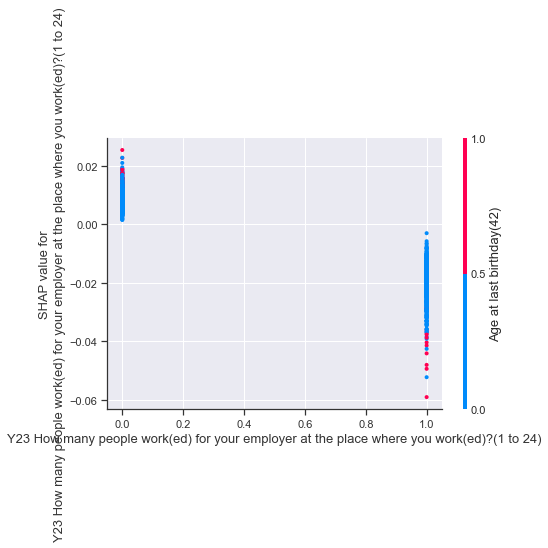

<Figure size 1152x720 with 0 Axes>

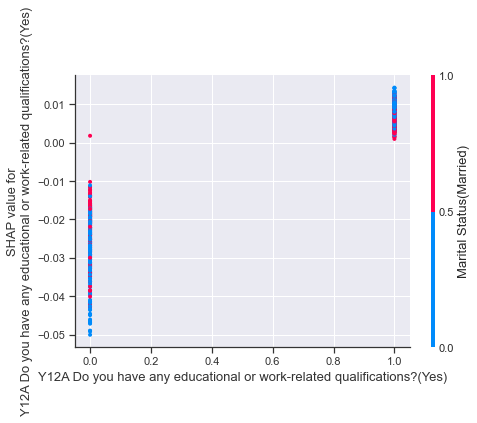

2015
MSE: 0.16, MAE: 0.33, EV: 0.22, R2: 0.21


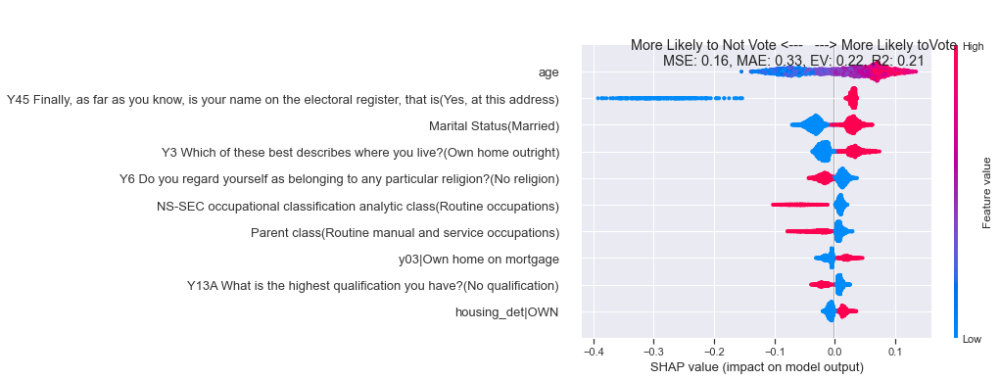

<Figure size 1152x720 with 0 Axes>

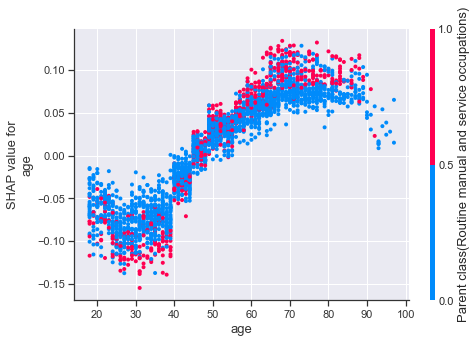

<Figure size 1152x720 with 0 Axes>

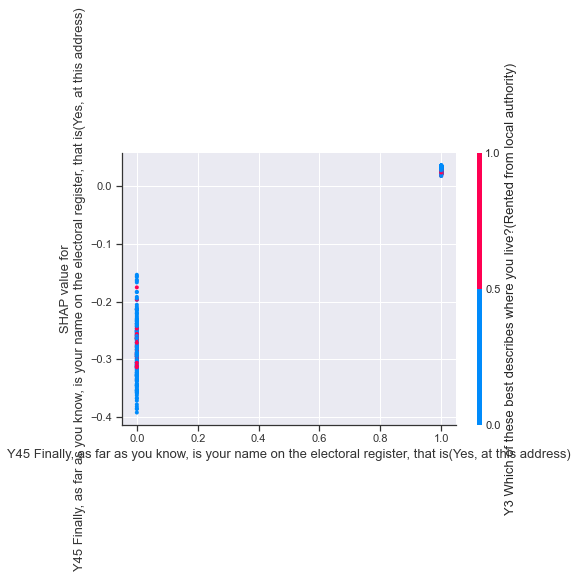

<Figure size 1152x720 with 0 Axes>

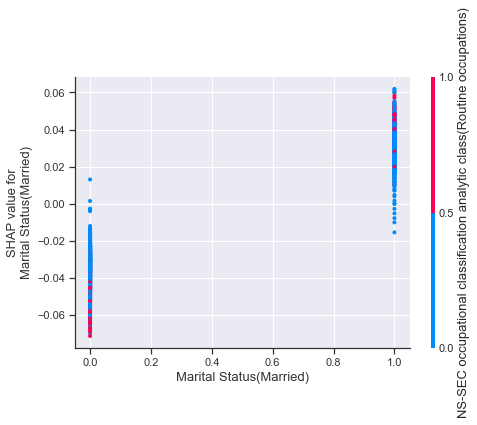

<Figure size 1152x720 with 0 Axes>

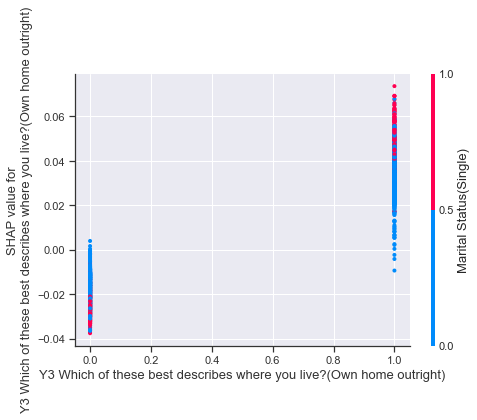

<Figure size 1152x720 with 0 Axes>

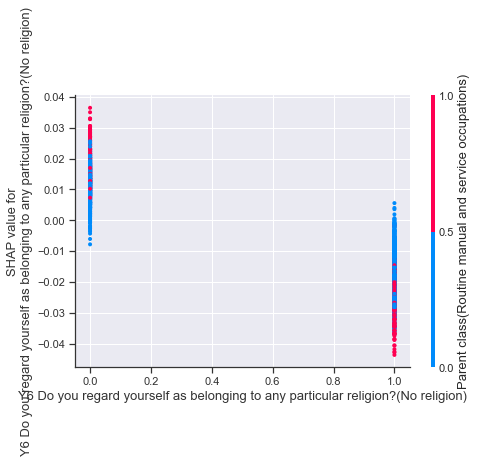

<Figure size 1152x720 with 0 Axes>

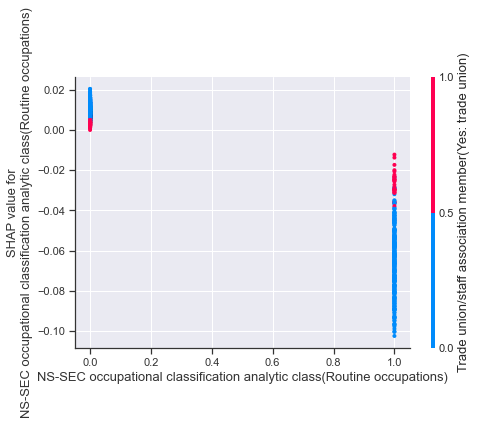

<Figure size 1152x720 with 0 Axes>

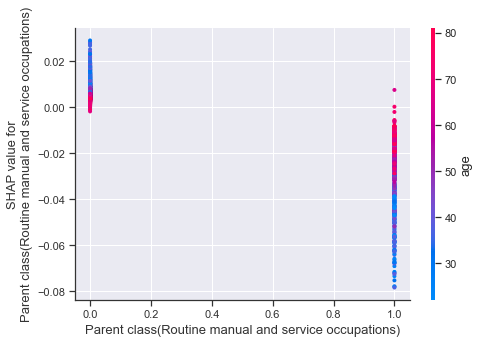

<Figure size 1152x720 with 0 Axes>

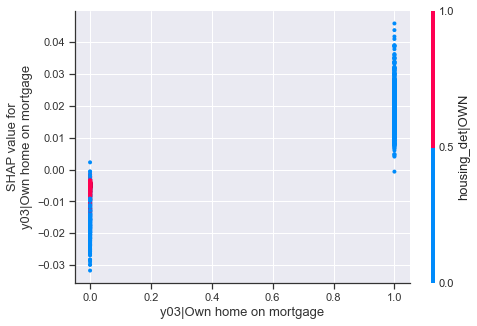

<Figure size 1152x720 with 0 Axes>

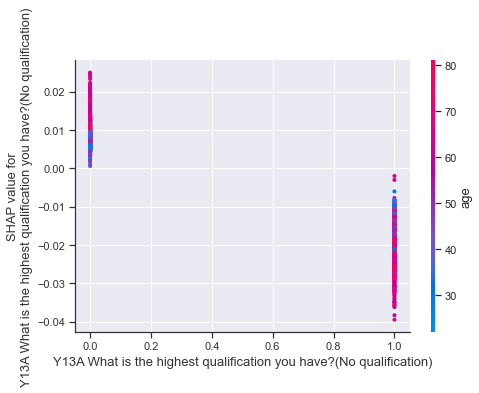

<Figure size 1152x720 with 0 Axes>

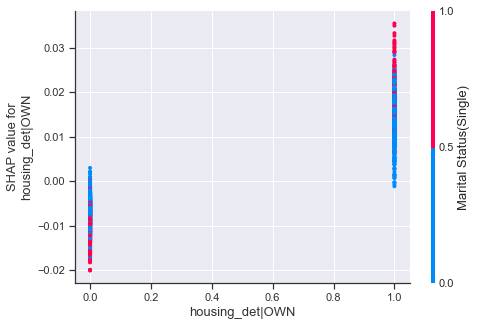

2010
MSE: 0.13, MAE: 0.26, EV: 0.12, R2: 0.12


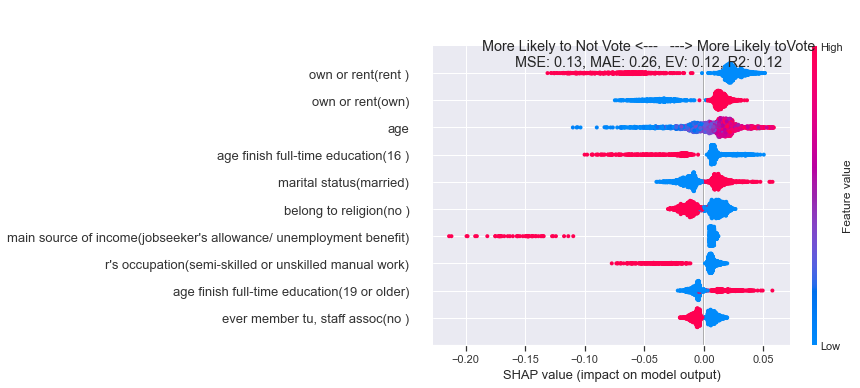

<Figure size 1152x720 with 0 Axes>

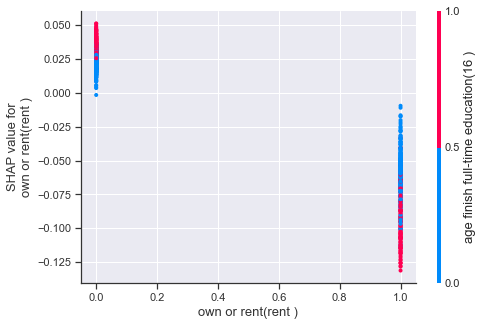

<Figure size 1152x720 with 0 Axes>

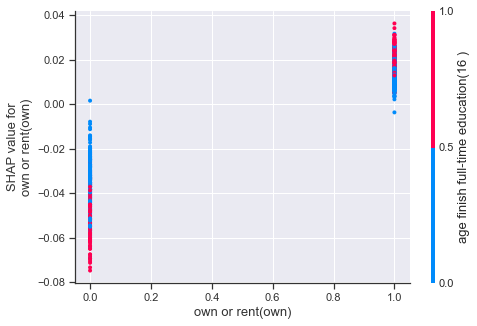

<Figure size 1152x720 with 0 Axes>

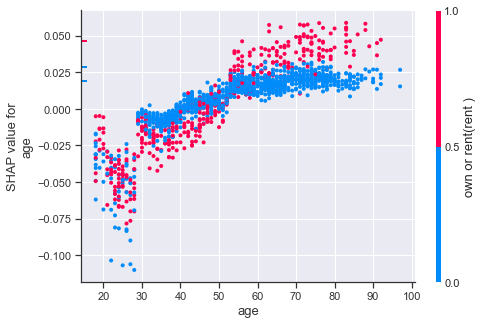

<Figure size 1152x720 with 0 Axes>

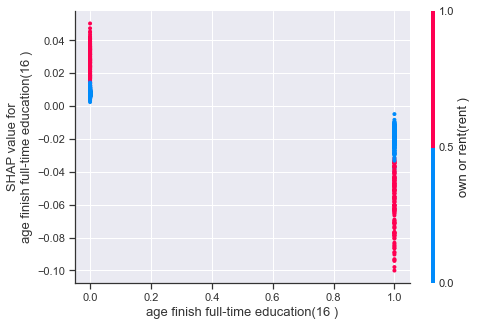

<Figure size 1152x720 with 0 Axes>

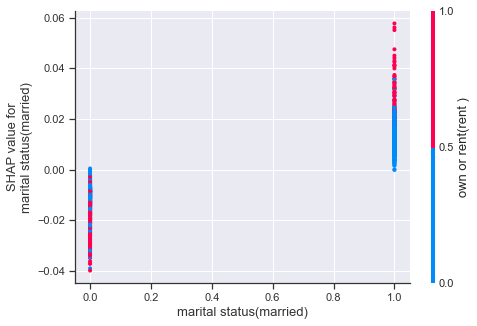

<Figure size 1152x720 with 0 Axes>

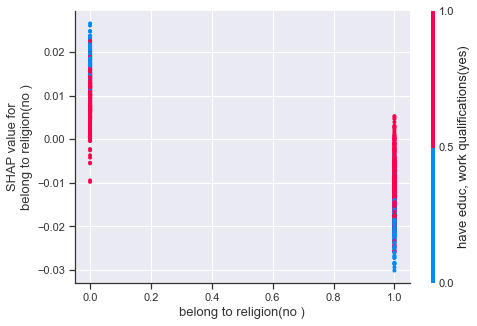

<Figure size 1152x720 with 0 Axes>

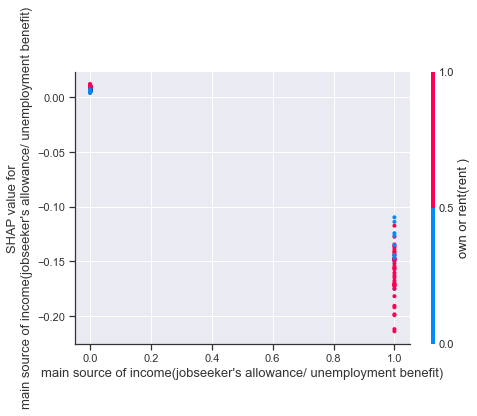

<Figure size 1152x720 with 0 Axes>

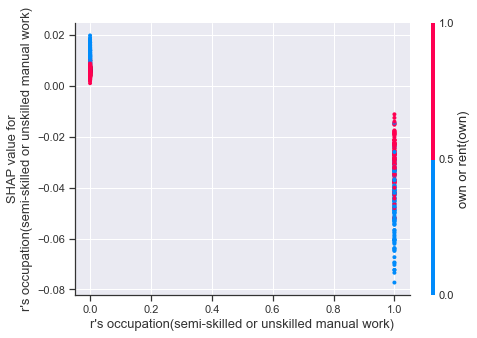

<Figure size 1152x720 with 0 Axes>

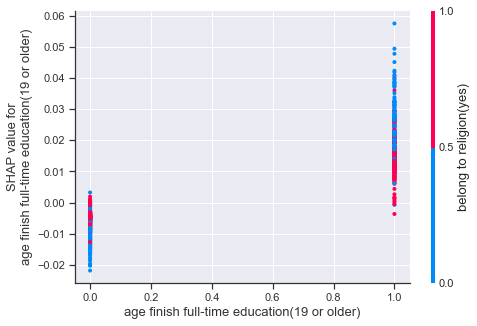

<Figure size 1152x720 with 0 Axes>

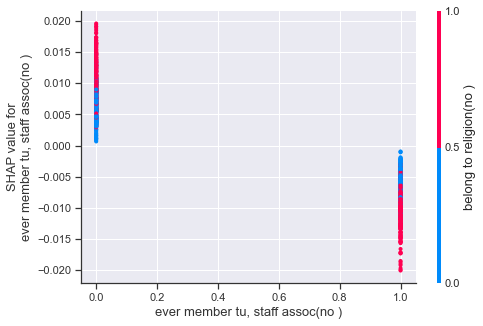

2005
MSE: 0.14, MAE: 0.27, EV: 0.17, R2: 0.17


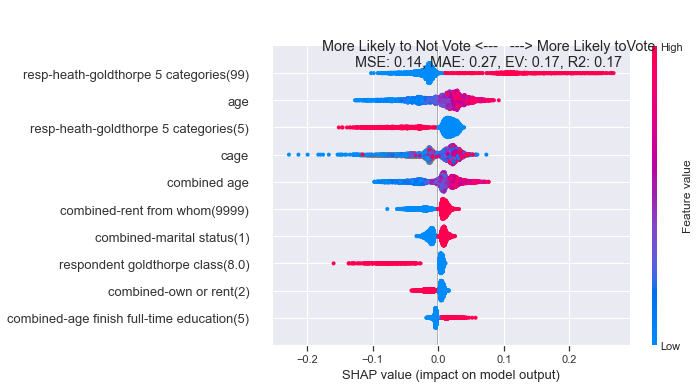

<Figure size 1152x720 with 0 Axes>

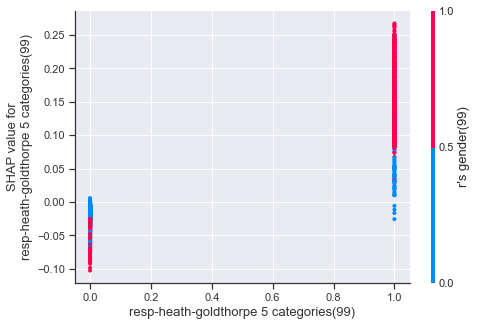

<Figure size 1152x720 with 0 Axes>

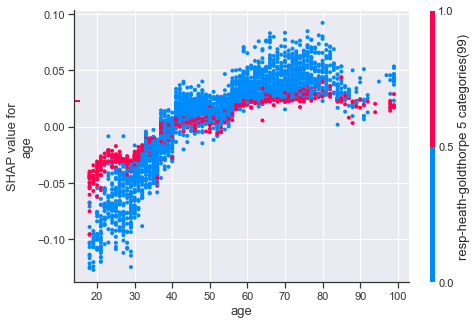

<Figure size 1152x720 with 0 Axes>

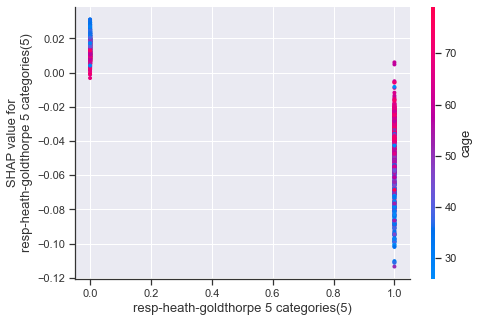

<Figure size 1152x720 with 0 Axes>

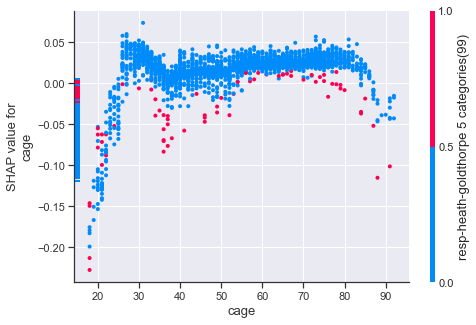

<Figure size 1152x720 with 0 Axes>

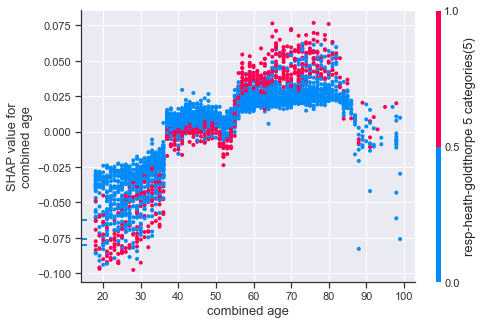

<Figure size 1152x720 with 0 Axes>

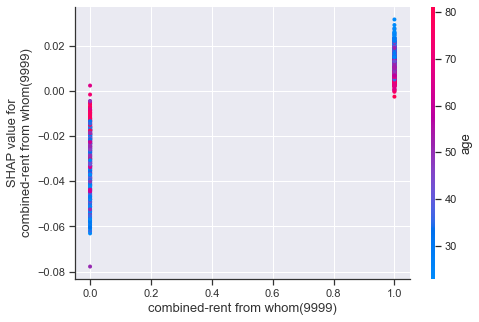

<Figure size 1152x720 with 0 Axes>

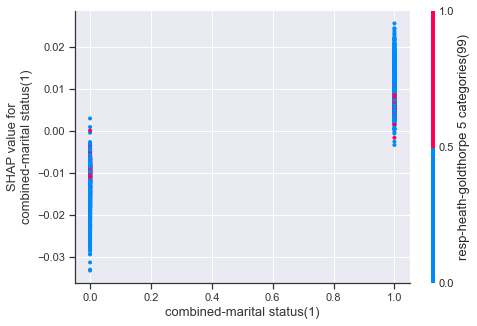

<Figure size 1152x720 with 0 Axes>

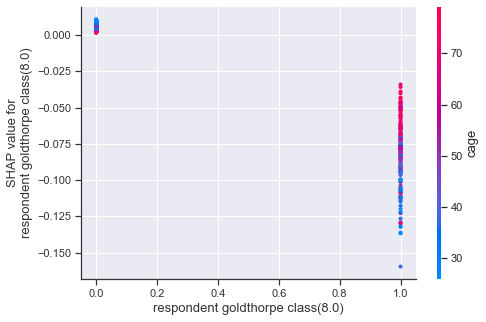

<Figure size 1152x720 with 0 Axes>

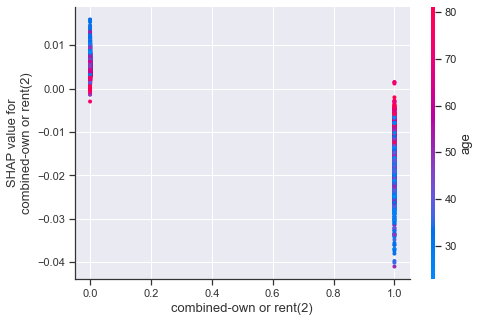

<Figure size 1152x720 with 0 Axes>

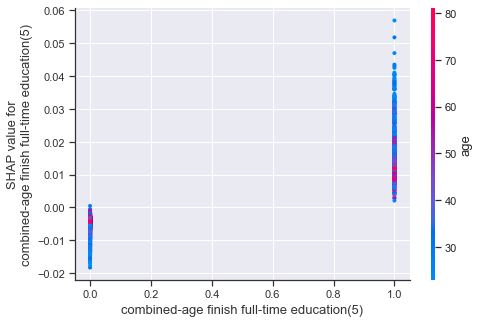

2001
MSE: 0.18, MAE: 0.38, EV: 0.09, R2: 0.08


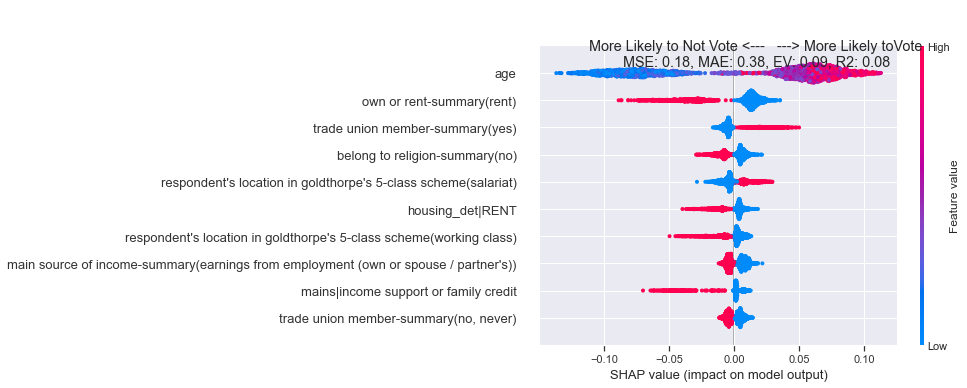

<Figure size 1152x720 with 0 Axes>

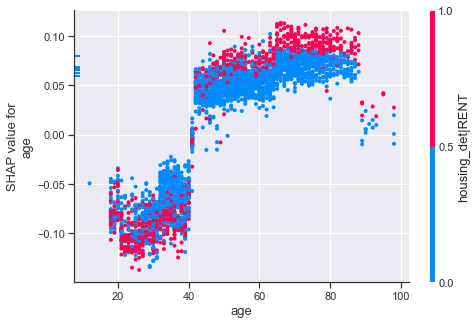

<Figure size 1152x720 with 0 Axes>

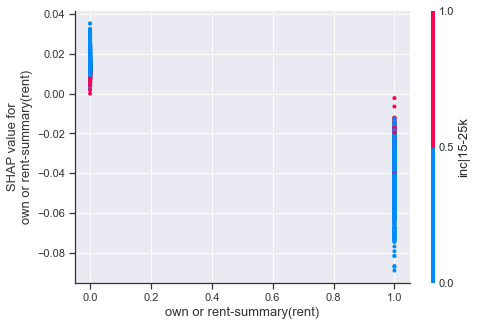

<Figure size 1152x720 with 0 Axes>

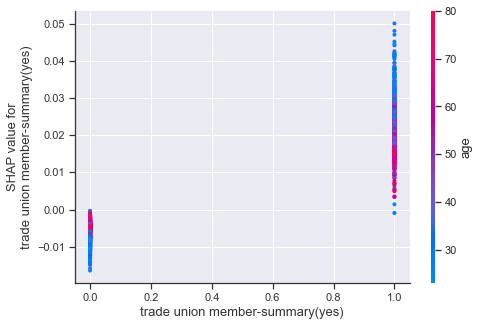

<Figure size 1152x720 with 0 Axes>

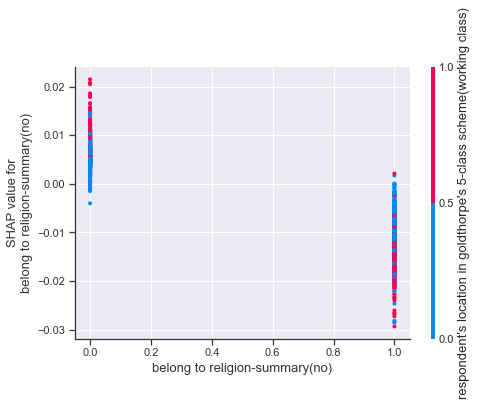

<Figure size 1152x720 with 0 Axes>

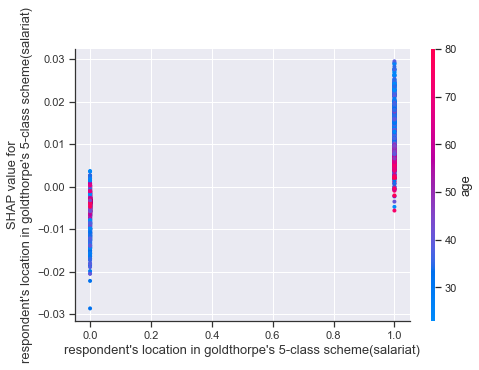

<Figure size 1152x720 with 0 Axes>

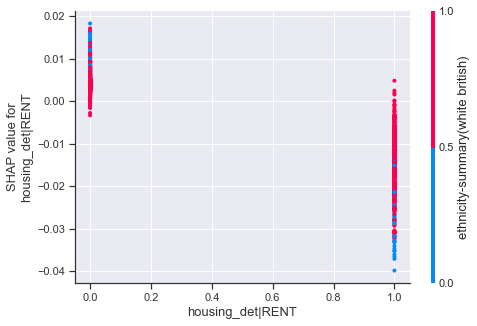

<Figure size 1152x720 with 0 Axes>

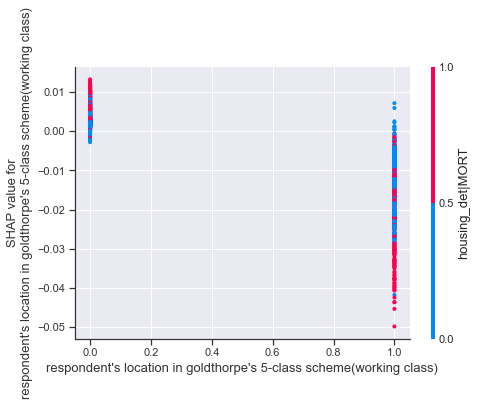

<Figure size 1152x720 with 0 Axes>

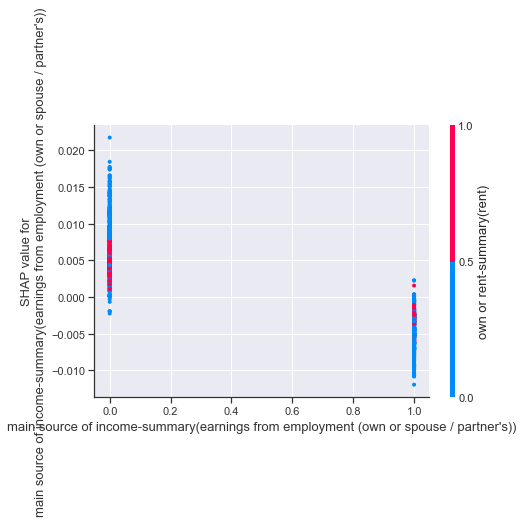

<Figure size 1152x720 with 0 Axes>

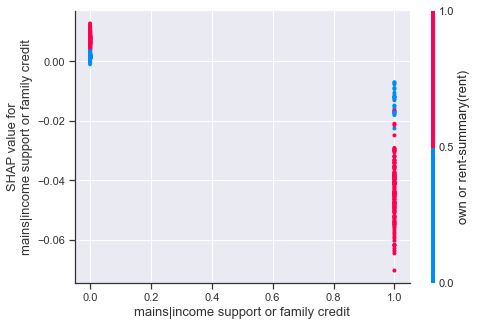

<Figure size 1152x720 with 0 Axes>

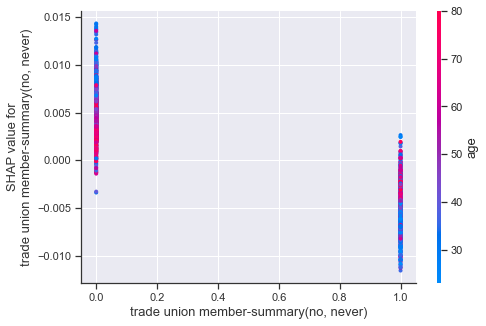

1997
MSE: 0.15, MAE: 0.29, EV: 0.06, R2: 0.06


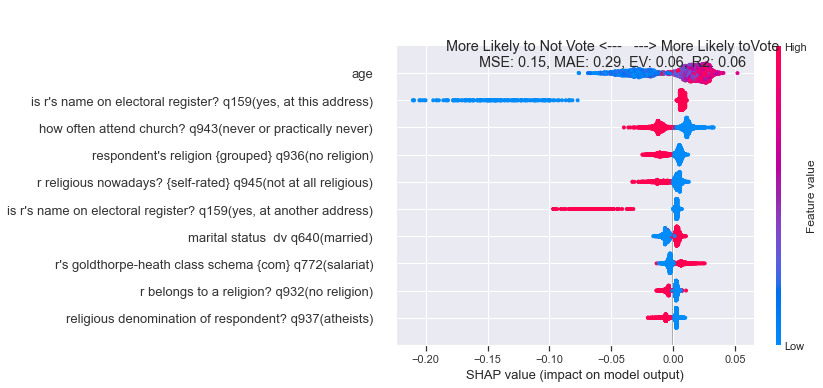

<Figure size 1152x720 with 0 Axes>

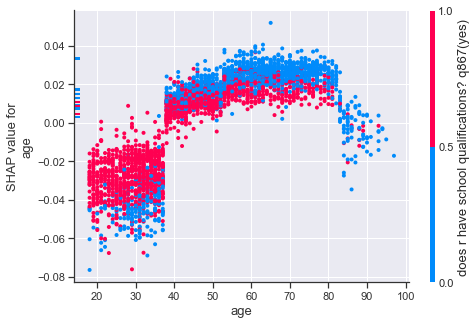

<Figure size 1152x720 with 0 Axes>

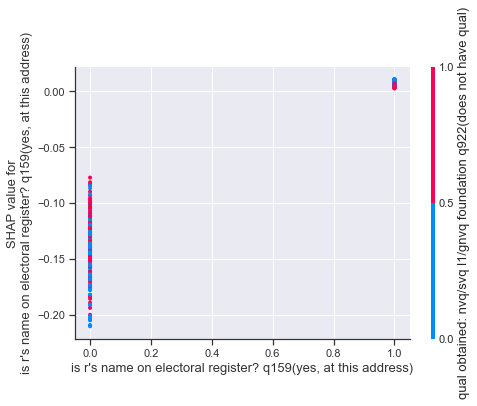

<Figure size 1152x720 with 0 Axes>

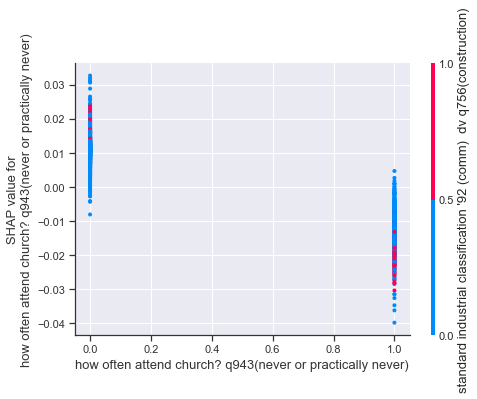

<Figure size 1152x720 with 0 Axes>

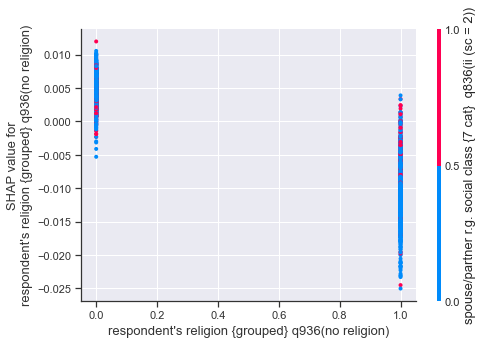

<Figure size 1152x720 with 0 Axes>

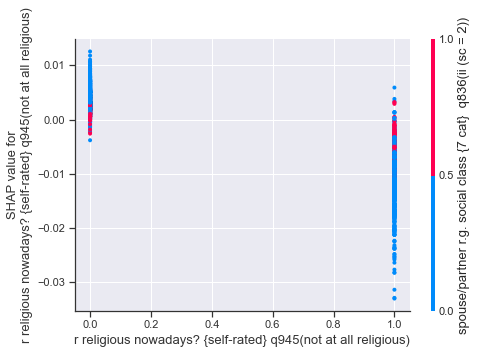

<Figure size 1152x720 with 0 Axes>

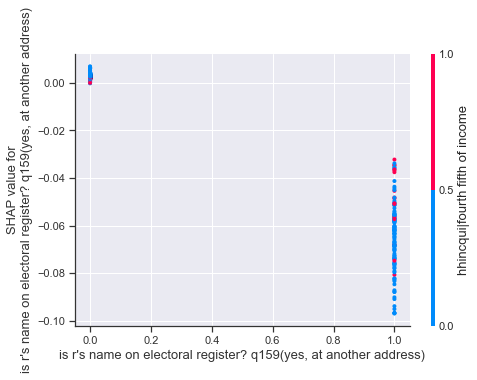

<Figure size 1152x720 with 0 Axes>

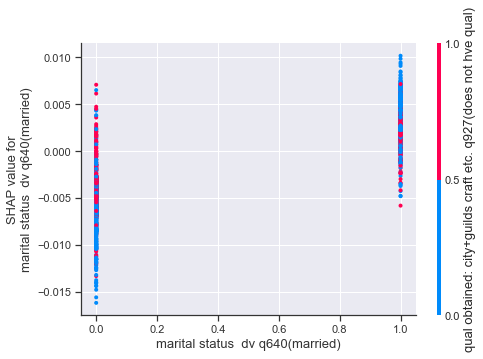

<Figure size 1152x720 with 0 Axes>

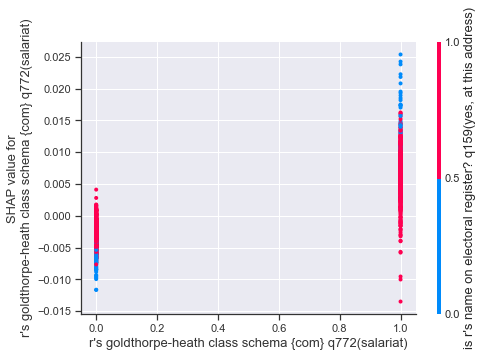

<Figure size 1152x720 with 0 Axes>

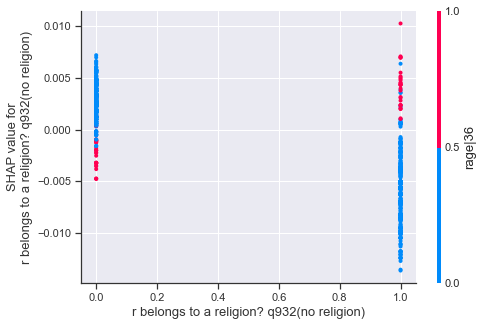

<Figure size 1152x720 with 0 Axes>

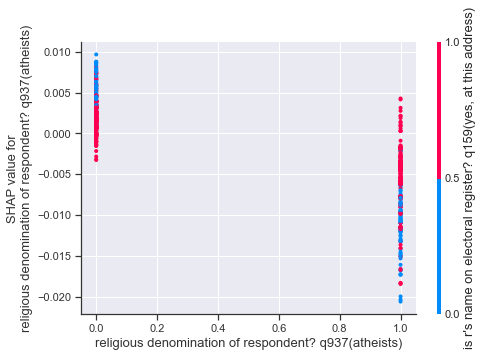

1992
MSE: 0.11, MAE: 0.22, EV: 0.03, R2: 0.02


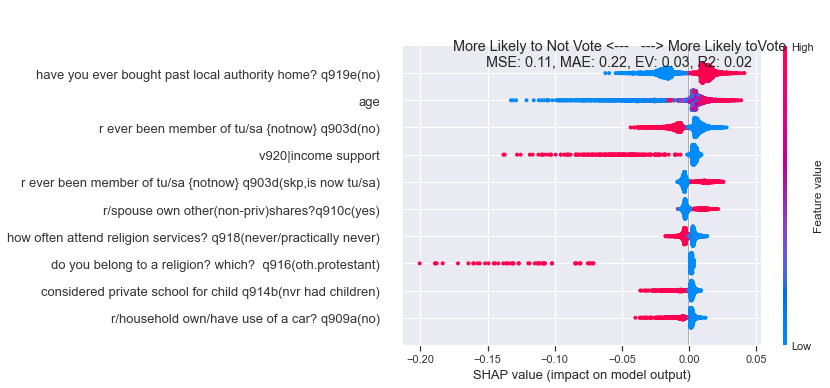

<Figure size 1152x720 with 0 Axes>

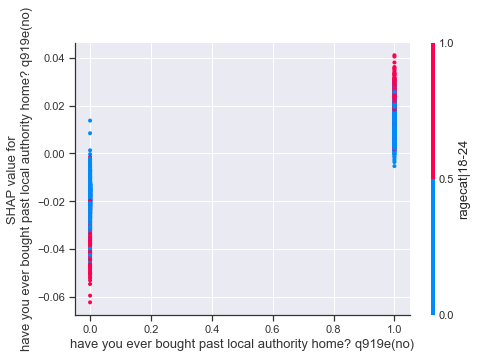

<Figure size 1152x720 with 0 Axes>

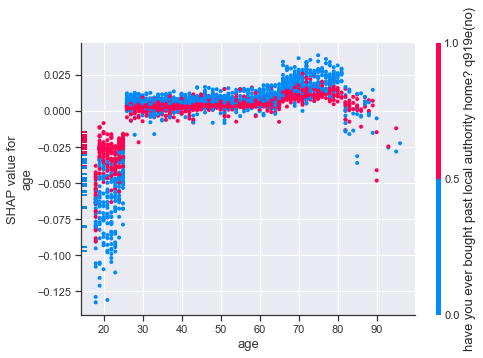

<Figure size 1152x720 with 0 Axes>

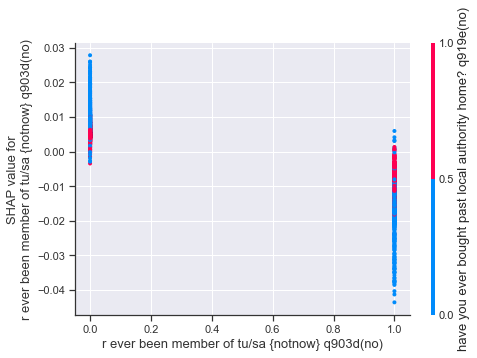

<Figure size 1152x720 with 0 Axes>

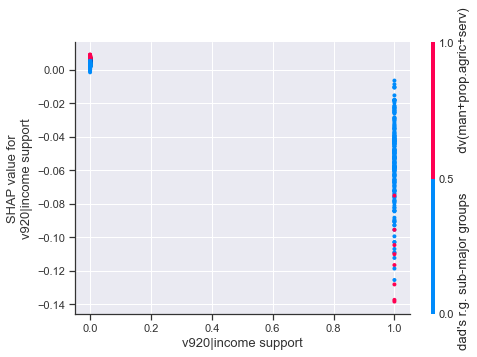

<Figure size 1152x720 with 0 Axes>

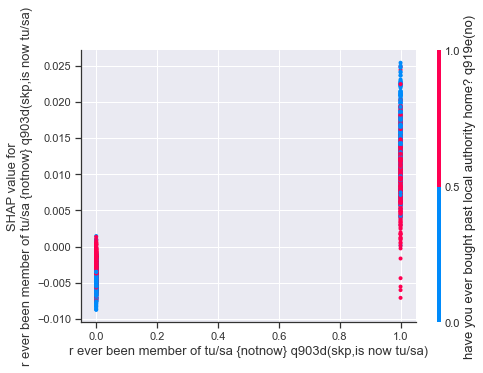

<Figure size 1152x720 with 0 Axes>

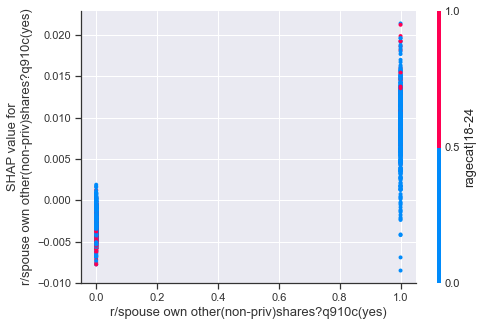

<Figure size 1152x720 with 0 Axes>

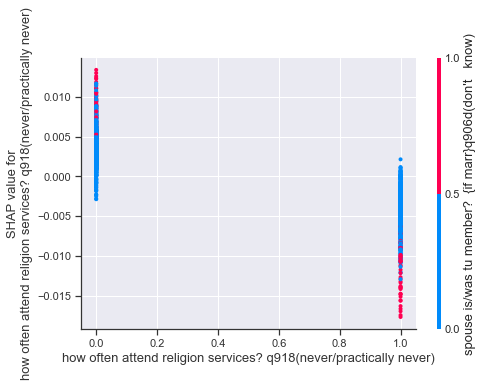

<Figure size 1152x720 with 0 Axes>

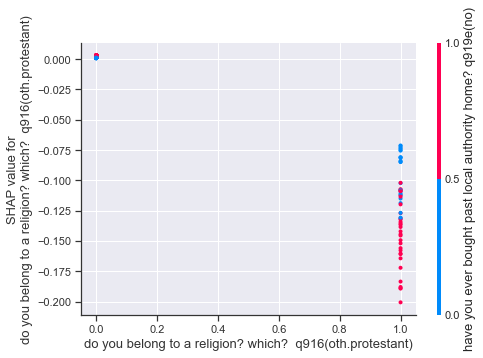

<Figure size 1152x720 with 0 Axes>

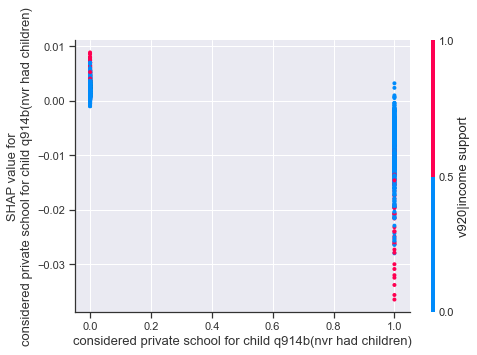

<Figure size 1152x720 with 0 Axes>

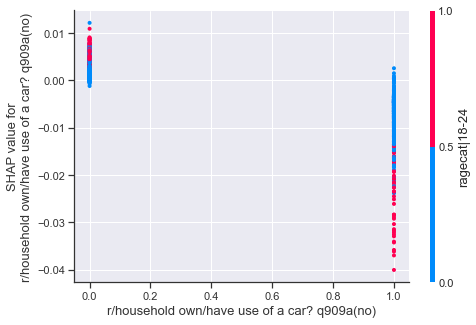

1987
MSE: 0.11, MAE: 0.24, EV: 0.01, R2: 0.00


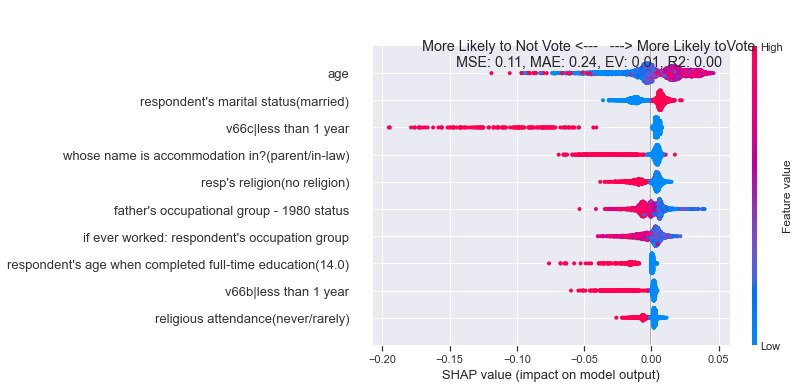

<Figure size 1152x720 with 0 Axes>

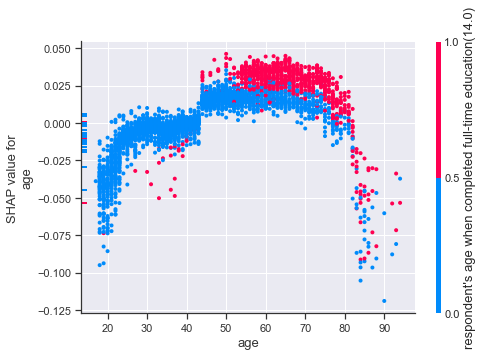

<Figure size 1152x720 with 0 Axes>

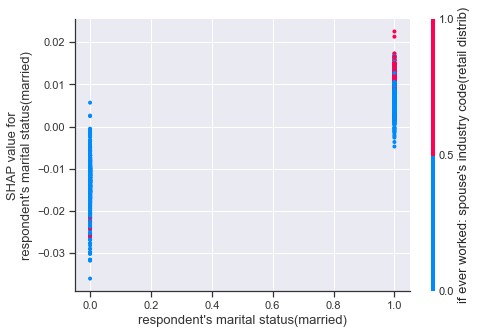

<Figure size 1152x720 with 0 Axes>

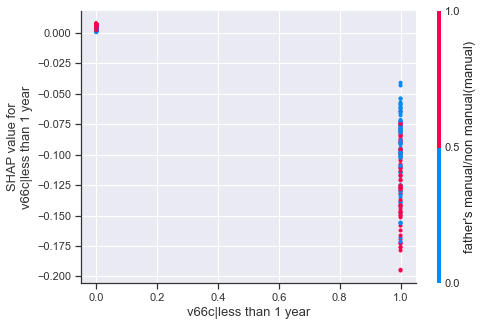

<Figure size 1152x720 with 0 Axes>

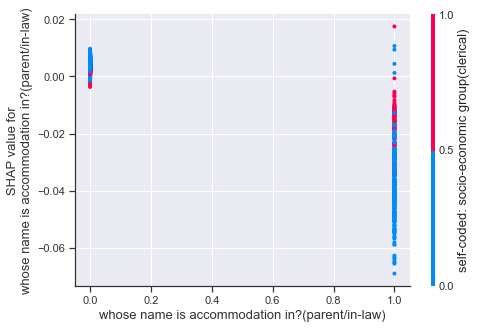

<Figure size 1152x720 with 0 Axes>

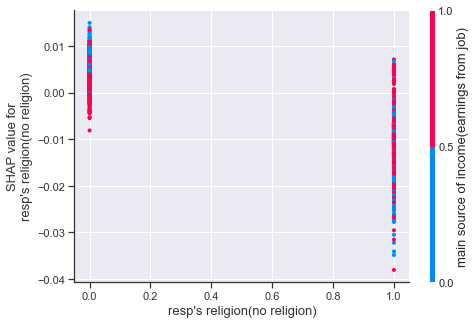

<Figure size 1152x720 with 0 Axes>

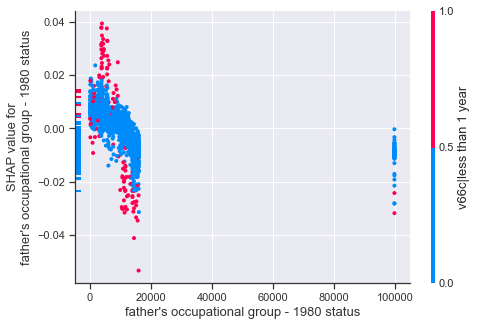

<Figure size 1152x720 with 0 Axes>

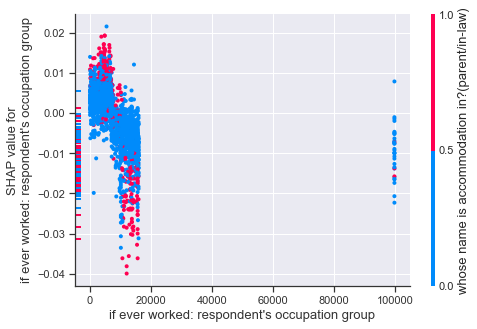

<Figure size 1152x720 with 0 Axes>

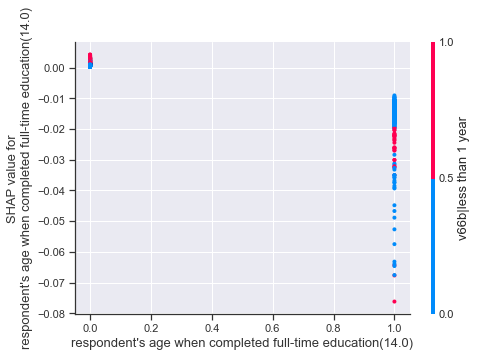

<Figure size 1152x720 with 0 Axes>

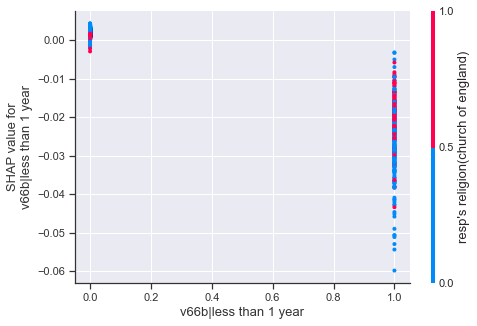

<Figure size 1152x720 with 0 Axes>

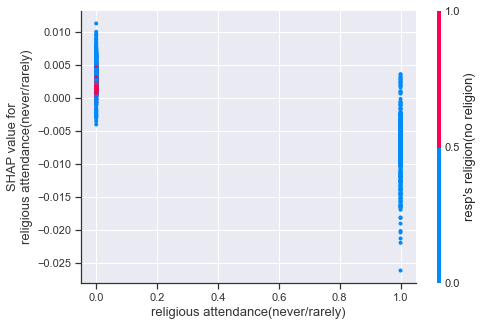

1983
MSE: 0.13, MAE: 0.27, EV: 0.04, R2: 0.04


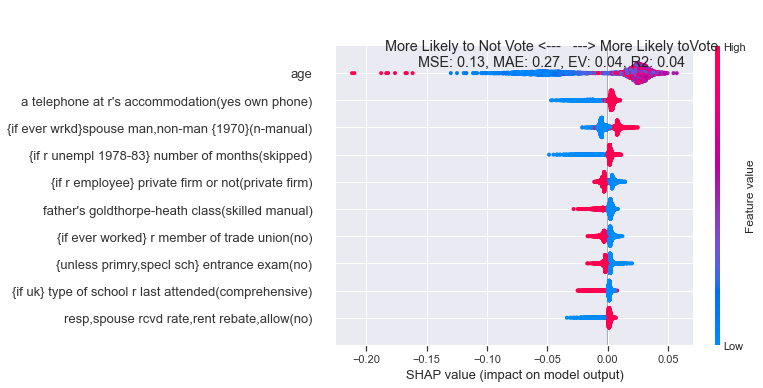

<Figure size 1152x720 with 0 Axes>

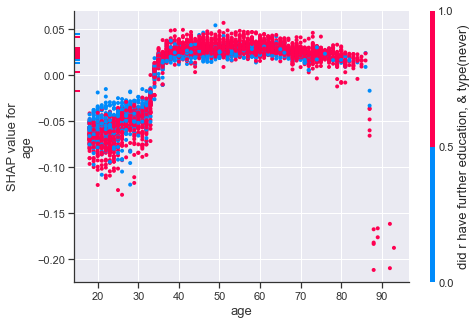

<Figure size 1152x720 with 0 Axes>

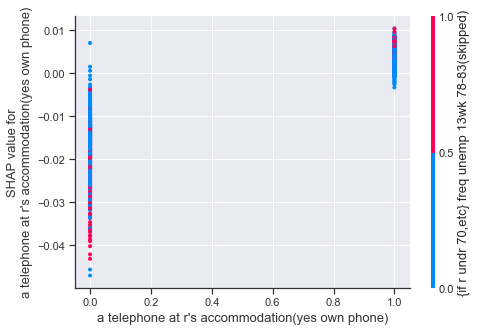

<Figure size 1152x720 with 0 Axes>

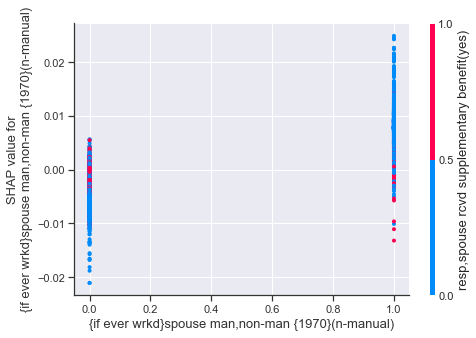

<Figure size 1152x720 with 0 Axes>

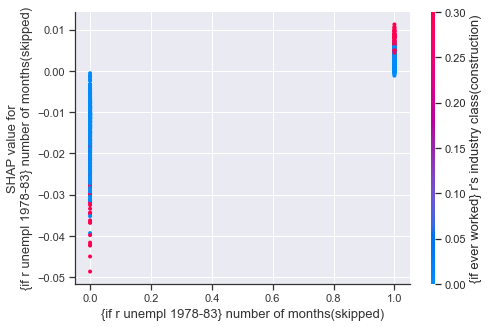

<Figure size 1152x720 with 0 Axes>

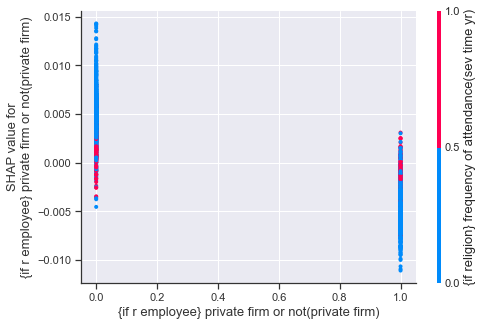

<Figure size 1152x720 with 0 Axes>

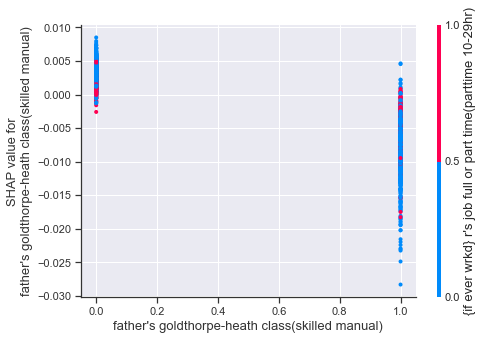

<Figure size 1152x720 with 0 Axes>

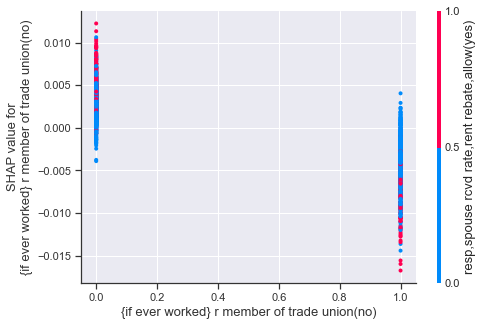

<Figure size 1152x720 with 0 Axes>

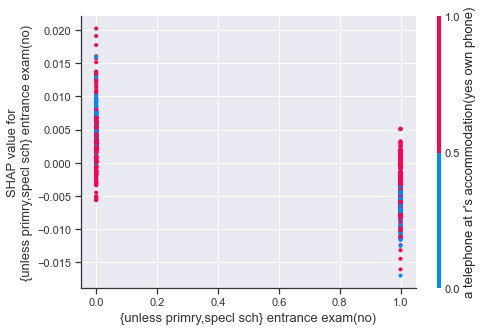

<Figure size 1152x720 with 0 Axes>

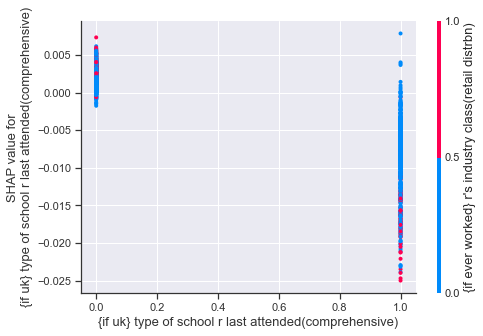

<Figure size 1152x720 with 0 Axes>

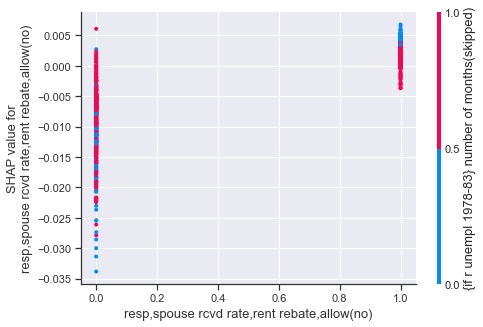

1979
MSE: 0.12, MAE: 0.24, EV: 0.05, R2: 0.04


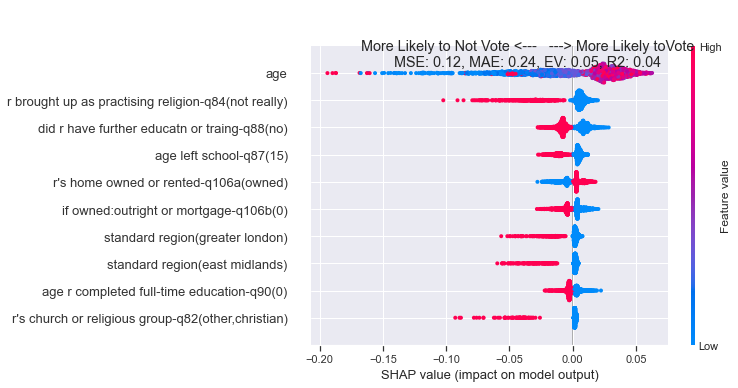

<Figure size 1152x720 with 0 Axes>

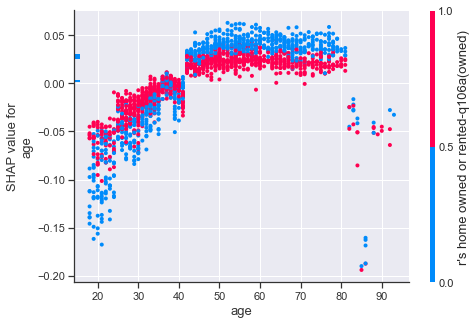

<Figure size 1152x720 with 0 Axes>

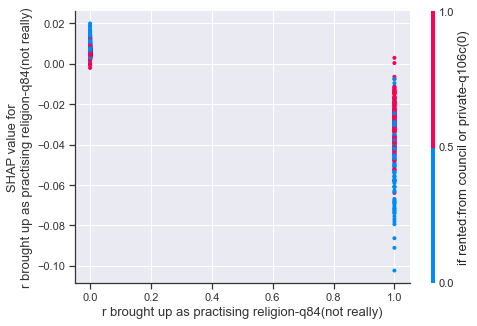

<Figure size 1152x720 with 0 Axes>

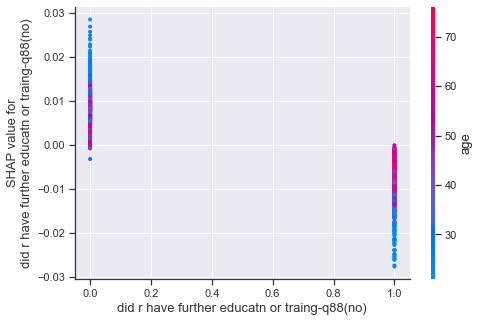

<Figure size 1152x720 with 0 Axes>

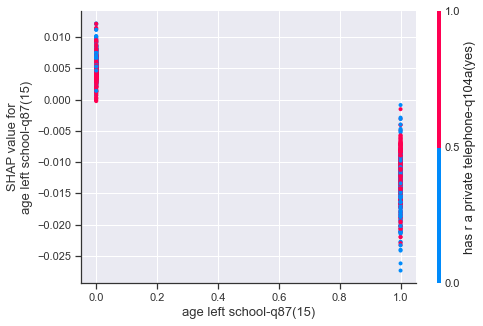

<Figure size 1152x720 with 0 Axes>

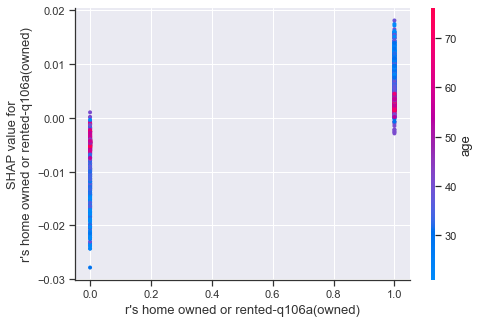

<Figure size 1152x720 with 0 Axes>

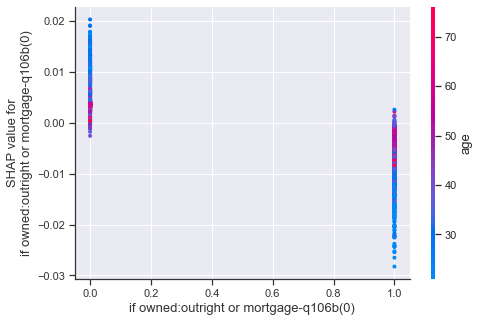

<Figure size 1152x720 with 0 Axes>

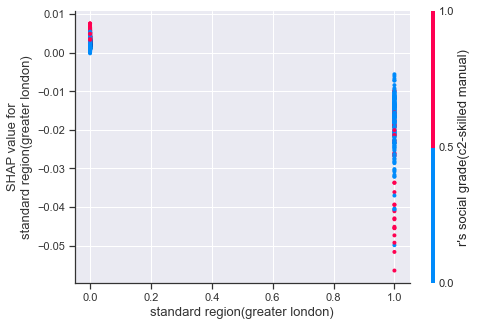

<Figure size 1152x720 with 0 Axes>

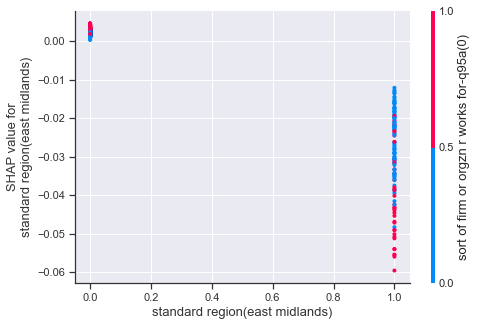

<Figure size 1152x720 with 0 Axes>

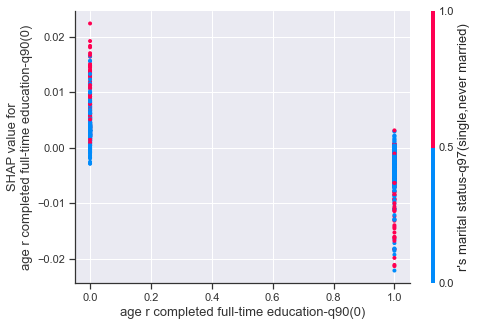

<Figure size 1152x720 with 0 Axes>

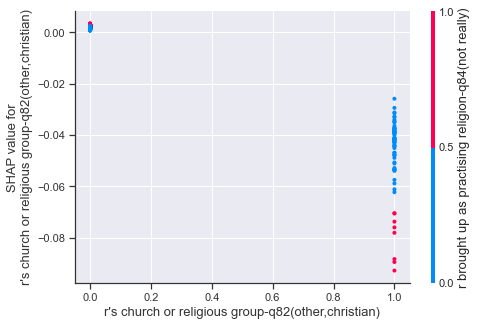

1974_feb
MSE: 0.10, MAE: 0.20, EV: 0.01, R2: 0.01


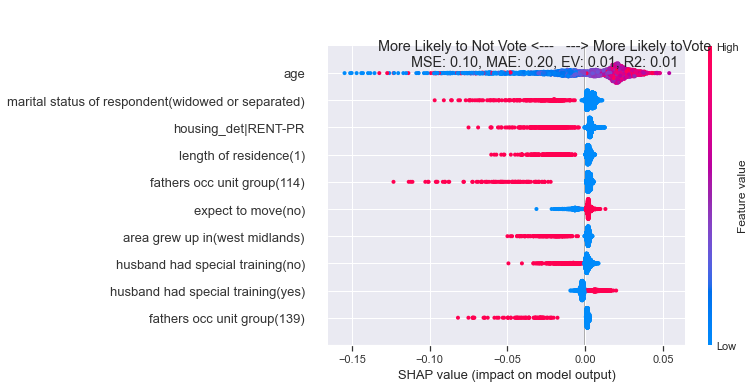

<Figure size 1152x720 with 0 Axes>

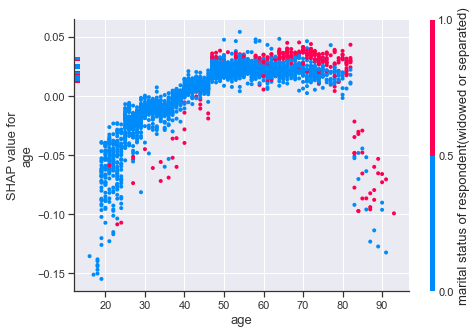

<Figure size 1152x720 with 0 Axes>

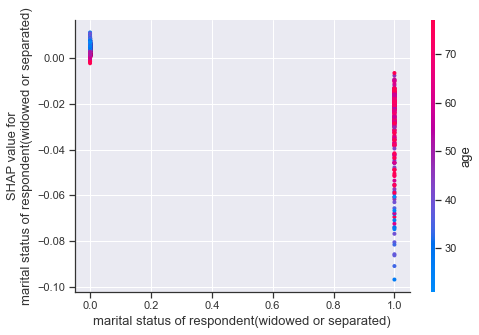

<Figure size 1152x720 with 0 Axes>

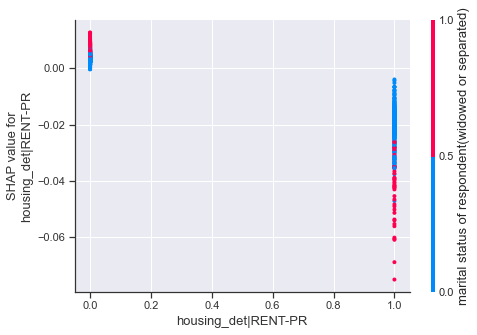

<Figure size 1152x720 with 0 Axes>

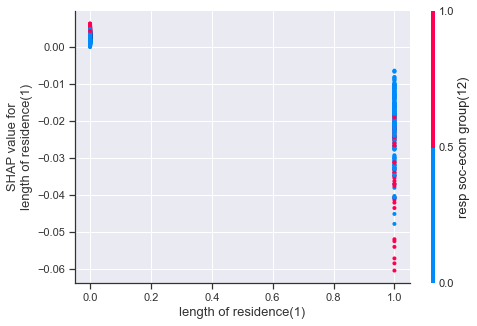

<Figure size 1152x720 with 0 Axes>

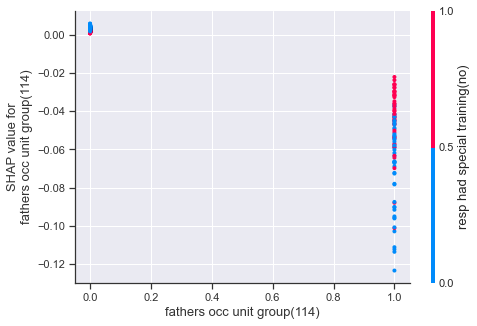

<Figure size 1152x720 with 0 Axes>

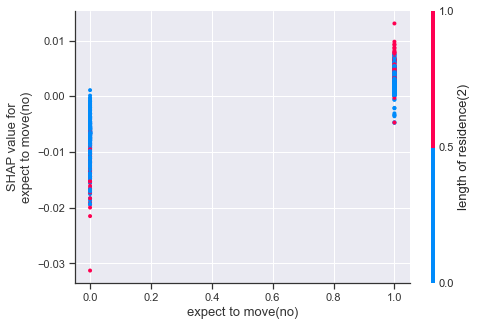

<Figure size 1152x720 with 0 Axes>

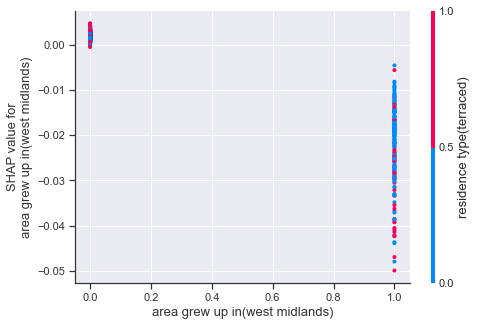

<Figure size 1152x720 with 0 Axes>

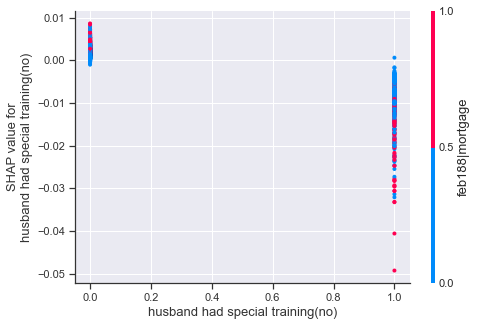

<Figure size 1152x720 with 0 Axes>

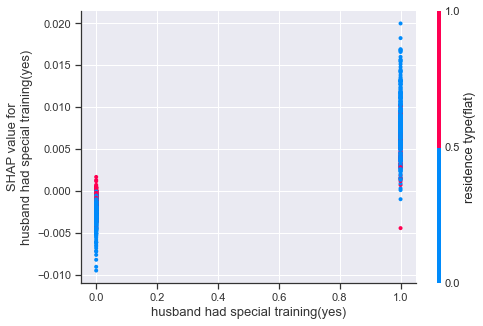

<Figure size 1152x720 with 0 Axes>

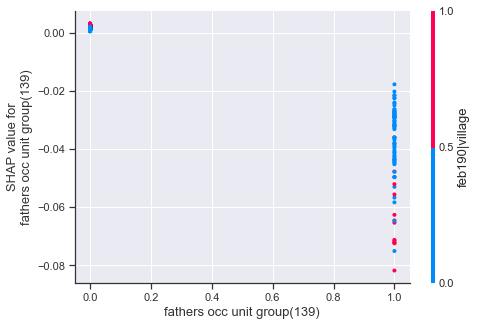

1974_oct
MSE: 0.11, MAE: 0.23, EV: 0.01, R2: 0.01


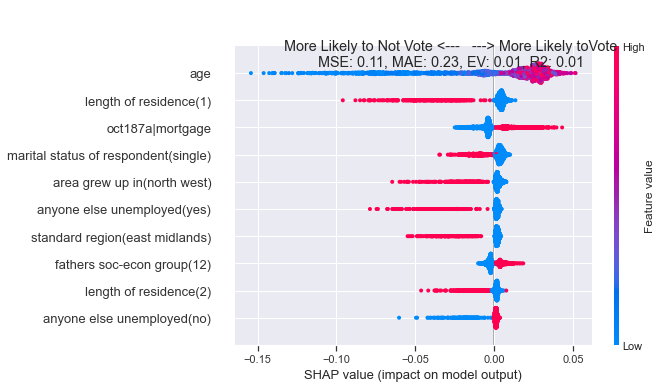

<Figure size 1152x720 with 0 Axes>

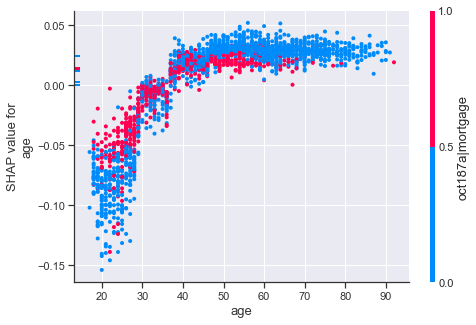

<Figure size 1152x720 with 0 Axes>

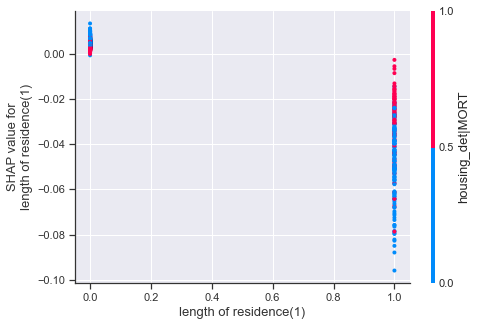

<Figure size 1152x720 with 0 Axes>

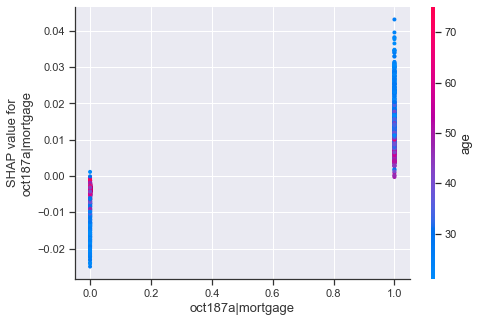

<Figure size 1152x720 with 0 Axes>

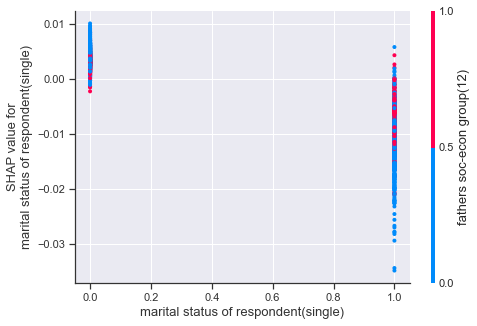

<Figure size 1152x720 with 0 Axes>

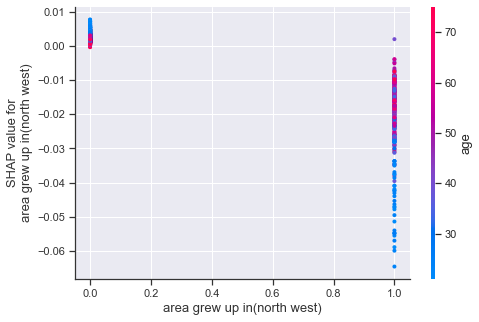

<Figure size 1152x720 with 0 Axes>

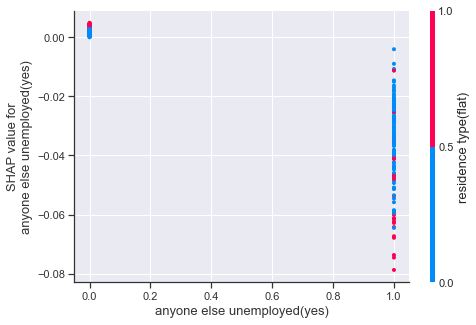

<Figure size 1152x720 with 0 Axes>

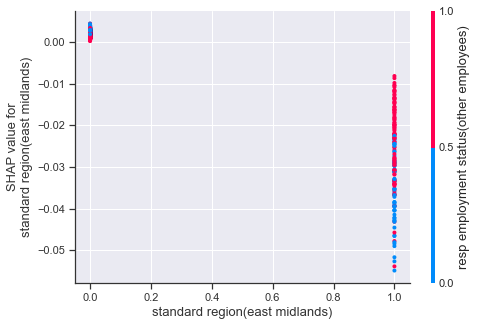

<Figure size 1152x720 with 0 Axes>

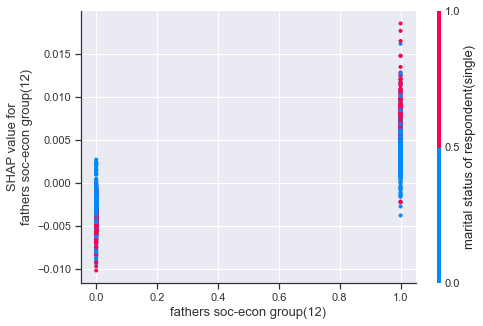

<Figure size 1152x720 with 0 Axes>

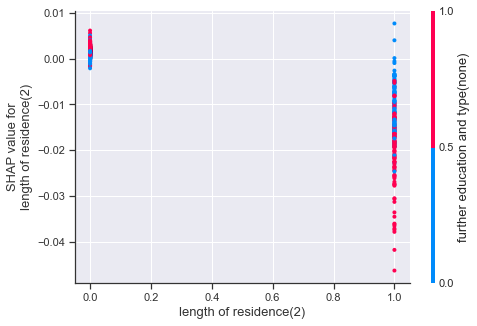

<Figure size 1152x720 with 0 Axes>

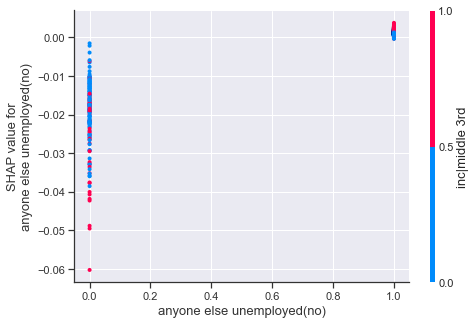

1970
MSE: 0.14, MAE: 0.29, EV: -0.06, R2: -0.07


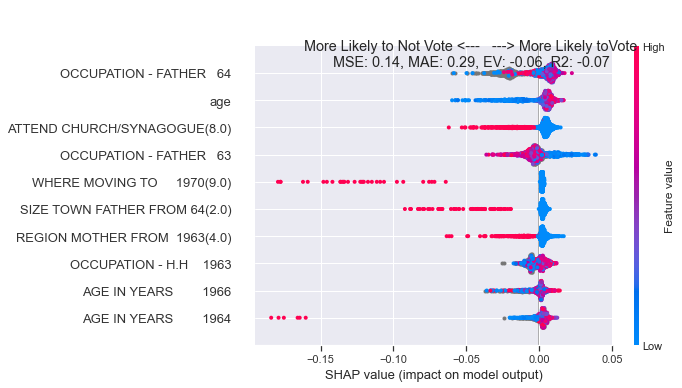

<Figure size 1152x720 with 0 Axes>

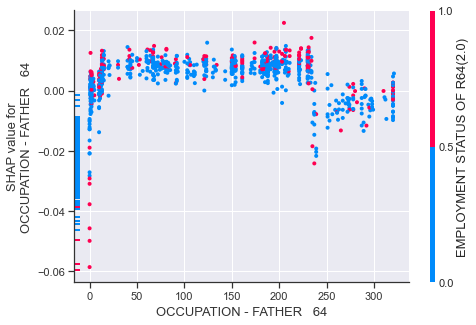

<Figure size 1152x720 with 0 Axes>

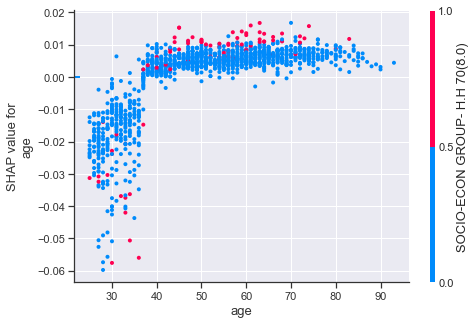

<Figure size 1152x720 with 0 Axes>

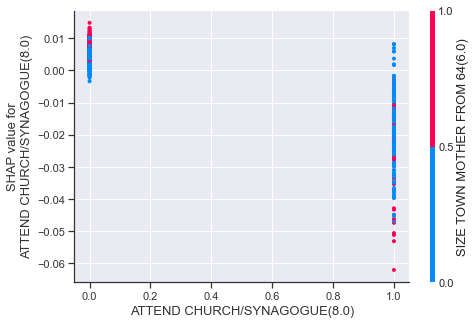

<Figure size 1152x720 with 0 Axes>

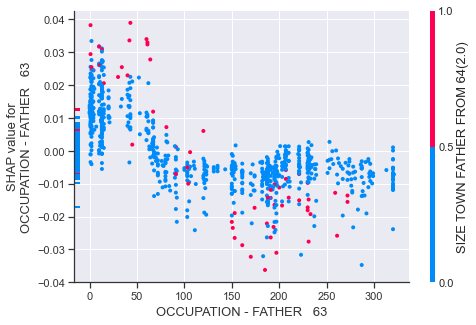

<Figure size 1152x720 with 0 Axes>

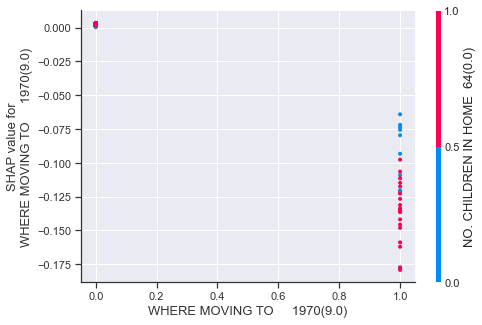

<Figure size 1152x720 with 0 Axes>

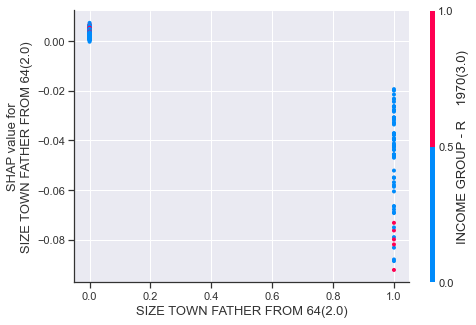

<Figure size 1152x720 with 0 Axes>

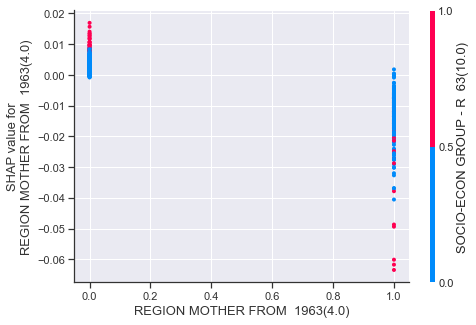

<Figure size 1152x720 with 0 Axes>

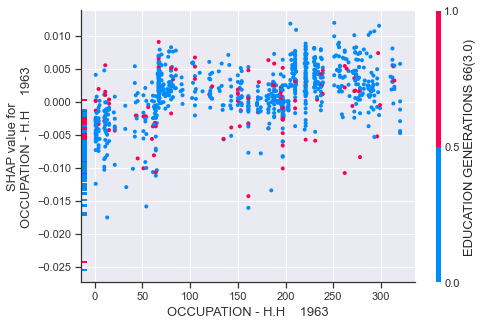

<Figure size 1152x720 with 0 Axes>

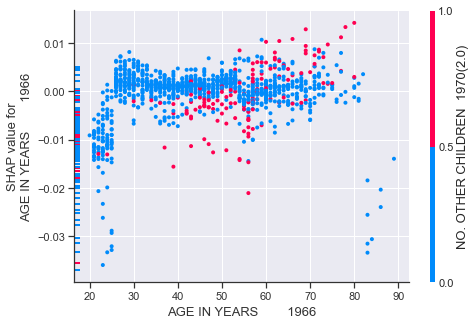

<Figure size 1152x720 with 0 Axes>

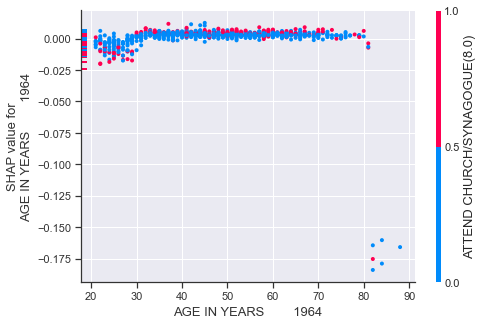

1966
MSE: 0.13, MAE: 0.27, EV: 0.05, R2: 0.05


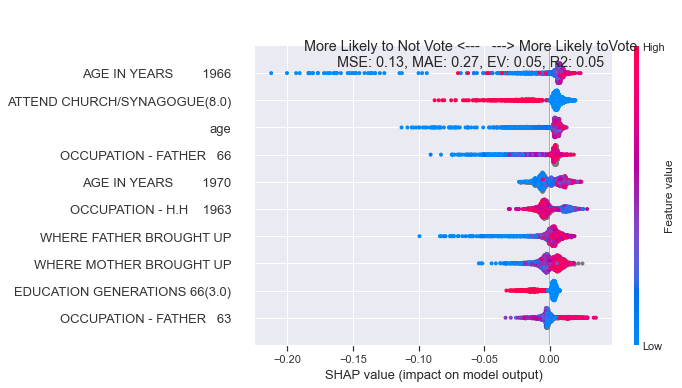

<Figure size 1152x720 with 0 Axes>

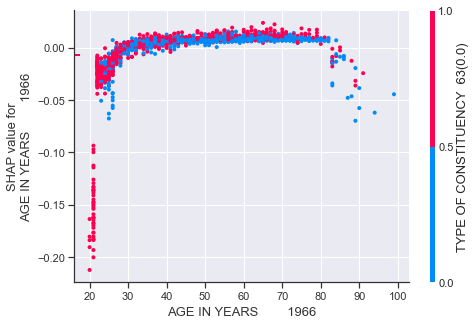

<Figure size 1152x720 with 0 Axes>

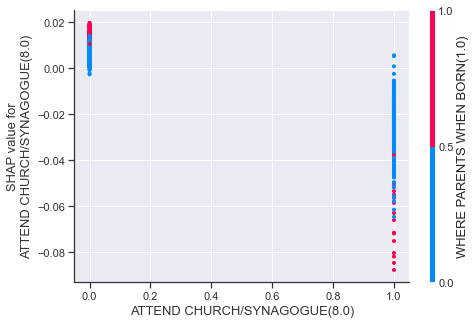

<Figure size 1152x720 with 0 Axes>

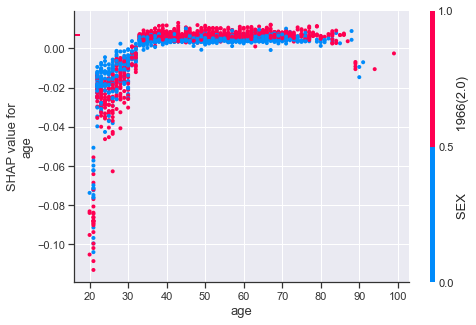

<Figure size 1152x720 with 0 Axes>

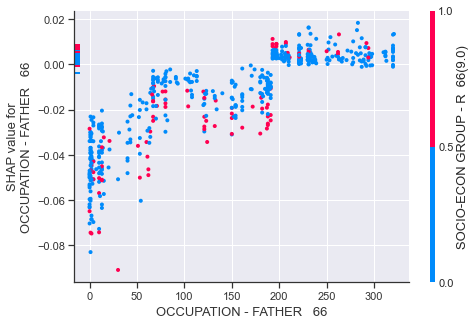

<Figure size 1152x720 with 0 Axes>

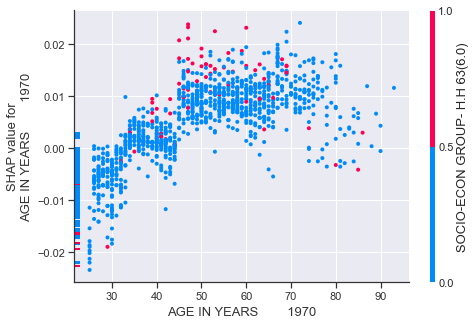

<Figure size 1152x720 with 0 Axes>

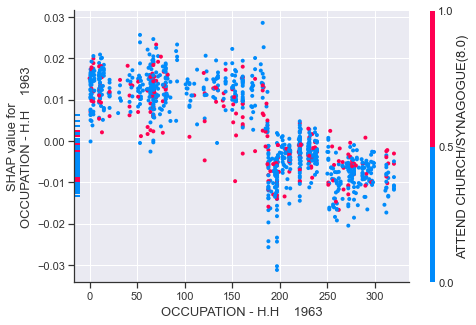

<Figure size 1152x720 with 0 Axes>

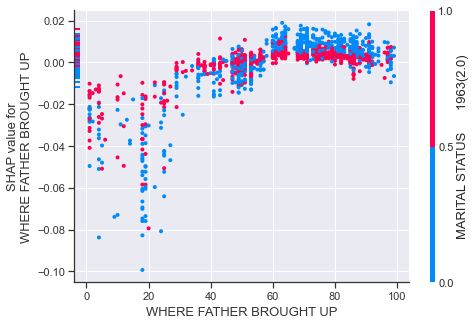

<Figure size 1152x720 with 0 Axes>

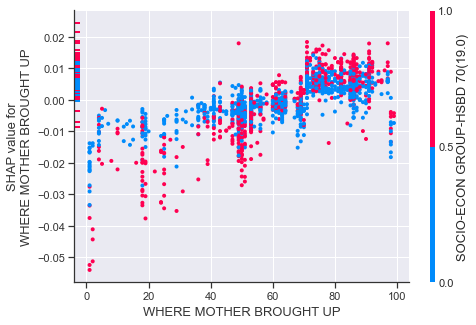

<Figure size 1152x720 with 0 Axes>

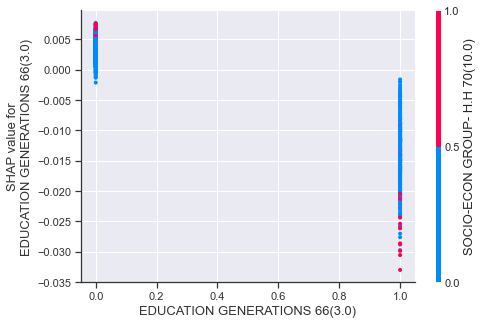

<Figure size 1152x720 with 0 Axes>

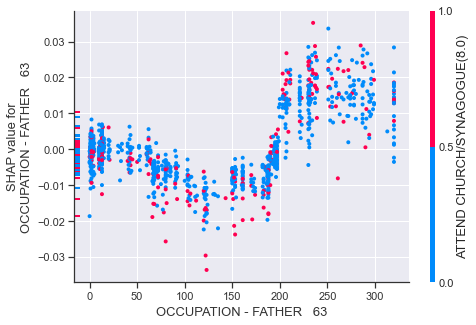

1964
MSE: 0.09, MAE: 0.19, EV: 0.00, R2: 0.00


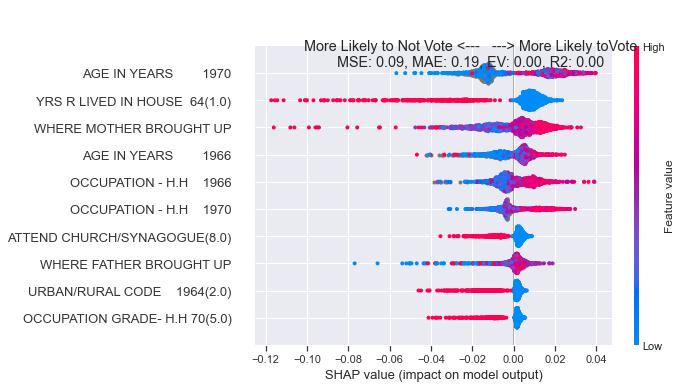

<Figure size 1152x720 with 0 Axes>

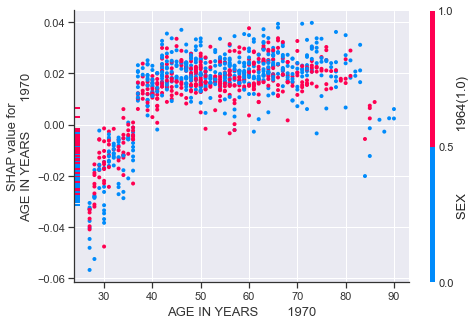

<Figure size 1152x720 with 0 Axes>

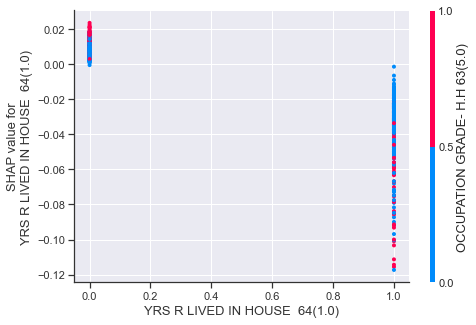

<Figure size 1152x720 with 0 Axes>

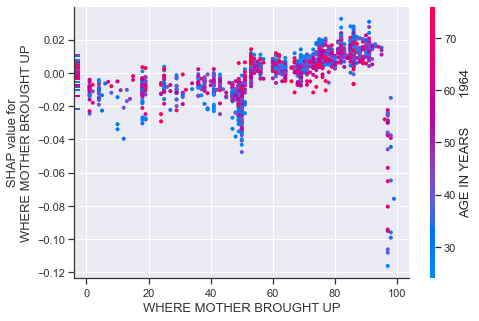

<Figure size 1152x720 with 0 Axes>

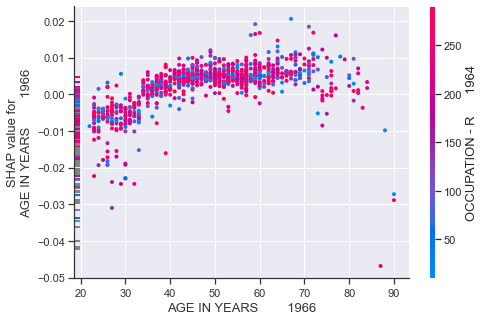

<Figure size 1152x720 with 0 Axes>

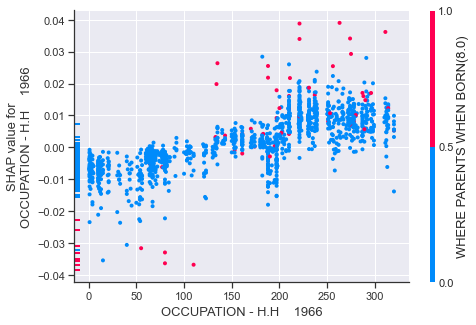

<Figure size 1152x720 with 0 Axes>

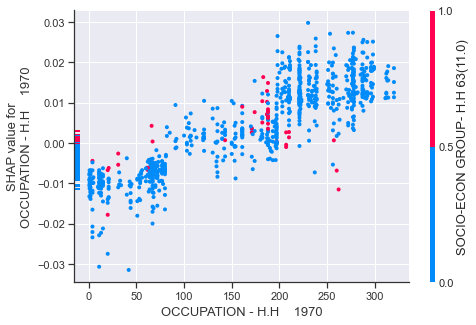

<Figure size 1152x720 with 0 Axes>

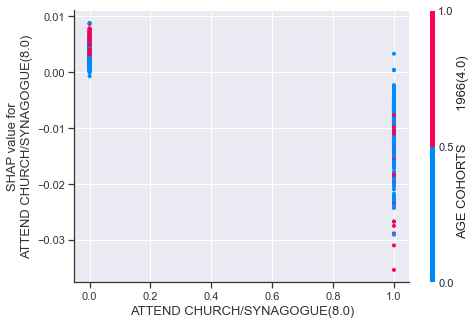

<Figure size 1152x720 with 0 Axes>

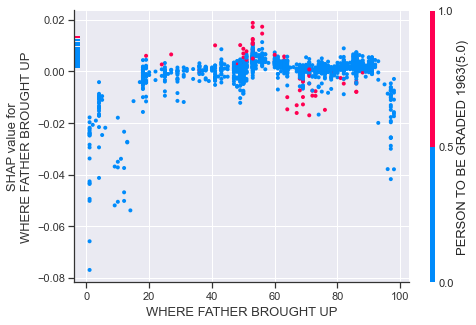

<Figure size 1152x720 with 0 Axes>

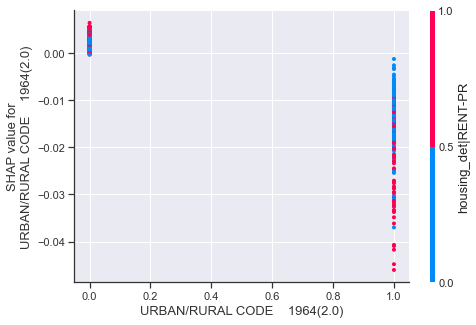

<Figure size 1152x720 with 0 Axes>

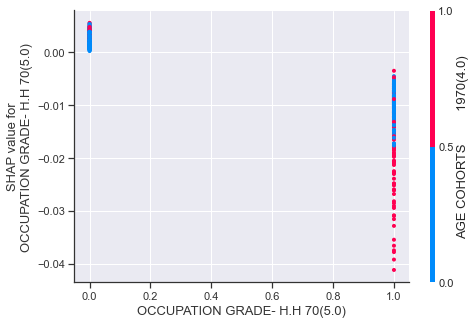

Wall time: 20min 12s


In [214]:
%%time
for ge in BES_df_list.keys():
    print(ge)
    harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
    target_var = "harmonised_voted"
    target_var_replace_dict = {}
    target_var_drop_list = []
    target_var_title_pair = ["Not Vote","Vote"]
    var_stub = "harmonised_voted"
    min_features = 10

    prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
           var_stub,harm_vars,min_features,dependence_plots=True)

In [215]:
# 2019: married|electoral_reg|age|ns_sec|highest_qual(1st deg|no qual)|own home|parents born outside Britain
# 2017: age|ns_sec|electoral_reg|gender|any_ed_qual|married|employees at workplace(25-499)|own home
# 2015: age|electoral_reg|married|home own|mortgage|ns_sec (routine occ)|religion(none)|any ed qual|parent class(routine manual/service)
# 2010: rent|age|left-ed(16|19+)|married|own|occupation(semi-sk/unsk manual)|rel(no|yes)|main income(jsa/unempl)
# 2005: gold_5_cat(99|5)|age|cage|combined age|rent from whom(9999)|marital(1)|gold_class(8)|left-ed(5)|gender(99)
# 2001: age|rent|tu memb(yes)|main income (employment)|gold_5_class(wc|salariat)|spouse-occ-sector(refused, na)|religion(no)
# 1997: age|elector_reg|attend_church|married|religious(not at all)|religion(no)|left-ed(16)|religious_denom(atheists)|spouse work<10hrs/week(no)
# 1992: age|bought la home(no)|rel_attend(never)|considered private school for kid(nvr had children)|tu memb(yes)
    # v920(income support)|spouse own other(non-priv) shares(yes)|religion(other protestant)
# 1987: age|whose name is accom in (parent/in-law)|v66c(<1yr)|v66b(<1yr)|religion(no rel)|resp occ group|married|father's occ group|spouse occ group
    # any childre at/been to private school(no)
# 1983: age|own phone|gold_class(skilled manual)|spouse(n-manual)|tu memb|months unemployed(skipped)|rcvd suppl benefits|
    # private sector|rcvd rent rebate(no)|school att(comprehensive)
# 1979: age|rel_upbrining(not really)|own home|fe_or_training(no)|car/van(no)|left-ed(15|0?)|rel_denom(other,christian)|rel_atten(never)
    # spouse has job(no, housewife)
# 1974_feb: age|widowed or separated|length_of_res(1)|father's occ unit(114)|rent-pr|husb has spec training(yes|no)[married!]|expect to move(no)|
    # area grew up(w midlands|n west)
# 1974_oct: age|length_of_res(1)|mortgage|single|area grew up(nw)|anyone else unemployed(yes)|father's soc-econ-gp(12)|
    # standard region(e midlands)|left-ed(15)
# 1970: occ (father/respondent/hh)|age|attend church/syn(8)|size town father from(2)|where moving to(9)
# 1966: age|attend church/syn(8)|occ (father/respondent/hh)|education generations 66(3) (???)|where father brought up
# 1964: age|years resp lived in house(1)|where mother brought up|occupation(hh)|kind of school(5)

In [ ]:
# Overall
# (married|single|widowed or separated)/electoral_reg/age/ns_sec/gender
# parents born outside Britain/parent class/father occ group/spouse has job(no, housewife)
# any children at/been to private school/own phone/car|van(no)
# ns_sec(routine occ/occupation(semi-sk/unsk manual)/gold_5_cat(99|5|wc|salariat)/gold_class(8|skilled manual)/occ group
# main income(jsa/unempl|employment)/tu memb(yes)
# employees at workplace (25-499)/(own home/mortgage/rent)/parent class/months unemployed(skipped)|rcvd suppl benefits
# highest_or_any_qual/left-ed(16/19+)/school att(comprehensive)/fe_or_training(no)
# religion(none/no/yes)/attend church/religious(not at all)/rel_denom(atheist|other,christian)/rel_upbringing(not really)/rel_att(never)
# are grew up/standard region/length_of_res/where moving to/years lived in house/
# where mother brought up/size town father from

In [216]:
# 2019 non-voting
# married (x gender)
# age (x ns_sec)
# electoral reg

2019
MSE: 0.20, MAE: 0.40, EV: 0.15, R2: 0.15


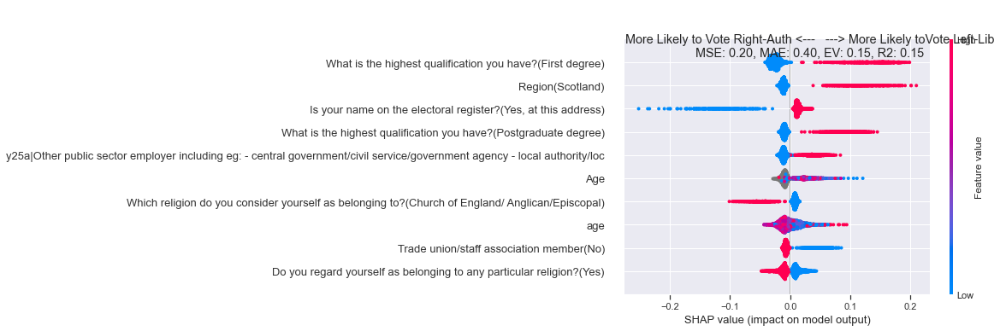

<Figure size 1152x720 with 0 Axes>

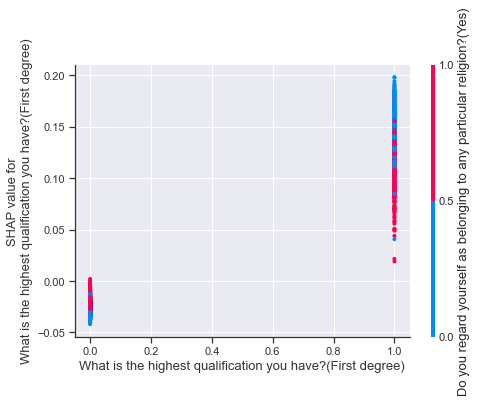

<Figure size 1152x720 with 0 Axes>

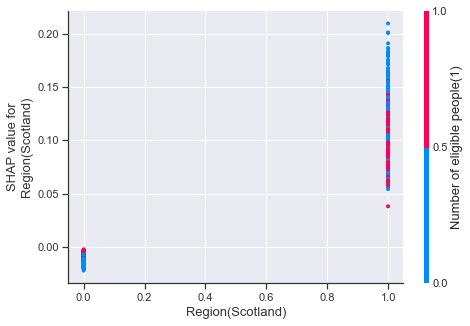

<Figure size 1152x720 with 0 Axes>

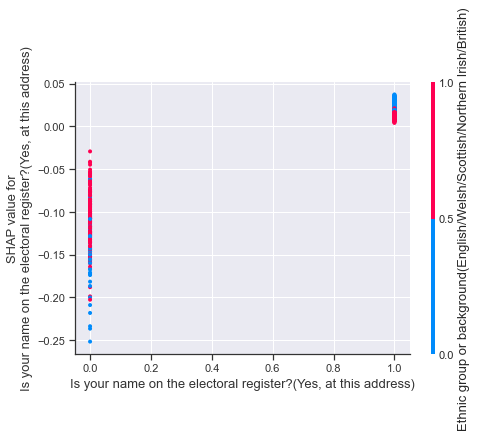

<Figure size 1152x720 with 0 Axes>

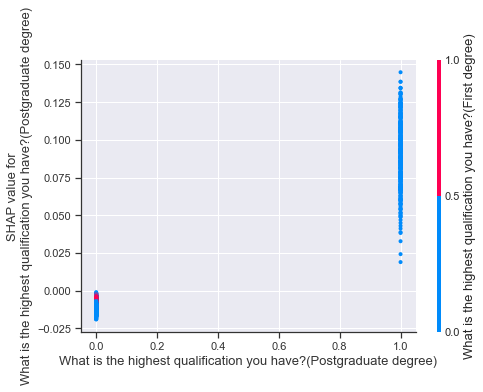

<Figure size 1152x720 with 0 Axes>

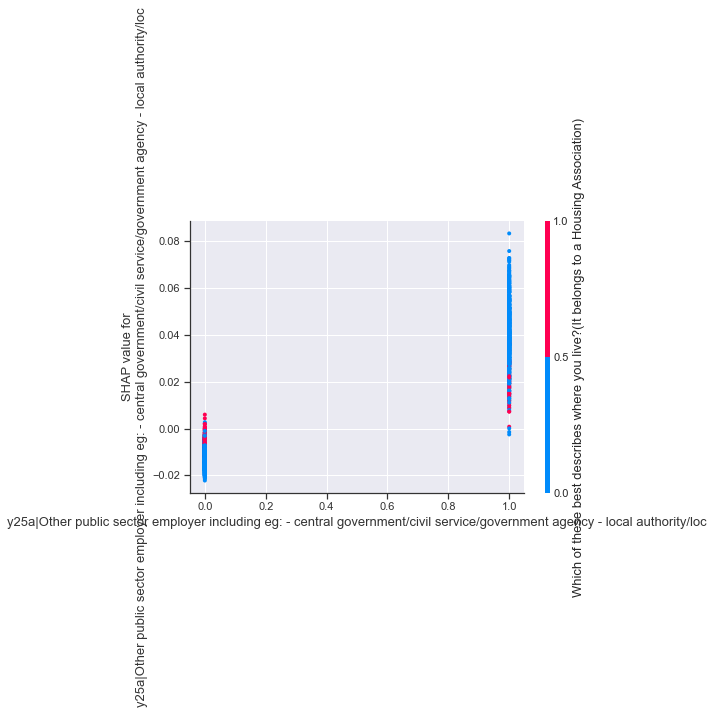

<Figure size 1152x720 with 0 Axes>

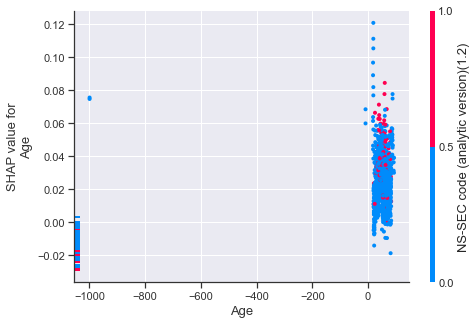

<Figure size 1152x720 with 0 Axes>

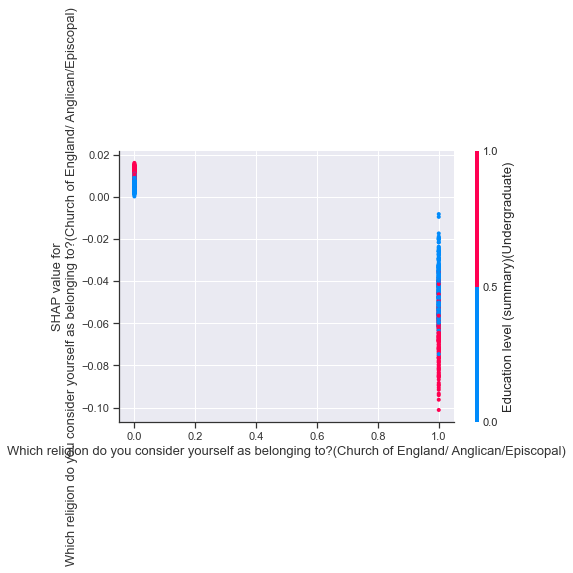

<Figure size 1152x720 with 0 Axes>

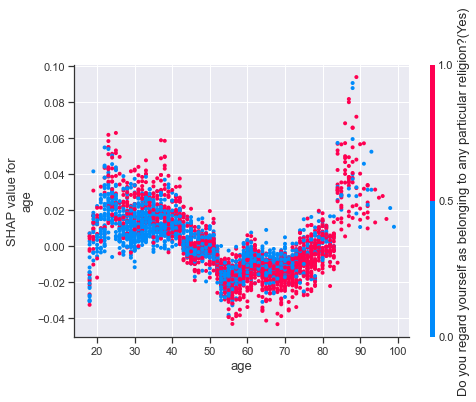

<Figure size 1152x720 with 0 Axes>

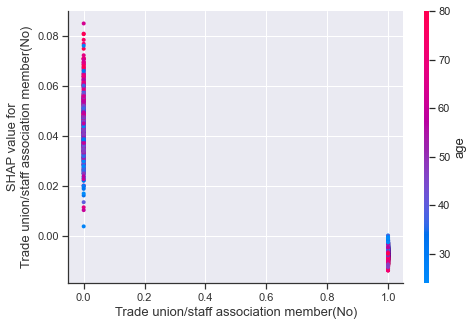

<Figure size 1152x720 with 0 Axes>

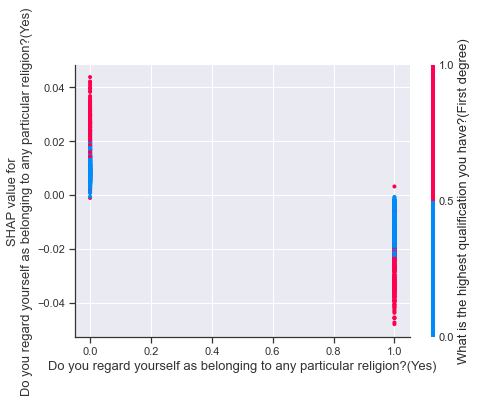

2017
MSE: 0.22, MAE: 0.44, EV: 0.11, R2: 0.10


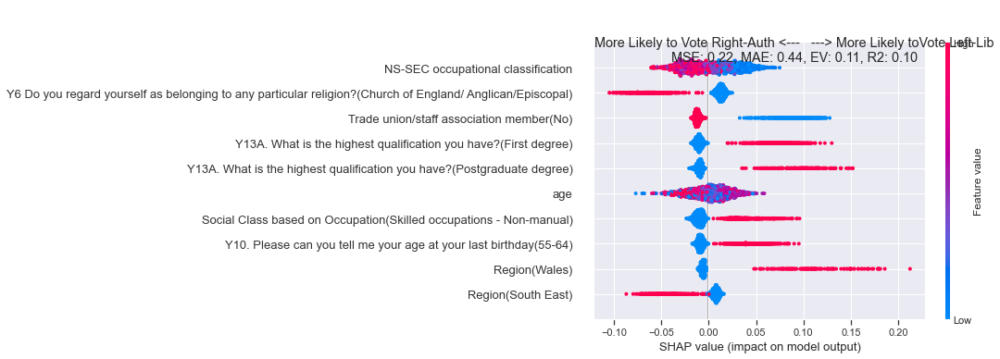

<Figure size 1152x720 with 0 Axes>

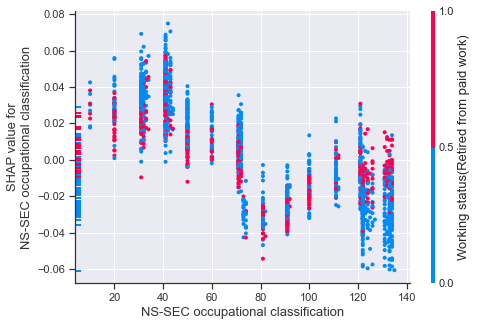

<Figure size 1152x720 with 0 Axes>

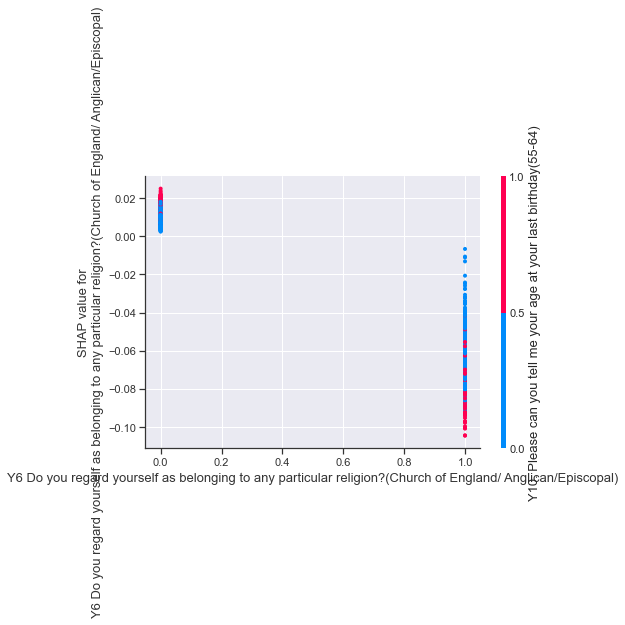

<Figure size 1152x720 with 0 Axes>

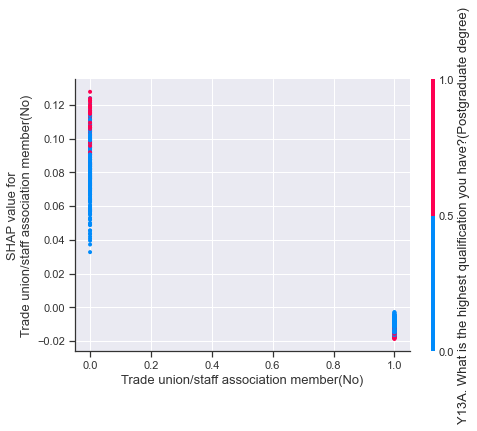

<Figure size 1152x720 with 0 Axes>

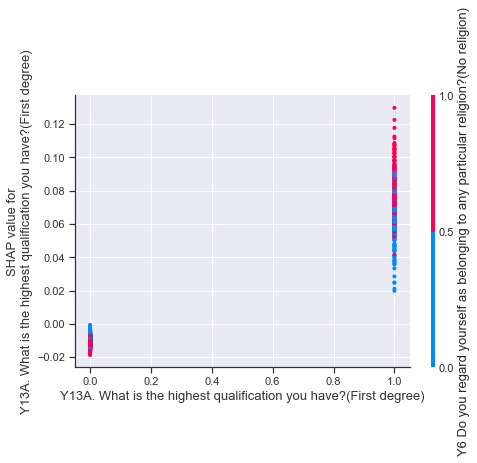

<Figure size 1152x720 with 0 Axes>

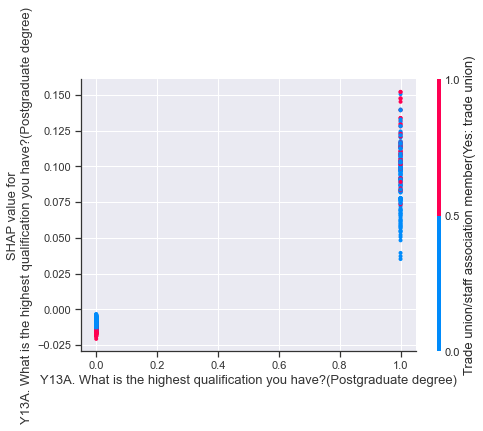

<Figure size 1152x720 with 0 Axes>

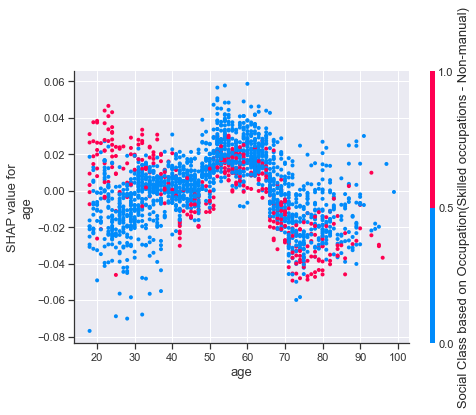

<Figure size 1152x720 with 0 Axes>

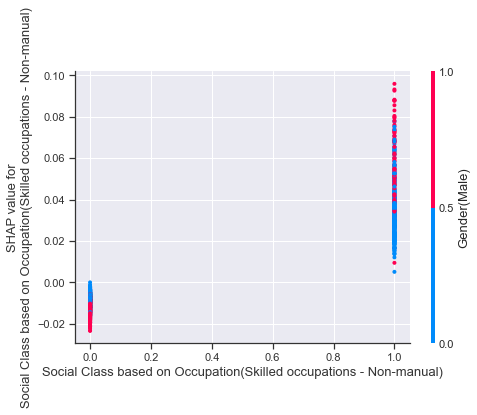

<Figure size 1152x720 with 0 Axes>

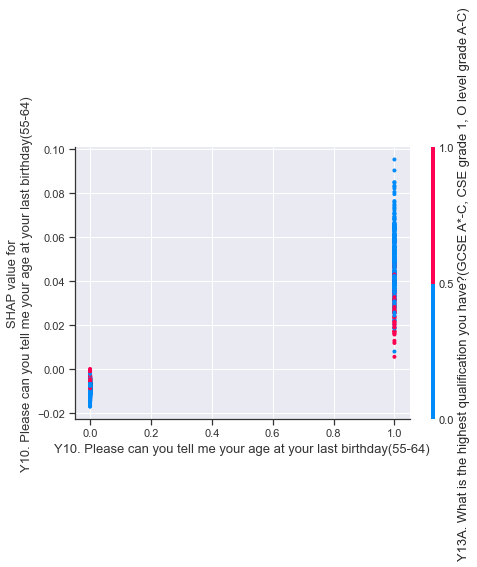

<Figure size 1152x720 with 0 Axes>

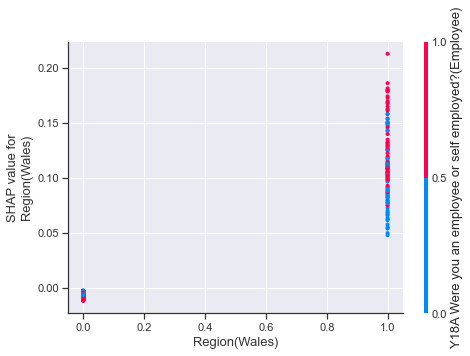

<Figure size 1152x720 with 0 Axes>

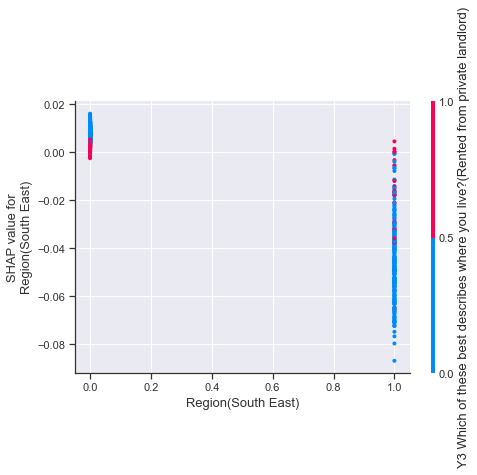

2015
MSE: 0.21, MAE: 0.42, EV: 0.09, R2: 0.08


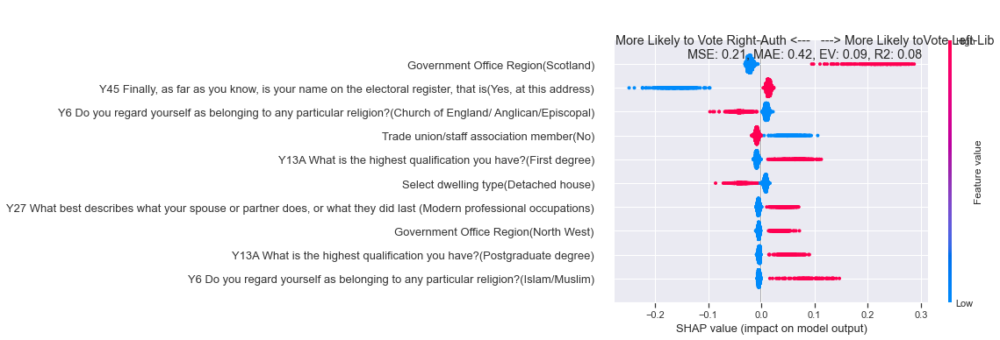

<Figure size 1152x720 with 0 Axes>

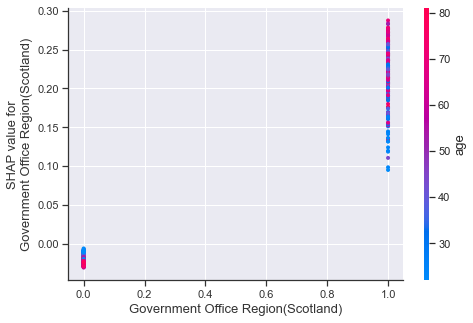

<Figure size 1152x720 with 0 Axes>

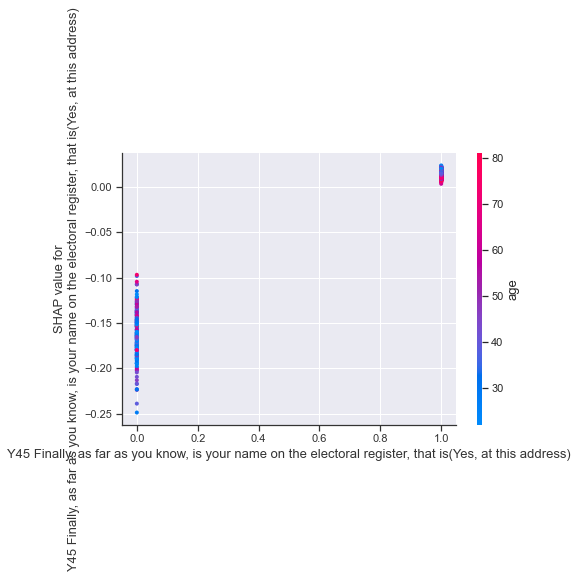

<Figure size 1152x720 with 0 Axes>

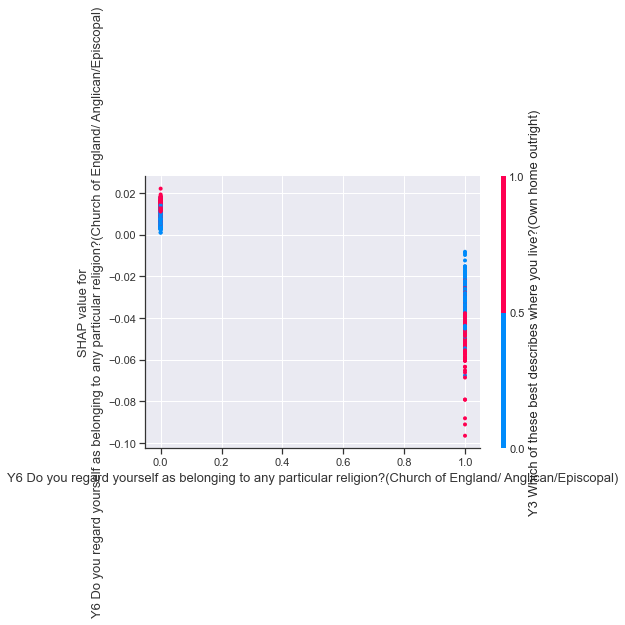

<Figure size 1152x720 with 0 Axes>

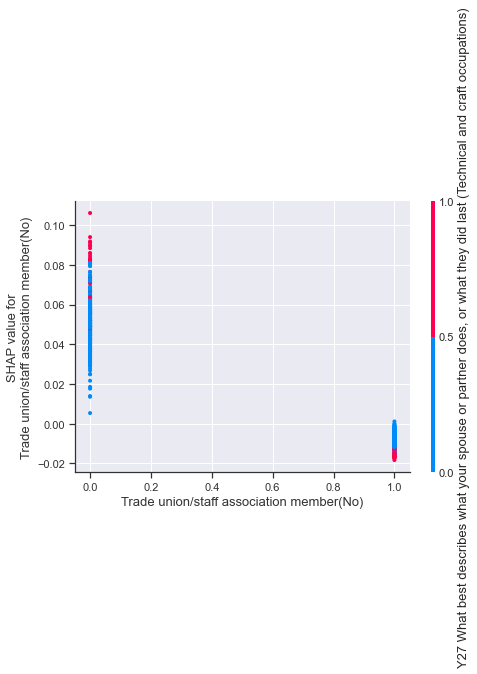

<Figure size 1152x720 with 0 Axes>

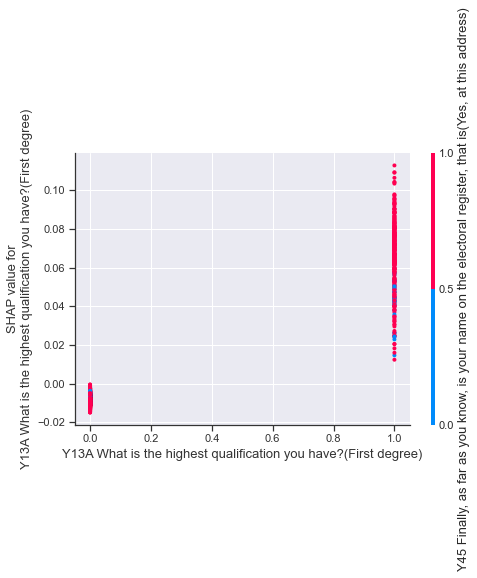

<Figure size 1152x720 with 0 Axes>

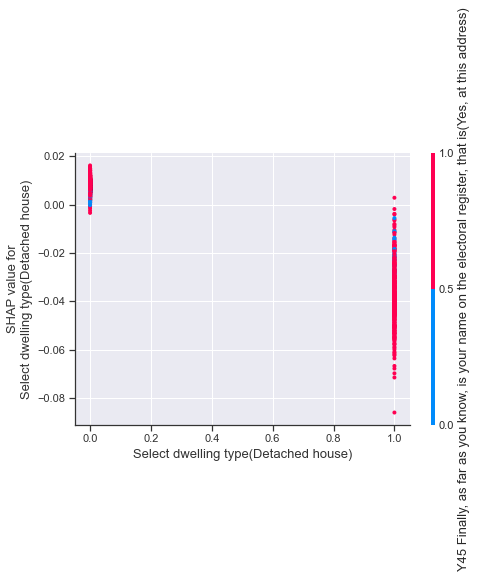

<Figure size 1152x720 with 0 Axes>

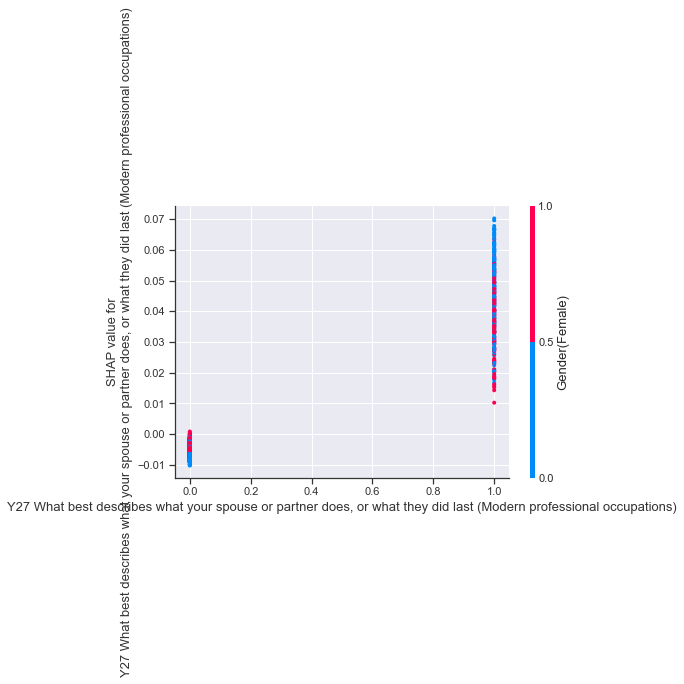

<Figure size 1152x720 with 0 Axes>

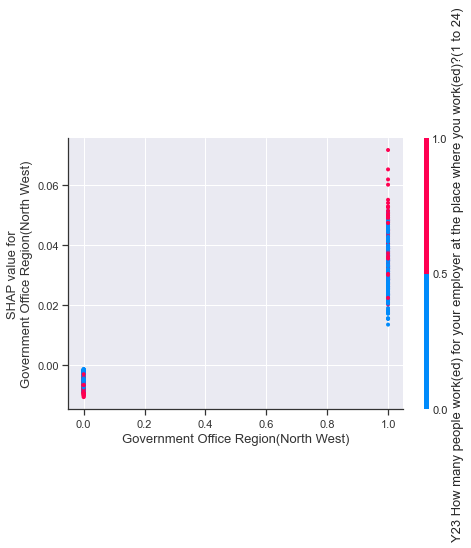

<Figure size 1152x720 with 0 Axes>

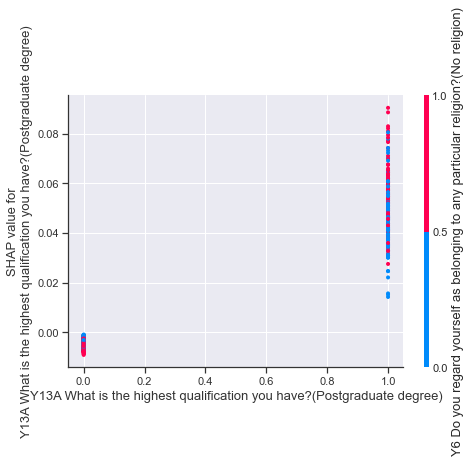

<Figure size 1152x720 with 0 Axes>

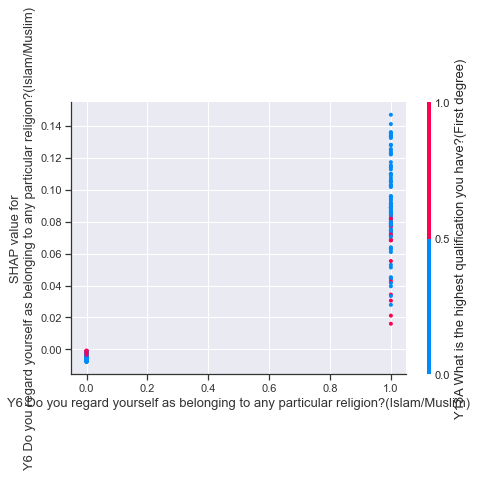

2010
MSE: 0.23, MAE: 0.45, EV: 0.08, R2: 0.08


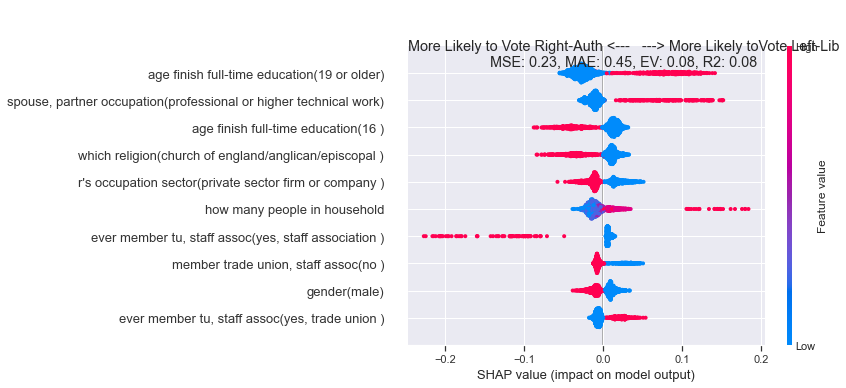

<Figure size 1152x720 with 0 Axes>

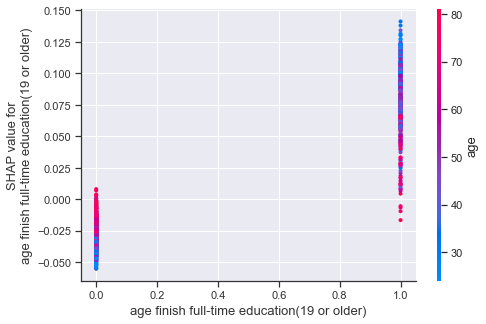

<Figure size 1152x720 with 0 Axes>

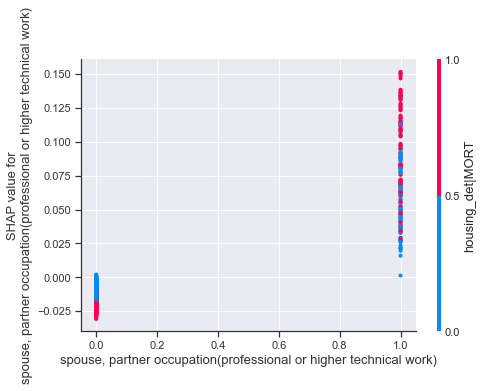

<Figure size 1152x720 with 0 Axes>

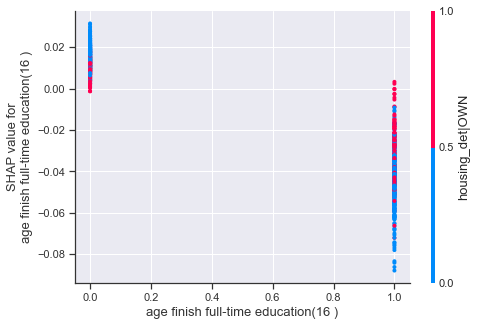

<Figure size 1152x720 with 0 Axes>

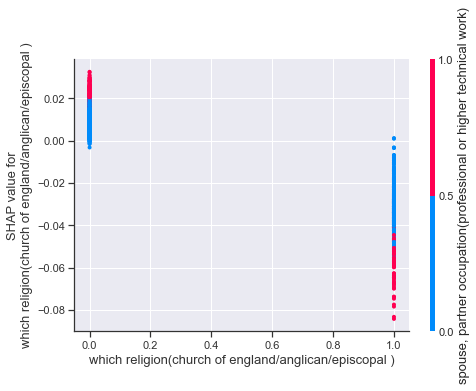

<Figure size 1152x720 with 0 Axes>

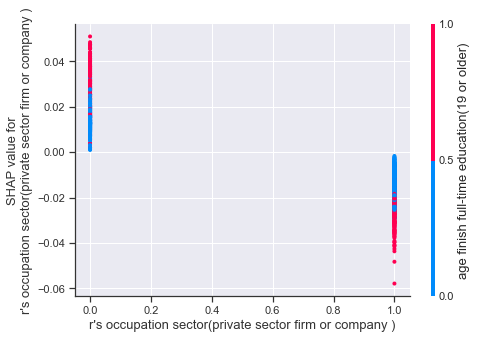

<Figure size 1152x720 with 0 Axes>

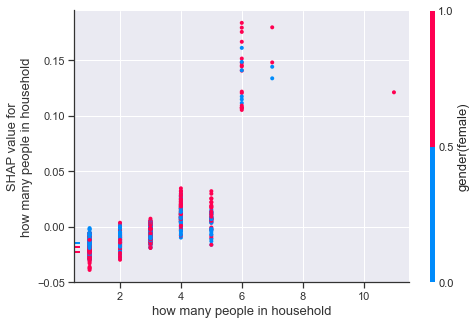

<Figure size 1152x720 with 0 Axes>

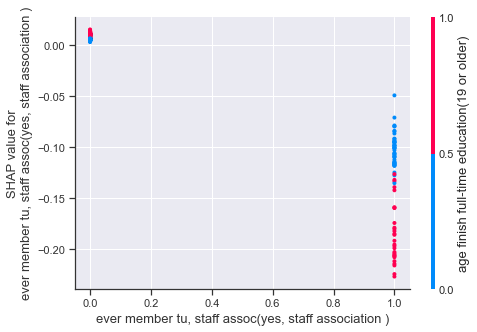

<Figure size 1152x720 with 0 Axes>

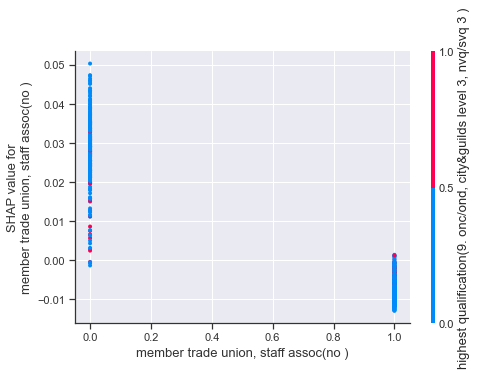

<Figure size 1152x720 with 0 Axes>

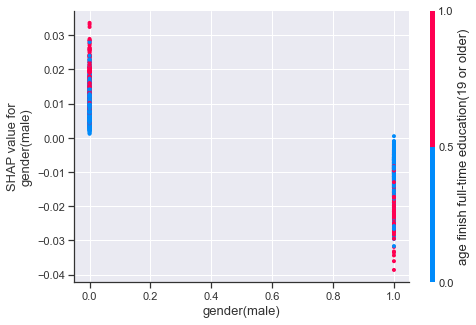

<Figure size 1152x720 with 0 Axes>

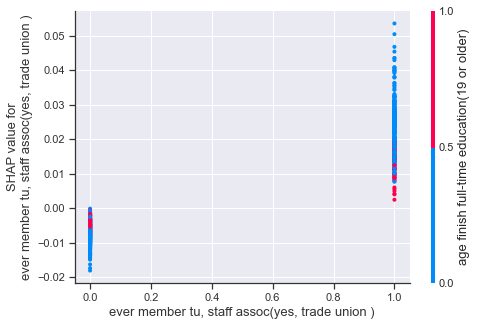

2005
MSE: 0.19, MAE: 0.39, EV: 0.20, R2: 0.20


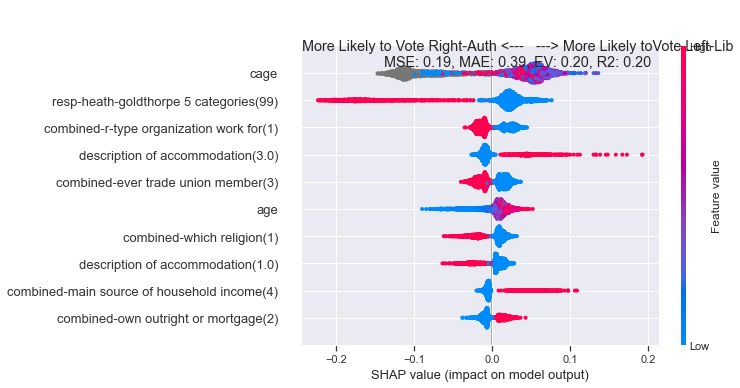

<Figure size 1152x720 with 0 Axes>

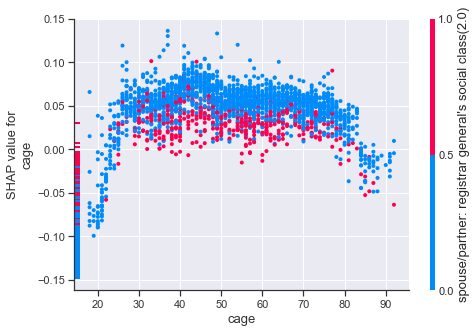

<Figure size 1152x720 with 0 Axes>

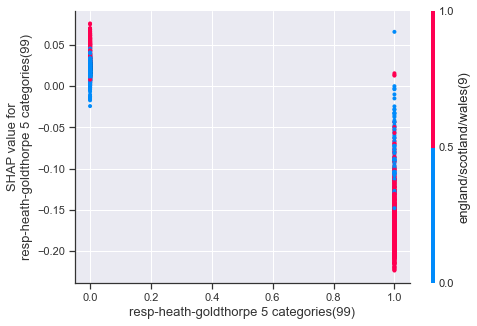

<Figure size 1152x720 with 0 Axes>

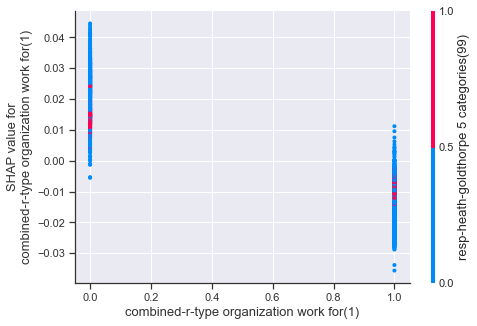

<Figure size 1152x720 with 0 Axes>

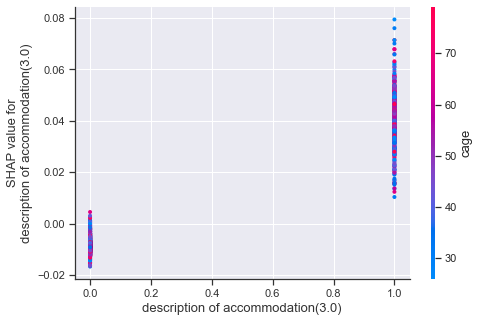

<Figure size 1152x720 with 0 Axes>

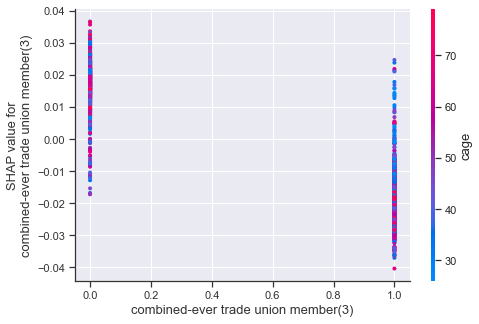

<Figure size 1152x720 with 0 Axes>

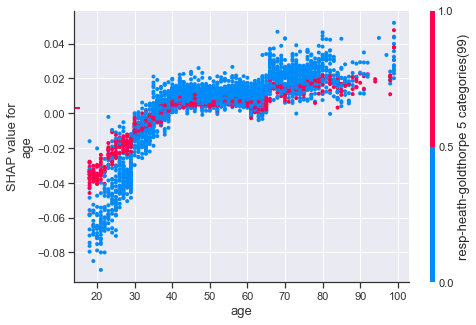

<Figure size 1152x720 with 0 Axes>

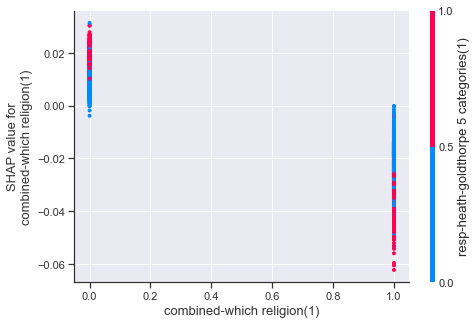

<Figure size 1152x720 with 0 Axes>

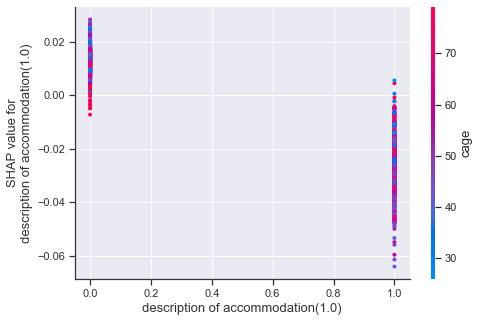

<Figure size 1152x720 with 0 Axes>

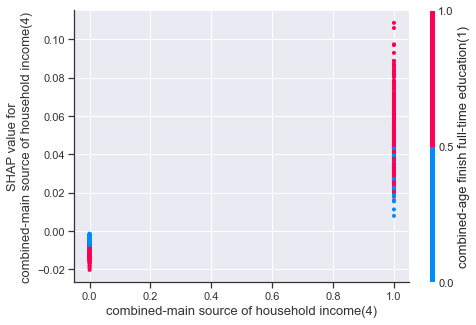

<Figure size 1152x720 with 0 Axes>

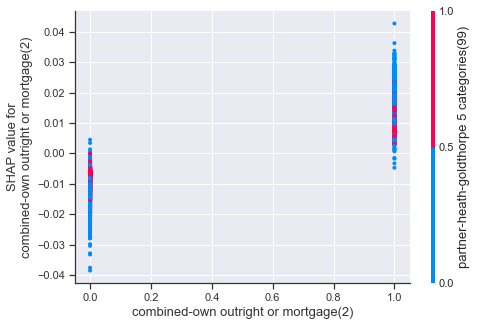

2001
MSE: 0.24, MAE: 0.49, EV: 0.03, R2: 0.03


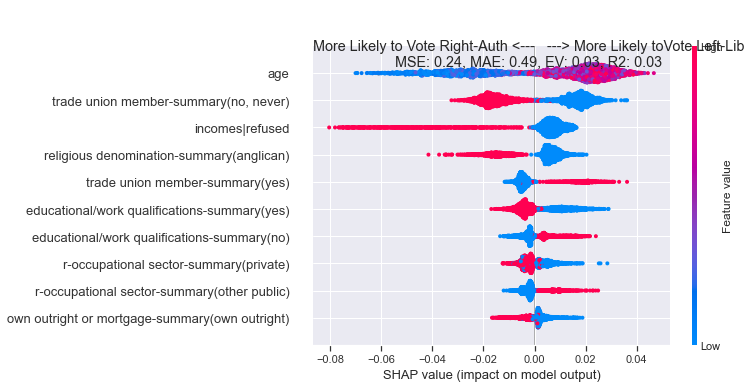

<Figure size 1152x720 with 0 Axes>

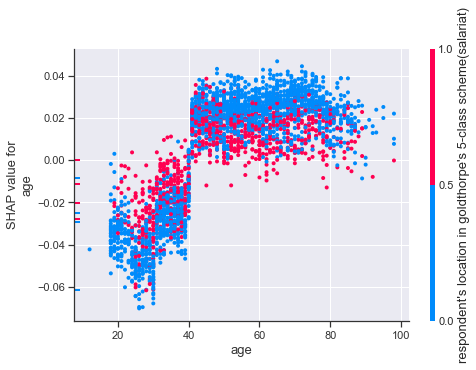

<Figure size 1152x720 with 0 Axes>

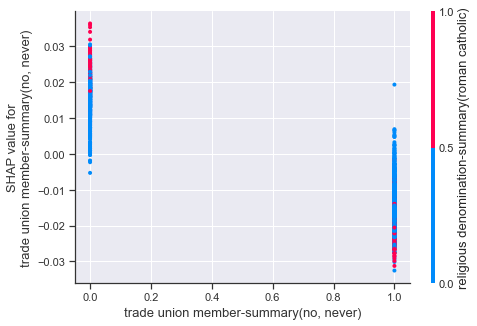

<Figure size 1152x720 with 0 Axes>

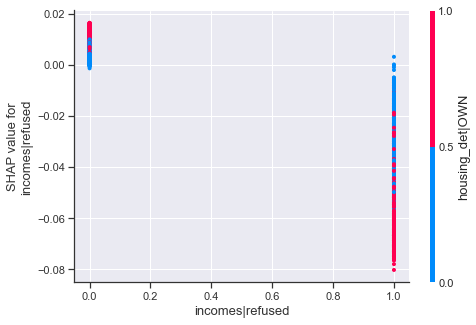

<Figure size 1152x720 with 0 Axes>

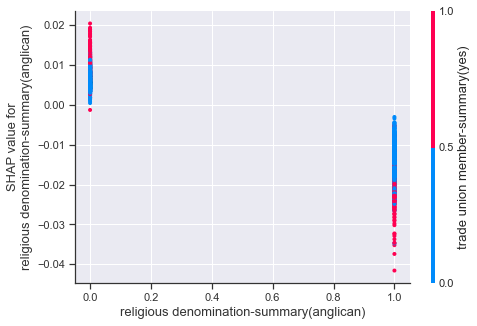

<Figure size 1152x720 with 0 Axes>

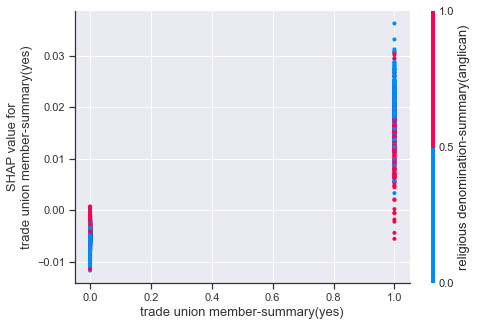

<Figure size 1152x720 with 0 Axes>

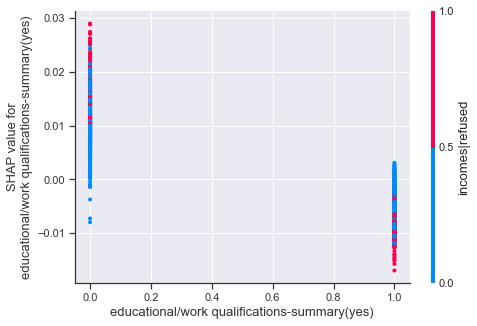

<Figure size 1152x720 with 0 Axes>

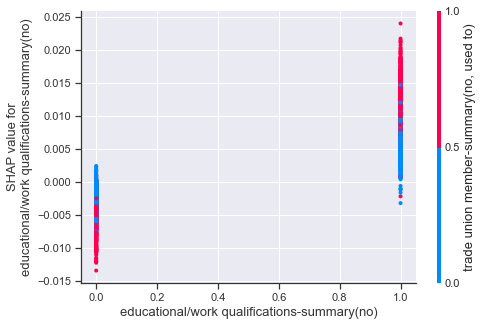

<Figure size 1152x720 with 0 Axes>

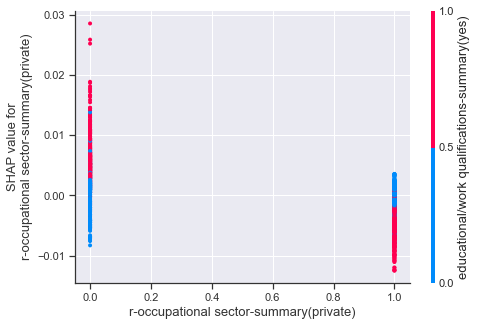

<Figure size 1152x720 with 0 Axes>

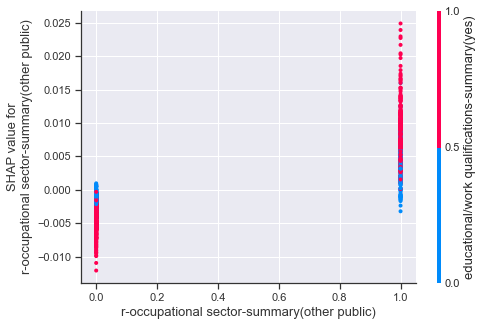

<Figure size 1152x720 with 0 Axes>

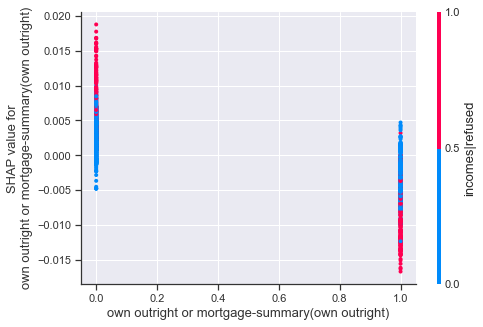

1997
MSE: 0.22, MAE: 0.44, EV: 0.11, R2: 0.11


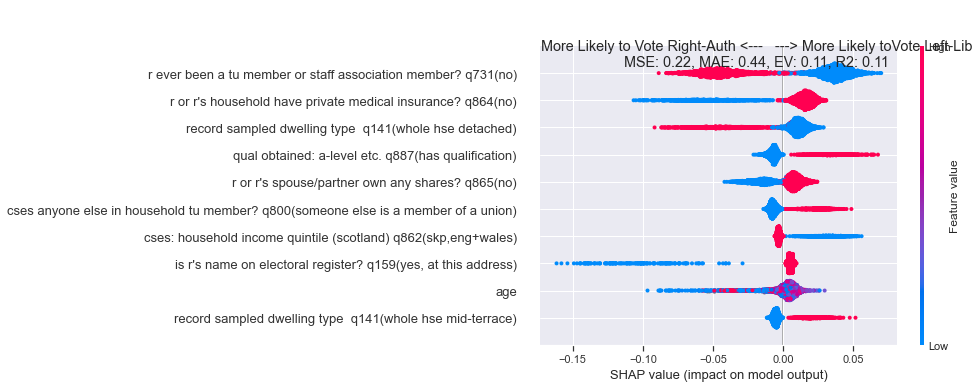

<Figure size 1152x720 with 0 Axes>

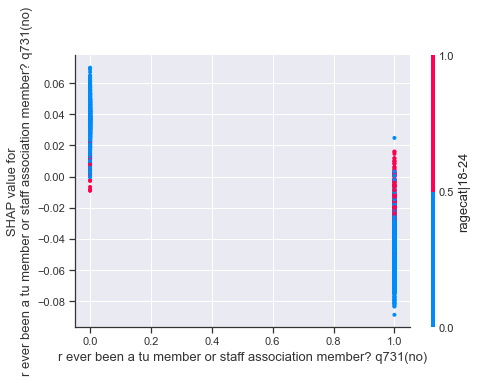

<Figure size 1152x720 with 0 Axes>

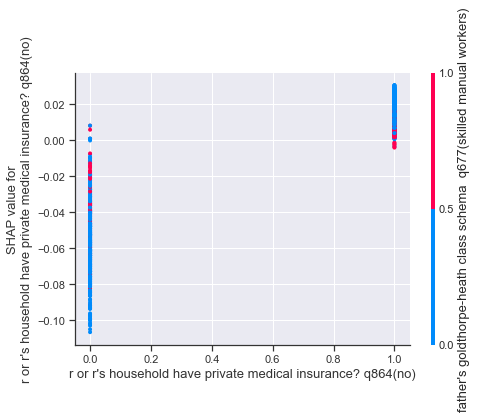

<Figure size 1152x720 with 0 Axes>

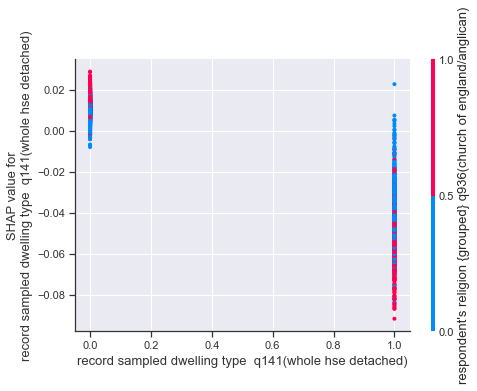

<Figure size 1152x720 with 0 Axes>

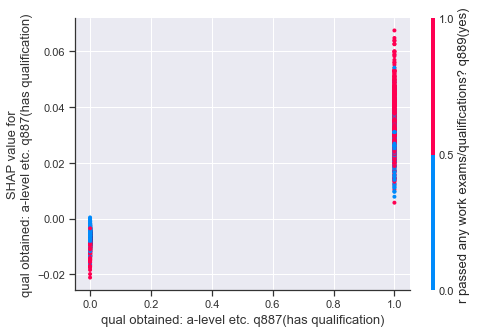

<Figure size 1152x720 with 0 Axes>

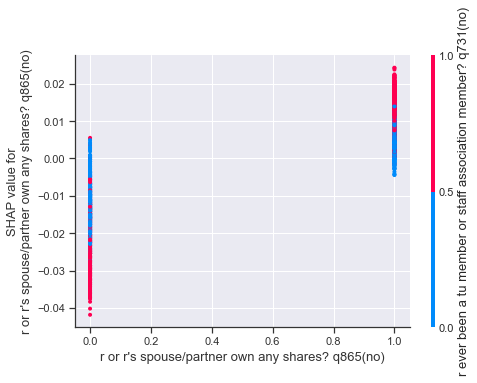

<Figure size 1152x720 with 0 Axes>

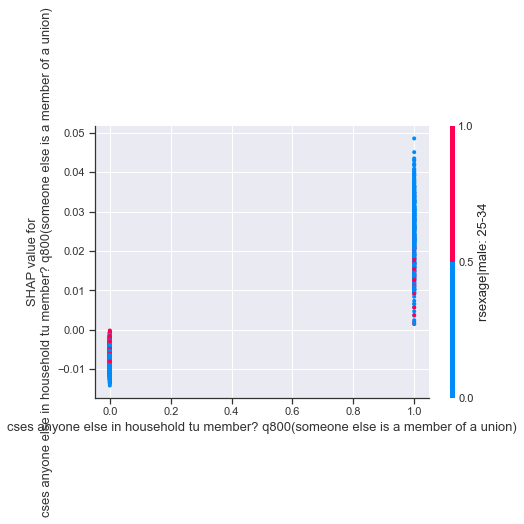

<Figure size 1152x720 with 0 Axes>

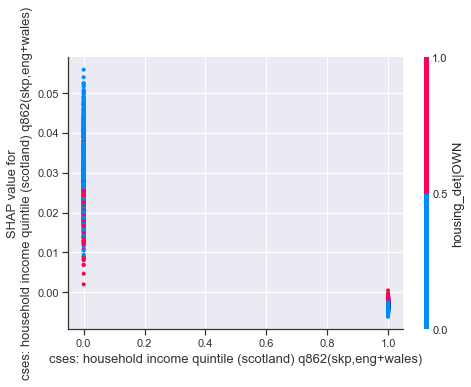

<Figure size 1152x720 with 0 Axes>

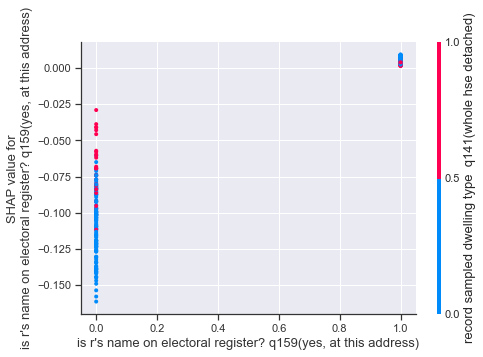

<Figure size 1152x720 with 0 Axes>

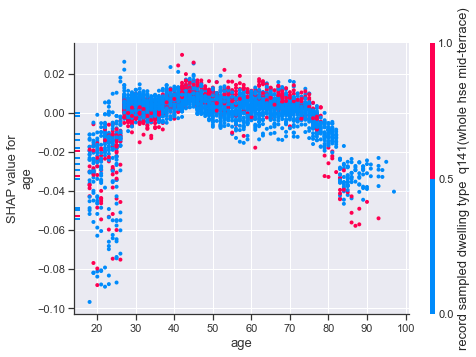

<Figure size 1152x720 with 0 Axes>

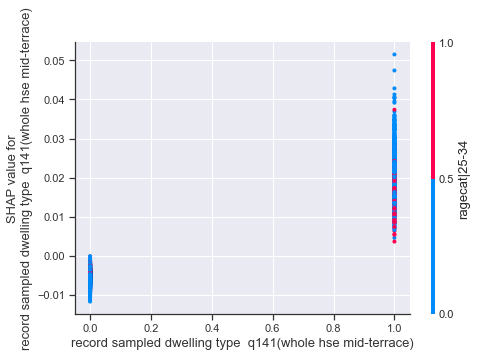

1992
MSE: 0.20, MAE: 0.42, EV: 0.18, R2: 0.18


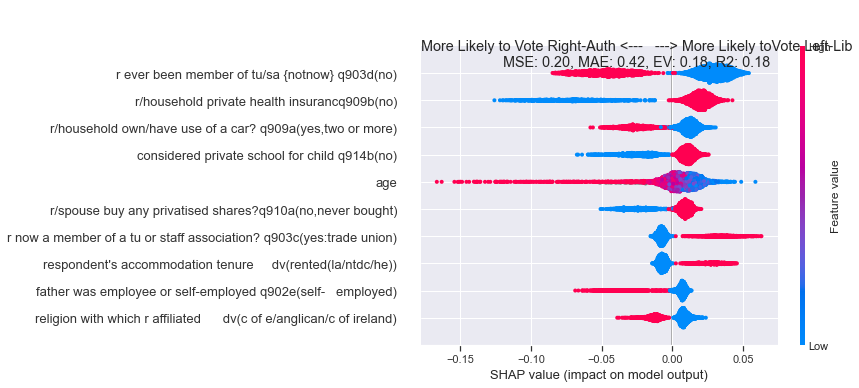

<Figure size 1152x720 with 0 Axes>

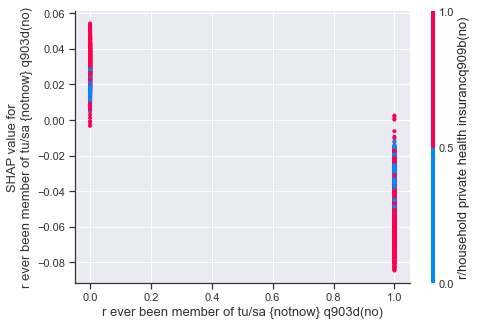

<Figure size 1152x720 with 0 Axes>

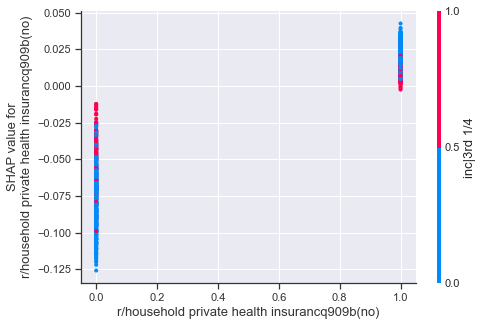

<Figure size 1152x720 with 0 Axes>

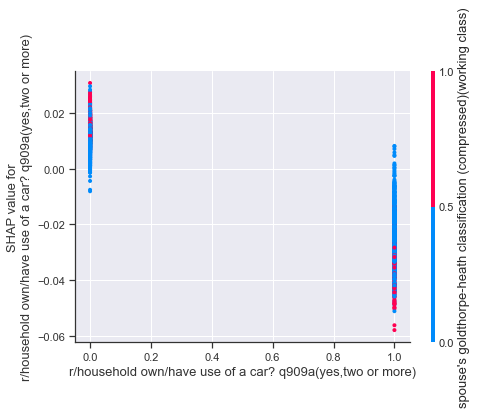

<Figure size 1152x720 with 0 Axes>

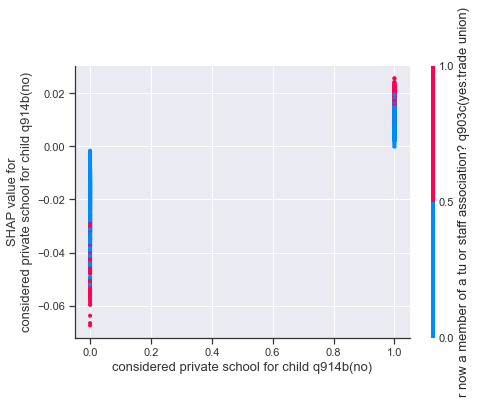

<Figure size 1152x720 with 0 Axes>

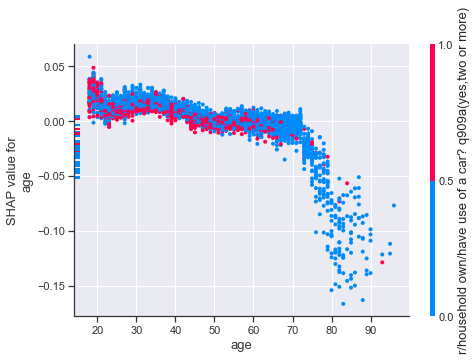

<Figure size 1152x720 with 0 Axes>

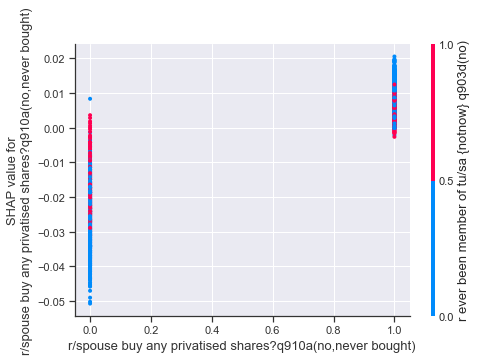

<Figure size 1152x720 with 0 Axes>

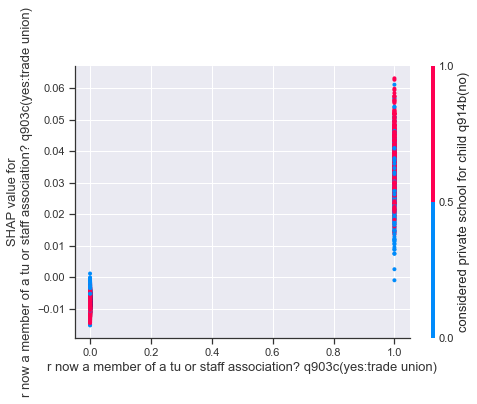

<Figure size 1152x720 with 0 Axes>

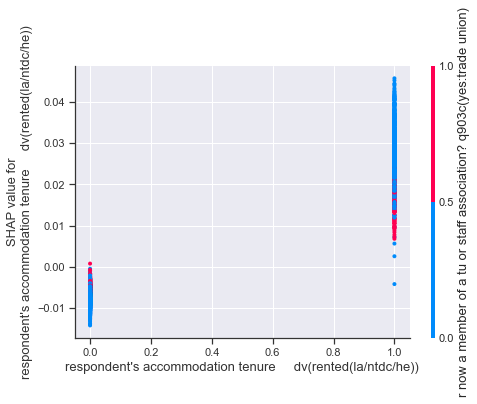

<Figure size 1152x720 with 0 Axes>

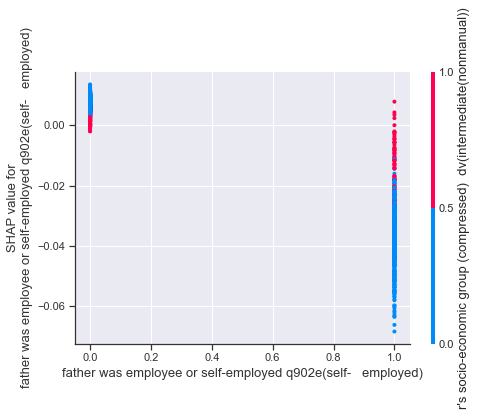

<Figure size 1152x720 with 0 Axes>

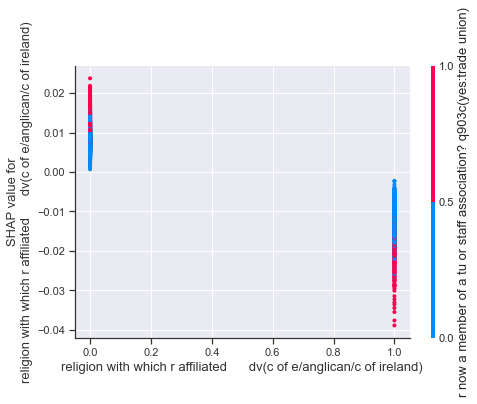

1987
MSE: 0.21, MAE: 0.42, EV: 0.16, R2: 0.16


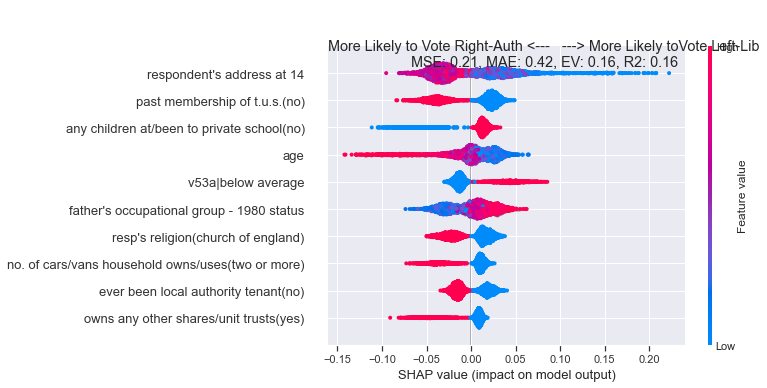

<Figure size 1152x720 with 0 Axes>

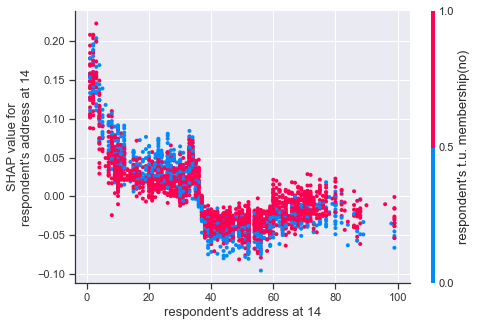

<Figure size 1152x720 with 0 Axes>

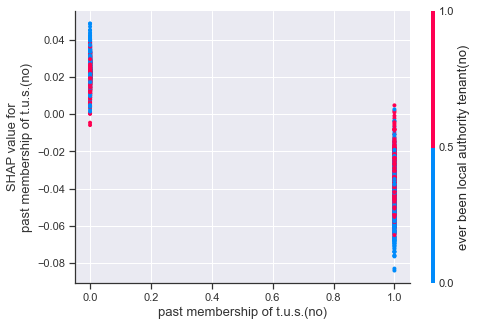

<Figure size 1152x720 with 0 Axes>

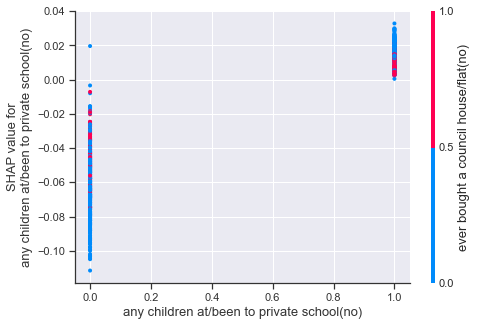

<Figure size 1152x720 with 0 Axes>

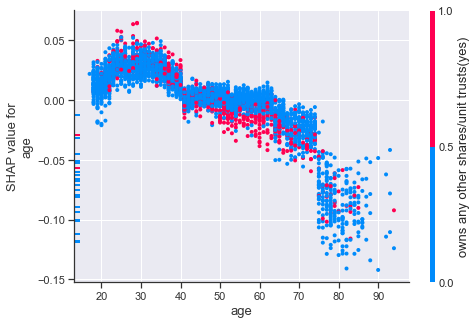

<Figure size 1152x720 with 0 Axes>

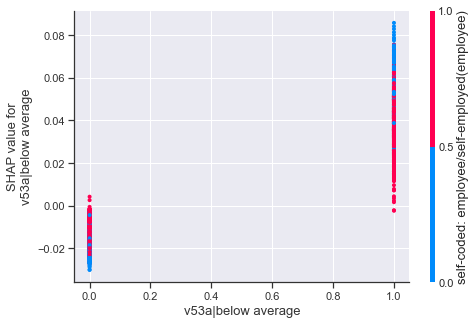

<Figure size 1152x720 with 0 Axes>

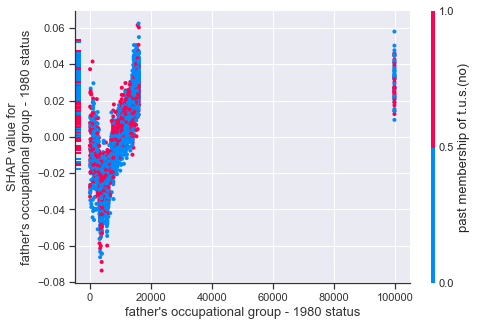

<Figure size 1152x720 with 0 Axes>

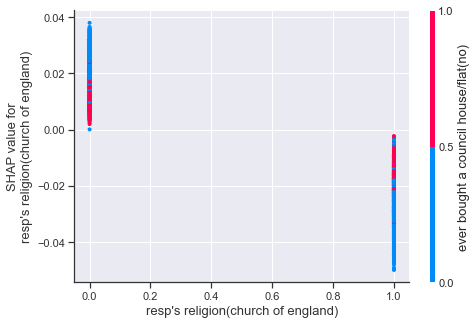

<Figure size 1152x720 with 0 Axes>

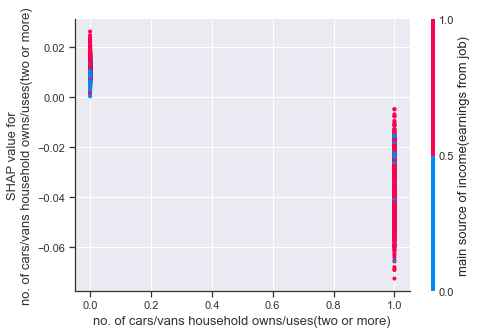

<Figure size 1152x720 with 0 Axes>

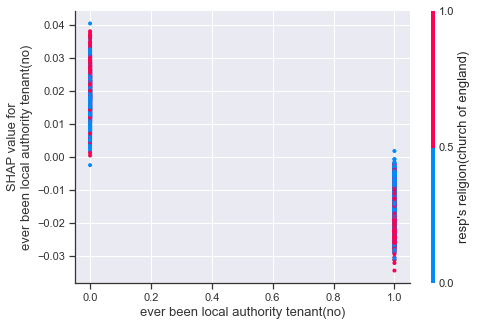

<Figure size 1152x720 with 0 Axes>

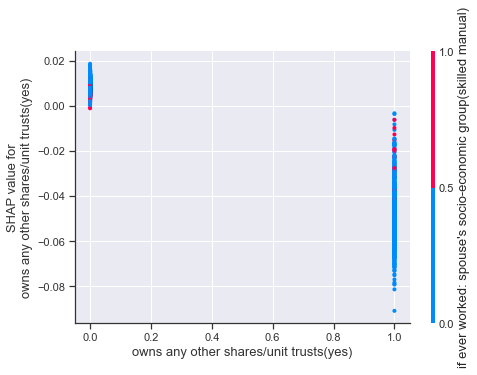

1983
MSE: 0.23, MAE: 0.45, EV: 0.08, R2: 0.08


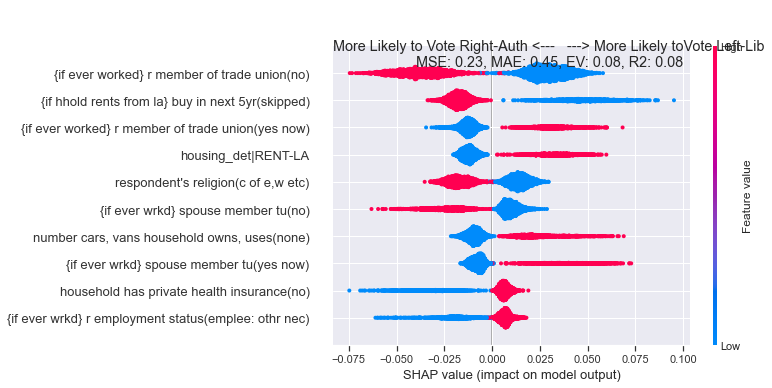

<Figure size 1152x720 with 0 Axes>

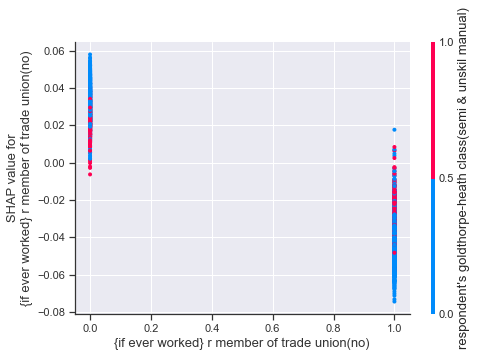

<Figure size 1152x720 with 0 Axes>

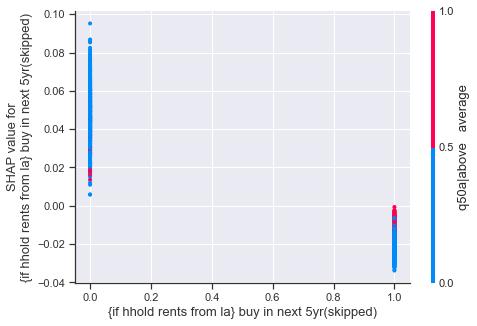

<Figure size 1152x720 with 0 Axes>

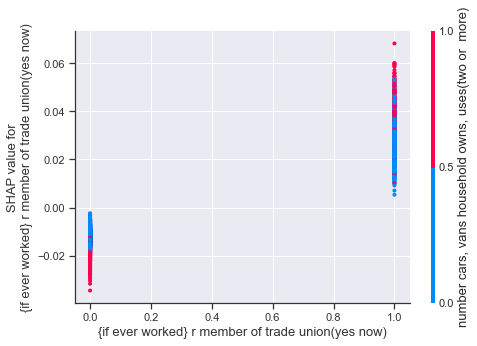

<Figure size 1152x720 with 0 Axes>

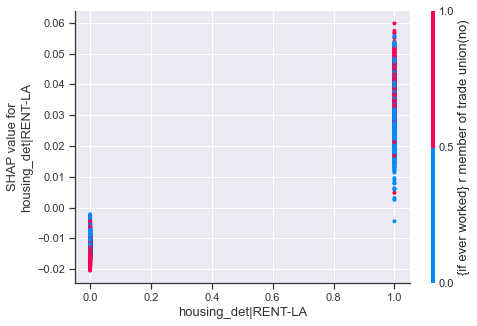

<Figure size 1152x720 with 0 Axes>

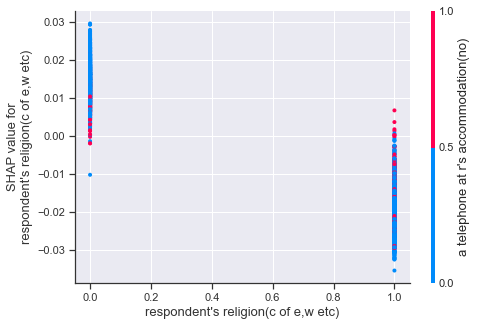

<Figure size 1152x720 with 0 Axes>

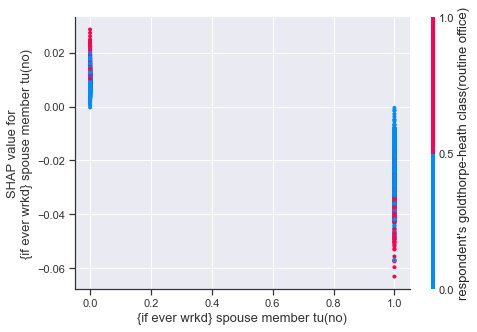

<Figure size 1152x720 with 0 Axes>

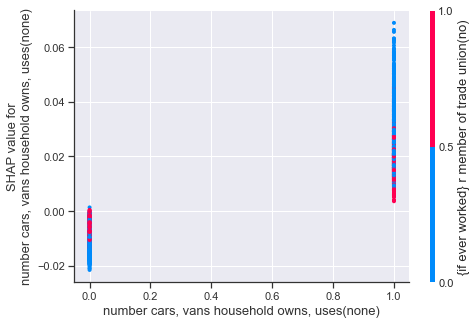

<Figure size 1152x720 with 0 Axes>

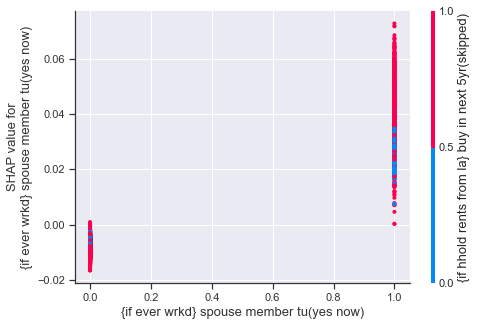

<Figure size 1152x720 with 0 Axes>

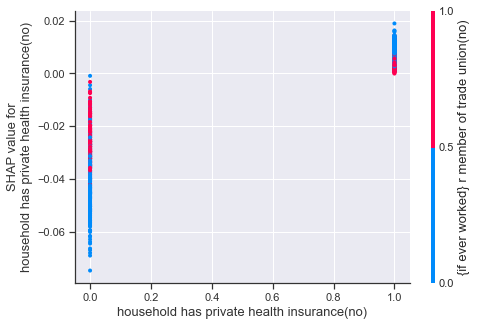

<Figure size 1152x720 with 0 Axes>

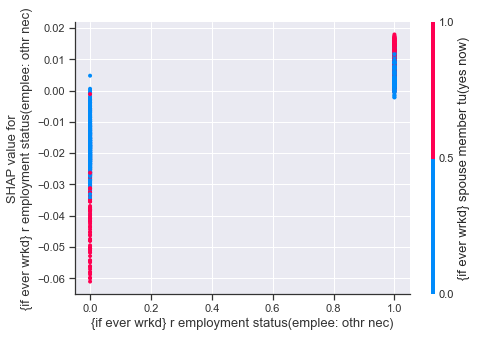

1979
MSE: 0.22, MAE: 0.44, EV: 0.09, R2: 0.09


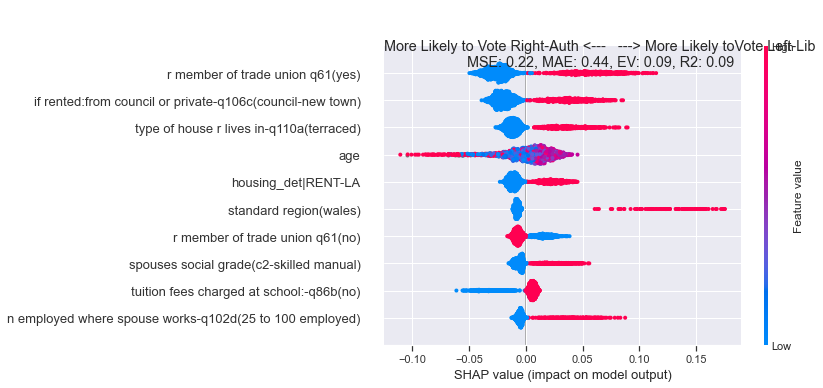

<Figure size 1152x720 with 0 Axes>

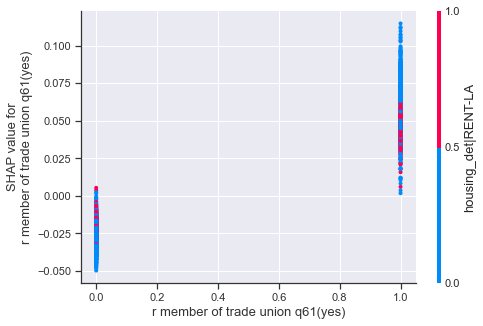

<Figure size 1152x720 with 0 Axes>

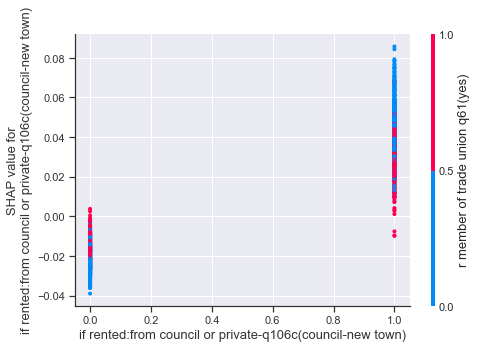

<Figure size 1152x720 with 0 Axes>

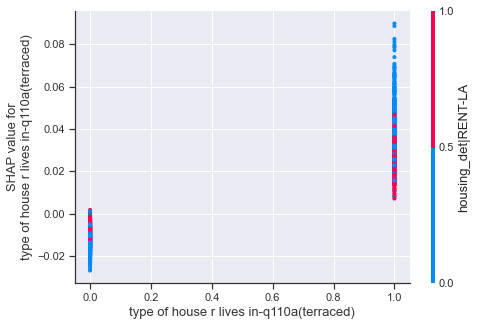

<Figure size 1152x720 with 0 Axes>

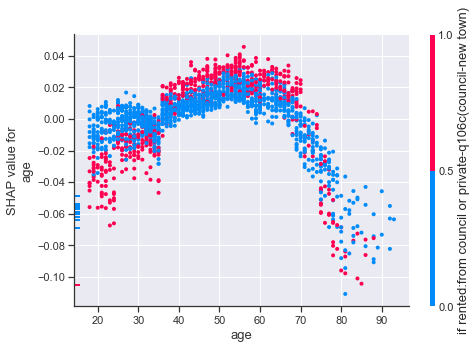

<Figure size 1152x720 with 0 Axes>

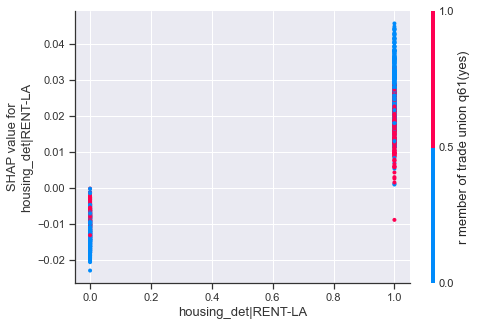

<Figure size 1152x720 with 0 Axes>

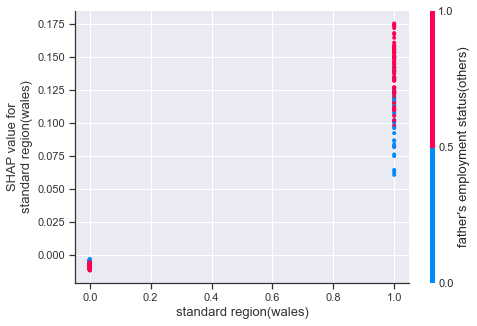

<Figure size 1152x720 with 0 Axes>

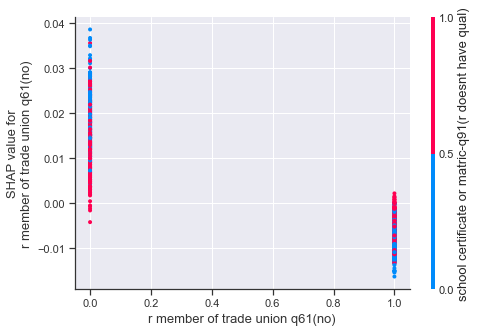

<Figure size 1152x720 with 0 Axes>

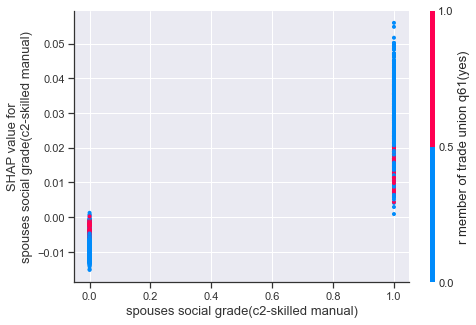

<Figure size 1152x720 with 0 Axes>

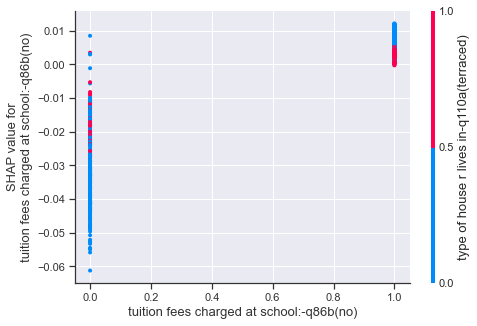

<Figure size 1152x720 with 0 Axes>

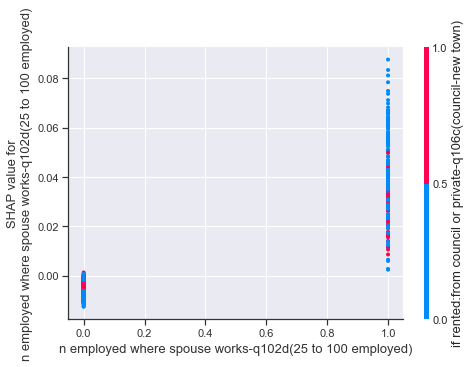

1974_feb
MSE: 0.22, MAE: 0.43, EV: 0.13, R2: 0.13


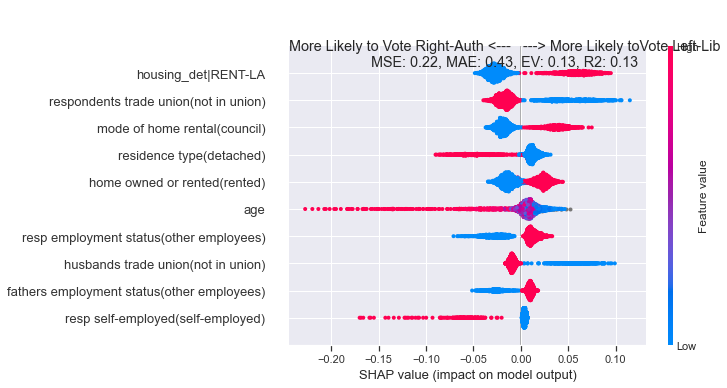

<Figure size 1152x720 with 0 Axes>

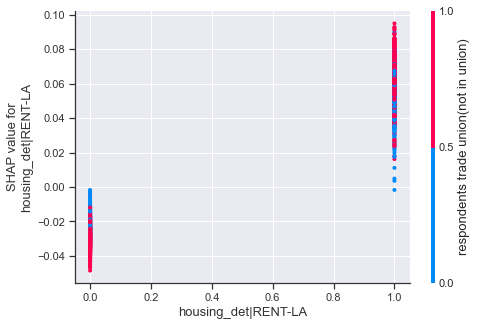

<Figure size 1152x720 with 0 Axes>

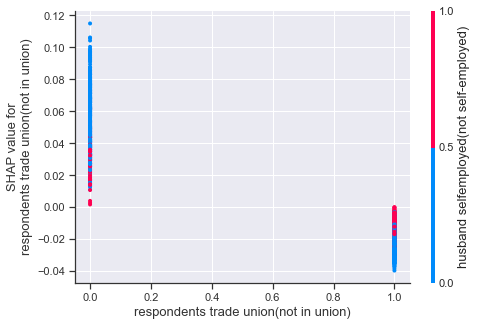

<Figure size 1152x720 with 0 Axes>

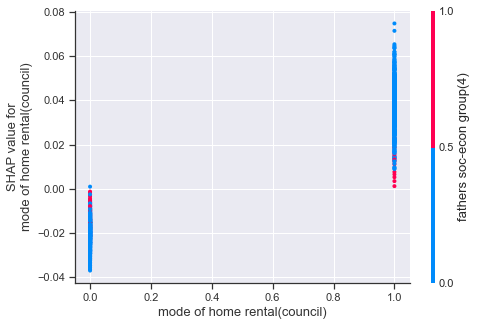

<Figure size 1152x720 with 0 Axes>

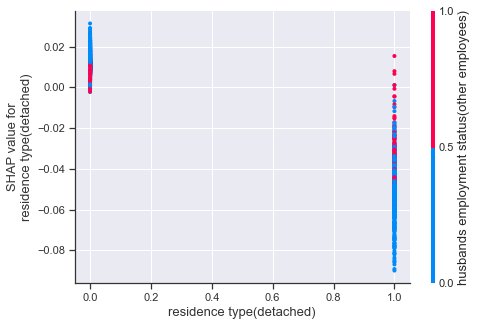

<Figure size 1152x720 with 0 Axes>

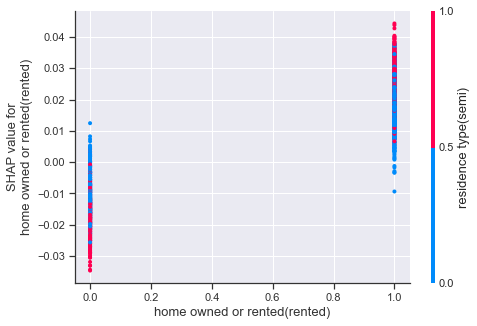

<Figure size 1152x720 with 0 Axes>

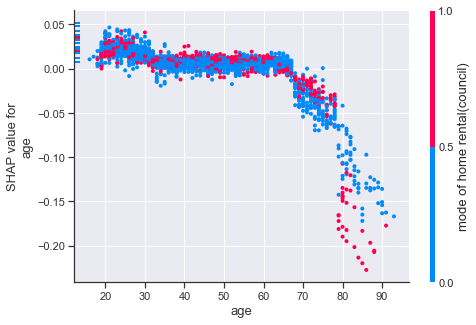

<Figure size 1152x720 with 0 Axes>

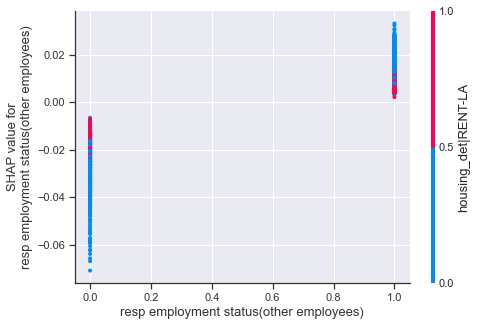

<Figure size 1152x720 with 0 Axes>

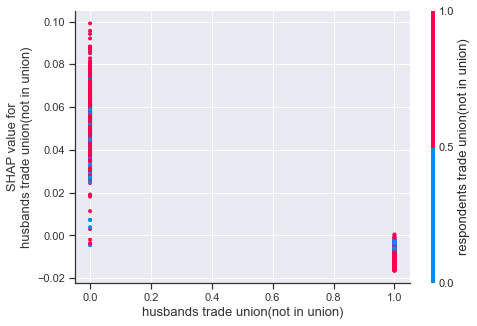

<Figure size 1152x720 with 0 Axes>

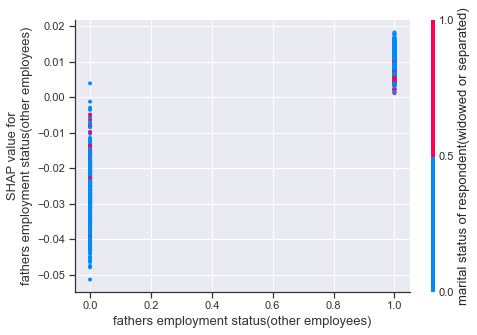

<Figure size 1152x720 with 0 Axes>

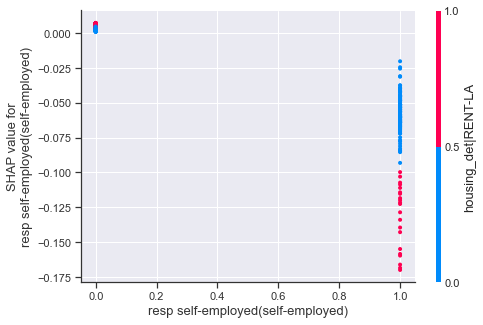

1974_oct
MSE: 0.21, MAE: 0.44, EV: 0.14, R2: 0.14


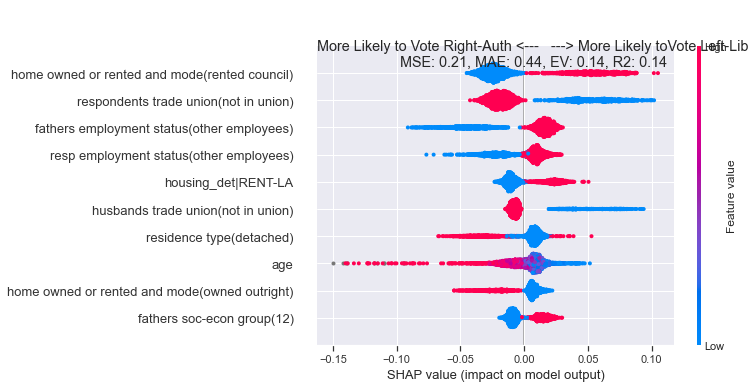

<Figure size 1152x720 with 0 Axes>

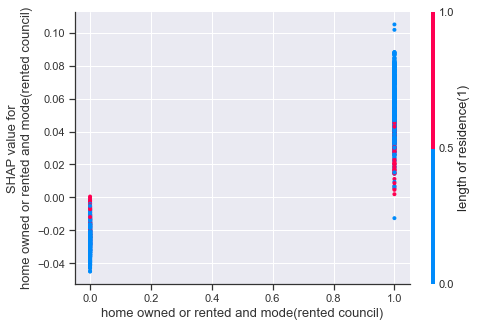

<Figure size 1152x720 with 0 Axes>

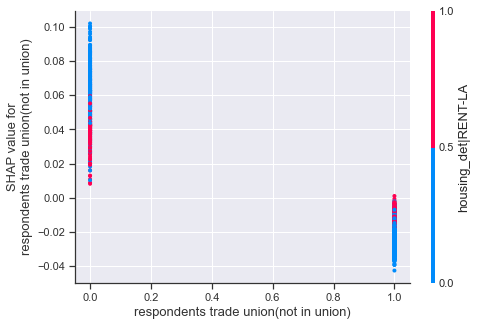

<Figure size 1152x720 with 0 Axes>

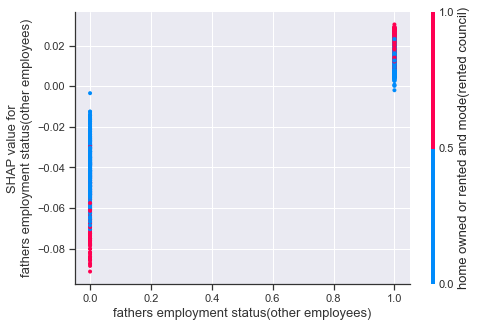

<Figure size 1152x720 with 0 Axes>

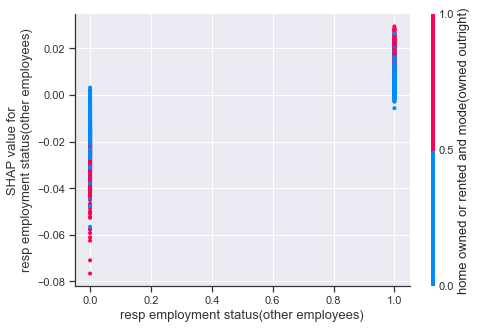

<Figure size 1152x720 with 0 Axes>

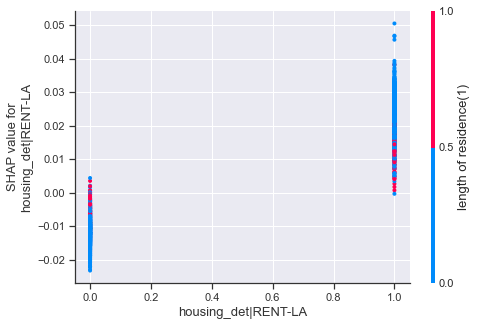

<Figure size 1152x720 with 0 Axes>

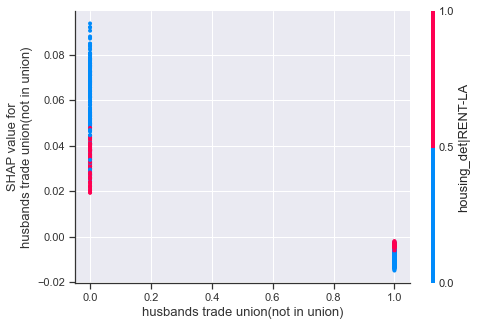

<Figure size 1152x720 with 0 Axes>

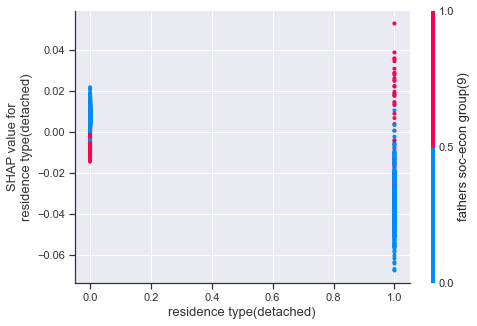

<Figure size 1152x720 with 0 Axes>

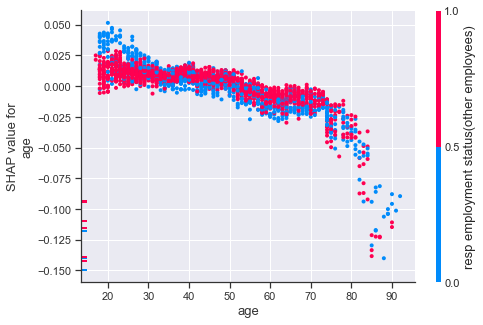

<Figure size 1152x720 with 0 Axes>

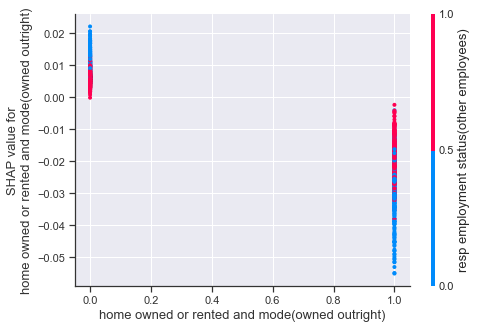

<Figure size 1152x720 with 0 Axes>

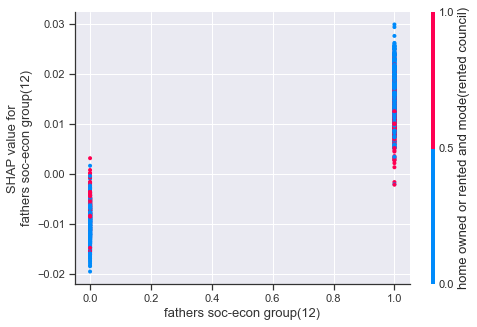

1970
MSE: 0.23, MAE: 0.46, EV: 0.08, R2: 0.08


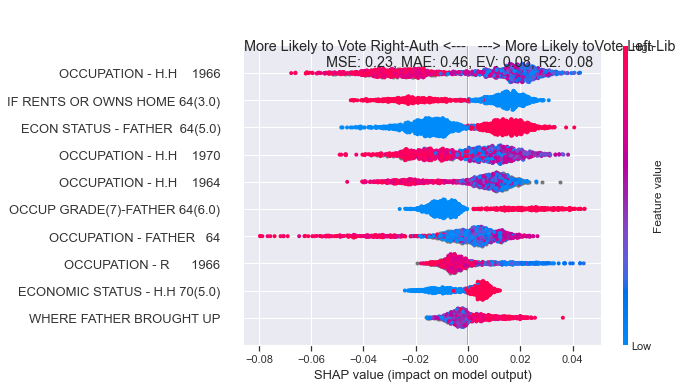

<Figure size 1152x720 with 0 Axes>

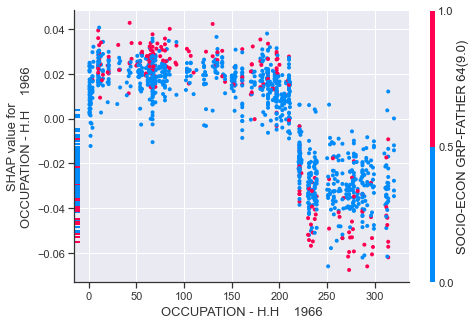

<Figure size 1152x720 with 0 Axes>

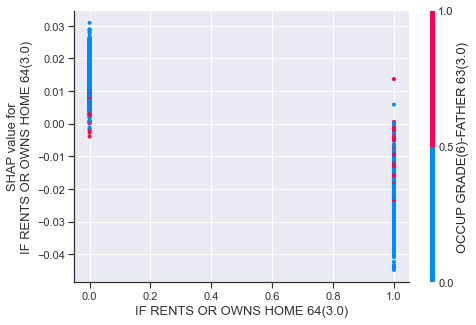

<Figure size 1152x720 with 0 Axes>

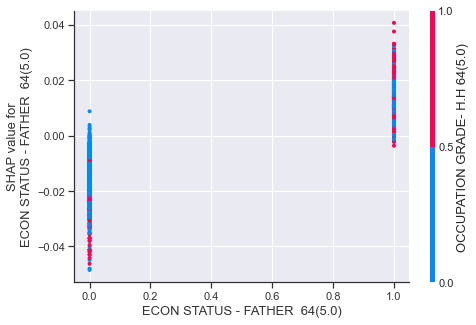

<Figure size 1152x720 with 0 Axes>

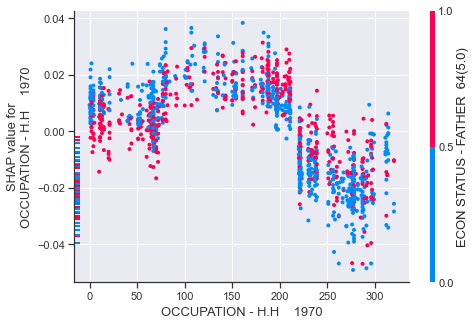

<Figure size 1152x720 with 0 Axes>

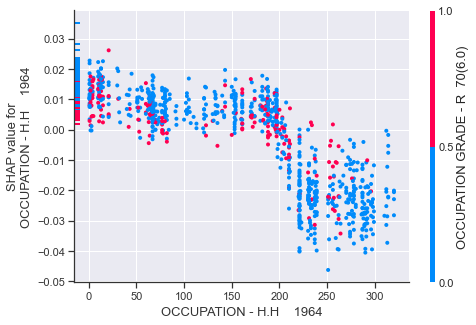

<Figure size 1152x720 with 0 Axes>

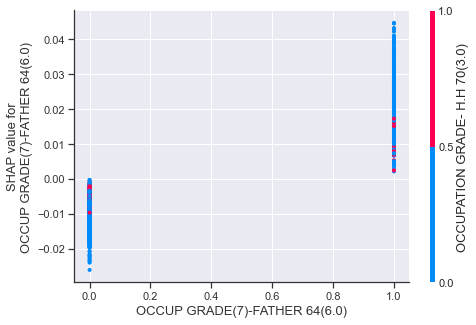

<Figure size 1152x720 with 0 Axes>

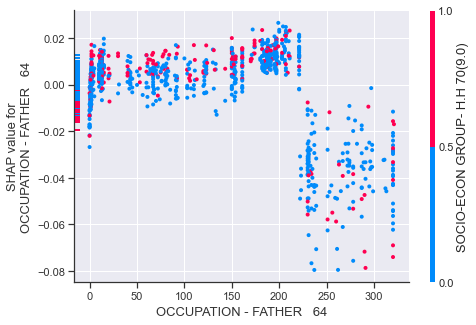

<Figure size 1152x720 with 0 Axes>

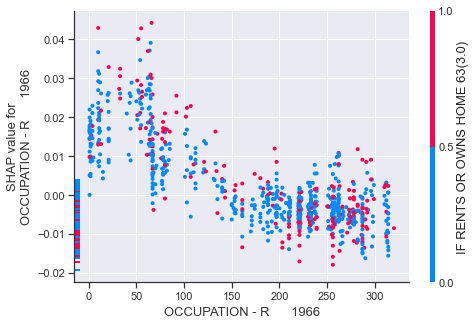

<Figure size 1152x720 with 0 Axes>

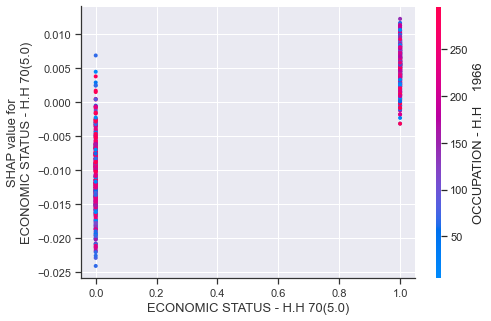

<Figure size 1152x720 with 0 Axes>

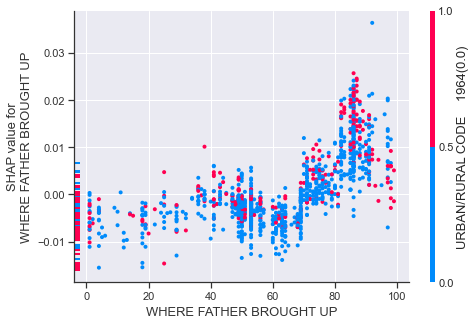

1966
MSE: 0.22, MAE: 0.44, EV: 0.12, R2: 0.12


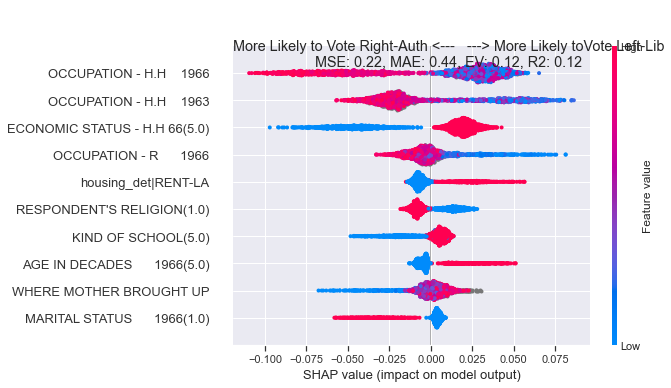

<Figure size 1152x720 with 0 Axes>

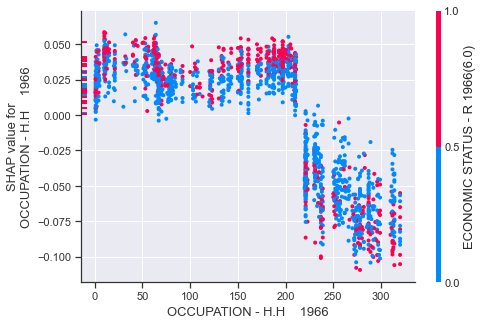

<Figure size 1152x720 with 0 Axes>

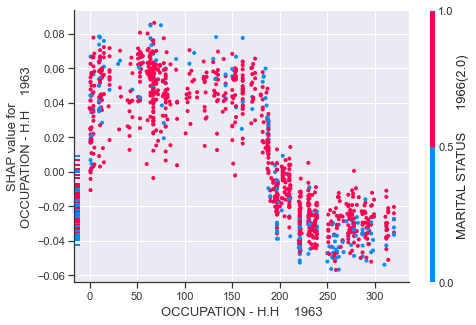

<Figure size 1152x720 with 0 Axes>

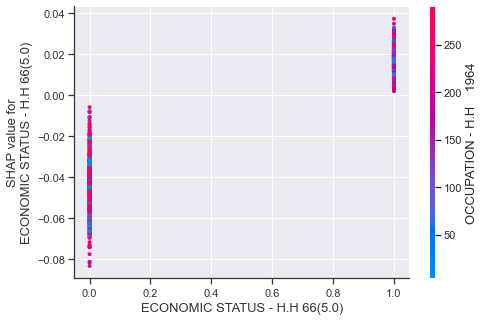

<Figure size 1152x720 with 0 Axes>

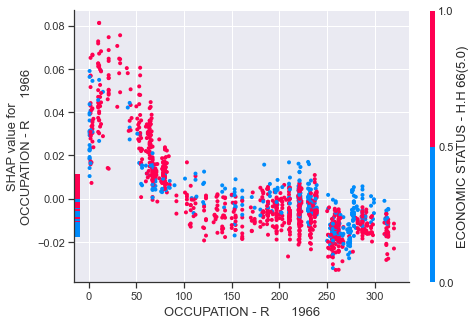

<Figure size 1152x720 with 0 Axes>

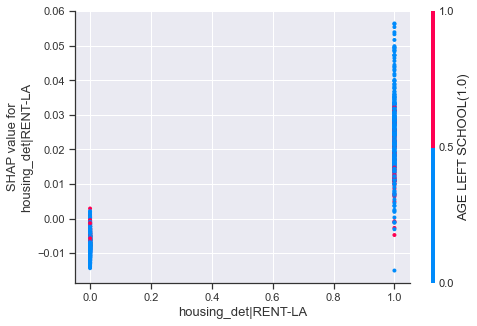

<Figure size 1152x720 with 0 Axes>

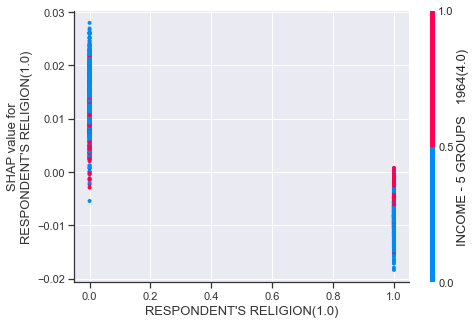

<Figure size 1152x720 with 0 Axes>

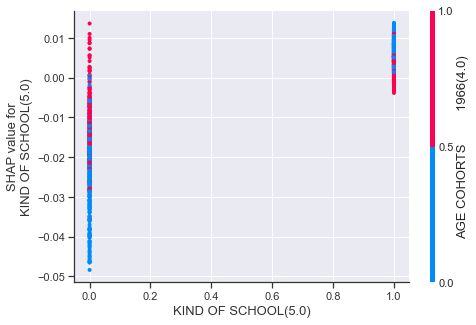

<Figure size 1152x720 with 0 Axes>

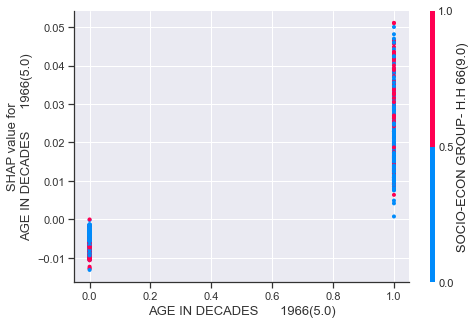

<Figure size 1152x720 with 0 Axes>

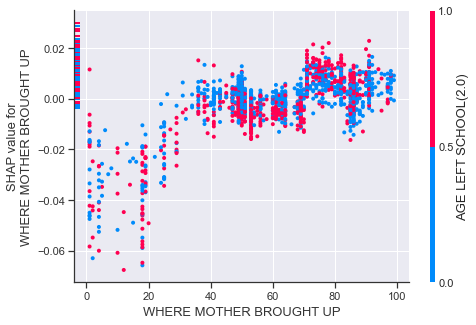

<Figure size 1152x720 with 0 Axes>

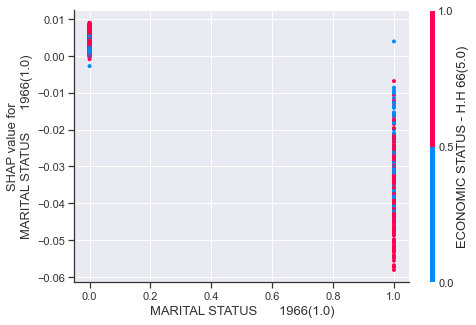

1964
MSE: 0.22, MAE: 0.43, EV: 0.14, R2: 0.14


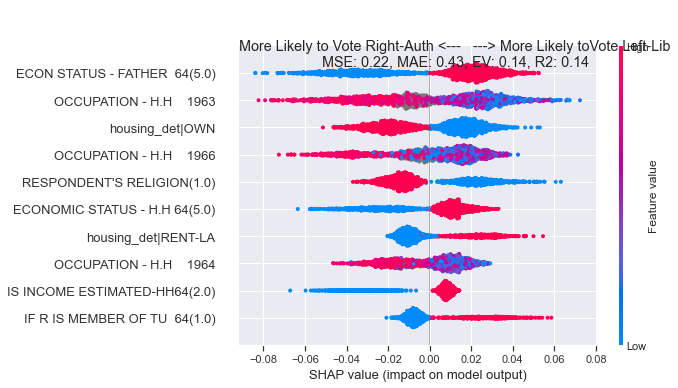

<Figure size 1152x720 with 0 Axes>

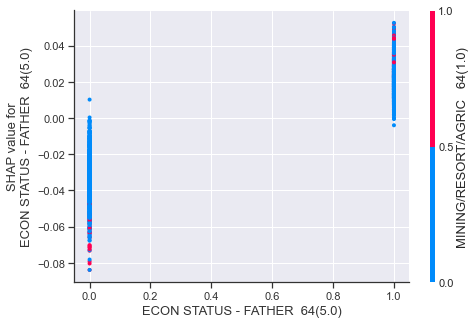

<Figure size 1152x720 with 0 Axes>

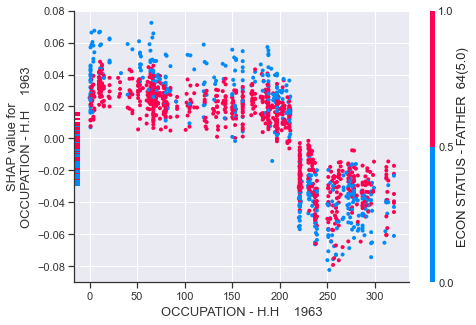

<Figure size 1152x720 with 0 Axes>

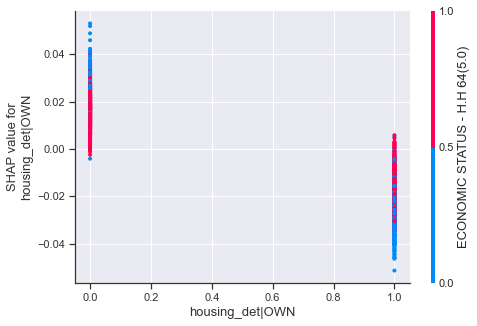

<Figure size 1152x720 with 0 Axes>

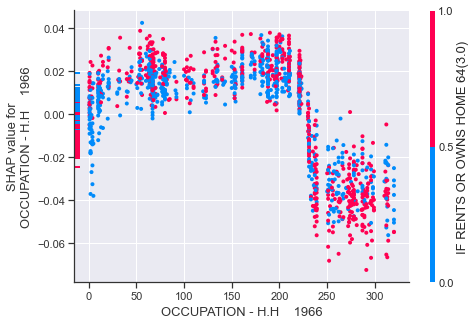

<Figure size 1152x720 with 0 Axes>

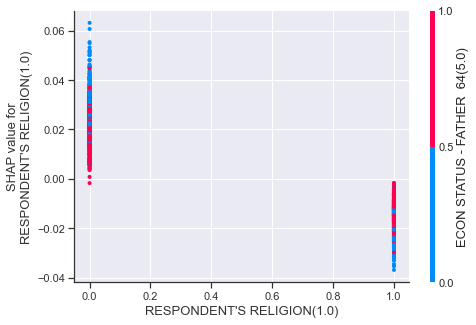

<Figure size 1152x720 with 0 Axes>

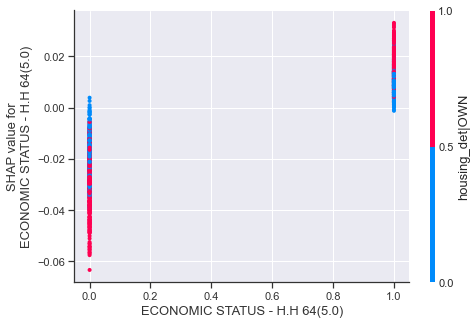

<Figure size 1152x720 with 0 Axes>

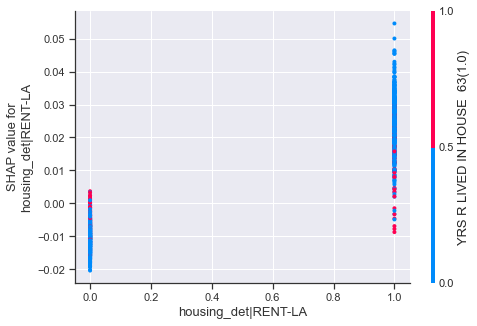

<Figure size 1152x720 with 0 Axes>

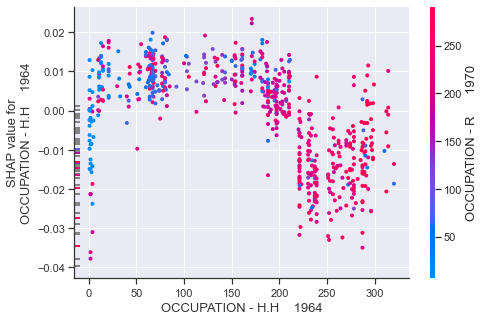

<Figure size 1152x720 with 0 Axes>

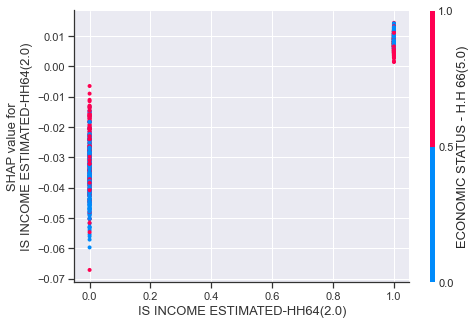

<Figure size 1152x720 with 0 Axes>

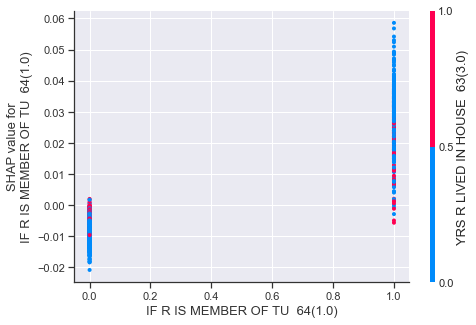

Wall time: 19min 54s


In [217]:
%%time
for ge in BES_df_list.keys():
    print(ge)
    harm_vars = ["bloc","wt","age","housing_det","inc"]
    target_var = "bloc"
    target_var_replace_dict = {"Neither":np.nan}
    target_var_drop_list = ["bloc|Right-Auth"]
    target_var_title_pair = ["Vote Right-Auth","Vote Left-Lib"]
    var_stub = "bloc|Left-Lib"
    min_features = 10

    prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
           var_stub,harm_vars,min_features,dependence_plots=True)

2019
MSE: 0.20, MAE: 0.40, EV: 0.15, R2: 0.15


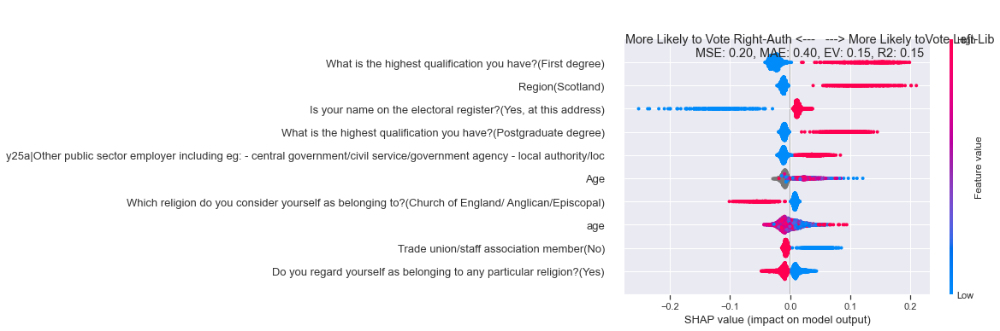

<Figure size 1152x720 with 0 Axes>

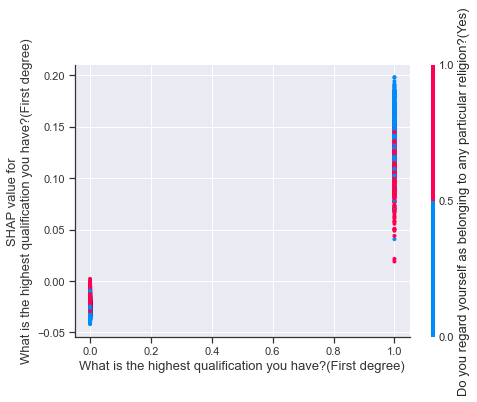

<Figure size 1152x720 with 0 Axes>

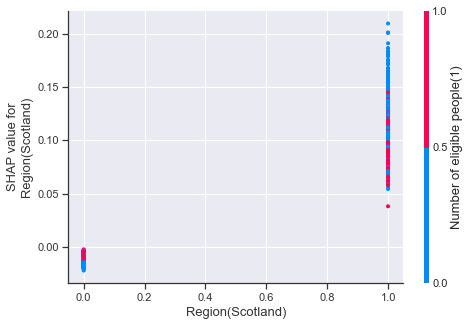

<Figure size 1152x720 with 0 Axes>

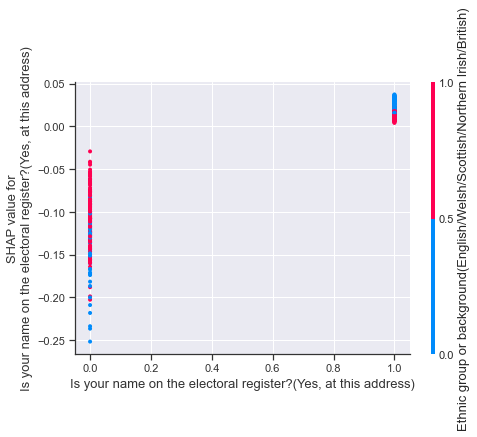

<Figure size 1152x720 with 0 Axes>

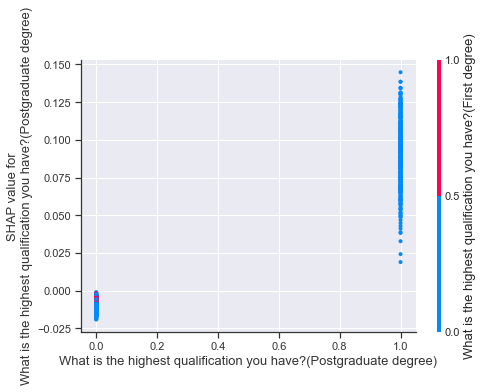

<Figure size 1152x720 with 0 Axes>

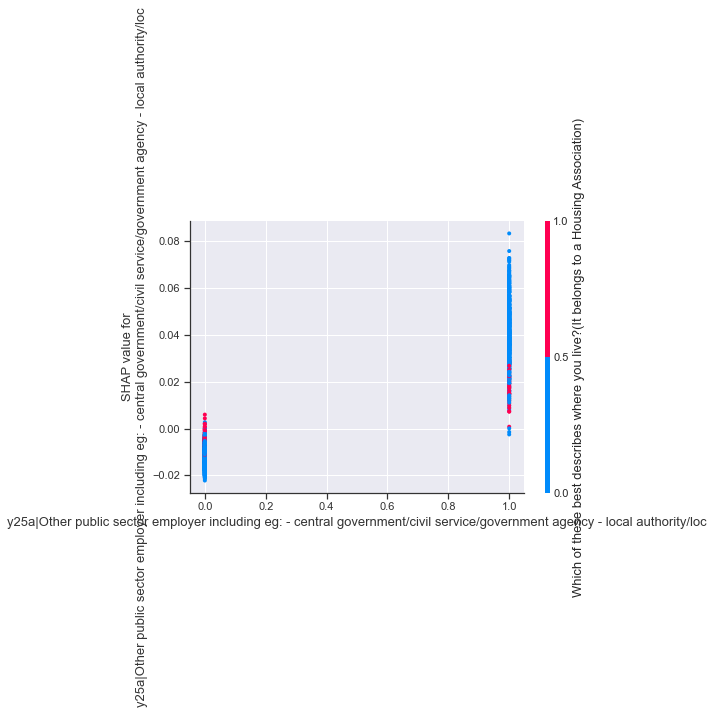

<Figure size 1152x720 with 0 Axes>

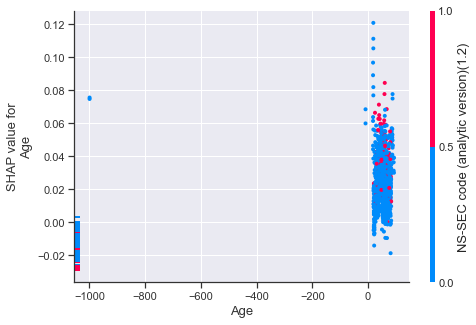

<Figure size 1152x720 with 0 Axes>

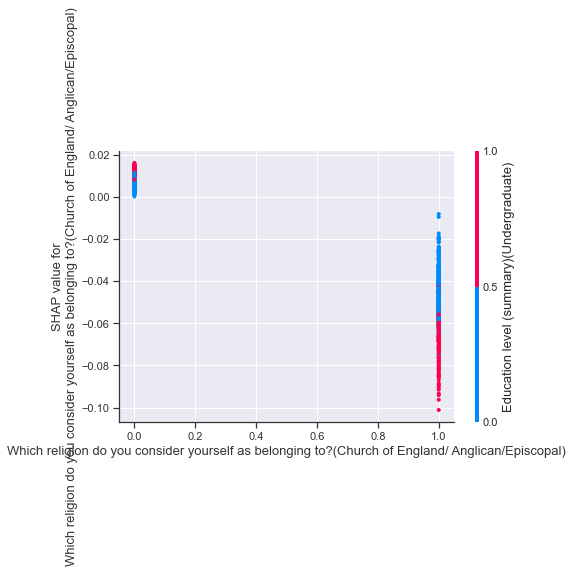

<Figure size 1152x720 with 0 Axes>

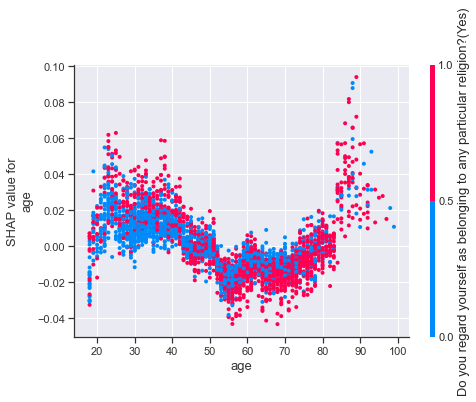

<Figure size 1152x720 with 0 Axes>

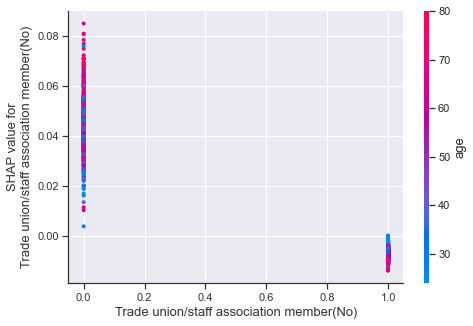

<Figure size 1152x720 with 0 Axes>

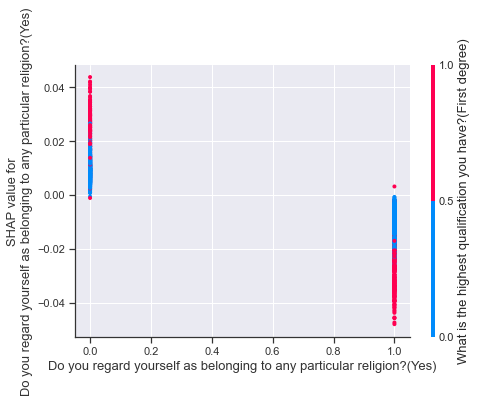

2017
MSE: 0.22, MAE: 0.44, EV: 0.11, R2: 0.10


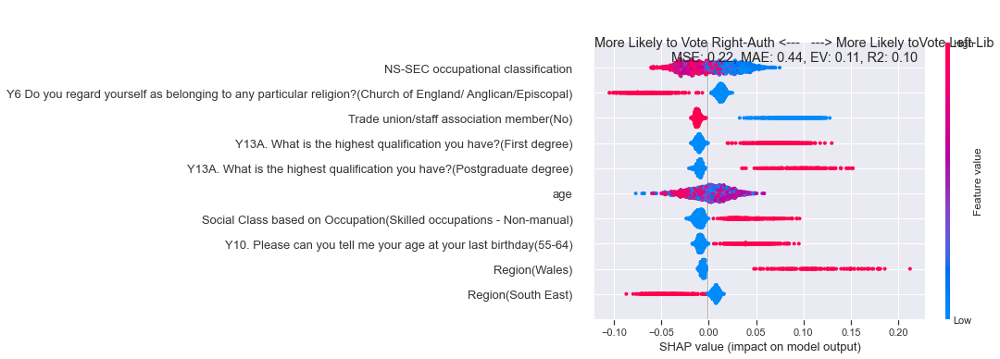

<Figure size 1152x720 with 0 Axes>

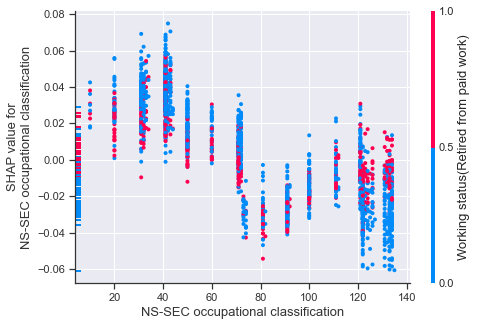

<Figure size 1152x720 with 0 Axes>

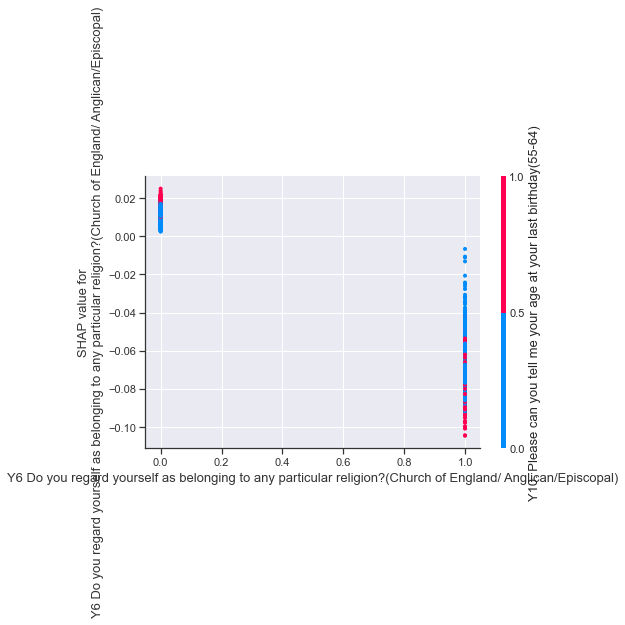

<Figure size 1152x720 with 0 Axes>

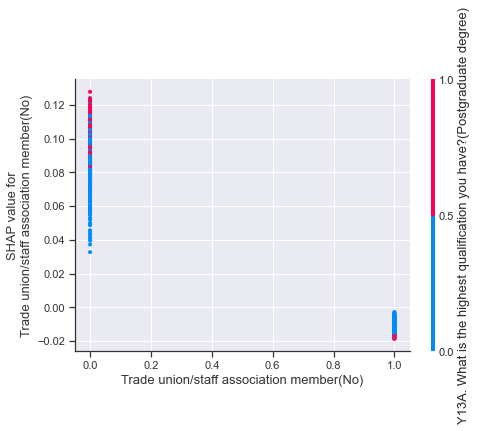

<Figure size 1152x720 with 0 Axes>

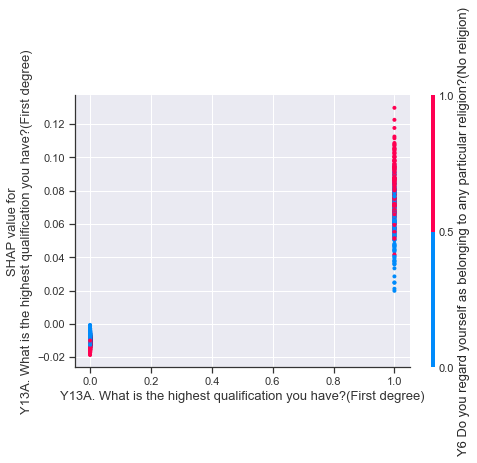

<Figure size 1152x720 with 0 Axes>

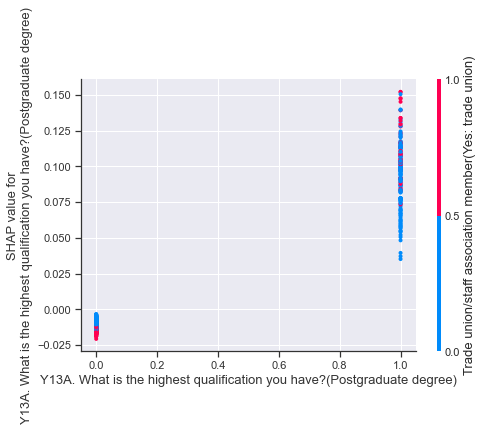

<Figure size 1152x720 with 0 Axes>

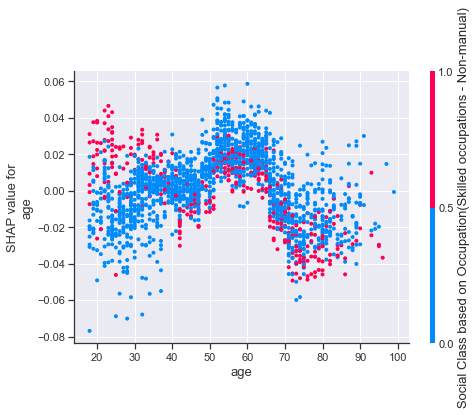

<Figure size 1152x720 with 0 Axes>

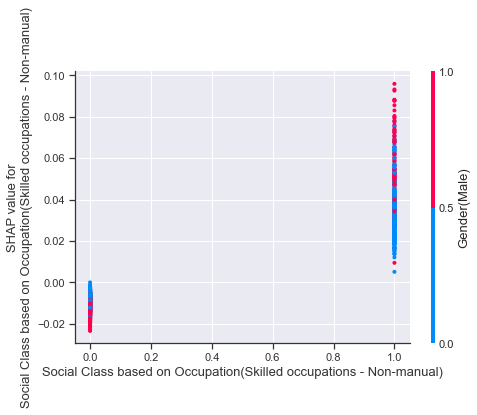

<Figure size 1152x720 with 0 Axes>

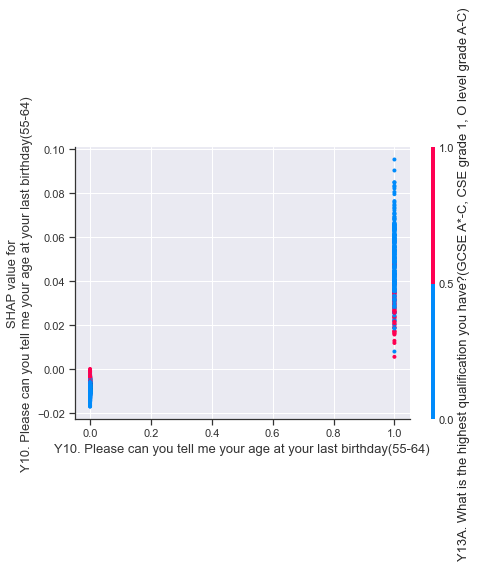

<Figure size 1152x720 with 0 Axes>

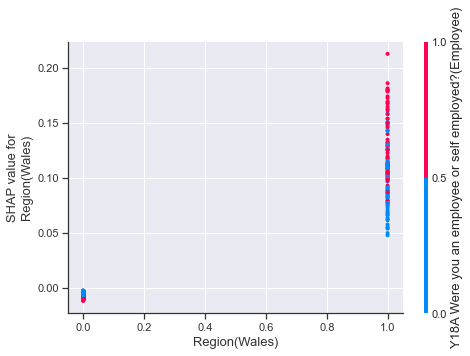

<Figure size 1152x720 with 0 Axes>

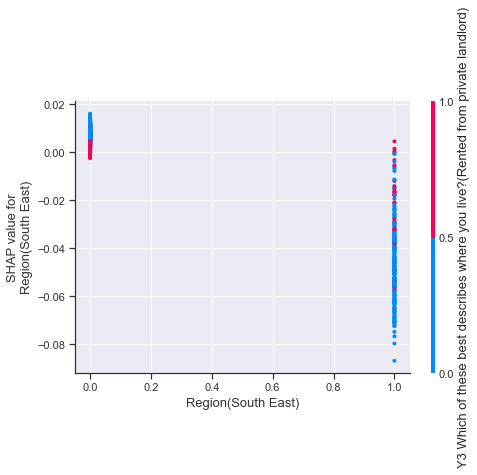

2015
MSE: 0.21, MAE: 0.42, EV: 0.09, R2: 0.08


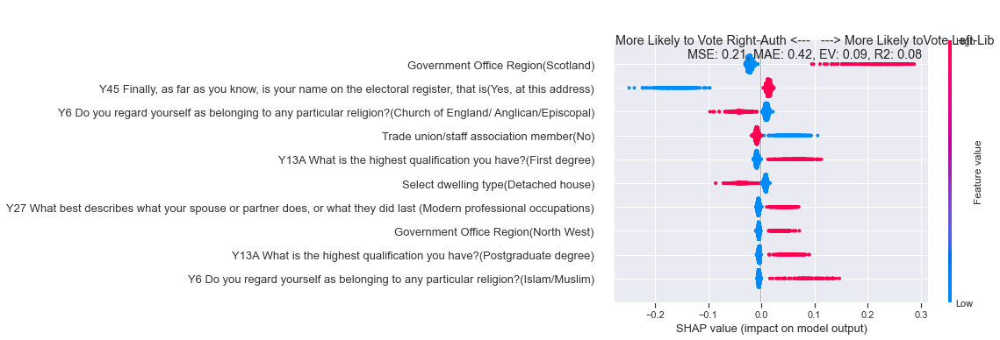

<Figure size 1152x720 with 0 Axes>

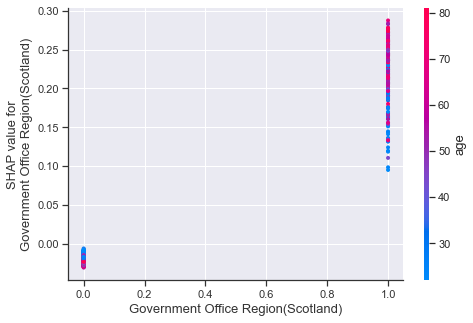

<Figure size 1152x720 with 0 Axes>

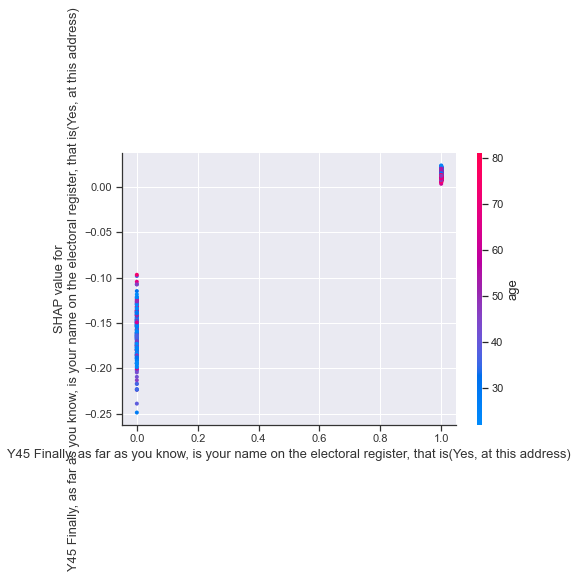

<Figure size 1152x720 with 0 Axes>

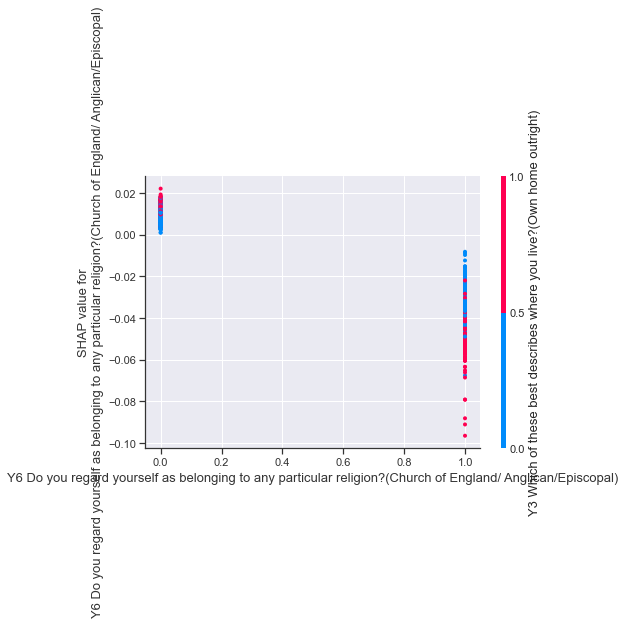

<Figure size 1152x720 with 0 Axes>

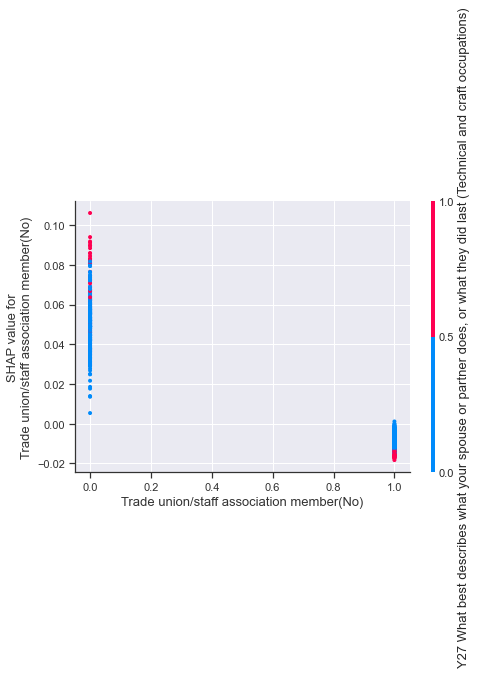

<Figure size 1152x720 with 0 Axes>

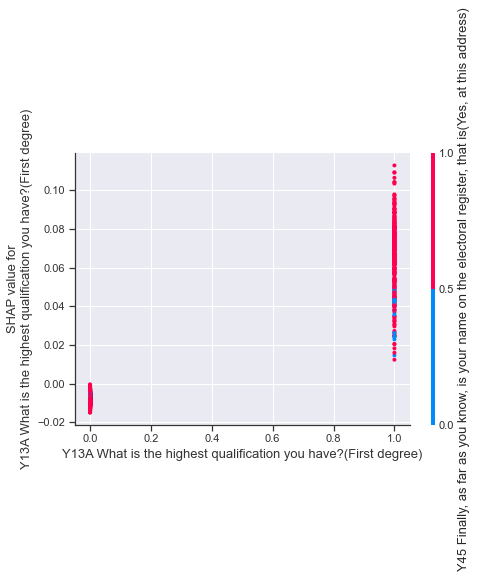

<Figure size 1152x720 with 0 Axes>

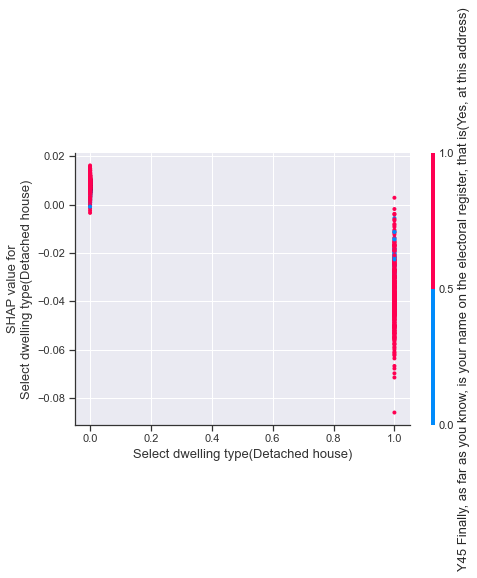

<Figure size 1152x720 with 0 Axes>

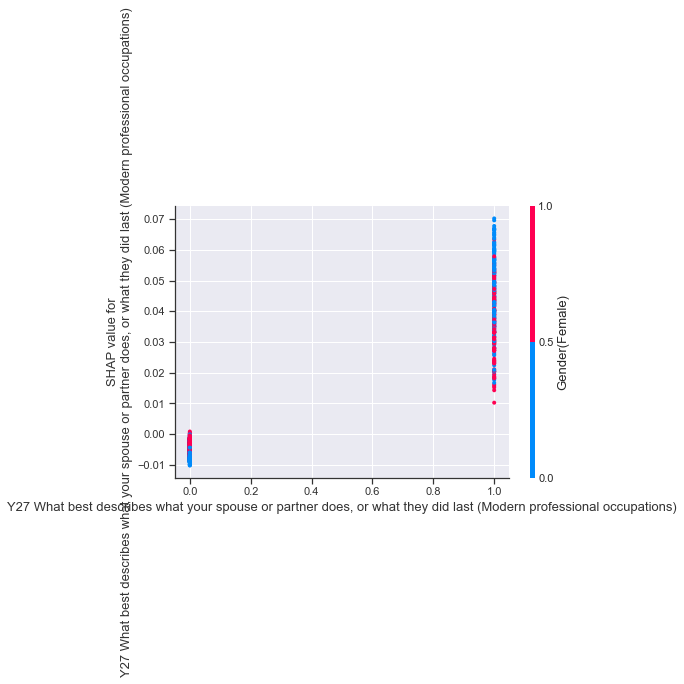

<Figure size 1152x720 with 0 Axes>

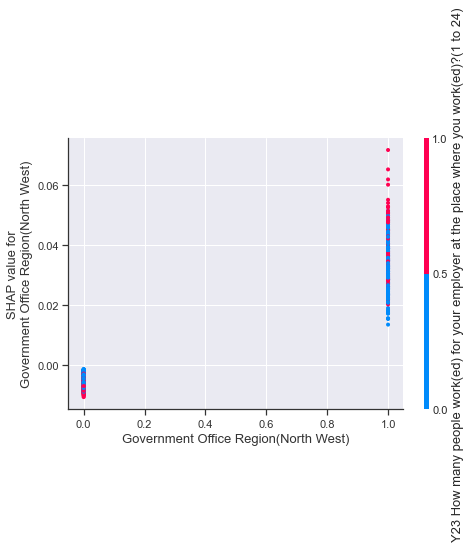

<Figure size 1152x720 with 0 Axes>

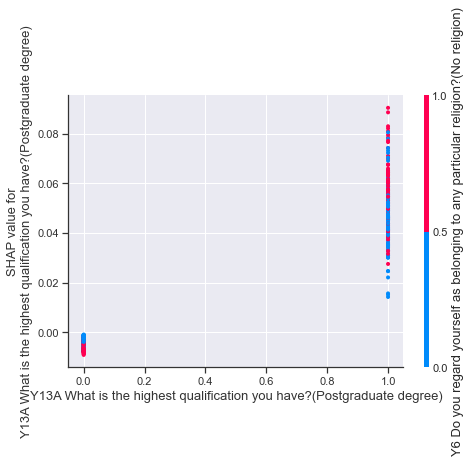

<Figure size 1152x720 with 0 Axes>

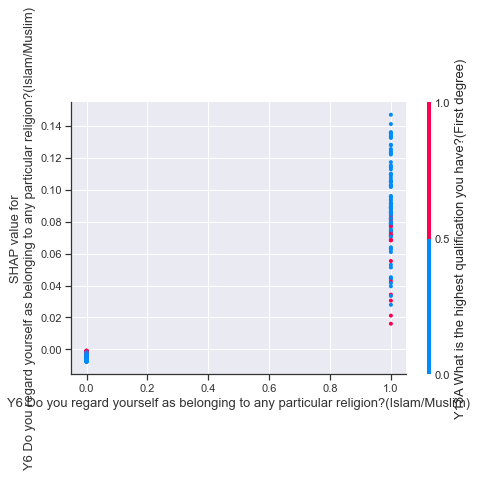

2010
MSE: 0.23, MAE: 0.45, EV: 0.08, R2: 0.08


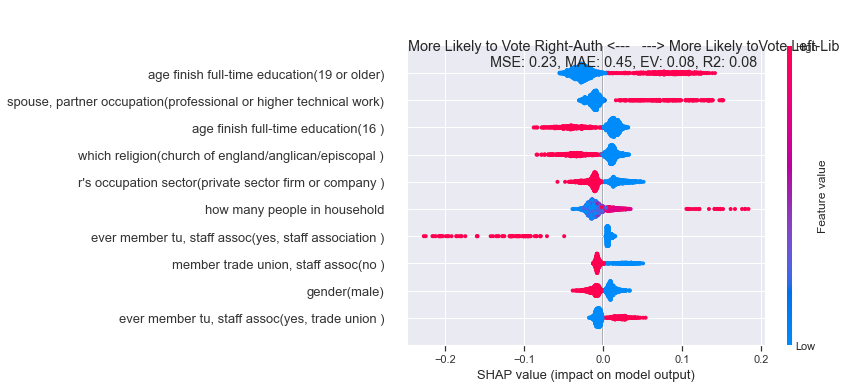

<Figure size 1152x720 with 0 Axes>

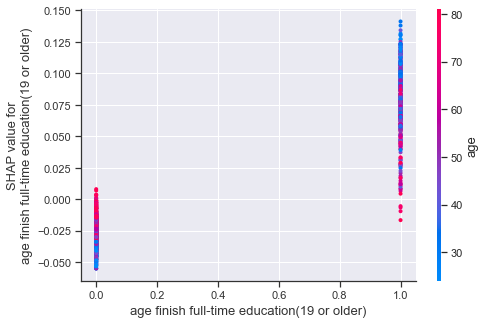

<Figure size 1152x720 with 0 Axes>

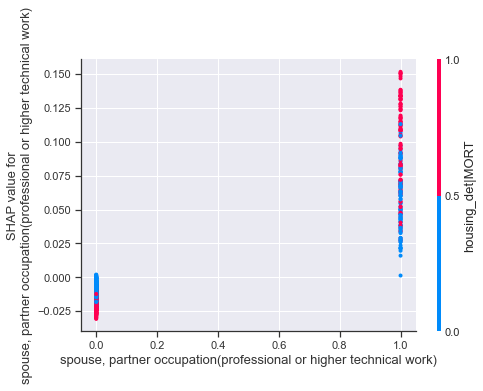

<Figure size 1152x720 with 0 Axes>

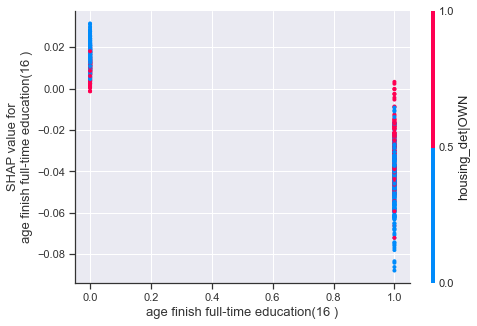

<Figure size 1152x720 with 0 Axes>

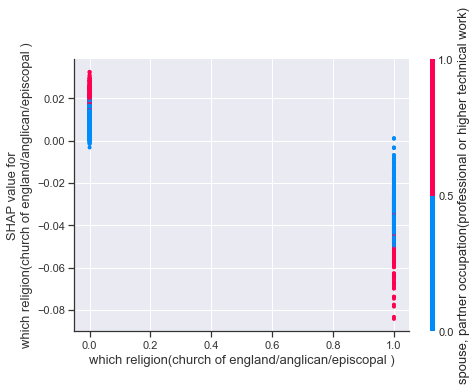

<Figure size 1152x720 with 0 Axes>

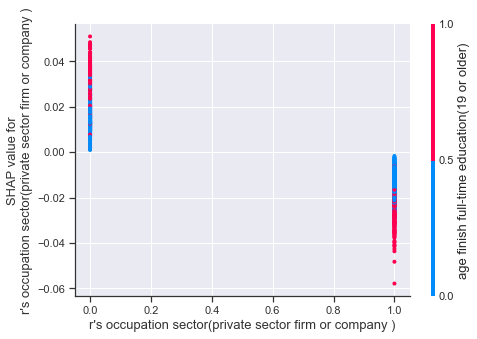

<Figure size 1152x720 with 0 Axes>

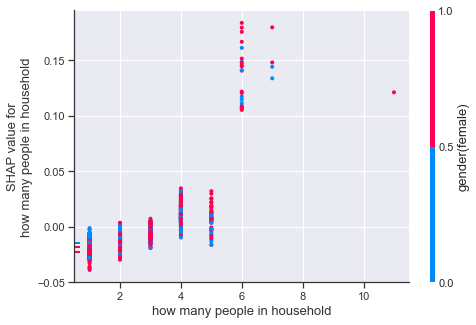

<Figure size 1152x720 with 0 Axes>

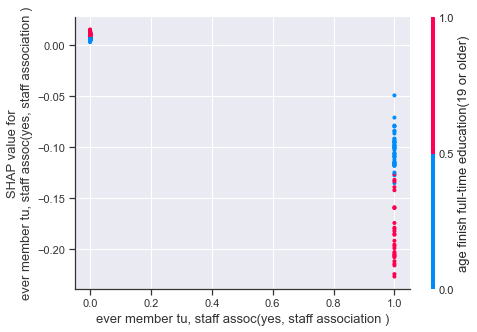

<Figure size 1152x720 with 0 Axes>

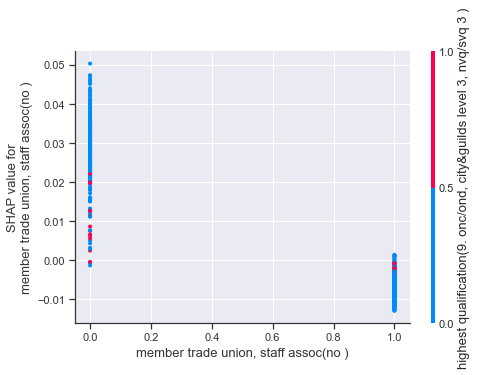

<Figure size 1152x720 with 0 Axes>

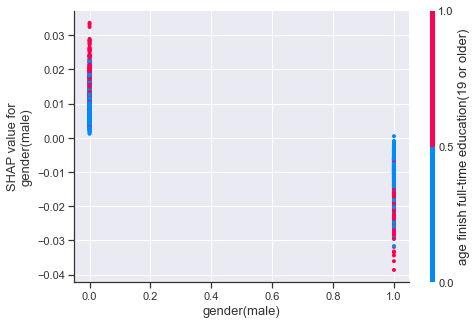

<Figure size 1152x720 with 0 Axes>

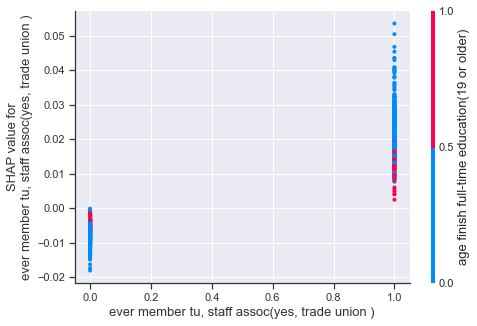

2005
MSE: 0.19, MAE: 0.39, EV: 0.20, R2: 0.20


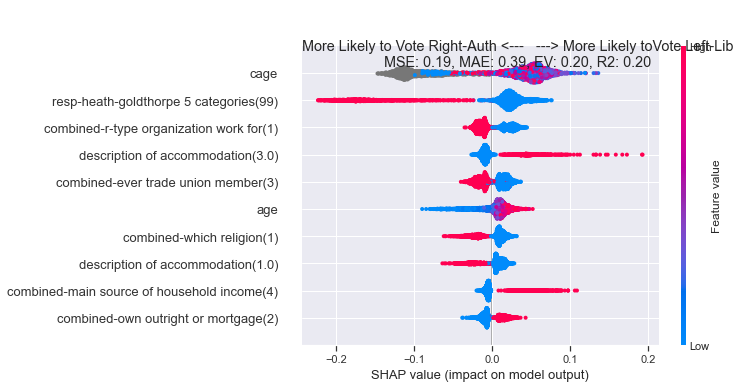

<Figure size 1152x720 with 0 Axes>

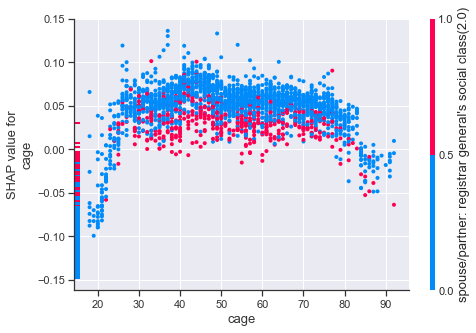

<Figure size 1152x720 with 0 Axes>

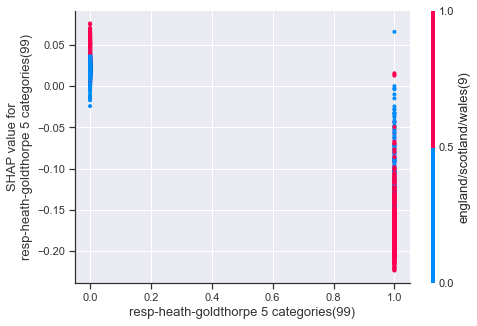

<Figure size 1152x720 with 0 Axes>

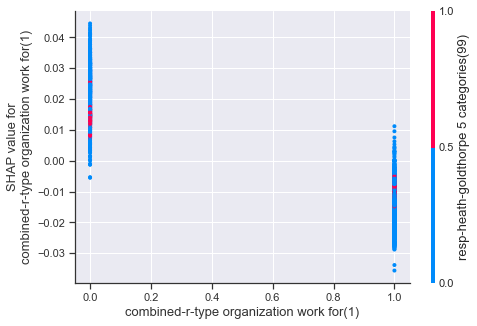

<Figure size 1152x720 with 0 Axes>

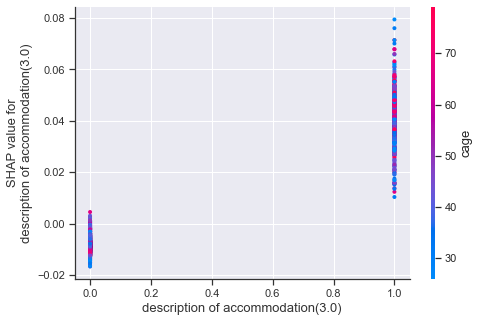

<Figure size 1152x720 with 0 Axes>

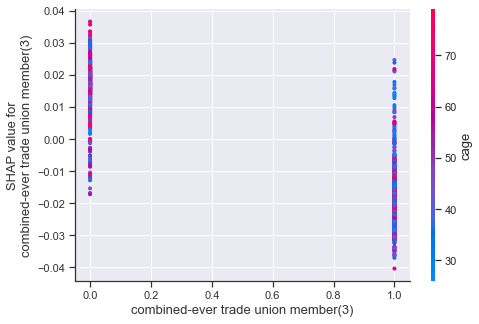

<Figure size 1152x720 with 0 Axes>

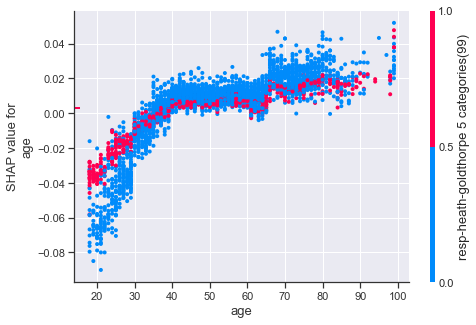

<Figure size 1152x720 with 0 Axes>

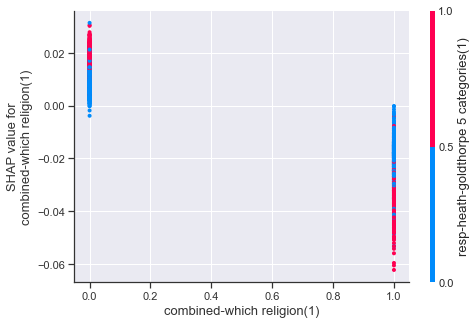

<Figure size 1152x720 with 0 Axes>

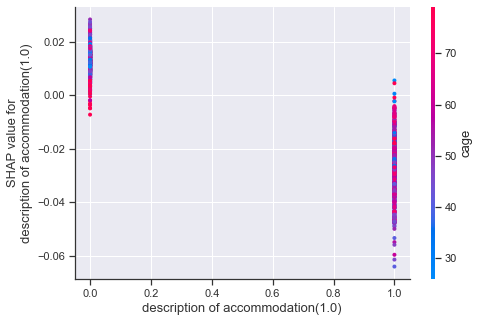

<Figure size 1152x720 with 0 Axes>

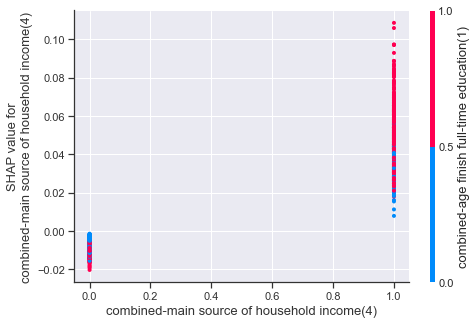

<Figure size 1152x720 with 0 Axes>

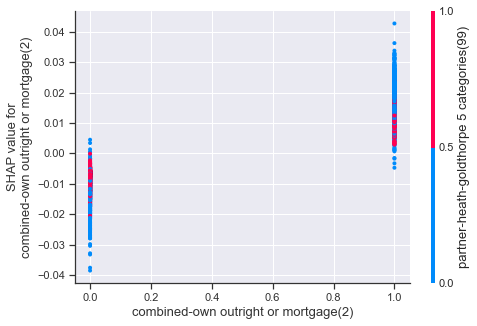

2001
MSE: 0.24, MAE: 0.49, EV: 0.03, R2: 0.03


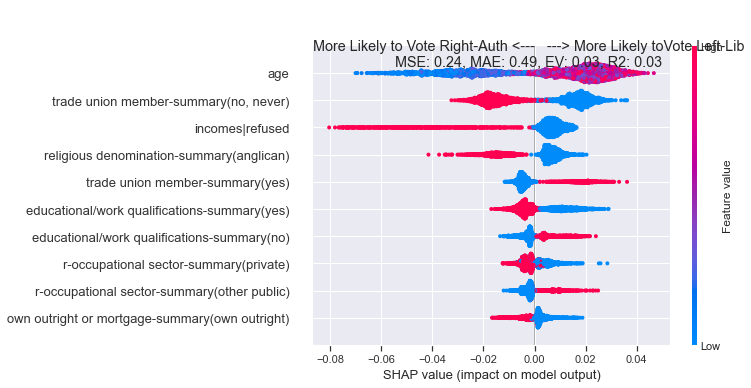

<Figure size 1152x720 with 0 Axes>

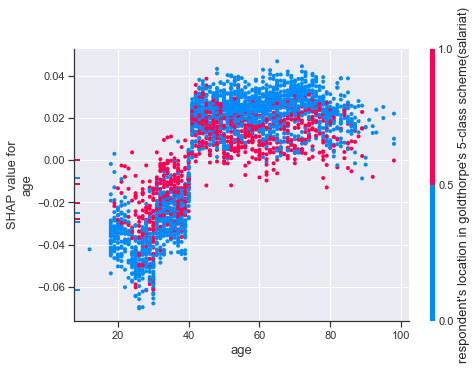

<Figure size 1152x720 with 0 Axes>

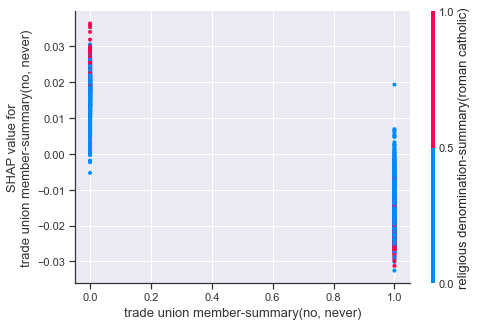

<Figure size 1152x720 with 0 Axes>

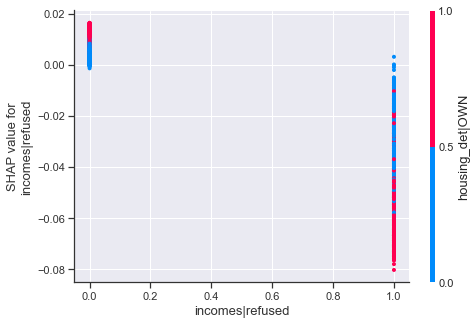

<Figure size 1152x720 with 0 Axes>

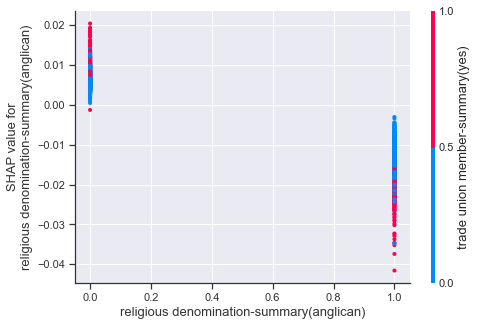

<Figure size 1152x720 with 0 Axes>

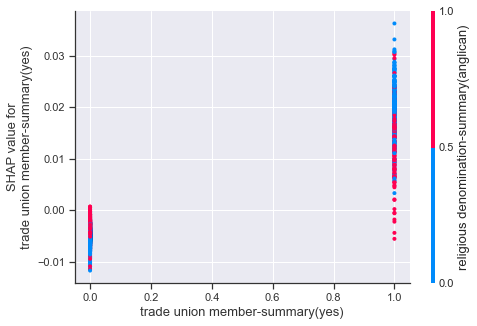

<Figure size 1152x720 with 0 Axes>

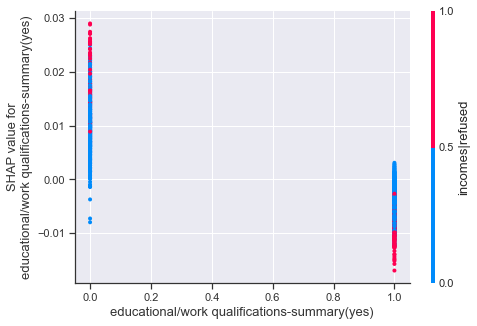

<Figure size 1152x720 with 0 Axes>

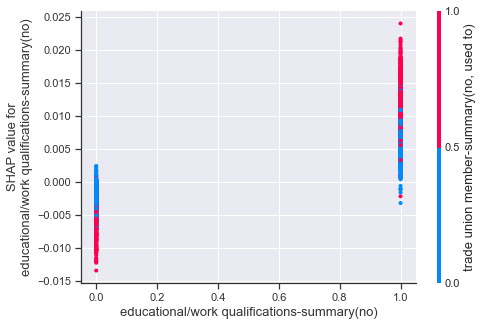

<Figure size 1152x720 with 0 Axes>

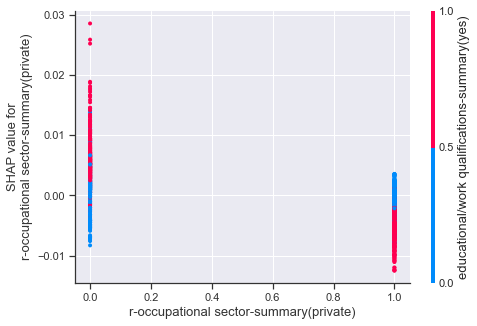

<Figure size 1152x720 with 0 Axes>

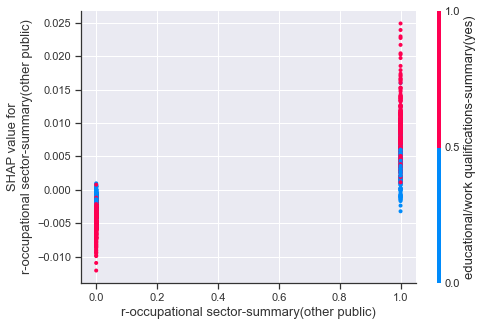

<Figure size 1152x720 with 0 Axes>

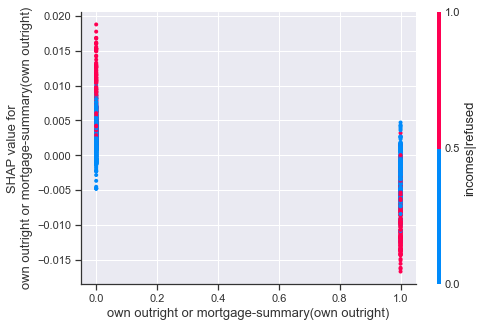

1997
MSE: 0.22, MAE: 0.44, EV: 0.11, R2: 0.11


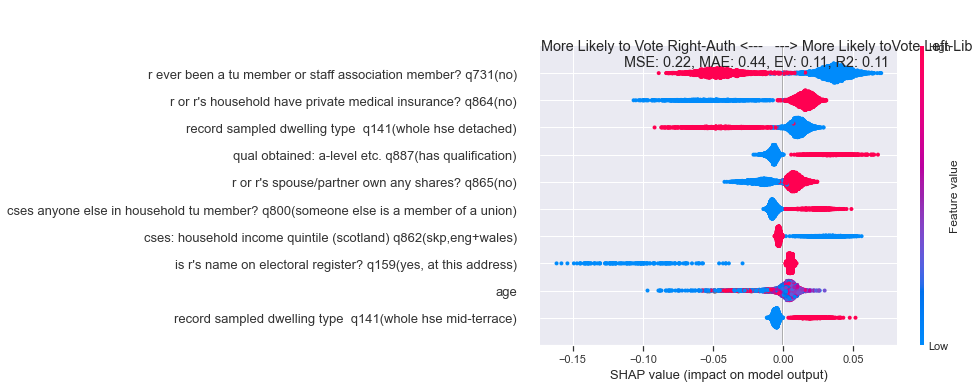

<Figure size 1152x720 with 0 Axes>

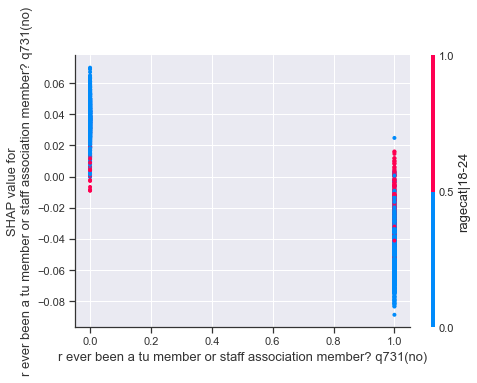

<Figure size 1152x720 with 0 Axes>

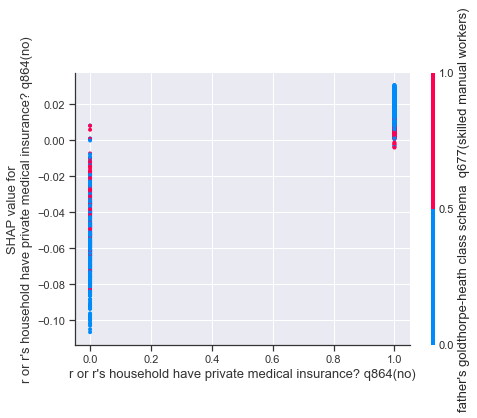

<Figure size 1152x720 with 0 Axes>

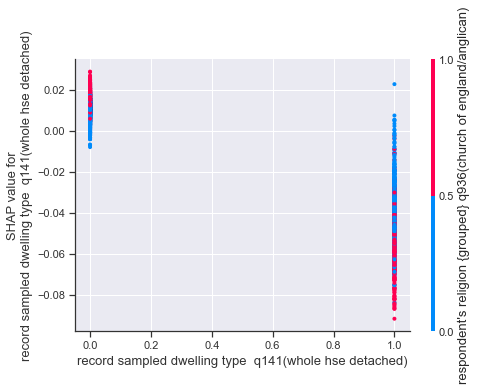

<Figure size 1152x720 with 0 Axes>

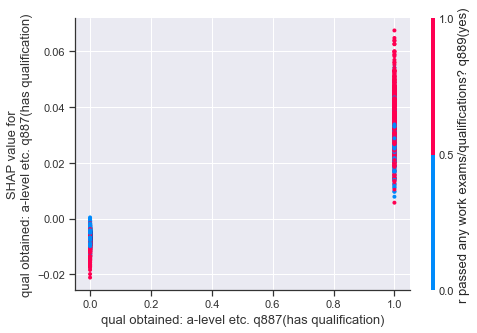

<Figure size 1152x720 with 0 Axes>

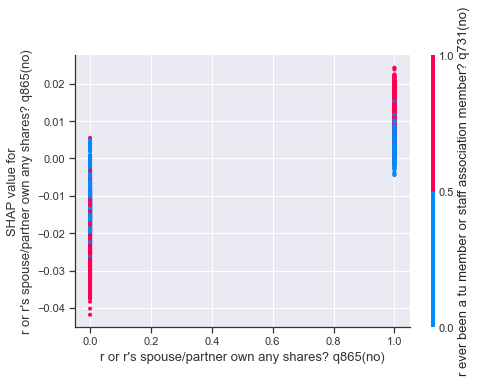

<Figure size 1152x720 with 0 Axes>

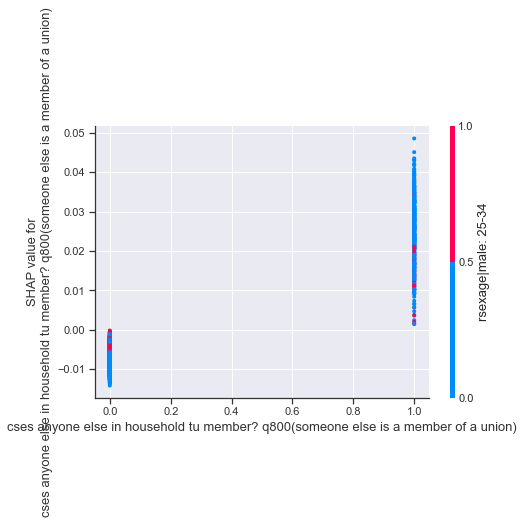

<Figure size 1152x720 with 0 Axes>

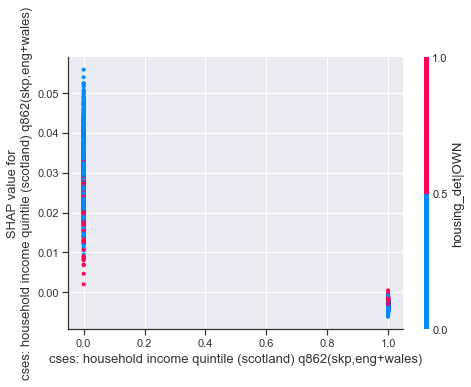

<Figure size 1152x720 with 0 Axes>

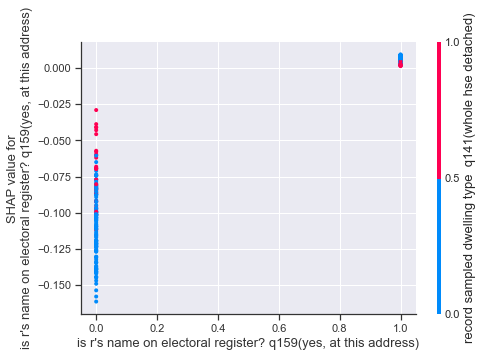

<Figure size 1152x720 with 0 Axes>

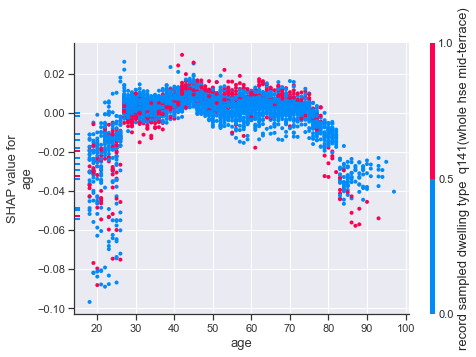

<Figure size 1152x720 with 0 Axes>

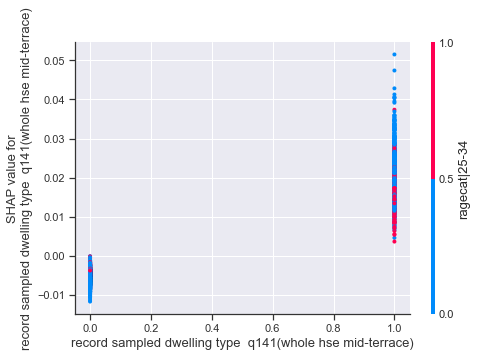

1992
MSE: 0.20, MAE: 0.42, EV: 0.18, R2: 0.18


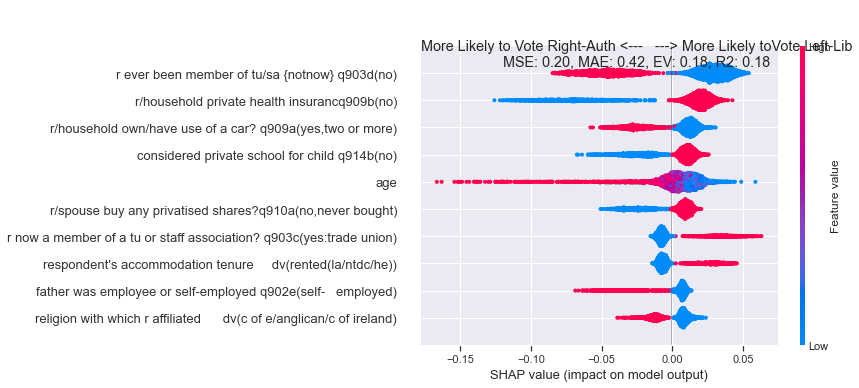

<Figure size 1152x720 with 0 Axes>

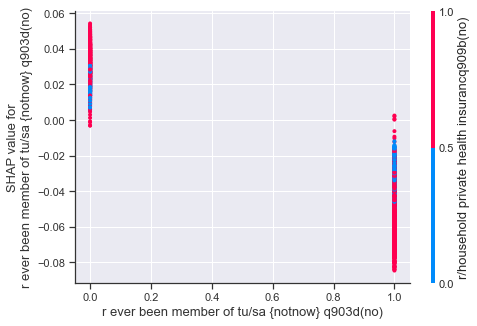

<Figure size 1152x720 with 0 Axes>

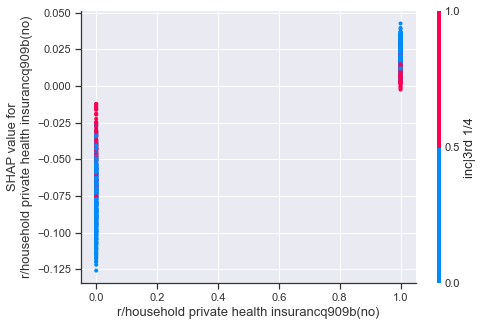

<Figure size 1152x720 with 0 Axes>

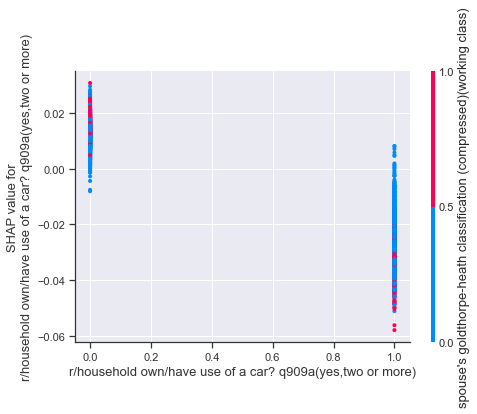

<Figure size 1152x720 with 0 Axes>

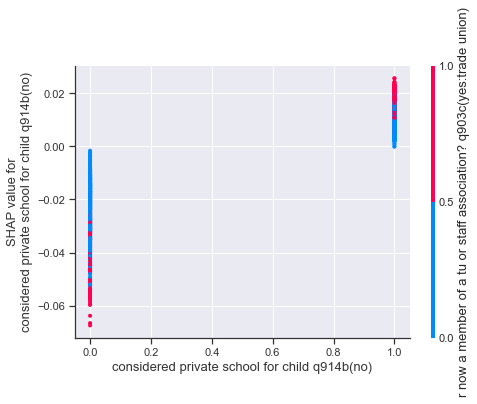

<Figure size 1152x720 with 0 Axes>

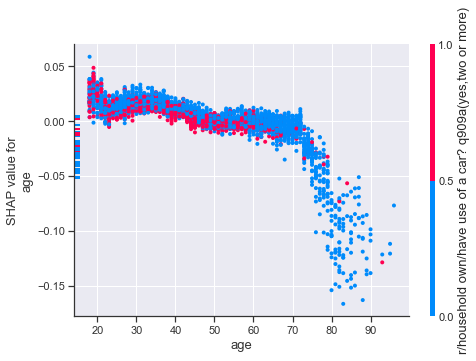

<Figure size 1152x720 with 0 Axes>

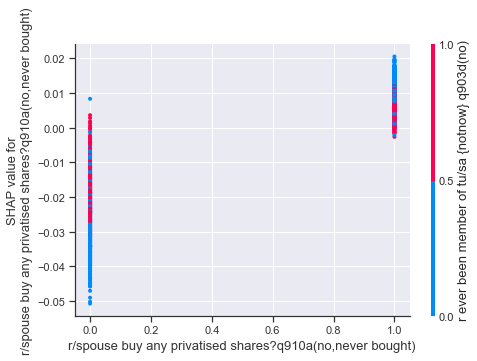

<Figure size 1152x720 with 0 Axes>

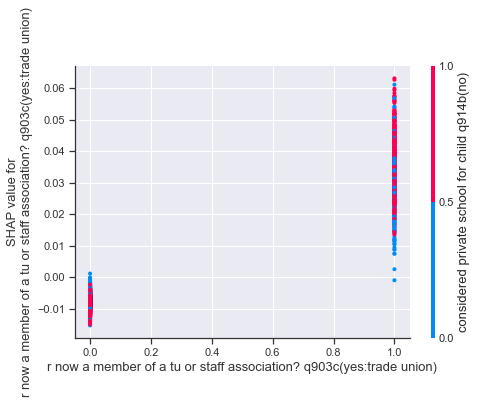

<Figure size 1152x720 with 0 Axes>

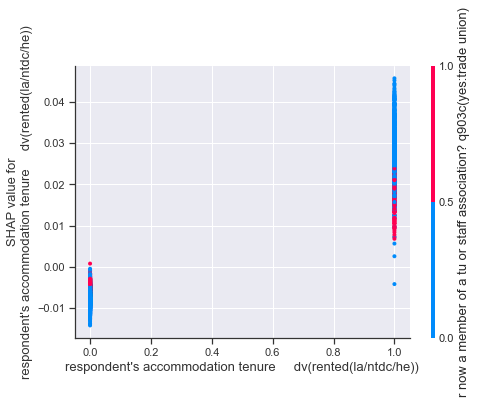

<Figure size 1152x720 with 0 Axes>

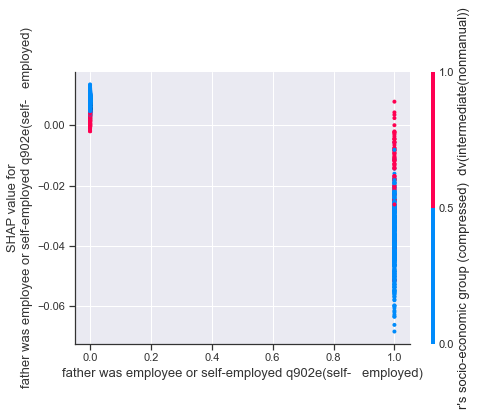

<Figure size 1152x720 with 0 Axes>

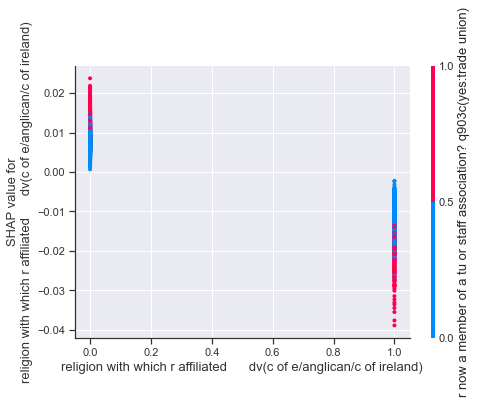

1987
MSE: 0.21, MAE: 0.42, EV: 0.16, R2: 0.16


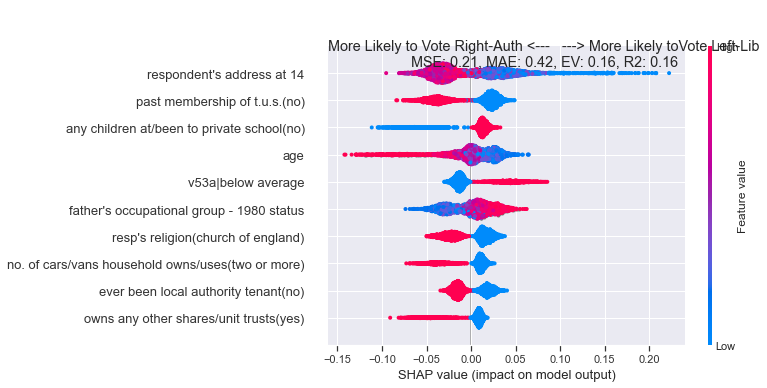

<Figure size 1152x720 with 0 Axes>

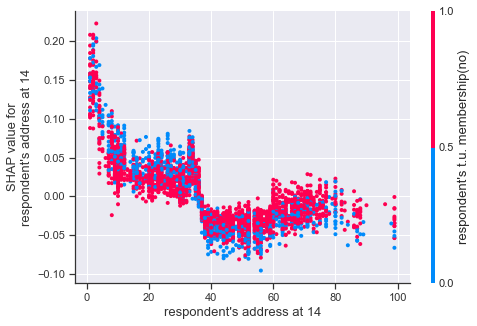

<Figure size 1152x720 with 0 Axes>

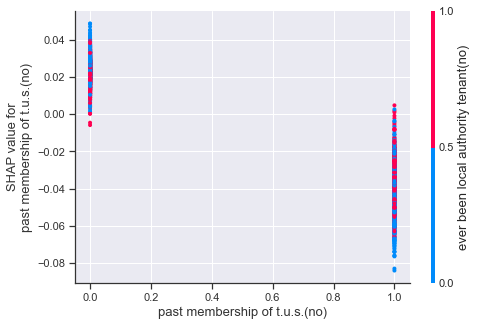

<Figure size 1152x720 with 0 Axes>

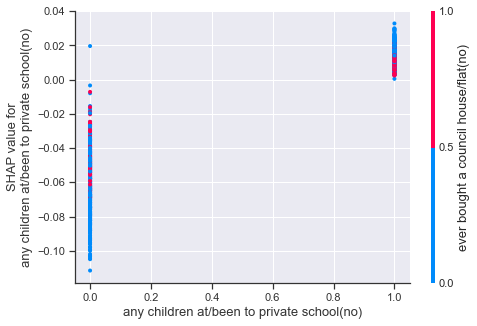

<Figure size 1152x720 with 0 Axes>

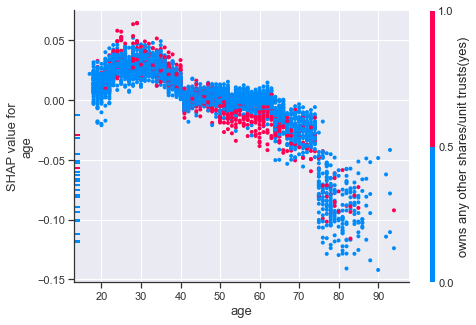

<Figure size 1152x720 with 0 Axes>

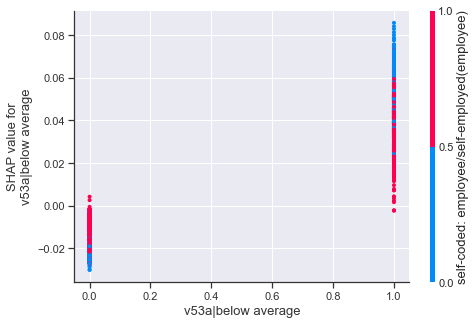

<Figure size 1152x720 with 0 Axes>

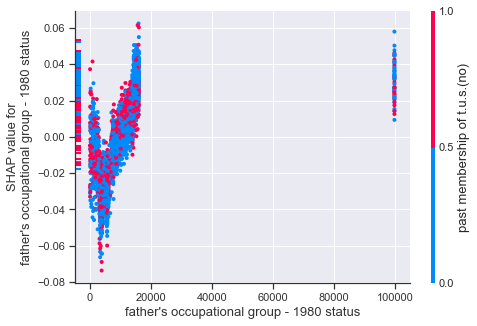

<Figure size 1152x720 with 0 Axes>

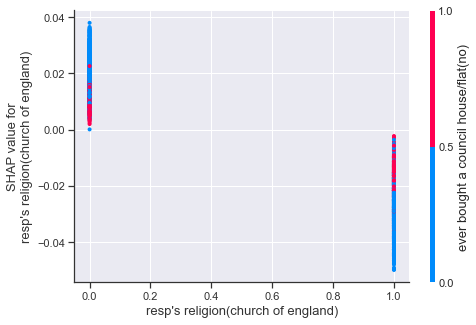

<Figure size 1152x720 with 0 Axes>

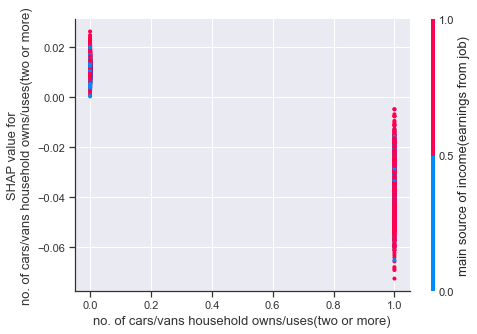

<Figure size 1152x720 with 0 Axes>

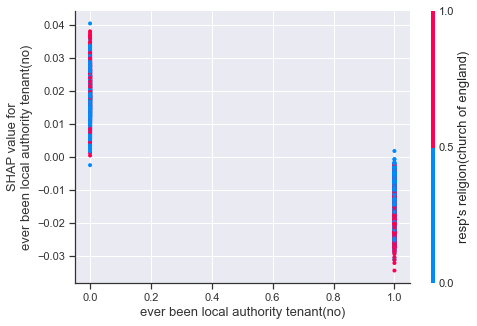

<Figure size 1152x720 with 0 Axes>

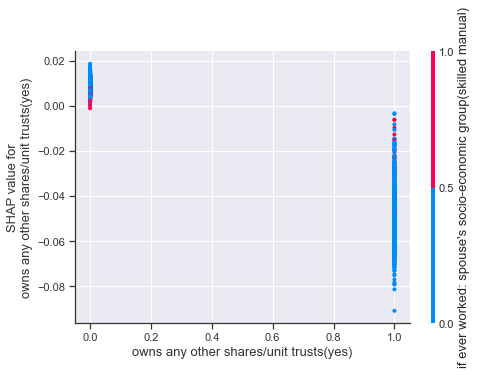

1983
MSE: 0.23, MAE: 0.45, EV: 0.08, R2: 0.08


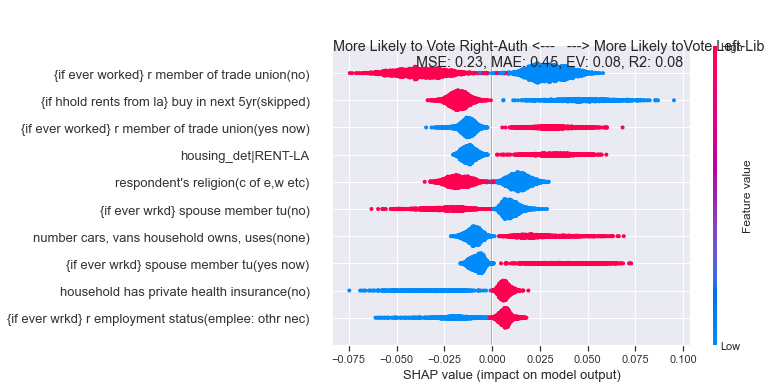

<Figure size 1152x720 with 0 Axes>

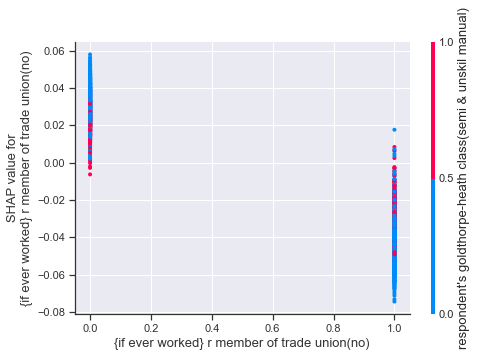

<Figure size 1152x720 with 0 Axes>

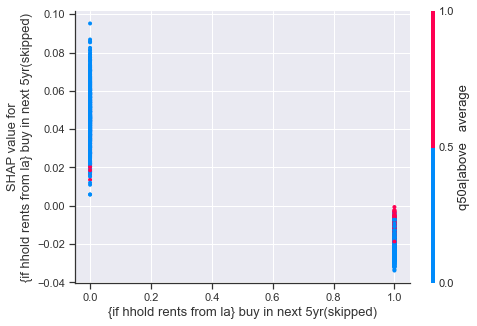

<Figure size 1152x720 with 0 Axes>

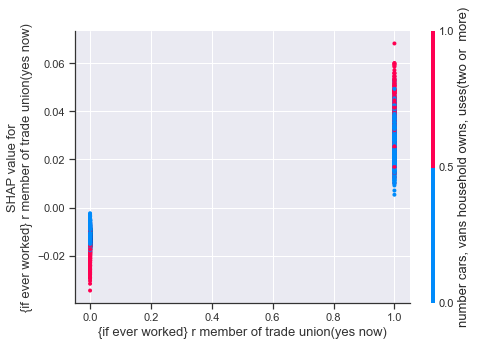

<Figure size 1152x720 with 0 Axes>

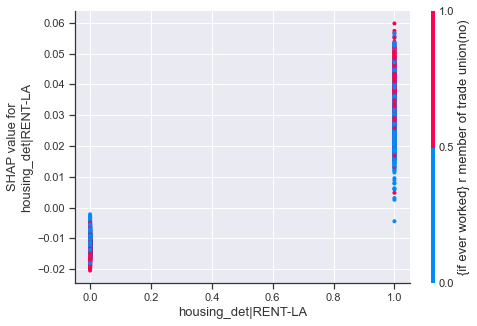

<Figure size 1152x720 with 0 Axes>

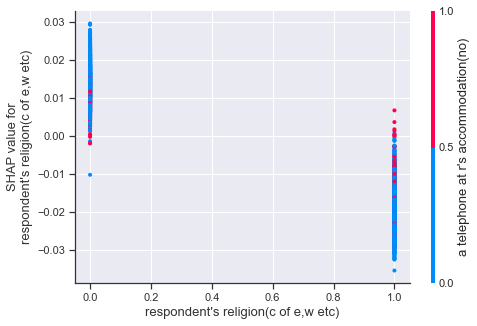

<Figure size 1152x720 with 0 Axes>

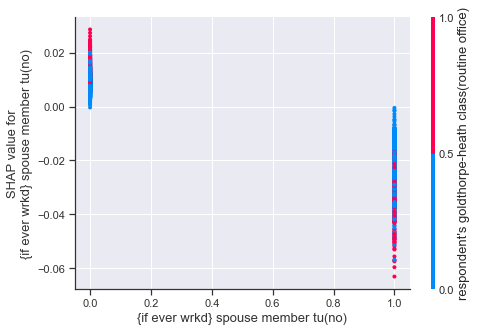

<Figure size 1152x720 with 0 Axes>

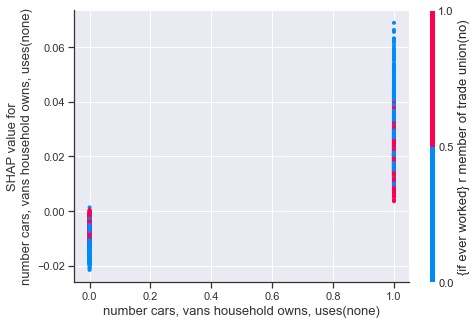

<Figure size 1152x720 with 0 Axes>

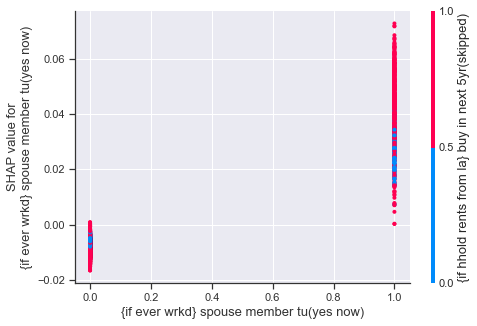

<Figure size 1152x720 with 0 Axes>

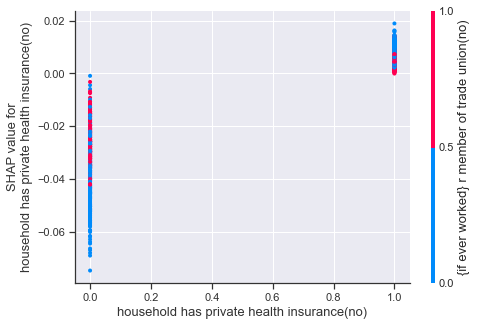

<Figure size 1152x720 with 0 Axes>

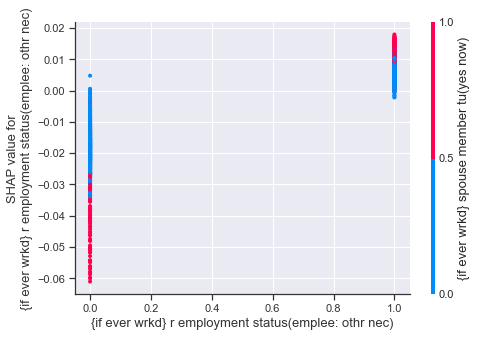

1979
MSE: 0.22, MAE: 0.44, EV: 0.09, R2: 0.09


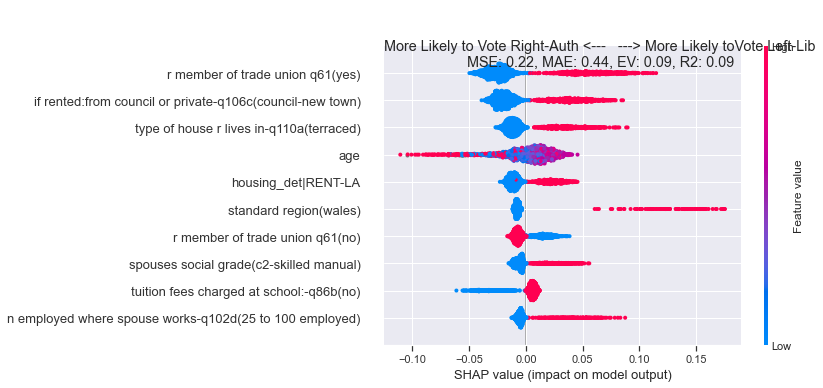

<Figure size 1152x720 with 0 Axes>

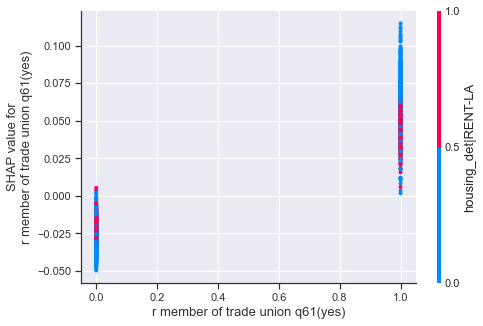

<Figure size 1152x720 with 0 Axes>

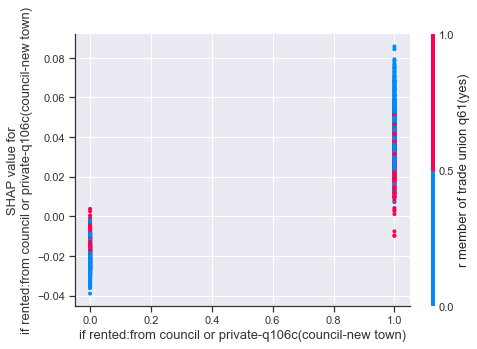

<Figure size 1152x720 with 0 Axes>

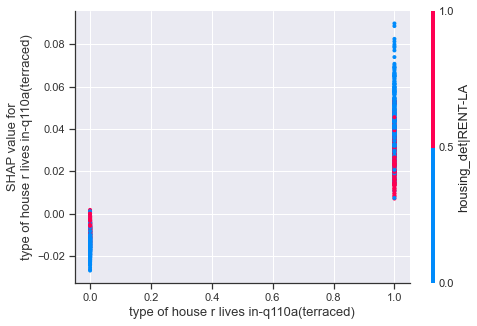

<Figure size 1152x720 with 0 Axes>

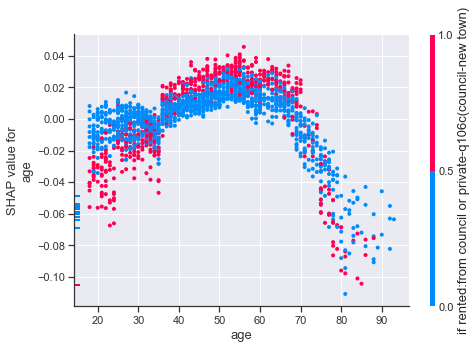

<Figure size 1152x720 with 0 Axes>

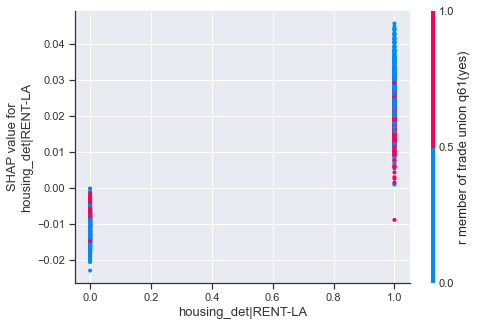

<Figure size 1152x720 with 0 Axes>

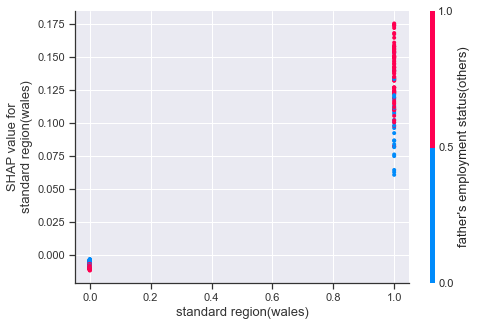

<Figure size 1152x720 with 0 Axes>

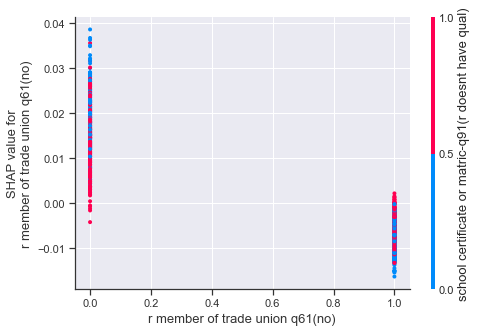

<Figure size 1152x720 with 0 Axes>

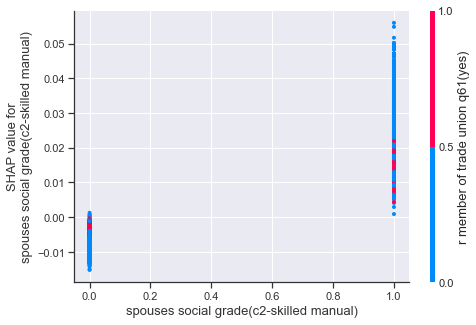

<Figure size 1152x720 with 0 Axes>

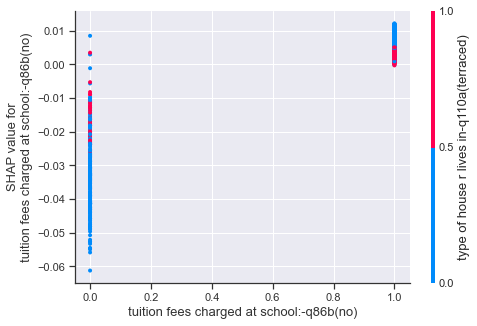

<Figure size 1152x720 with 0 Axes>

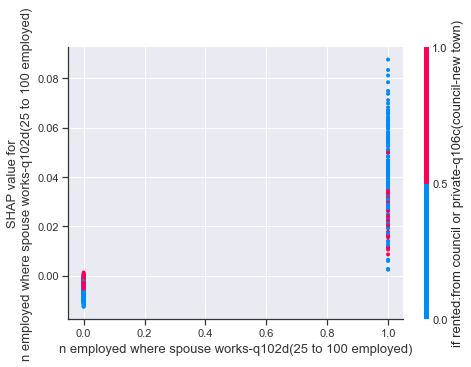

1974_feb
MSE: 0.22, MAE: 0.43, EV: 0.13, R2: 0.13


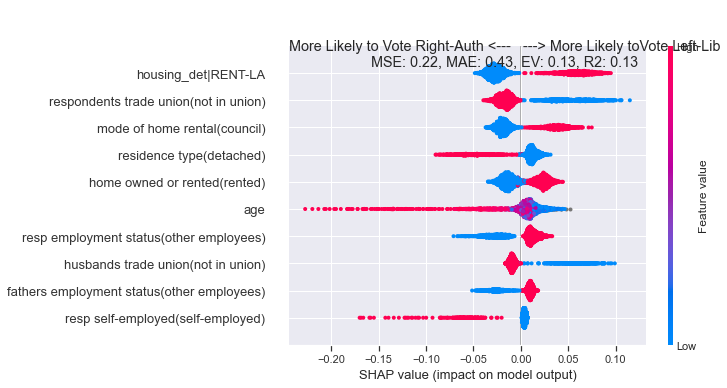

<Figure size 1152x720 with 0 Axes>

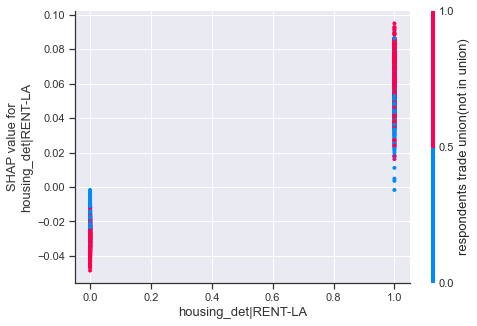

<Figure size 1152x720 with 0 Axes>

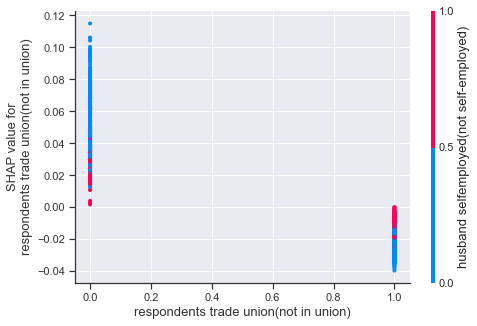

<Figure size 1152x720 with 0 Axes>

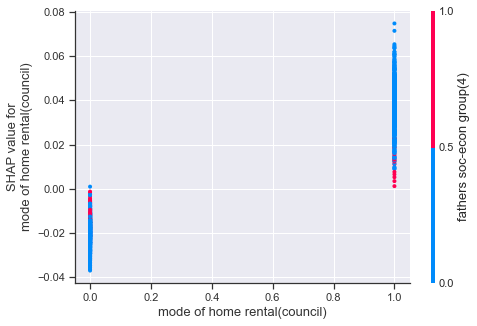

<Figure size 1152x720 with 0 Axes>

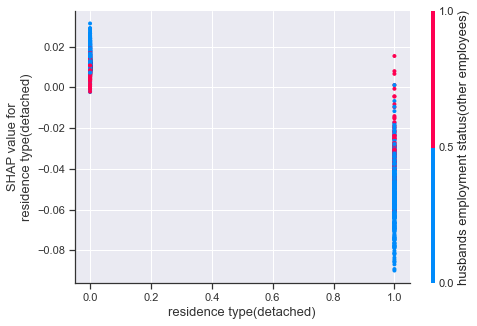

<Figure size 1152x720 with 0 Axes>

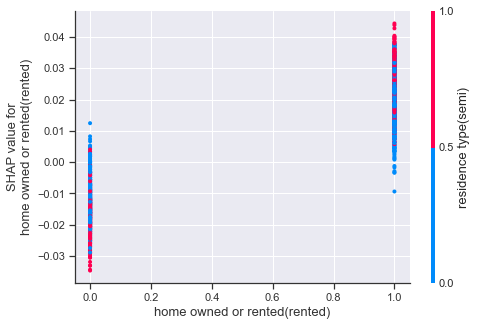

<Figure size 1152x720 with 0 Axes>

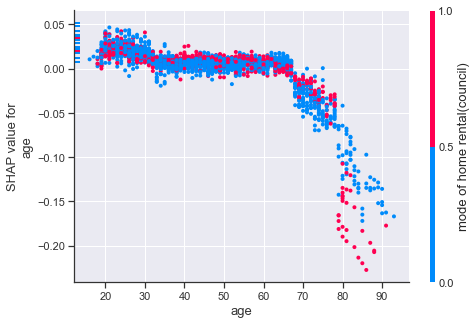

<Figure size 1152x720 with 0 Axes>

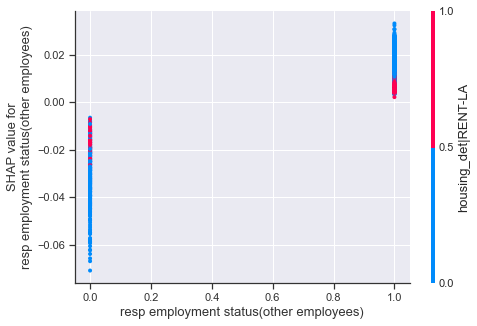

<Figure size 1152x720 with 0 Axes>

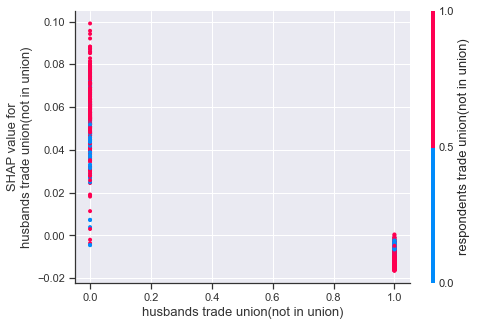

<Figure size 1152x720 with 0 Axes>

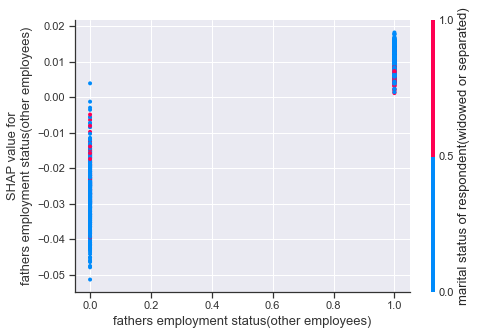

<Figure size 1152x720 with 0 Axes>

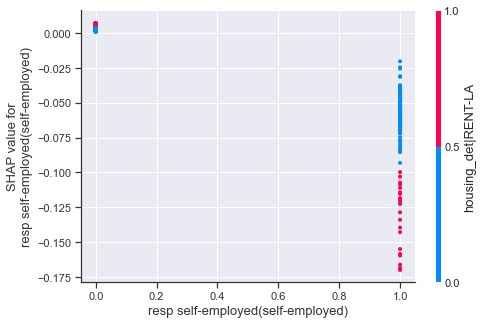

1974_oct
MSE: 0.21, MAE: 0.44, EV: 0.14, R2: 0.14


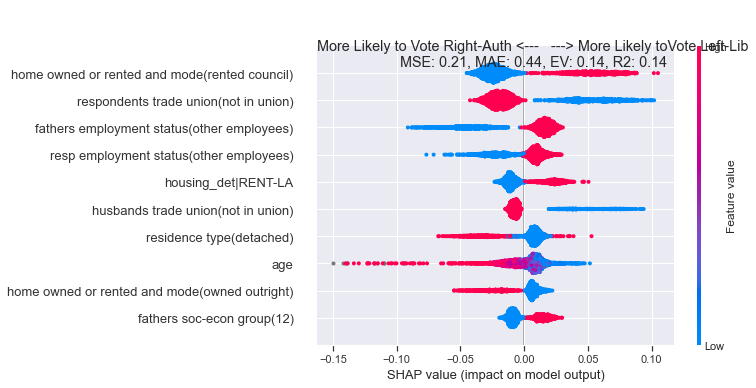

<Figure size 1152x720 with 0 Axes>

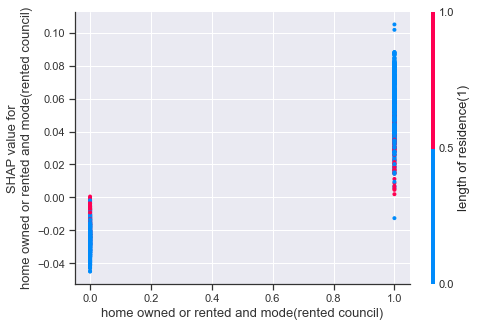

<Figure size 1152x720 with 0 Axes>

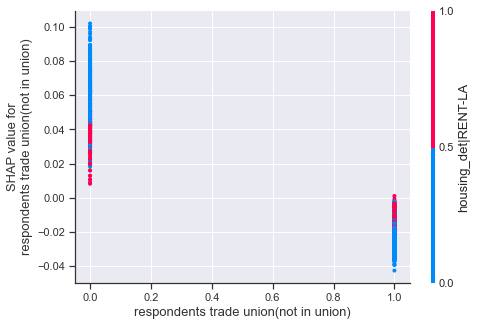

<Figure size 1152x720 with 0 Axes>

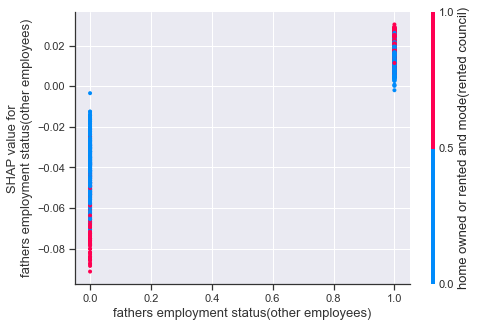

<Figure size 1152x720 with 0 Axes>

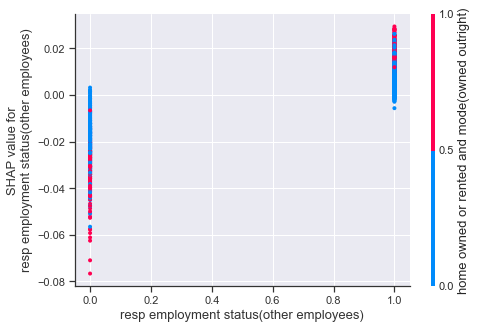

<Figure size 1152x720 with 0 Axes>

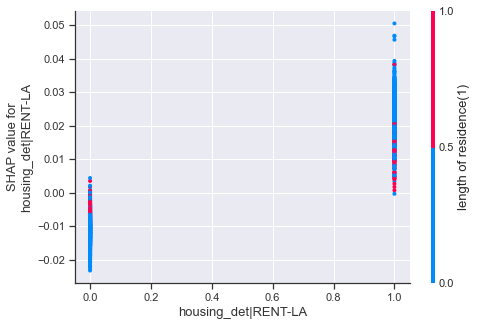

<Figure size 1152x720 with 0 Axes>

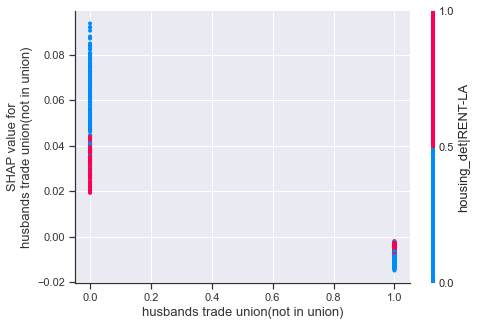

<Figure size 1152x720 with 0 Axes>

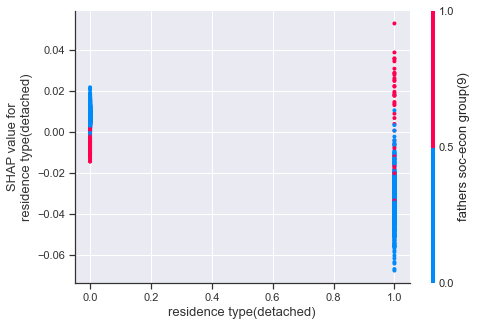

<Figure size 1152x720 with 0 Axes>

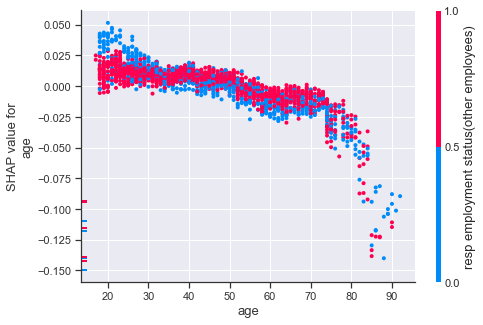

<Figure size 1152x720 with 0 Axes>

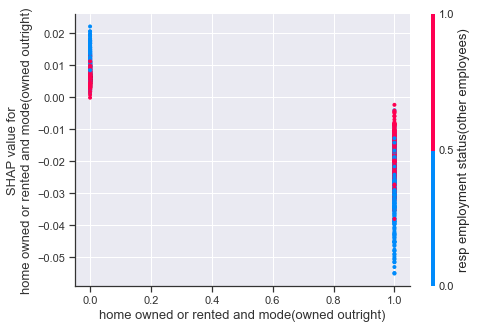

<Figure size 1152x720 with 0 Axes>

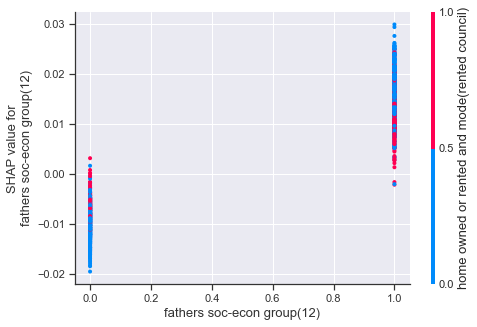

1970
MSE: 0.23, MAE: 0.46, EV: 0.08, R2: 0.08


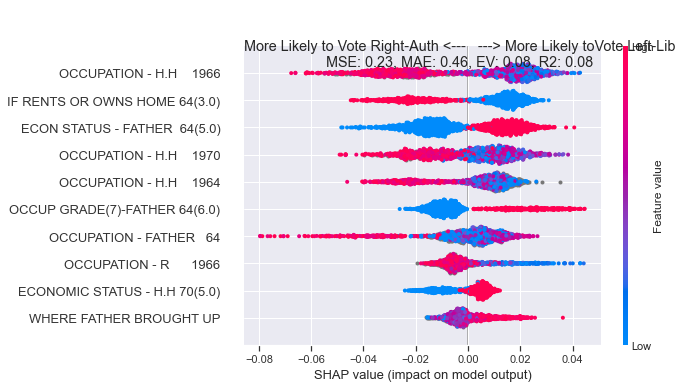

<Figure size 1152x720 with 0 Axes>

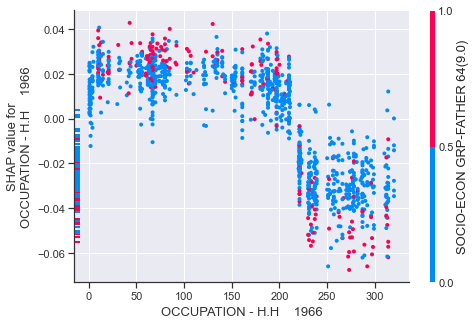

<Figure size 1152x720 with 0 Axes>

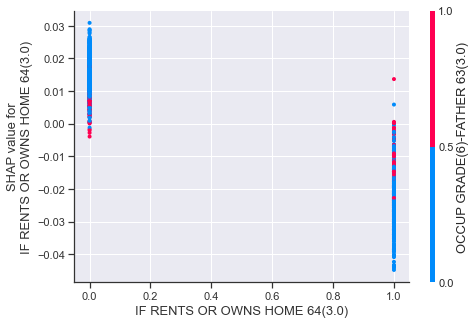

<Figure size 1152x720 with 0 Axes>

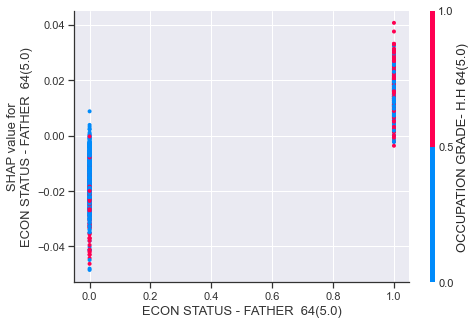

<Figure size 1152x720 with 0 Axes>

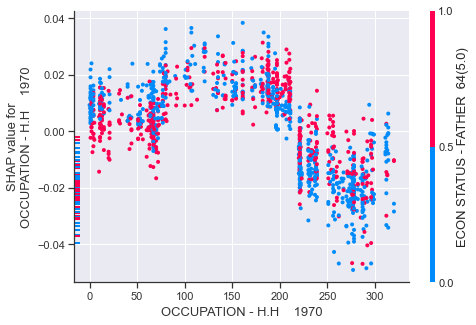

<Figure size 1152x720 with 0 Axes>

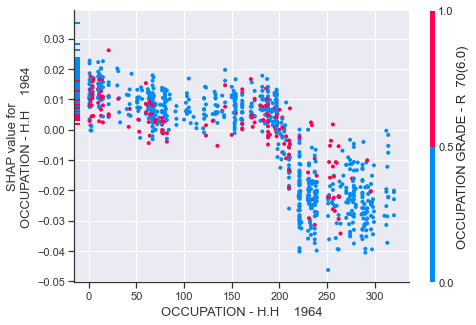

<Figure size 1152x720 with 0 Axes>

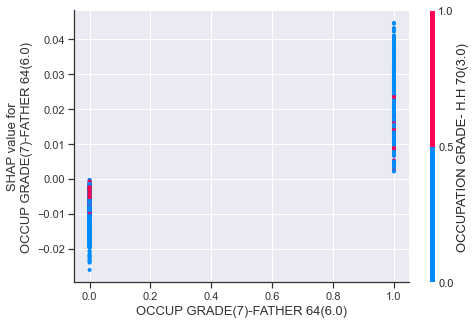

<Figure size 1152x720 with 0 Axes>

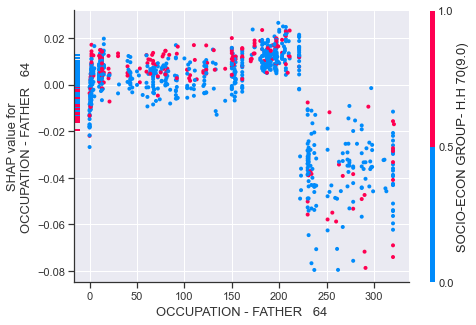

<Figure size 1152x720 with 0 Axes>

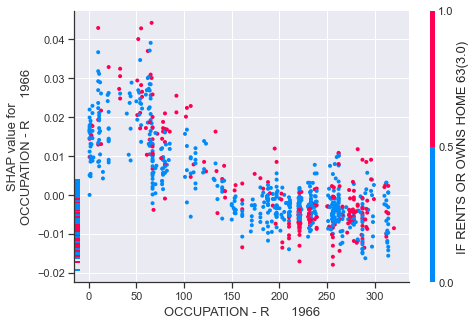

<Figure size 1152x720 with 0 Axes>

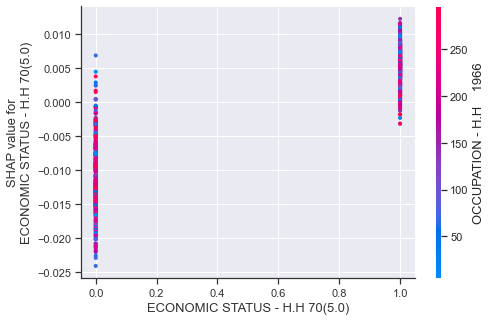

<Figure size 1152x720 with 0 Axes>

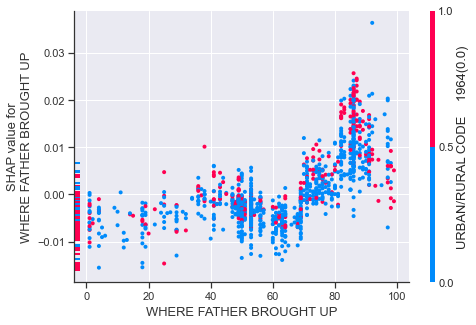

1966
MSE: 0.22, MAE: 0.44, EV: 0.12, R2: 0.12


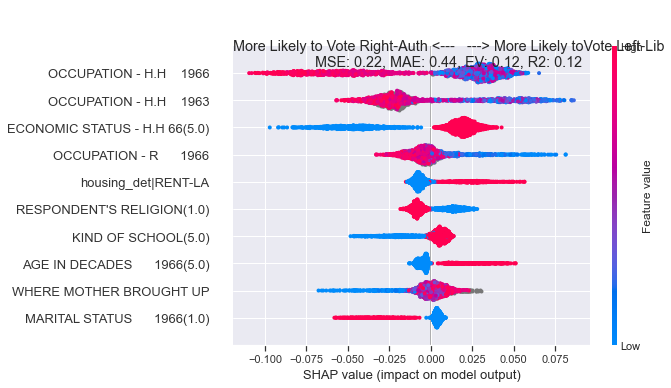

<Figure size 1152x720 with 0 Axes>

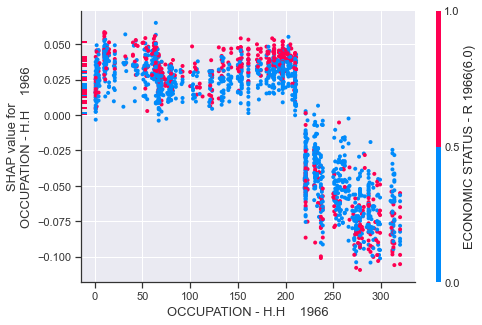

<Figure size 1152x720 with 0 Axes>

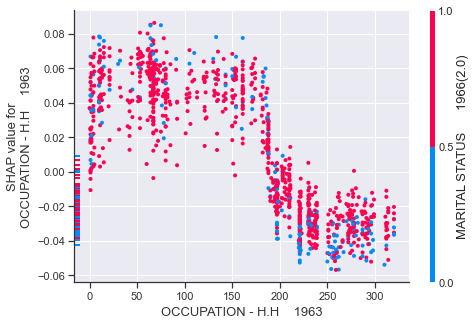

<Figure size 1152x720 with 0 Axes>

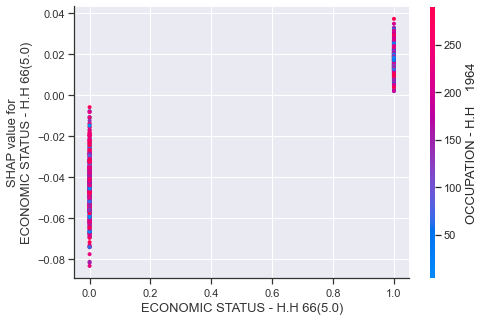

<Figure size 1152x720 with 0 Axes>

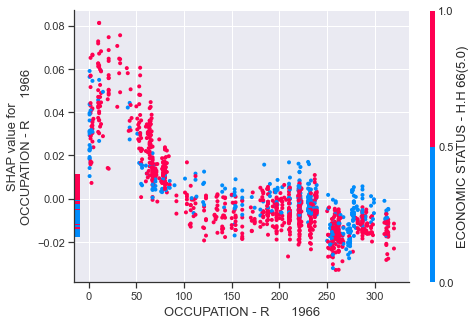

<Figure size 1152x720 with 0 Axes>

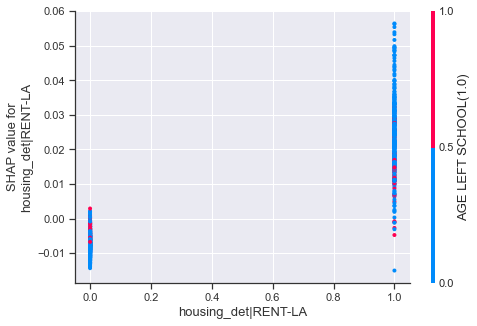

<Figure size 1152x720 with 0 Axes>

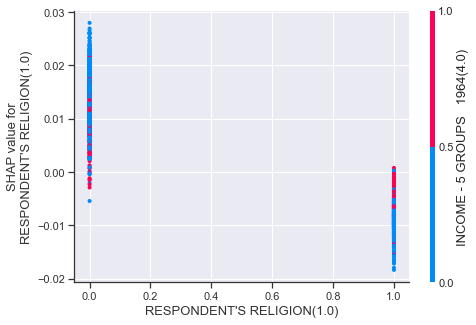

<Figure size 1152x720 with 0 Axes>

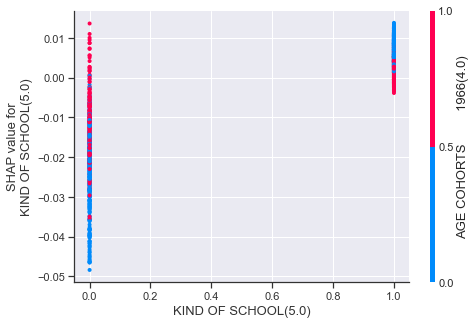

<Figure size 1152x720 with 0 Axes>

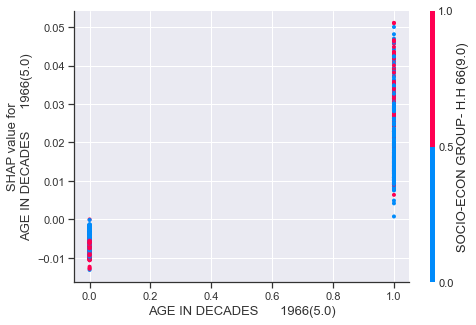

<Figure size 1152x720 with 0 Axes>

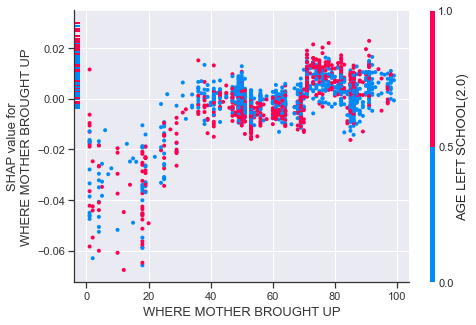

<Figure size 1152x720 with 0 Axes>

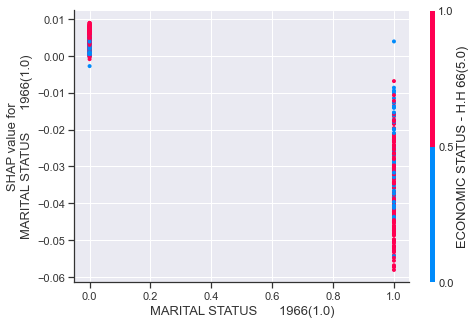

1964
MSE: 0.22, MAE: 0.43, EV: 0.14, R2: 0.14


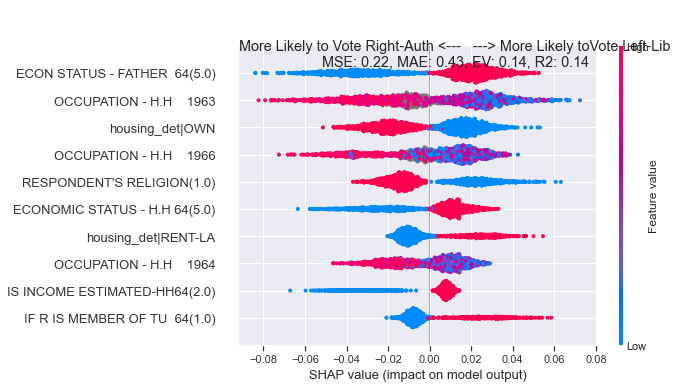

<Figure size 1152x720 with 0 Axes>

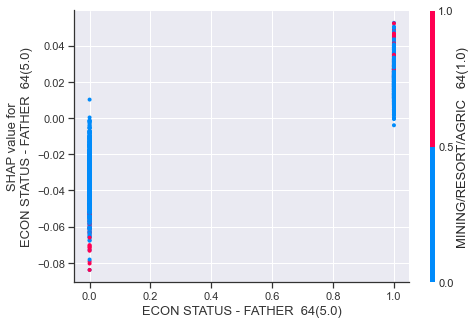

<Figure size 1152x720 with 0 Axes>

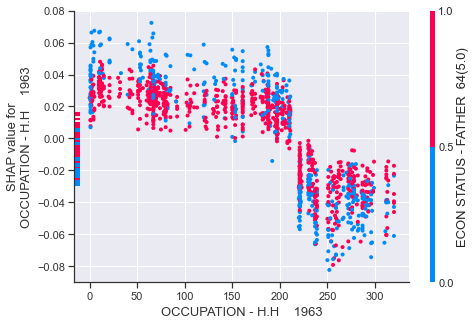

<Figure size 1152x720 with 0 Axes>

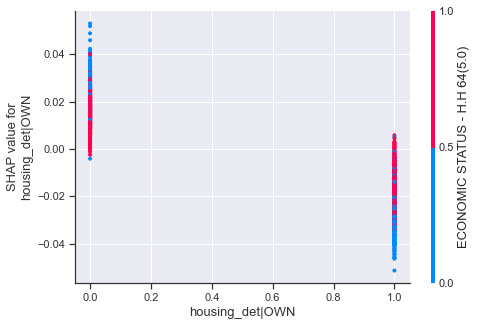

<Figure size 1152x720 with 0 Axes>

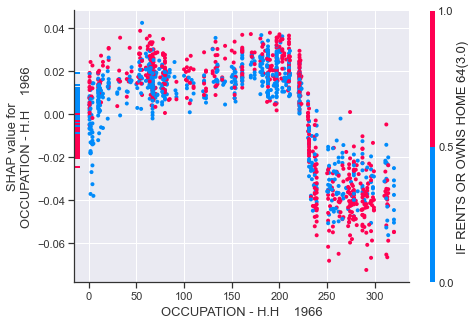

<Figure size 1152x720 with 0 Axes>

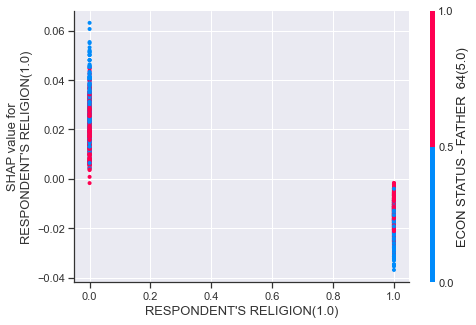

<Figure size 1152x720 with 0 Axes>

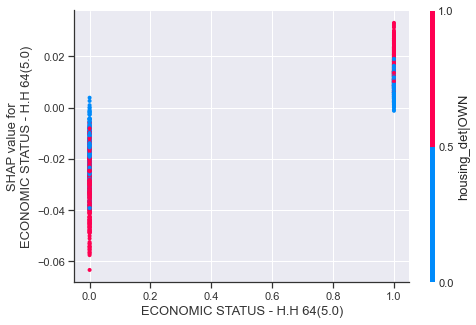

<Figure size 1152x720 with 0 Axes>

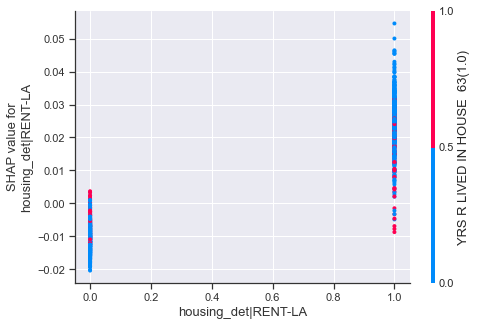

<Figure size 1152x720 with 0 Axes>

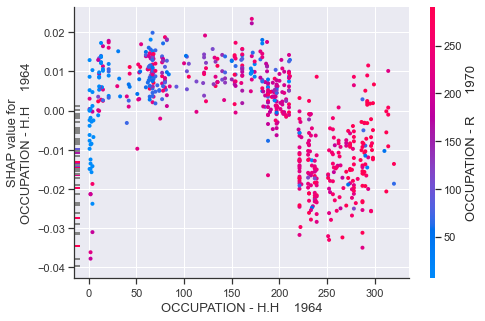

<Figure size 1152x720 with 0 Axes>

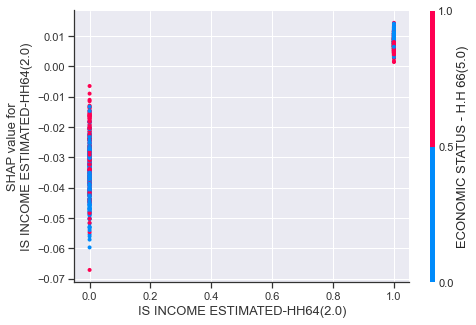

<Figure size 1152x720 with 0 Axes>

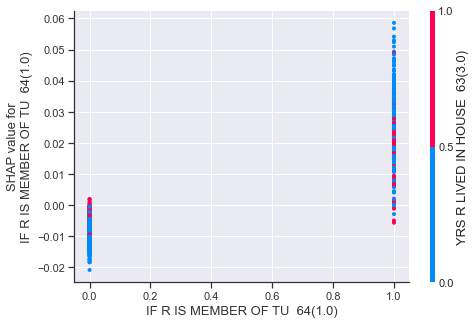

Wall time: 20min 9s


In [218]:
%%time
for ge in BES_df_list.keys():
    print(ge)
    harm_vars = ["bloc","wt","age","housing_det","inc"]
    target_var = "bloc"
    target_var_replace_dict = {"Neither":np.nan}
    target_var_drop_list = ["bloc|Right-Auth"]
    target_var_title_pair = ["Vote Right-Auth","Vote Left-Lib"]
    var_stub = "bloc|Left-Lib"
    min_features = 10

    prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
           var_stub,harm_vars,min_features,dependence_plots=True)

In [219]:
# 1964
# ...
# urban/ruralc ode

# age cohorts


In [220]:
# 1966
# lots of OCCUPATION vars
# served overseas(0-> Con)/r lived since child mr66 (1)



In [221]:
# 1970
## all cap labels!
# econ status - father 64(5)/occupation - hh 1966 ??? scale???
# if rents or owns home 64(3)
# occupation - father ??? scale
# constituency number 1963/1966/1964/1970 DROP
# where father/mother brought up
# LOCAL WARD 1963 DROP??

# DATE OF BIRTH 1970
# excess of age variables

In [222]:
# 1974_oct
# housing_det(RENT-LA)/tu memb/fathers employment status(other employees)/age/resident type(detached)
# housing_det(OWN)
# oct266|managers/oct266|managers/school attended(fee-paying|elementary|comprehensive)
# age left school(14(->Lab|16->Con), further education and type(none -> Con)

In [223]:
# 1974_feb
# housing_det(RENT-LA)/tu memb/residence type(detached/terraced/semi)/age/mode of home rental(council)
# reso self-employed/place grew up in(town)/area grew up in(greater london|scotland)/region(west midlands/south west)
# feb254|managers/resp nature of responsibility(small group)
# age left school(15)/previous location(same city or county)
# feb188|mortgage/feb250|same village or town

In [224]:
# 1979
# tu memb/housing_det(RENT-LA)/type of house (terraced|flat,maisonette/bsit|detached)/age/region
# tuition fees charged/r's employment status(others)
# if rented: from council or private-q106x(council-new town)
# n employed where spouse works-q102d(25-100|501-1000)
# r brought up as practising religion

In [225]:
# 1983
# tu memb/housing_det(RENT-LA)/
# {if hhold rents from la} buy in next 5yr(skipped|definitely not)
# (if hhold owns) has been la tenant(skipped)
# {if private house} number in household(5.0|2.0)
# resp,spouse rcvd state pension(no)/resp spouse rcvd unemployment benefit(no)
# respondent's sex(male)

In [226]:
# 1987
# respondent's address at 14 ????? -> needs to be recast as nominal (lot of categories - room for a course version which is Wales/SCot/Eng ...)
# tu memb/*ever* rent la/
# father's occupational group - 1980 status - should also be nominal
# total hh income before tax (refused) -> not lab, total hh income before tax (don't know) -> lab

In [227]:
# 1992
# tu memb/spouse tu memb/private health ins/hh use of car (2+)
# respondent's accomodation tenure (rent-la/ntdc/he)
# considered private school for child
# age
# father self-employed
# religion/religion brought up in
# inc (4th 1/4)/ spouse HG class/ rent LA/
# bought house as an LA tenant
# bought any shares

In [228]:
# 1997
# tu memb/private medical/own shares/region
# dwelling type(whole hse detached/wholse hse mid-terrace)/electoral register/qual obtained/upbringing religion
# goldthorpe class compressed (wc)/hhincqua(lowest quartile)
# religious denom
# hhincqus|skp,eng+wales ???
# tenure of accommodation? gc q953(own(leasheold/freehold) outright)
# fee-paying school (yes - secondary level)
# hours spouse worked (40)/spouse is/was manager/supervisors (not)
# hh use of car?/size of est where father worked (10-24)
# rsic92gp|transp. storage, communications
# rlastjob(5-10 yrs ago)

In [229]:
# 2001
# age/tu memb/incomes(refused)/religion/educational/work qual(yes|no)/occ sector(private|public),housing_det(MORT)
# spouse goldthorpe 11-class (routine non-manual)/inc(35-45|0-15)/own outright or mortgage
# socio-economic classification analytic (employers in small org/own-account|skilled manual workers)
# spouse-occ sector (refused,na),housing_det(OWN|RENT)
# name of constituency DROP
# nssecr(higher managerial)/ethnicity/incomes(<5000),inc(60k+)

In [230]:
# 2005
# goldthorpe 5 cat(99)/gender(99)/cage/tu memb/accommodation descr(3|1)/work sector/religion/main source of hh inc(4)
# housing_det(MORT)/combined age/age/spouse goldthorpe 5 cat(99)/region/highest ed qual
# county

In [231]:
# 2010
# age finish full-time ed(19+|16|15-)|pano DROP|spouse occ(prof/higher tech|small business|clerical)/occ sector(private sector|nat industry/public corp)
# tu member
# age/religion/how many ppl in hh/gender/inc(25-35k)/ppl in hh (<18)/region
# how often personal rel activities/aq65_2(mortgage)/housing_det(MORT)/own or rent(own)/ethnicity
# highest qual/inc/rent from whom(other individual)/main source of income (jsa/unemploy ben)

In [232]:
# 2015
# region/elec-register/highest ed qual/religion/dwelling type(detached/semi-detached/end-terrace)/tu member/spouse work(modern prof occ)
# ns_sec_analytic(lower prof/managerial/higher supervisory)/ns_sec occ class (L4.1 trad employee)/age
# religious attendance/how many ppl worked for your employer (1-24/25-499)
# parent class (semi-routing manual/service occ)
# income - gross household(Refused)
# y03|Own home on mortgage/ethnicity/marital status/gender
# when you were 16, who was chief income earned (Mother)
# Dependents: None of the above(No)
# Floor of dwelling (!)/ income gross hh (50-60k)/working status (full time 30+hrs)
# IMD quintile (3/1)  DROP/housing_det(RENT-PR)


In [233]:
# 2017
# tu memb/nsec/religion/highest ed qual/age
# social class based on occ(skilled non-manual)/how many ppl worked for your empl(1-24|25-499)/region/age(55-64)/electoral reg
# any ed or work related qualifications (Yes)
# Dependents: None of the above(No)/Religious attendance(Once a week or more)/inc(15.6-26k/26k-31k)/inc gross hh (10.4-<16k)
# Gender(Male)/CSES: Gender(Male)/Marital Status(Single)/housing_det(MORT/OWN)
# seg(Managers in central and local govt/industry/commerce/large est.)|ns_sec_analytic(lower professional/managerial/higher superv)
# working status(retired)/housing_det(RENT-LA)/employee or self-employed

In [234]:
# 2019
# highest ed qualification (1st degree/undergrad/postgrad/no qual/a level)
# region (scotland/london/west midlands/eastern/south east/north west/wales)
# elec register (on/not on/don't know)
# Age/age
# religion (coe/islam/roman catholic/christian non-denom/none)/any
# tu member
# ns_sec scale/(analytic 1.2)
# ethnicity

# number of eligible people(1/2) / total number of households

# y25a|(private sectore firm/charity voluntary sector)
# working status (full time student/part time 8-29hrs)
# type of dwelling (semi-detached/centre terraced house)
# marital status (married/civ partn)
# income gross weekly (not stated)/total income from all sources before tax (don't know)
# gender(male)
# dependents: school children (Yes/No)
# age at last birthday (35-44/55)
# how many ppl worked for your employer where you work[ed] (1-4/25-499)



In [313]:
# BES_label_list["2017"]["y47"]

In [236]:
# var_type_dict_nonans["2019"]["Age"]

In [312]:
# demo_var_dict["2017"]

In [310]:
# BES_df_list["1987"]

In [311]:
# BES_label_list["1987"]

In [ ]:
## double check age variabl;es

In [ ]:
#1964/1966/1970

# 'v938': 'AGE IN YEARS        1963',
# 'v939': 'AGE IN YEARS        1964',
# 'v940': 'AGE IN YEARS        1966',
# 'v941': 'AGE IN YEARS        1970',
# 'v942': 'AGE IN DECADES      1963',
# 'v943': 'AGE IN DECADES      1964',
# 'v944': 'AGE IN DECADES      1966',
# 'v945': 'AGE IN DECADES      1970',

In [230]:
ge = "1964"
age_vars = ['v'+str(x) for x in list(range(938,946))+list(range(1208,1214))+[937,484,485]]

# pd.Series(BES_label_list[ge])[["v1208","v1209","v1210","v1211","v1212","v1213",'v484','v485']]

temp_ages_and_dec_and_by = pd.concat([BES_df_list[ge][age_vars].replace(0,np.nan), f2f_harmonised[f2f_harmonised["dataset"]==ge]["age"]],axis=1)
temp_ages_and_dec_and_by.columns = [BES_label_list[ge][x] if x in BES_label_list[ge].keys() else x for x in temp_ages_and_dec_and_by.columns]

In [231]:
age_cohort_1963_dict = {9:np.nan,0:np.nan,1:"65+",2:"50-64",3:"35-49",4:"34-"}
temp_ages_and_dec_and_by["AGE COHORTS         1963"] = temp_ages_and_dec_and_by["AGE COHORTS         1963"].replace(age_cohort_1963_dict)
age_cohort_1964_dict = {9:np.nan,0:np.nan,1:"66+",2:"51-65",3:"36-50",4:"20-35"}
temp_ages_and_dec_and_by["AGE COHORTS         1964"] = temp_ages_and_dec_and_by["AGE COHORTS         1964"].replace(age_cohort_1964_dict)
age_cohort_1966_dict = {9:np.nan,0:np.nan,1:"68+",2:"53-67",3:"38-52",4:"20-37"}
temp_ages_and_dec_and_by["AGE COHORTS         1966"] = temp_ages_and_dec_and_by["AGE COHORTS         1966"].replace(age_cohort_1966_dict)
age_cohort_1970_dict = {9:np.nan,0:np.nan,1:"72+",2:"57-71",3:"42-56",4:"20-41"}
temp_ages_and_dec_and_by["AGE COHORTS         1970"] = temp_ages_and_dec_and_by["AGE COHORTS         1970"].replace(age_cohort_1970_dict)

age_cohort_dict = {1:"20",2:"21-24",3:"25-29",4:"30-39",5:"40-49",6:"50-59",7:"60-69",8:"70-79",9:"80+",0:np.nan}
temp_ages_and_dec_and_by[['AGE IN DECADES      1963', 'AGE IN DECADES      1964', 'AGE IN DECADES      1966', 'AGE IN DECADES      1970']] = \
    temp_ages_and_dec_and_by[['AGE IN DECADES      1963', 'AGE IN DECADES      1964', 'AGE IN DECADES      1966', 'AGE IN DECADES      1970']].replace(age_cohort_dict)


ed_gen_cohort_1963_dict = {9:np.nan,0:np.nan,1:"57+",2:"30-56",3:"29-"}
temp_ages_and_dec_and_by['EDUCATION GENERATIONS 63'] = temp_ages_and_dec_and_by['EDUCATION GENERATIONS 63'].replace(ed_gen_cohort_1963_dict)
ed_gen_cohort_1966_dict = {9:np.nan,0:np.nan,1:"60+",2:"33-59",3:"32-"}
temp_ages_and_dec_and_by['EDUCATION GENERATIONS 66'] = temp_ages_and_dec_and_by['EDUCATION GENERATIONS 66'].replace(ed_gen_cohort_1966_dict)

In [263]:
temp_ages = BES_df_list[ge][age_vars[0:4]].copy()
# temp_decades = BES_df_list[ge][age_vars[4:8]].copy()
# temp_ages_and_dec = BES_df_list[ge][age_vars[0:8]].copy()
# # temp_ages_and_dec_and_by = BES_df_list[ge][age_vars[0:9]].copy()
# temp_ages.diff(axis=1).stack().value_counts()
anomalies = temp_ages.diff(axis=1).apply(lambda x: (x<0) | (x> 7)).any(axis=1)

In [232]:
temp_ages_and_dec_and_by.columns[-3:]

def full_form_birth_year(x):
    if pd.isnull(x):
        return np.nan
    elif x>60:
        return 1800 + x
    else:
        return 1900 + x
    
    
temp_ages_and_dec_and_by["MOTHER BIRTH YEAR"] = temp_ages_and_dec_and_by['YEAR MOTHER BORN    1970'].apply(lambda x: int(x)+1000 if pd.notnull(x) else np.nan)
temp_ages_and_dec_and_by["FATHER BIRTH YEAR"] = temp_ages_and_dec_and_by['YEAR FATHER BORN    1970'].apply(lambda x: int(x)+1000 if pd.notnull(x) else np.nan)
temp_ages_and_dec_and_by["BIRTH YEAR"] = temp_ages_and_dec_and_by['DATE OF BIRTH       1970'].apply(full_form_birth_year)
temp_ages_and_dec_and_by["MOTHER BIRTH AGE"] = temp_ages_and_dec_and_by["BIRTH YEAR"] - temp_ages_and_dec_and_by["MOTHER BIRTH YEAR"]

temp_ages_and_dec_and_by = temp_ages_and_dec_and_by[['age','AGE IN YEARS        1963', 'AGE IN YEARS        1964',
       'AGE IN YEARS        1966', 'AGE IN YEARS        1970',
       'AGE IN DECADES      1963', 'AGE IN DECADES      1964',
       'AGE IN DECADES      1966', 'AGE IN DECADES      1970',
       'AGE COHORTS         1963', 'AGE COHORTS         1964',
       'AGE COHORTS         1966', 'AGE COHORTS         1970',
       'EDUCATION GENERATIONS 63', 'EDUCATION GENERATIONS 66',"BIRTH YEAR","MOTHER BIRTH AGE","MOTHER BIRTH YEAR","FATHER BIRTH YEAR"
       ]]

In [342]:
temp_ages_and_dec_and_by["predictions"] = age_pred

# ,age_pred.shape
#

In [408]:
age_year_vars = ['AGE IN YEARS        1963', 'AGE IN YEARS        1964','AGE IN YEARS        1966', 'AGE IN YEARS        1970']

temp_ages_and_dec_and_by.loc[35,age_year_vars]= [54.0, 55.0, 57.0, 61.0]
# single typo
temp_ages_and_dec_and_by.loc[60,age_year_vars]= [26,27.0,29.0,33]
# more consist with decade vars
temp_ages_and_dec_and_by.loc[93,age_year_vars]= [66.0,67,69.0,71.0]
# single typo
temp_ages_and_dec_and_by.loc[103,age_year_vars]= [24.0,25.0,27,31]
# NO FIX - not enough info - FIXED using predicted age
temp_ages_and_dec_and_by.loc[118,age_year_vars]= [69.0,70.0,72.0,77.0]
# single typo
temp_ages_and_dec_and_by.loc[211,age_year_vars]= [32.0,33.0,35.0,39.0]
# NO FIX - 1970 vars consist contradict 1963-1966 FIXED using predicted age
temp_ages_and_dec_and_by.loc[240,age_year_vars]= [28.0,29.0,32.0,36.0]
# single typo
temp_ages_and_dec_and_by.loc[359,age_year_vars]= [70.0,72.0,73.0,77.0]
# NO FIX - 1970 vars consist contradict 1963-1966 FIXED using predicted age
temp_ages_and_dec_and_by.loc[819,age_year_vars]= [23.0,24.0,26.0,30.0]
# NO FIX - 1970 vars consist contradict 1963-1966 FIXED using predicted age
temp_ages_and_dec_and_by.loc[948,age_year_vars]= [54.0,55.0,57.0,61]
# single typo
temp_ages_and_dec_and_by.loc[1056,age_year_vars]= [50.0,51.0,53.0,57]
# mother age inconsistent with 1970 age
temp_ages_and_dec_and_by.loc[1191,age_year_vars]= [54.0,56.0,57.0,61.0]
# NO FIX - 1970 vars consist contradict 1963-1966 FIXED using predicted age
temp_ages_and_dec_and_by.loc[1204,age_year_vars]= [35.0,36.0,38.0,39.0]
# single typo
temp_ages_and_dec_and_by.loc[1298,age_year_vars]=[36.0, 38.0, 39.0, 43.0]
# hmph - bit inconsistent with predictions

temp_ages_and_dec_and_by.loc[1319,age_year_vars]= [51.0,52.0,53.0,57]
# single typo
temp_ages_and_dec_and_by.loc[1357,age_year_vars]= [72.0, 73.0, 75, 79]
# NO FIX - not enough info FIXED using predicted age
temp_ages_and_dec_and_by.loc[1369,age_year_vars] = [49.0, 50.0, 52.0, 56.0]
# FIXED using predicted age
temp_ages_and_dec_and_by.loc[1395,age_year_vars]=[58.0, 60.0, 61.0, 65.0]
# NO FIX - 1970 vars consist contradict 1963-1966
temp_ages_and_dec_and_by.loc[1426,age_year_vars]=[69.0,70, 72.0, 76.0]
# single typo
temp_ages_and_dec_and_by.loc[1432,age_year_vars]=[69.0, 70.0, 72.0, 76.0]
# NO FIX - too many contradictions! FIXED using predicted age
temp_ages_and_dec_and_by.loc[1510,age_year_vars]=[80.0, 82.0, 83.0, 87.0]
# single typo (birth age ... weirdly inconsistent)
temp_ages_and_dec_and_by.loc[1594,age_year_vars]=[42.0, 43.0, 44.0, 48.0]
# single typo
temp_ages_and_dec_and_by.loc[1659,age_year_vars]=[46.0, 47, 49.0, 53]
# single typo
temp_ages_and_dec_and_by.loc[1718,age_year_vars]=[50.0, 51, 53.0, 57.0]
# single typo
temp_ages_and_dec_and_by.loc[1736,age_year_vars]=[78.0, 79.0, 81.0, 85.0]
# single typo
temp_ages_and_dec_and_by.loc[1784,age_year_vars]=[80.0, 81.0, 83.0, 87.0]
# single typo (not so simple)
temp_ages_and_dec_and_by.loc[1814,age_year_vars]=[50.0, 51.0, 53.0, 56.0]
# single typo
temp_ages_and_dec_and_by.loc[1818,age_year_vars]=[41.0, 42.0, 43.0, 47.0]
# single typo
temp_ages_and_dec_and_by.loc[1842,age_year_vars]=[48.0, 50.0, 51.0, 55.0]
# single typo
temp_ages_and_dec_and_by.loc[1865,age_year_vars]=[39.0, 40.0, 42.0, 46.0]
# single typo
temp_ages_and_dec_and_by.loc[1939,age_year_vars]=[55.0, 56.0, 58.0, 63.0]
# single typo
temp_ages_and_dec_and_by.loc[1973,age_year_vars]=[39.0, 41.0, 42.0, 45.0]
# single typo
temp_ages_and_dec_and_by.loc[2090,age_year_vars]=[64, 65, 67.0, 71.0]
# NO FIX - not enough info  FIXED using predicted age
temp_ages_and_dec_and_by.loc[2095,age_year_vars]=[32, 33.0, 34.0, 38.0]
# single typo
temp_ages_and_dec_and_by.loc[2136,age_year_vars]=[28, 29.0, 30.0, 34.0]
# single typo (or 1970 different???)
temp_ages_and_dec_and_by.loc[2272,age_year_vars]=[55, 56.0, 57.0, 61.0]
# single typo
temp_ages_and_dec_and_by.loc[2358,age_year_vars]=[47, 48.0, 50.0, 54.0]
# NO FIX - not enough info FIXED using predicted age 47
temp_ages_and_dec_and_by.loc[2360,age_year_vars]=[49, 50.0, 51.0, 55.0]
# single typo
temp_ages_and_dec_and_by.loc[2371,age_year_vars]=[27, 29.0, 30.0, 34.0]
# NO FIX - not enough info FIXED using predicted age 27
temp_ages_and_dec_and_by.loc[2373,age_year_vars]=[28, 29.0, 31.0, 35.0]
# single typo
temp_ages_and_dec_and_by.loc[2458,age_year_vars]=[38, 39, 41.0, 45.0]
# NO FIX - not enough info FIXED using predicted age 49
temp_ages_and_dec_and_by.loc[2461,age_year_vars]=[31, 32, 34.0, 38.0]
# NO FIX - not enough info FIXED using predicted age 37
temp_ages_and_dec_and_by.loc[2492,age_year_vars]=[49, 50, 52.0, 56.0]
# NO FIX - not enough info FIXED using predicted age 54
temp_ages_and_dec_and_by.loc[2494,age_year_vars]=[34, 35, 37, 41.0]
# NO FIX - not enough info FIXED using predicted age 37
temp_ages_and_dec_and_by.loc[2500,age_year_vars]=[65, 66, 68.0, 72]
# NO FIX - not enough info FIXED using predicted age 62
temp_ages_and_dec_and_by.loc[2524,age_year_vars]=[31, 32, 34.0, 38]
# NO FIX - not enough info FIXED using predicted age 38

## skipping whole bunch that are the same
# which is all the rest

## actual missing values *where there are weights* for each GE

# ge = "1970"
# temp_ages_and_dec_and_by[f2f_harmonised[f2f_harmonised["dataset"]==ge]["wt"].notnull()].isnull()['AGE IN YEARS        '+ge].replace(False,np.nan).dropna()
#["wt"]

# 1964: 2395 # all nans!
# 1966: 2045 # one value in 1970 - backpropagate!
# 1970: 690 # one missing value in 1970

temp_ages_and_dec_and_by.loc[2045,age_year_vars] = [73, 74, 76, 80]
temp_ages_and_dec_and_by.loc[690,age_year_vars] = [25, 27, 28, 32]

temp_ages_and_dec_and_by.loc[1418,age_year_vars] = [46.0, 48.0, 49.0, 53.0]
# unclear!
temp_ages_and_dec_and_by.loc[1428,age_year_vars] = [51.0, 52.0, 54.0, 58.0]
# pred 62
temp_ages_and_dec_and_by.loc[1435,age_year_vars] = [49.0, 50.0, 52.0, 56.0]
# pred 55
temp_ages_and_dec_and_by.loc[1752,age_year_vars] = [63.0, 64.0, 66.0, 70.0]
# pred 62
temp_ages_and_dec_and_by.loc[2037,age_year_vars] = [82.0, 83.0, 84.0, 88.0]
# pred 81
temp_ages_and_dec_and_by.loc[2299,age_year_vars] = [39.0, 40.0, 42.0, 46.0]
# pred 47
temp_ages_and_dec_and_by.loc[2380,age_year_vars] = [29.0, 30.0, 32.0, 36.0]
# pred 35
temp_ages_and_dec_and_by.loc[2565,age_year_vars] = [60, 61, 63.0, 67.0]
# pred 54
temp_ages_and_dec_and_by.loc[2650,age_year_vars] = [46, 47, 49.0, 53.0]
# pred 52
temp_ages_and_dec_and_by.loc[2684,age_year_vars] = [47, 48, 50.0, 54.0]
# pred 59
temp_ages_and_dec_and_by.loc[2690,age_year_vars] = [66, 67, 69, 73.0]
# pred 72
temp_ages_and_dec_and_by.loc[2697,age_year_vars] = [25, 26, 28.0, 32.0]
# pred 43
temp_ages_and_dec_and_by.loc[2707,age_year_vars] = [51, 52, 54.0, 58.0]
# pred 49
temp_ages_and_dec_and_by.loc[2726,age_year_vars] = [33, 34, 36.0, 40.0]
# pred 43
temp_ages_and_dec_and_by.loc[2730,age_year_vars] = [29, 30, 32.0, 36.0]
# pred 46
temp_ages_and_dec_and_by.loc[2763,age_year_vars] = [41, 42, 44.0, 48.0]
# pred 50
temp_ages_and_dec_and_by.loc[2814,age_year_vars] = [58, 59, 61.0, 65.0]
# pred 60
temp_ages_and_dec_and_by.loc[2819,age_year_vars] = [53, 54, 56.0, 60.0]
# pred 44
temp_ages_and_dec_and_by.loc[2829,age_year_vars] = [31, 32, 34.0, 38.0]
# pred 43
temp_ages_and_dec_and_by.loc[2901,age_year_vars] = [67, 68, 70.0, 74.0]
# pred 56
temp_ages_and_dec_and_by.loc[2908,age_year_vars] = [58, 59, 61.0, 65.0]
# pred 63
temp_ages_and_dec_and_by.loc[555,age_year_vars] = [55.0, 56.0, 58.0, 62.0]
# pred 58
temp_ages_and_dec_and_by.loc[902,age_year_vars] = [55.0, 57.0, 59.0,63.0]
# pred 51
temp_ages_and_dec_and_by.loc[945,age_year_vars] = [66.0, 68.0, 70.0, 74.0]
# pred 68 

## using only predictions
temp_ages_and_dec_and_by.loc[541,age_year_vars] = [58, 59, 61, 65.0]
temp_ages_and_dec_and_by.loc[1151,age_year_vars] = [56, 57, 59, 63.0]
temp_ages_and_dec_and_by.loc[2395,age_year_vars] = [71, 72, 74, 78]

In [409]:
# temp_ages_and_dec_and_by.loc[945,age_year_vars].values

In [410]:
# temp_ages_and_dec_and_by.loc[anomalies][0:].head(15)

In [399]:
# temp_ages = BES_df_list[ge][age_vars[0:4]].copy()
# temp_decades = BES_df_list[ge][age_vars[4:8]].copy()
# temp_ages_and_dec = BES_df_list[ge][age_vars[0:8]].copy()
# # temp_ages_and_dec_and_by = BES_df_list[ge][age_vars[0:9]].copy()
# temp_ages.diff(axis=1).stack().value_counts()
anomalies = temp_ages_and_dec_and_by[age_year_vars].diff(axis=1).apply(lambda x: (x<0) | (x> 7)).any(axis=1)

temp_ages_and_dec_and_by = temp_ages_and_dec_and_by[['predictions','age', 'AGE IN YEARS        1963', 'AGE IN YEARS        1964',
       'AGE IN YEARS        1966', 'AGE IN YEARS        1970',
       'AGE IN DECADES      1963', 'AGE IN DECADES      1964',
       'AGE IN DECADES      1966', 'AGE IN DECADES      1970',
       'AGE COHORTS         1963', 'AGE COHORTS         1964',
       'AGE COHORTS         1966', 'AGE COHORTS         1970',
       'EDUCATION GENERATIONS 63', 'EDUCATION GENERATIONS 66', 'BIRTH YEAR',
       'MOTHER BIRTH AGE', 'MOTHER BIRTH YEAR', 'FATHER BIRTH YEAR',
       ]]
temp_ages_and_dec_and_by["predictions"] = temp_ages_and_dec_and_by["predictions"].round()

In [403]:
# anomalies.sum()

In [402]:
# temp_ages_and_dec_and_by

In [298]:
## fill in blank values in all *non-anomalous* rows

temp_nonans = temp_ages_and_dec_and_by[~anomalies][age_year_vars].copy()
temp_nonans['AGE IN YEARS        1963'] = temp_nonans['AGE IN YEARS        1963']-63
temp_nonans['AGE IN YEARS        1964'] = temp_nonans['AGE IN YEARS        1964']-64
temp_nonans['AGE IN YEARS        1966'] = temp_nonans['AGE IN YEARS        1966']-66
temp_nonans['AGE IN YEARS        1970'] = temp_nonans['AGE IN YEARS        1970']-70
temp_nonans["AGE IN YEARS        1900"] = temp_nonans[age_year_vars].mean(axis=1)
temp_nonans[age_year_vars] = temp_nonans[age_year_vars].apply(lambda x: x.fillna(temp_nonans["AGE IN YEARS        1900"]))
temp_nonans['AGE IN YEARS        1963'] = temp_nonans['AGE IN YEARS        1963']+63
temp_nonans['AGE IN YEARS        1964'] = temp_nonans['AGE IN YEARS        1964']+64
temp_nonans['AGE IN YEARS        1966'] = temp_nonans['AGE IN YEARS        1966']+66
temp_nonans['AGE IN YEARS        1970'] = temp_nonans['AGE IN YEARS        1970']+70
temp_nonans = temp_nonans.round()
temp_nonans.drop("AGE IN YEARS        1900",axis=1,inplace=True)
# temp_ages_and_dec_and_by[~anomalies][age_year_vars] = temp_nonans.values
temp_ages_and_dec_and_by.loc[~anomalies,age_year_vars] = temp_nonans

In [300]:
# temp_ages_and_dec_and_by[~anomalies][age_year_vars].shape,temp_nonans.shape

In [412]:
# temp_ages_and_dec_and_by.loc[temp_ages_and_dec_and_by[age_year_vars].isnull().any(axis=1)]

In [413]:
# temp_ages_and_dec_and_by.isnull().sum()

In [301]:
# temp_nonans

In [317]:
# (~anomalies).sum(),anomalies.sum()

In [316]:
# temp_nonans.isnull().sum()

In [285]:
# temp_ages_and_dec_and_by.isnull().sum()

In [414]:
ge = "1964"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"age"]=temp_ages_and_dec_and_by['AGE IN YEARS        1964']
ge = "1966"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"age"]=temp_ages_and_dec_and_by['AGE IN YEARS        1966']
ge = "1970"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"age"]=temp_ages_and_dec_and_by['AGE IN YEARS        1970']

In [415]:
f2f_harmonised.to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')

In [220]:
# correlates.head(50)
# AGE COHORTS         1964   -0.959041

# YEAR MOTHER BORN    1970   -0.861932
# YEAR FATHER BORN    1970   -0.834870

# YRS R LIVED IN HOUSE  64        0.413363
# 1ST ELECT VOTED IN              0.610685

# AGE IN DECADES      1966        0.378977
# AGE IN DECADES      1963        0.591160
# AGE IN DECADES      1964        0.959913

# AGE IN YEARS        1970        0.975500
# AGE IN YEARS        1963        0.996705
# AGE IN YEARS        1966        0.998928
# AGE IN YEARS        1964        1.000000

In [321]:
# 1964/1966/1970 age drop variables
ge = "1964"
age_label_vars = ['AGE IN YEARS        1963', 'AGE IN YEARS        1964',
       'AGE IN YEARS        1966', 'AGE IN YEARS        1970',
       'AGE IN DECADES      1963', 'AGE IN DECADES      1964',
       'AGE IN DECADES      1966', 'AGE IN DECADES      1970',
       'AGE COHORTS         1963', 'AGE COHORTS         1964',
       'AGE COHORTS         1966', 'AGE COHORTS         1970',
       'EDUCATION GENERATIONS 63', 'EDUCATION GENERATIONS 66','DATE OF BIRTH       1970']

age_drop_vars = ['v937','v938',
 'v939',
 'v940',
 'v941',
 'v942',
 'v943',
 'v944',
 'v945',
 'v1208',
 'v1209',
 'v1210',
 'v1211',
 'v1212',
 'v1213']

MSE: 53.95, MAE: 5.53, EV: 0.79, R2: 0.79


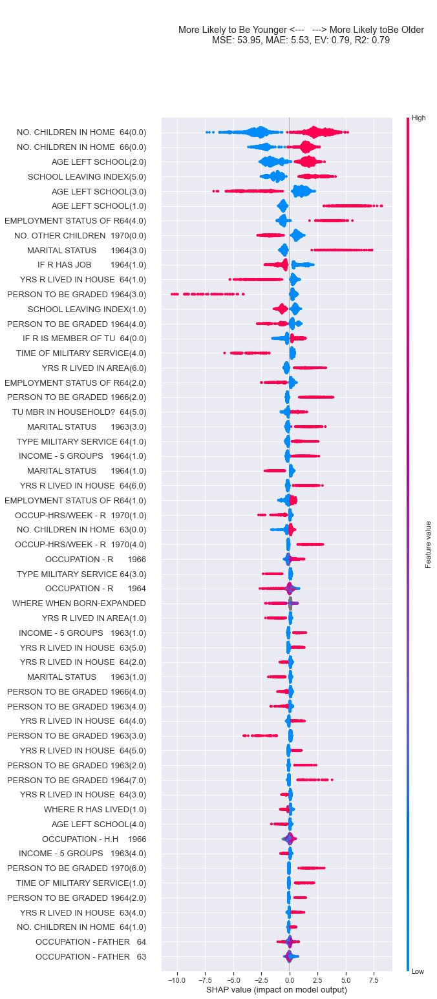

<Figure size 1152x720 with 0 Axes>

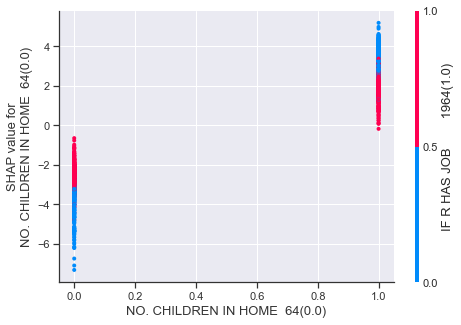

<Figure size 1152x720 with 0 Axes>

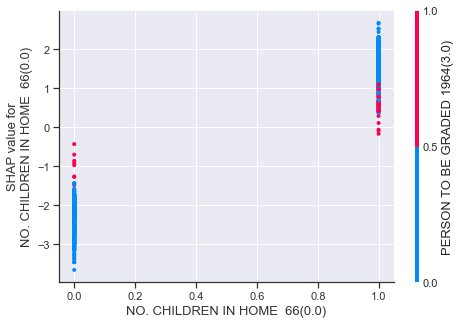

<Figure size 1152x720 with 0 Axes>

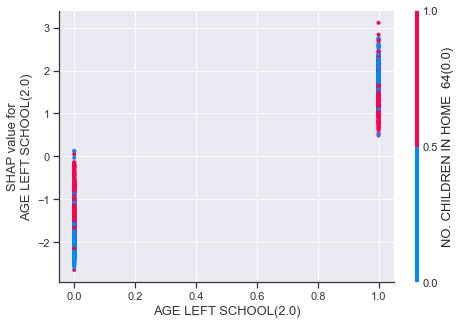

<Figure size 1152x720 with 0 Axes>

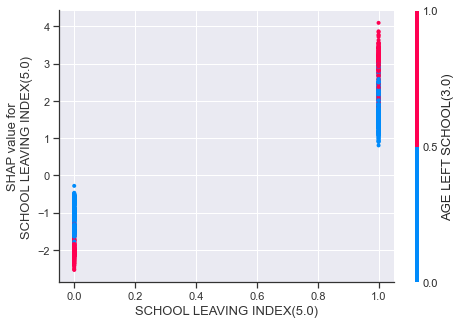

<Figure size 1152x720 with 0 Axes>

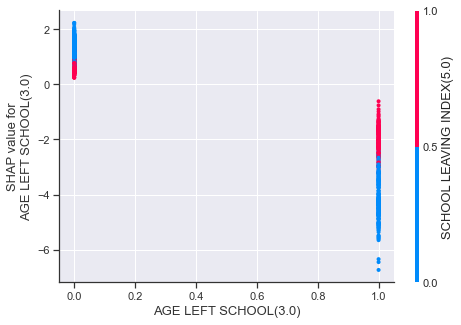

<Figure size 1152x720 with 0 Axes>

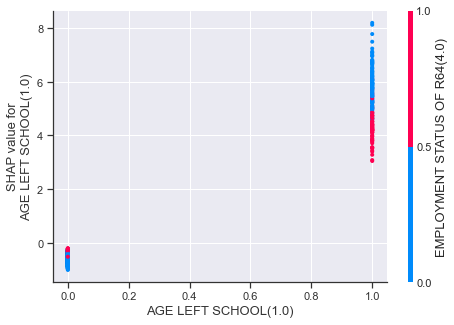

<Figure size 1152x720 with 0 Axes>

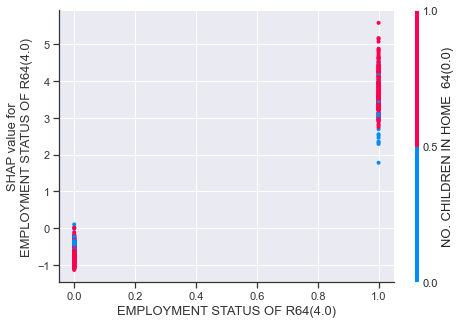

<Figure size 1152x720 with 0 Axes>

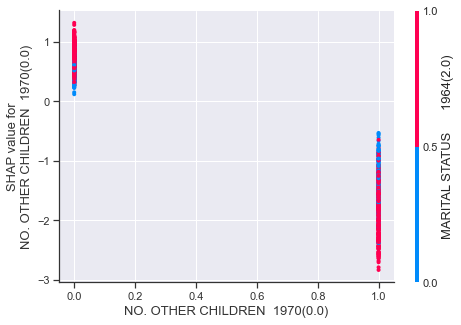

<Figure size 1152x720 with 0 Axes>

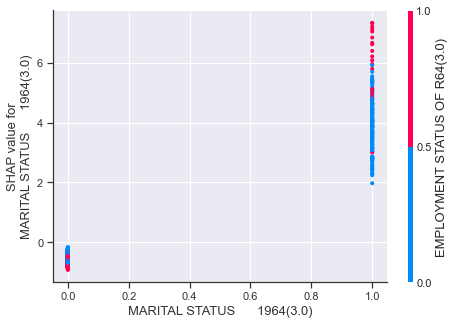

<Figure size 1152x720 with 0 Axes>

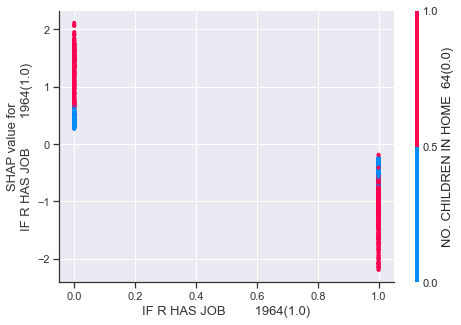

<Figure size 1152x720 with 0 Axes>

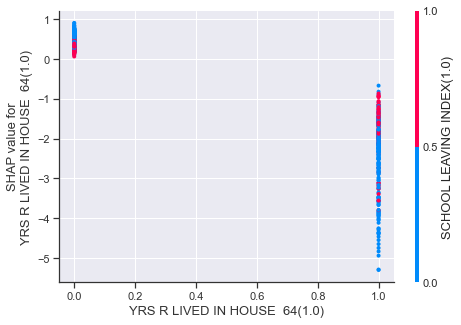

<Figure size 1152x720 with 0 Axes>

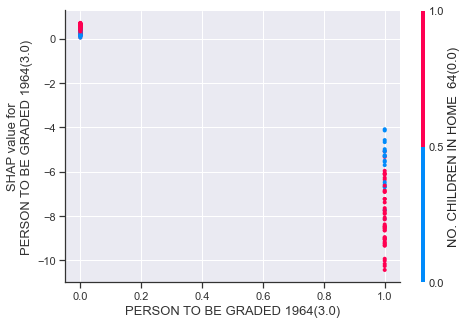

<Figure size 1152x720 with 0 Axes>

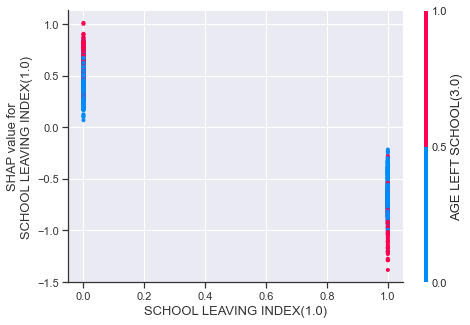

<Figure size 1152x720 with 0 Axes>

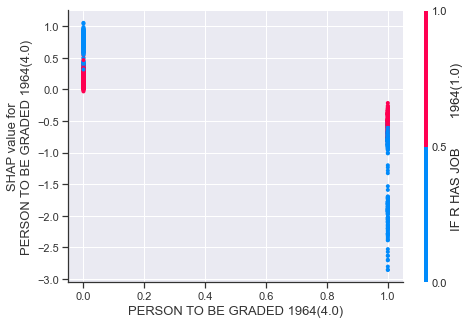

<Figure size 1152x720 with 0 Axes>

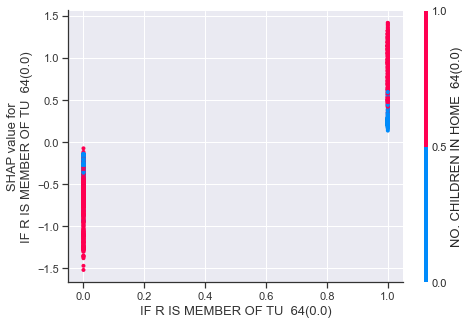

<Figure size 1152x720 with 0 Axes>

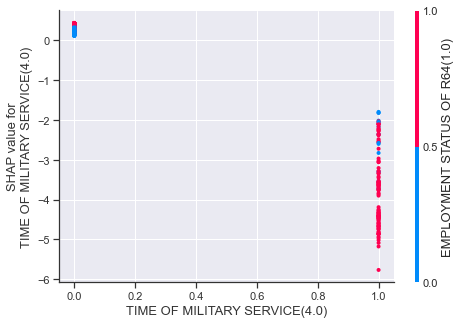

<Figure size 1152x720 with 0 Axes>

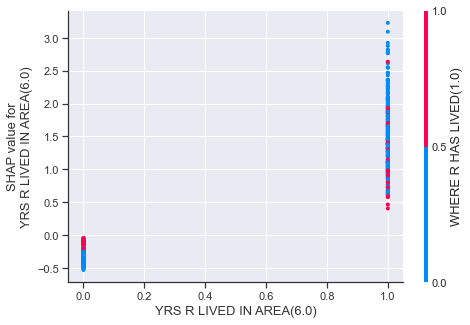

<Figure size 1152x720 with 0 Axes>

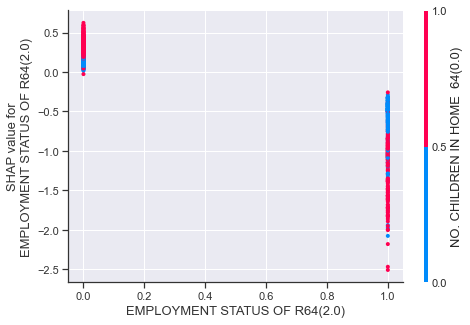

<Figure size 1152x720 with 0 Axes>

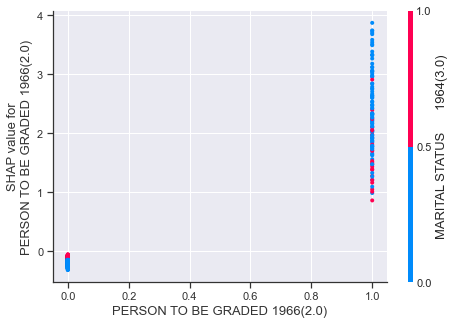

<Figure size 1152x720 with 0 Axes>

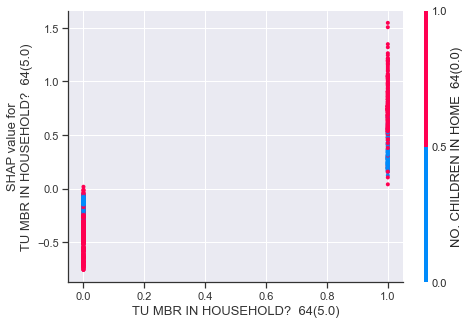

<Figure size 1152x720 with 0 Axes>

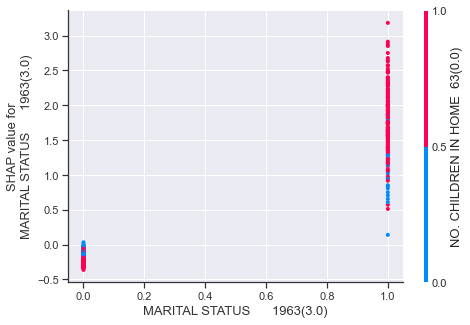

<Figure size 1152x720 with 0 Axes>

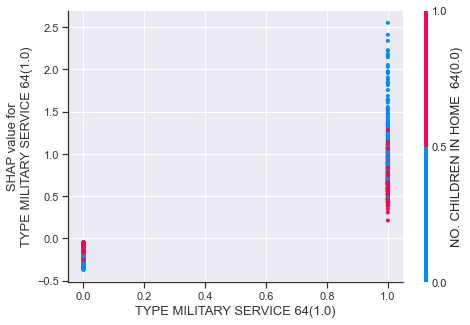

<Figure size 1152x720 with 0 Axes>

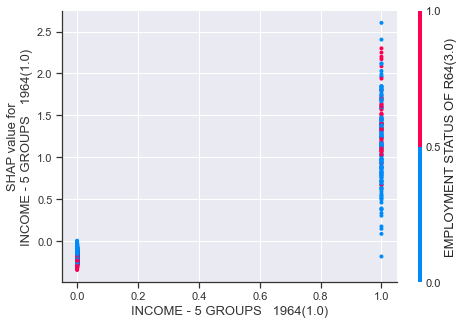

<Figure size 1152x720 with 0 Axes>

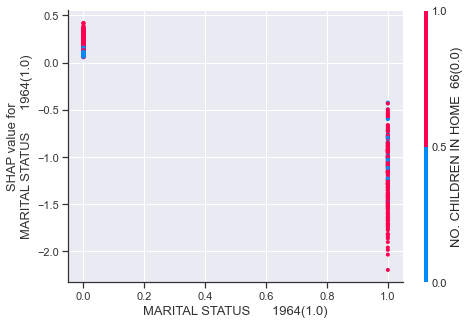

<Figure size 1152x720 with 0 Axes>

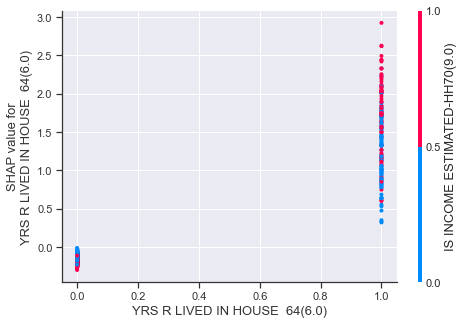

<Figure size 1152x720 with 0 Axes>

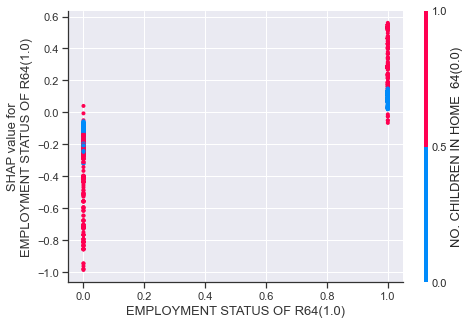

<Figure size 1152x720 with 0 Axes>

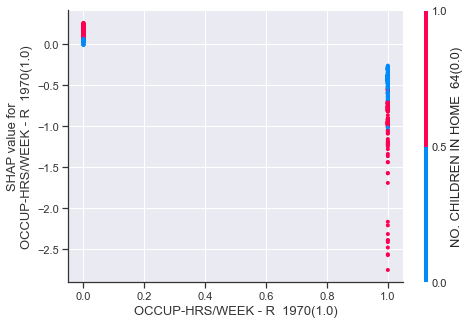

<Figure size 1152x720 with 0 Axes>

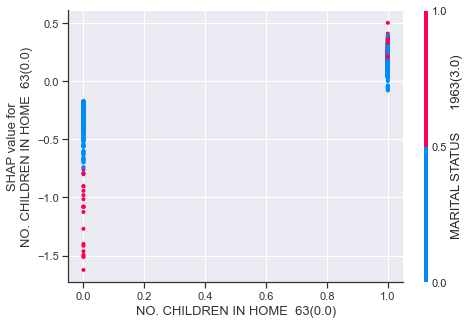

<Figure size 1152x720 with 0 Axes>

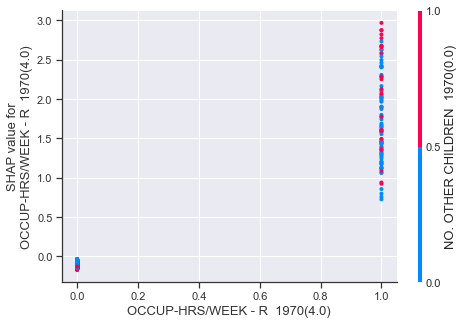

<Figure size 1152x720 with 0 Axes>

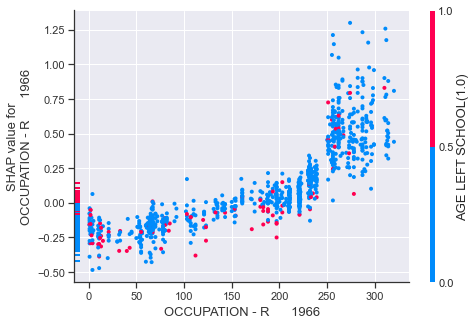

<Figure size 1152x720 with 0 Axes>

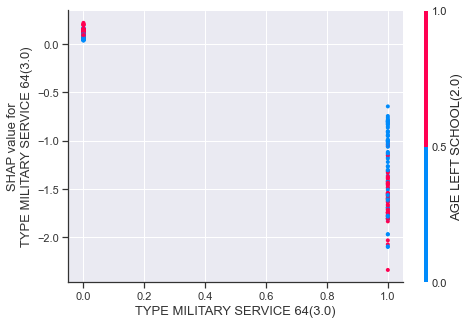

<Figure size 1152x720 with 0 Axes>

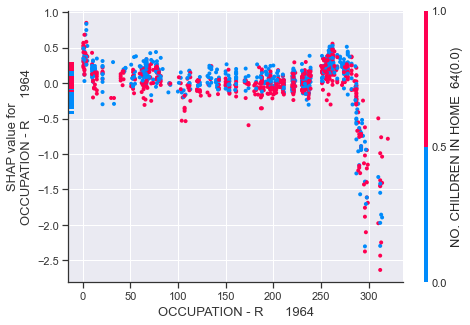

<Figure size 1152x720 with 0 Axes>

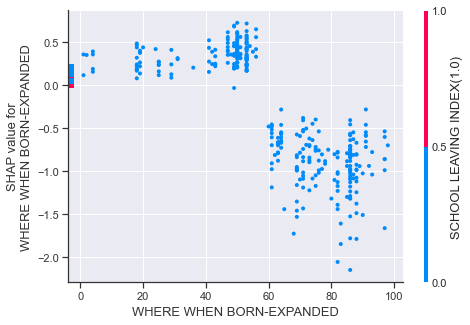

<Figure size 1152x720 with 0 Axes>

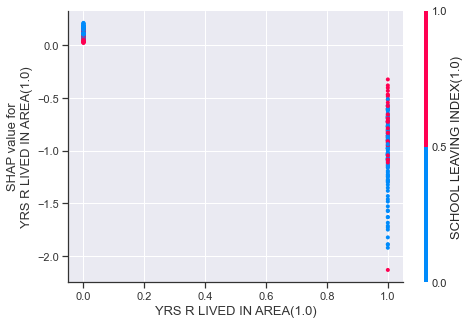

<Figure size 1152x720 with 0 Axes>

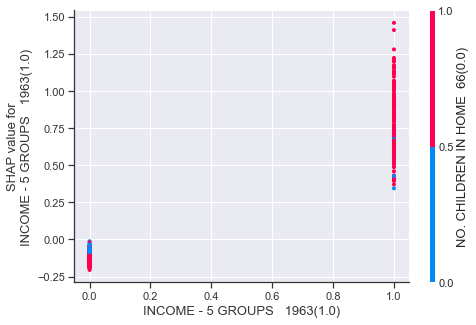

<Figure size 1152x720 with 0 Axes>

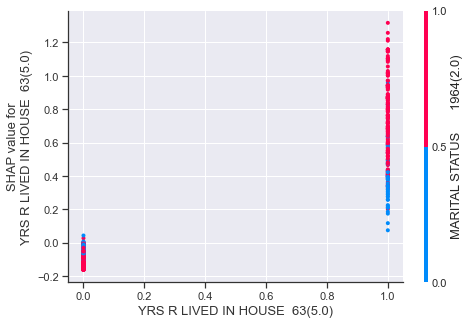

<Figure size 1152x720 with 0 Axes>

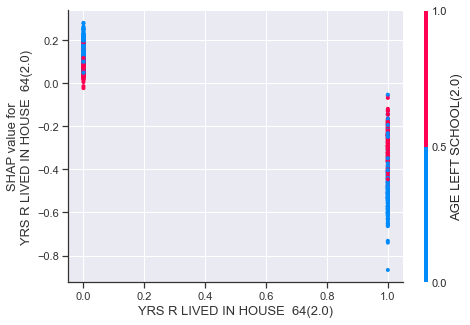

<Figure size 1152x720 with 0 Axes>

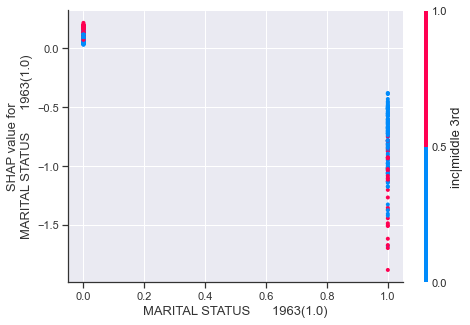

<Figure size 1152x720 with 0 Axes>

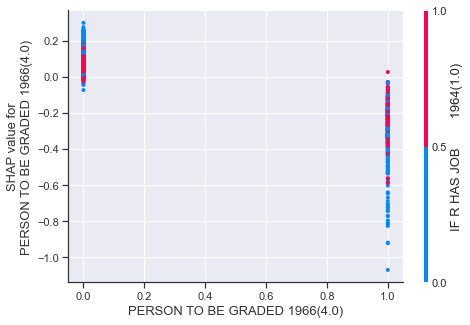

<Figure size 1152x720 with 0 Axes>

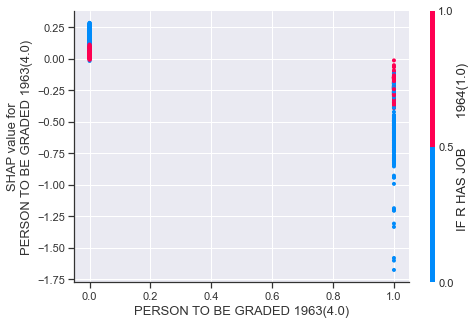

<Figure size 1152x720 with 0 Axes>

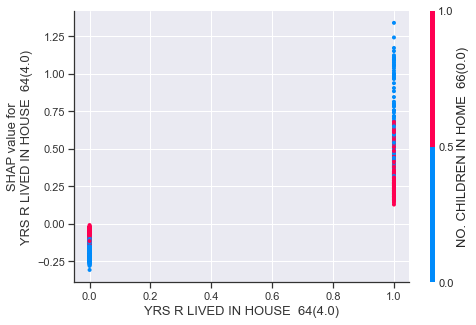

<Figure size 1152x720 with 0 Axes>

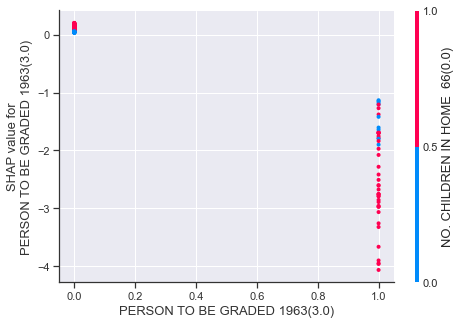

<Figure size 1152x720 with 0 Axes>

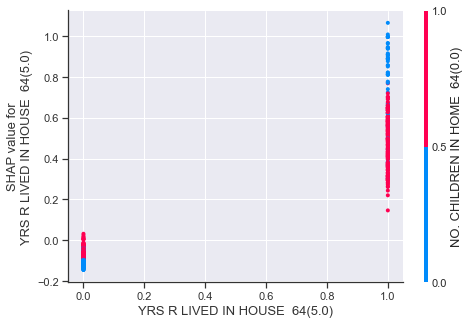

<Figure size 1152x720 with 0 Axes>

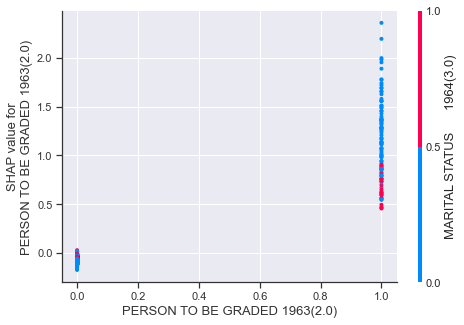

<Figure size 1152x720 with 0 Axes>

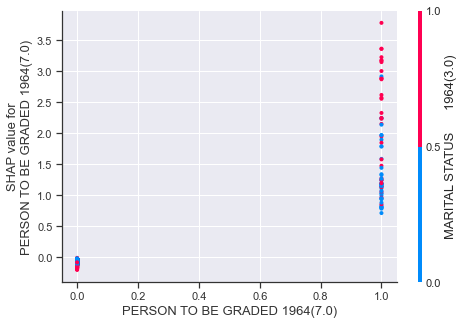

<Figure size 1152x720 with 0 Axes>

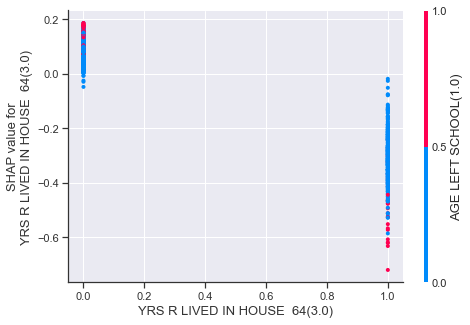

<Figure size 1152x720 with 0 Axes>

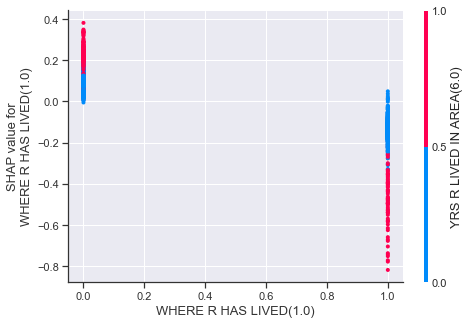

<Figure size 1152x720 with 0 Axes>

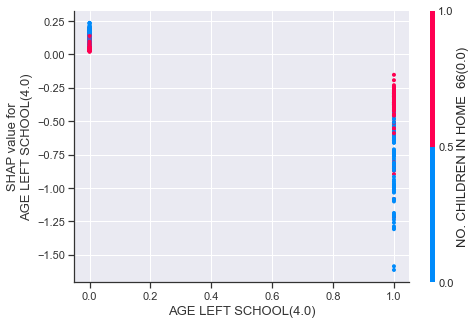

<Figure size 1152x720 with 0 Axes>

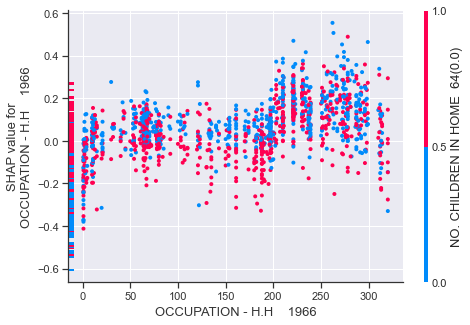

<Figure size 1152x720 with 0 Axes>

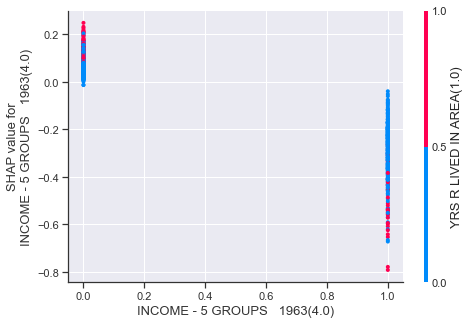

<Figure size 1152x720 with 0 Axes>

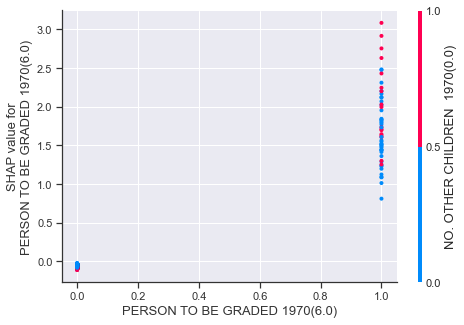

<Figure size 1152x720 with 0 Axes>

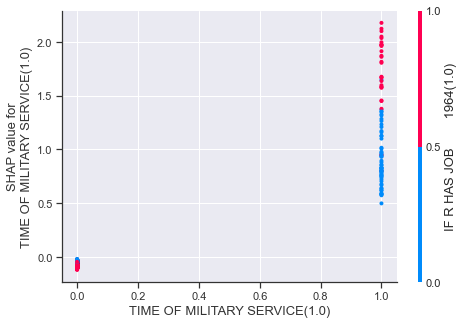

<Figure size 1152x720 with 0 Axes>

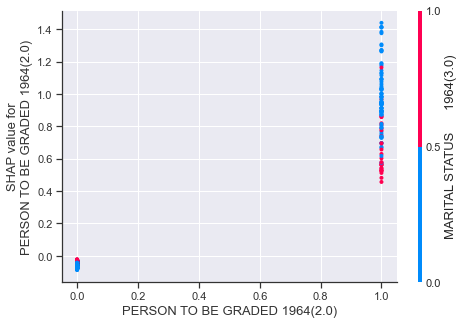

<Figure size 1152x720 with 0 Axes>

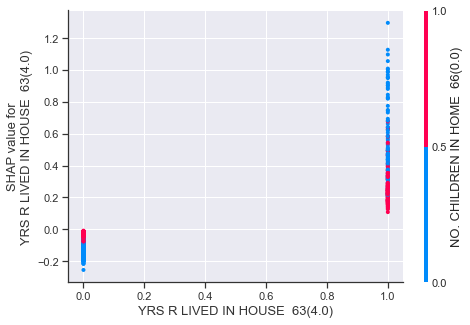

<Figure size 1152x720 with 0 Axes>

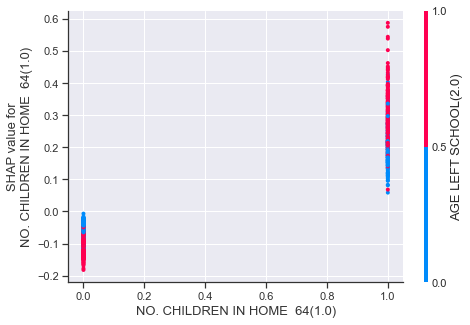

<Figure size 1152x720 with 0 Axes>

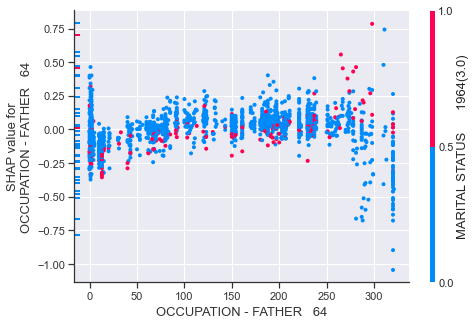

<Figure size 1152x720 with 0 Axes>

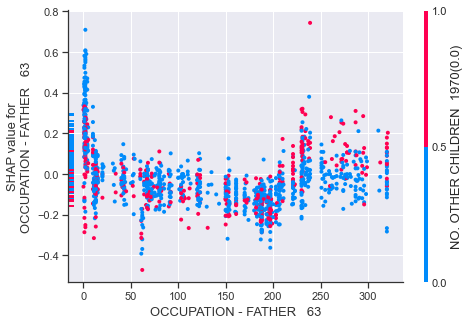

In [322]:
ge = "1964"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "age"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Be Younger","Be Older"]
var_stub = "age"
min_features = 10

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)

# setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)
# use fitted algorithm to predict values
age_pred = alg.predict(df_pred[train_columns])

In [334]:
# mask = df_pred[var_stub].notnull() & df_pred["wt"].notnull()
# colname = var_stub



# (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
#     xgboost_run(subdir=colname,dataset=df_simp[mask].drop("wt",axis=1),
#             var_list=var_list,var_stub_list=var_stub_list,
#             use_specific_weights=df_simp["wt"][mask],
#             min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
#             skip_bar_plot=True,dependence_plots=dependence_plots,

In [421]:
# pd.Series(age_pred).hist(bins = 100)

In [419]:
# ge="1970"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"age"].hist(bins=100)

In [507]:
repl_dict = {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}
vote_59[["v1153","v1154","v1155","v1156"]]=vote_59[["v1153","v1154","v1155","v1156"]].replace(repl_dict)

repl_dict = {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}
vote_59[["v524","v525","v526","v527","v528"]]=vote_59[["v524","v525","v526","v527","v528"]].replace(repl_dict)

repl_dict = {1:"DEF VOTED",2:"PROB VOTED",5:"DNV",6:"TY"}
vote_59[["v521","v522","v523"]]=vote_59[["v521","v522","v523"]].replace(repl_dict)

repl_dict = {1:"CON59:CON63",
 2:"LAB59:LAB63",
 3:"LD59:LD64",
 4:"OTH/TY/DNV59:OTH/DNV63",
 5:"TO-CON/AWAY-LAB",
 6:"TO-LAB/AWAY-CON",
 7:"TO-LD/AWAY-LD",
}
vote_59[["v1168","v1169","v1170"]]=vote_59[["v1168","v1169","v1170"]].replace(repl_dict)

vote_vars_59 = ["v521","v522","v523","v524","v525","v526","v527","v528","v1153","v1154","v1155","v1156","v1168","v1169","v1170"]

In [686]:
# # {k:v for k,v in BES_label_list[ge].items() if "59" in v}

# ## EXTRACT 59 VOTE VARS !

# #521-523 {8/9/0 -> not there/dk/na}
# {1:"DEF VOTED",2:"PROB VOTED",5:"DNV",6:"TY"}
# #524-528 {9/9/0 -> not there/dk/na}
# {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}
# #1153-1156 built from the above *and age* {8/9/0 -> still not there/dk/na}
# #1168-1170 59-63 change of vote {9/0 not there/dk} 4 includes did not vote/too young

# # 1153: 59 vote including prefs
# # 1154: 59 vote
# # 1155: 59 pref
# # 1156: 59 vote (from vote+turnout)
# {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}


# # 1168: vote/intention
# # 1169: same but sampled in 1964
# # 1170: vote/vote
# {1:"CON59:CON63",
#  2:"LAB59:LAB63",
#  3:"LD59:LD64",
#  4:"OTH/TY/DNV59:OTH/DNV63",
#  5:"TO-CON/AWAY-LAB",
#  6:"TO-LAB/AWAY-CON",
#  7:"TO-LD/AWAY-LD",
# }

In [435]:
ge="1964"
replace_dict = {8:np.nan,9:np.nan,0:np.nan}
BES_df_list[ge][[k for k,v in BES_label_list[ge].items() if "59" in v]].replace(replace_dict).notnull().sum()

v521     1961
v522     1776
v523     2014
v524     1519
v525     1383
v526     1494
v527      179
v528      308
v1153    1962
v1154    1752
v1155    1691
v1156    1976
v1168    1953
v1169    1408
v1170    1738
dtype: int64

In [437]:
vote_59 = BES_df_list[ge][[k for k,v in BES_label_list[ge].items() if "59" in v]].replace(replace_dict).copy()

In [445]:
missing = vote_59[["v1153","v1154","v1155","v1156"]].isnull().all(axis=1)

In [447]:
vote_59.loc[missing].notnull().sum()

v521     12
v522      7
v523     14
v524      0
v525      0
v526      0
v527      0
v528      0
v1153     0
v1154     0
v1155     0
v1156     0
v1168     0
v1169     0
v1170     0
dtype: int64

In [532]:
repl_dict = {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}
vote_vars = ["v1153","v1154","v1155","v1156"]
non_pref_votes_only = ["v1154","v1156"]
too_young_present = vote_59[non_pref_votes_only].replace(repl_dict).fillna("nan").apply(lambda x: "TY" in x.values,axis=1)

duets = vote_59[non_pref_votes_only].replace(repl_dict).fillna("nan").apply(lambda x: "|".join([y for y in x if (y!="nan") and (y!="TY")]),axis=1)
# quartets.value_counts().head(50)
anomalies = duets.apply(lambda x:x.split("|")).apply(lambda x: isinstance(x,list) and len(x)==2 and x[0]!=x[1] and x!=["DNV","DNV/NP"])
duets[anomalies&~too_young_present].value_counts()

DNV|LAB       33
LAB|CON       24
CON|LAB       22
DNV|CON       19
LD|CON        15
LAB|DNV/NP    10
CON|DNV/NP    10
LAB|LD         8
CON|LD         7
DNV|LD         7
LD|LAB         5
LD|DNV/NP      1
OTH|LAB        1
dtype: int64

In [537]:
duet_repl_dict = {"DNV|LAB":"DNV","DNV|CON":"DNV","LD|CON":"CON","LAB|DNV/NP":"DNV","CON|DNV/NP":"DNV","LAB|LD":"LAB","CON|LD":"CON",
"DNV|LD":"DNV","LD|LAB":"LAB","LD|DNV/NP":"DNV","OTH|LAB":"LAB",
"LAB|CON":"LAB","CON|LAB":"CON","CON|CON":"CON","LAB|LAB":"LAB","LD|LD":"LD","DNV/NP":"DNV","DNV|DNV/NP":"DNV","OTH|OTH":"OTH"}


# justified looking at 'turnover' answers - people seem to be retroactively changing their vote


In [538]:
duets.replace(duet_repl_dict).value_counts()

CON    877
LAB    830
DNV    599
       530
LD      83
OTH      3
dtype: int64

In [567]:
vote_59_harm = duets.replace(duet_repl_dict).replace("",np.nan)
vote_59_harm[vote_59_harm.isnull()] = vote_59[vote_59_harm.isnull()][["v1153","v1155"]].fillna("nan").apply(lambda x: "|".join([y for y in x if (y!="nan")]),axis=1).replace(duet_repl_dict)
vote_59_harm.loc[too_young_present] = "TY"
vote_59_harm.loc[~too_young_present][(age_1959[~too_young_present]<19)] = "TY"
vote_59_harm.loc[(vote_59_harm=="") & (vote_59.isnull().all(axis=1))]= "DK"
vote_59_harm.loc[(vote_59_harm=="") & (vote_59.notnull().any(axis=1))]= "VOTED"

In [568]:
vote_59_harm.value_counts()

CON      1007
LAB       975
DNV       559
TY        224
LD         99
DK         28
VOTED      27
OTH         3
dtype: int64

In [ ]:

# BES_df_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_df_list.pickle", "rb" ) )
# f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')
# BES_label_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_label_list.pickle", "rb" ) )

In [602]:
BES_df_list["1959"] = BES_df_list["1964"].copy()
BES_label_list["1959"] = BES_label_list["1964"].copy()

temp = f2f_harmonised[f2f_harmonised["dataset"]=="1964"].copy()
temp["dataset"]="1959"
temp["uid"]=temp["uid"].apply(lambda x: "1959|"+x.split("|")[1])
temp["vote"]=vote_59_harm
temp["vote_simple"]=vote_59_harm.replace({"TY":np.nan,"DK":np.nan,"VOTED":np.nan})
temp["year"]=1959
temp["wt"] = vote_59_harm.replace({"CON":1,"LAB":1,"DNV":1,"TY":0,"LD":1,"DK":0,"VOTED":1,"OTH":1})
temp["bloc"] = temp["vote_simple"].replace({"CON":"Right-Auth","LAB":"Left-Lib","LD":"Left-Lib","DNV":"Neither","OTH":"Neither"})
temp["age"] = temp["age"]-5
temp["harmonised_voted"] = vote_59_harm.replace({"CON":1,"LAB":1,"DNV":0,"TY":np.nan,"LD":1,"DK":np.nan,"VOTED":1,"OTH":1})

f2f_harmonised = f2f_harmonised.append(temp)

import pickle
pickle.dump( BES_label_list, open( "E:\\BES_analysis_data\\Face_to_face\\BES_label_list.pickle", "wb" ) )
pickle.dump( BES_df_list, open( "E:\\BES_analysis_data\\Face_to_face\\BES_df_list.pickle", "wb" ) )

f2f_harmonised.to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')


In [681]:
f2f_harmonised.loc[(f2f_harmonised["dataset"]=="1959")&(f2f_harmonised["harmonised_voted"]!=1)&(f2f_harmonised["age"]<=20),"vote"]="TY"
f2f_harmonised.loc[(f2f_harmonised["dataset"]=="1959")&(f2f_harmonised["harmonised_voted"]!=1)&(f2f_harmonised["age"]<=20),"vote_simple"]=np.nan
f2f_harmonised.loc[(f2f_harmonised["dataset"]=="1959")&(f2f_harmonised["harmonised_voted"]!=1)&(f2f_harmonised["age"]<=20),"bloc"]=np.nan
f2f_harmonised.loc[(f2f_harmonised["dataset"]=="1959")&(f2f_harmonised["harmonised_voted"]!=1)&(f2f_harmonised["age"]<=20),"harmonised_voted"]=np.nan
f2f_harmonised.to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')

In [680]:
demo_var_dict["1959"] = demo_var_dict["1964"].copy()
var_type_dict_nonans['1959'] = var_type_dict_nonans['1964'].copy()

pickle.dump( demo_var_dict, open( "E:\\BES_analysis_data\\Face_to_face\\demo_var_dict.pickle", "wb" ) )
pickle.dump( var_type_dict_nonans, open( "E:\\BES_analysis_data\\Face_to_face\\var_type_dict_nonans.pickle", "wb" ) )

In [ ]:
### last save point

In [6]:
import pickle
BES_label_list = pickle.load(  open( "E:\\BES_analysis_data\\Face_to_face\\BES_label_list.pickle", "rb" ) )
BES_df_list  = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_df_list.pickle", "rb" ) )

f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')

demo_var_dict = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\demo_var_dict.pickle", "rb" ) )
var_type_dict_nonans = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\var_type_dict_nonans.pickle", "rb" ) )

In [12]:
age_drop_vars = ['v937','v938',
 'v939',
 'v940',
 'v941',
 'v942',
 'v943',
 'v944',
 'v945',
 'v1208',
 'v1209',
 'v1210',
 'v1211',
 'v1212',
 'v1213']

MSE: 0.19, MAE: 0.38, EV: 0.24, R2: 0.24


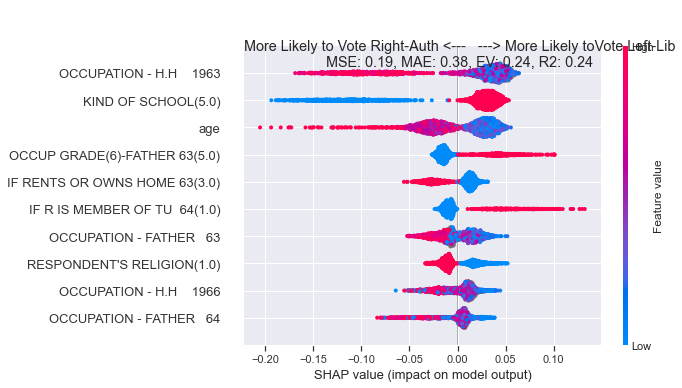

<Figure size 1152x720 with 0 Axes>

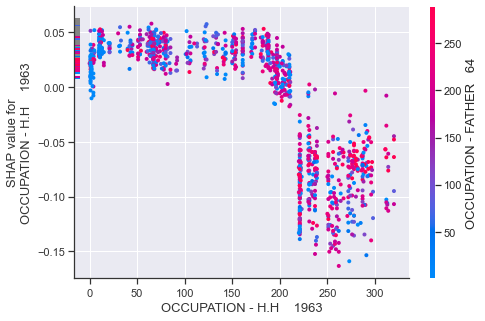

<Figure size 1152x720 with 0 Axes>

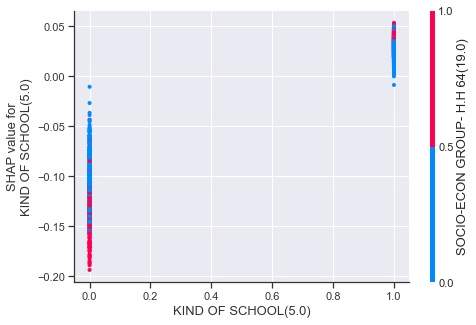

<Figure size 1152x720 with 0 Axes>

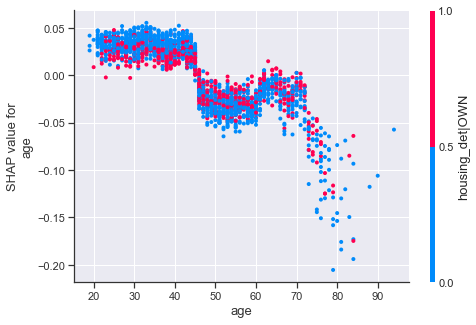

<Figure size 1152x720 with 0 Axes>

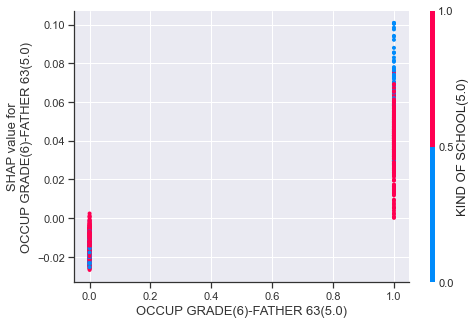

<Figure size 1152x720 with 0 Axes>

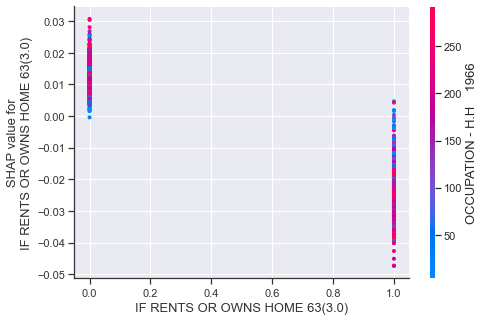

<Figure size 1152x720 with 0 Axes>

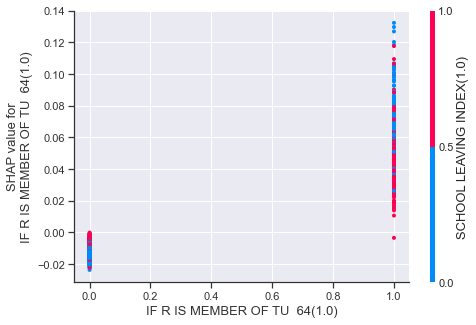

<Figure size 1152x720 with 0 Axes>

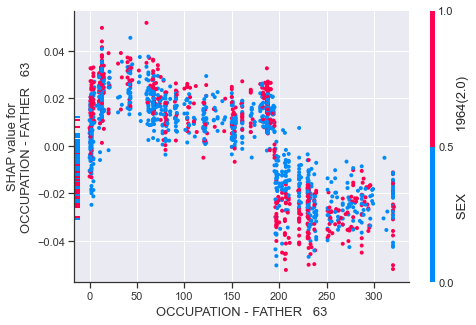

<Figure size 1152x720 with 0 Axes>

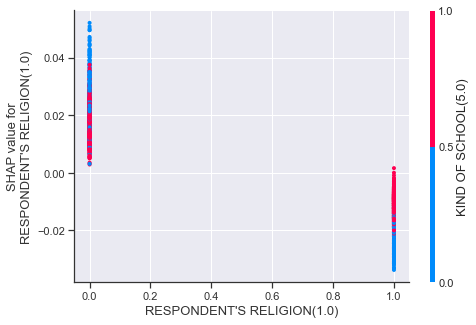

<Figure size 1152x720 with 0 Axes>

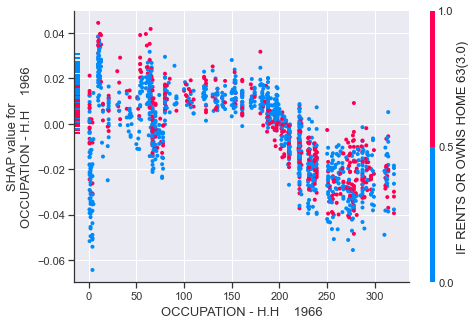

<Figure size 1152x720 with 0 Axes>

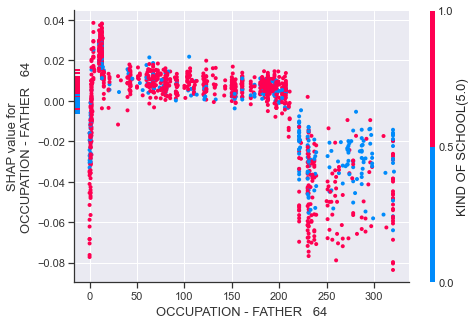

In [14]:
ge="1959"
harm_vars = ["bloc","wt","age","housing_det","inc"]
target_var = "bloc"
target_var_replace_dict = {"Neither":np.nan}
target_var_drop_list = ["bloc|Right-Auth"]
target_var_title_pair = ["Vote Right-Auth","Vote Left-Lib"]
var_stub = "bloc|Left-Lib"
min_features = 10

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)

MSE: 0.12, MAE: 0.25, EV: 0.11, R2: 0.11


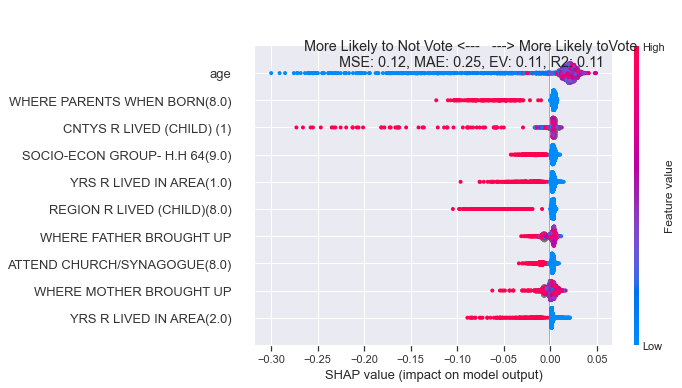

<Figure size 1152x720 with 0 Axes>

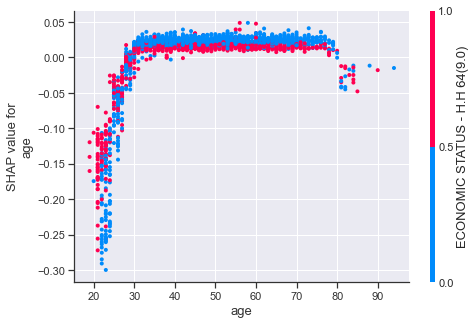

<Figure size 1152x720 with 0 Axes>

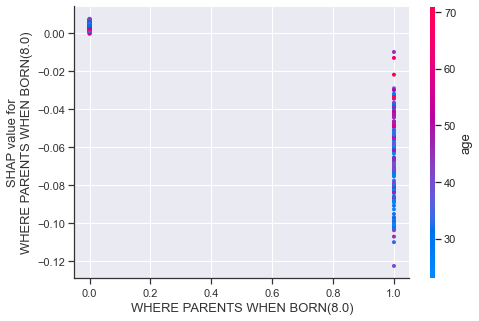

<Figure size 1152x720 with 0 Axes>

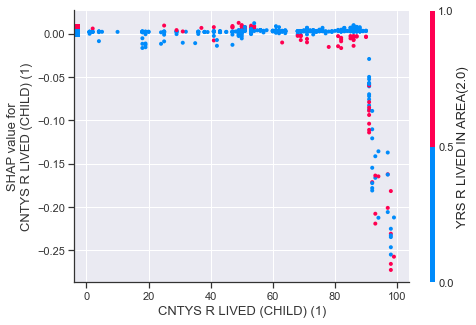

<Figure size 1152x720 with 0 Axes>

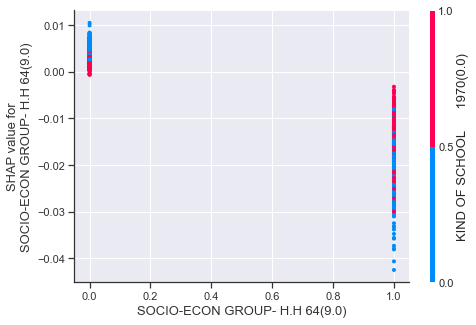

<Figure size 1152x720 with 0 Axes>

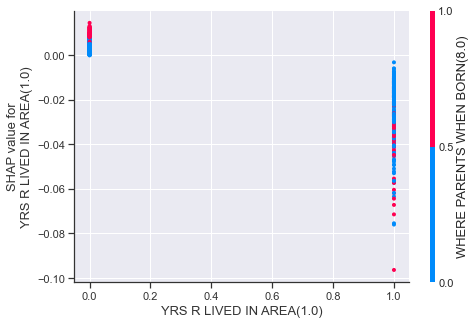

<Figure size 1152x720 with 0 Axes>

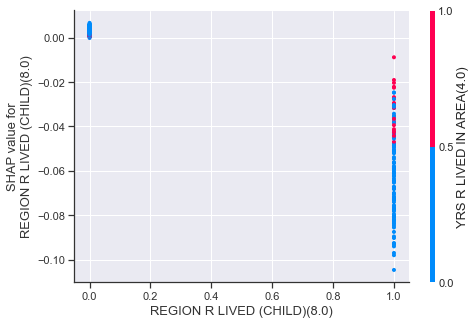

<Figure size 1152x720 with 0 Axes>

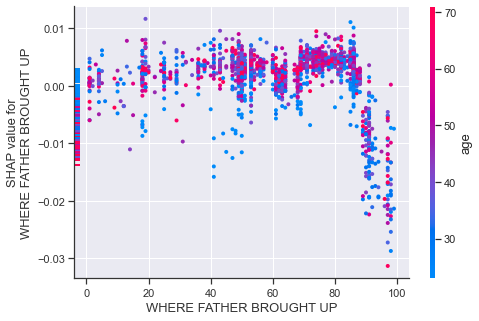

<Figure size 1152x720 with 0 Axes>

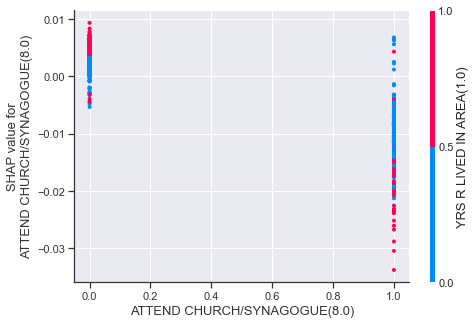

<Figure size 1152x720 with 0 Axes>

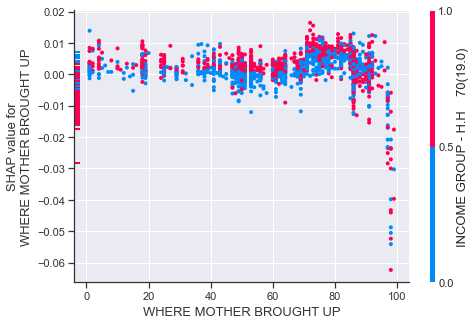

<Figure size 1152x720 with 0 Axes>

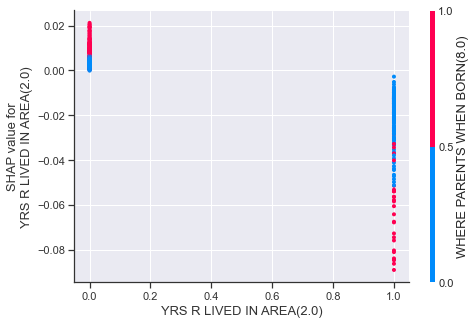

In [15]:
ge="1959"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "harmonised_voted"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Not Vote","Vote"]
var_stub = "harmonised_voted"
min_features = 10

# prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
#        var_stub,harm_vars,min_features,dependence_plots=True)
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)

In [16]:
f2f_harmonised[f2f_harmonised["dataset"]=="1959"].isnull().sum()

dataset                0
uid                    0
housing_det         1112
housing             1112
inc                 1337
vote                   0
year                   0
wt                     0
age                    0
vote_simple          477
bloc                 477
birth_year          1095
harmonised_voted     450
dtype: int64

In [17]:
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)


In [18]:
df_pred[search(df_pred,"housing_det").index].sum()

housing_det|OTH          73.0
housing_det|OWN         844.0
housing_det|RENT-LA     499.0
housing_det|RENT-PR     394.0
housing_det|nan        1112.0
dtype: float64

In [19]:
mask = df_pred["housing_det|nan"]!=1

df_pred[mask].corrwith(df_pred["housing_det|RENT-PR"][mask]).dropna().sort_values().head(50)

housing_det|OWN                  -0.493059
IF RENTS OR OWNS HOME 64(3.0)    -0.493059
IF RENTS OR OWNS HOME 63(3.0)    -0.337569
IF RENTS OR OWNS HOME 64(1.0)    -0.325436
housing_det|RENT-LA              -0.325436
IF RENTS OR OWNS HOME 63(1.0)    -0.204808
IF RENTS OR OWNS HOME 70(3.0)    -0.192013
OCCUPATION - HUSBAND  70         -0.138546
OCCUPATION - H.H    1970         -0.118117
IF RENTS OR OWNS HOME 70(1.0)    -0.111772
inc|upper 3rd                    -0.109888
housing_det|OTH                  -0.108138
IF RENTS OR OWNS HOME 64(4.0)    -0.108138
INCOME - 5 GROUPS   1964(5.0)    -0.102517
INCOME - 5 GROUPS   1963(5.0)    -0.101042
INCOME - 5 GROUPS   1970(5.0)    -0.097535
YRS R LIVED IN HOUSE  64(3.0)    -0.097452
INCOME GROUP - H.H    70(13.0)   -0.096625
YRS R LIVED IN HOUSE  70(4.0)    -0.096076
EXPECT TO MOVE NXT YR 70(5.0)    -0.090546
wt                               -0.090156
OCCUPATION - R      1970         -0.089494
SOCIO-ECON GROUP- H.H 64(2.0)    -0.086500
NO. CHILDRE

In [20]:
#"housing_det|OWN"

# housing_det|nan                  -0.499530
# YRS R LIVED IN HOUSE  64(0.0)    -0.493881
# PERSON TO BE GRADED 1964(0.0)    -0.493519
# SOCIO-ECON GRP-FATHER 64(19.0)   -0.493025
# ECONOMIC STATUS - R 1964(9.0)    -0.493025
# OCCUP GRADE(6) - R  1964(9.0)    -0.493025
# IF RENTS OR OWNS HOME 64(8.0)    -0.493025
# IF R IS MEMBER OF TU  64(8.0)    -0.493025
# SEX                 1964(0.0)    -0.493025
# TYPE MILITARY SERVICE 64(9.0)    -0.493025
# IS INCOME ESTIMATED-R 64(9.0)    -0.493025
# INCOME - 5 GROUPS   1964(9.0)    -0.493025
# URBAN/RURAL CODE    1964(0.0)    -0.493025
# ECONOMIC STATUS - H.H 64(9.0)    -0.493025
# SIZE TOWN FATHER FROM 64(9.0)    -0.493025
# INCOME GROUP - H.H    64(19.0)   -0.493025
# REGION              1964(0.0)    -0.493025
# OCCUPATION GRADE- H.H 64(9.0)    -0.493025
# IS INCOME ESTIMATED-HH64(9.0)    -0.493025
# TYPE OF CONSTITUENCY  64(0.0)    -0.493025
# ECON STATUS - FATHER  64(9.0)    -0.493025
# TU MBR IN HOUSEHOLD?  64(8.0)    -0.493025
# EMPLOYMENT STATUS OF R64(9.0)    -0.493025
# SOCIO-ECON GROUP - R  64(19.0)   -0.493025
# SIZE OF PLACE R LIVED 64(9.0)    -0.493025
# SOCIO-ECON GROUP- H.H 64(19.0)   -0.493025
# MINING/RESORT/AGRIC   64(0.0)    -0.493025
# OCCUP GRADE(7)-FATHER 64(9.0)    -0.493025
# MARITAL STATUS      1964(9.0)    -0.493025
# INCOME GROUP - R    1964(19.0)   -0.493025
# SIZE OF PLACE OF BIRTH64(9.0)    -0.493025
# IF R HAS JOB        1964(9.0)    -0.493025
# SIZE TOWN MOTHER FROM 64(9.0)    -0.493025

# OCCUP GRADE(7)-FATHER 66(0.0)     0.301719
# ECON STATUS - FATHER  66(0.0)     0.302144
# SOCIO-ECON GRP-FATHER 66(0.0)     0.303419
# RESIDENTIAL MOBILITY  66(0.0)     0.306826
# INCOME - 5 GROUPS   1964(5.0)     0.328732
# IS INCOME ESTIMATED-HH64(2.0)     0.344093
# TYPE MILITARY SERVICE 64(0.0)     0.354802
# inc|upper 3rd                     0.372363
# IF RENTS OR OWNS HOME 70(3.0)     0.374663
# SIZE OF PLACE OF BIRTH64(0.0)     0.381613
# MINING/RESORT/AGRIC   64(4.0)     0.383746
# SIZE OF PLACE R LIVED 64(0.0)     0.387026
# MARITAL STATUS      1964(2.0)     0.389567
# IF RENTS OR OWNS HOME 63(3.0)     0.603227
# housing_det|OWN                   1.000000
# IF RENTS OR OWNS HOME 64(3.0)     1.000000

In [21]:
# IF RENTS OR OWNS HOME

In [22]:
{k:v for k,v in BES_label_list["1959"].items() if "RENTS OR OWNS" in v}

{'v915': 'IF RENTS OR OWNS HOME 63',
 'v916': 'IF RENTS OR OWNS HOME 64',
 'v917': 'IF RENTS OR OWNS HOME 70'}

In [23]:
## EXPECT TO MOVE, WHERE MOVING TO, YEARS R LIVED IN HOUSE, YRS R LIVED IN AREA, RESIDENTIAL MOBILITY, R NOW LIVES

In [24]:
BES_df_list["1959"][['v915','v916','v917']].stack().value_counts()

# 8: not interviewed in a year
# 0: 'na'


8.0    3574
3.0    2416
1.0    1453
2.0    1092
4.0     171
0.0      60
dtype: int64

In [25]:
BES_df_list["1959"][['v915','v916','v917']].replace({0:np.nan,8:np.nan}).isnull().all(axis=1).sum()

291

In [26]:
BES_df_list["1959"][['v915','v916','v917']].replace({0:np.nan,8:np.nan}).diff(axis=1).stack().value_counts()

 0.0    2027
 1.0     150
-1.0     109
 2.0      44
-2.0      28
 3.0       8
-3.0       4
dtype: int64

In [27]:
BES_df_list["1959"][['v915','v916','v917']].replace({0:np.nan,8:np.nan}).fillna(method='ffill',axis=1).fillna(method='bfill',axis=1).apply(lambda x: "|".join([str(y) for y in x.values]),axis=1).value_counts()

# 1: rent-la, 2:rent-pr, 3:own/mort, 4:other
# private rent most 'transitional' state

# constant
# 2->3
# 2->1
# 1->2
# 1->3
# 3->2

housing_vars = BES_df_list["1959"][['v915','v916','v917']].replace({0:np.nan,8:np.nan}).fillna(method='ffill',axis=1).fillna(method='bfill',axis=1).copy()

In [28]:
housing_vars.isnull().all(axis=1).sum()

291

In [29]:
housing_vars["v917"]

0       1.0
1       3.0
2       2.0
3       3.0
4       1.0
       ... 
2917    NaN
2918    NaN
2919    NaN
2920    1.0
2921    NaN
Name: v917, Length: 2922, dtype: float64

In [30]:
backup_housing_det_1964 = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","housing_det"].copy()

In [31]:
backup_housing_det_1964.value_counts(dropna=False)

NaN        1112
OWN         844
RENT-LA     499
RENT-PR     394
OTH          73
Name: housing_det, dtype: int64

In [32]:
housing_vars["v916"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"}).value_counts(dropna=False)

OWN        1211
RENT-LA     718
RENT-PR     599
NaN         291
OTH         103
Name: v916, dtype: int64

In [33]:
housing_vars = housing_vars.rename(columns = {"v915":"1963","v916":"1964","v917":"1970"})
housing_vars["1966"] = np.nan
housing_vars["1959"] = np.nan
# in this order, so that 1964 values have priority over 1970 values!
housing_vars = housing_vars[["1959","1963","1964","1966","1970"]].fillna(method='ffill',axis=1).fillna(method='bfill',axis=1).copy()


In [34]:
# housing_vars["v916"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"}).value_counts(dropna=False)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","housing_det"] = housing_vars["1959"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","housing_det"] = housing_vars["1964"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","housing_det"] = housing_vars["1966"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","housing_det"] = housing_vars["1970"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})

In [35]:
# housing_vars["v916"].index#,
# f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","housing_det"].index

ACC: 0.60,  F1: 0.60


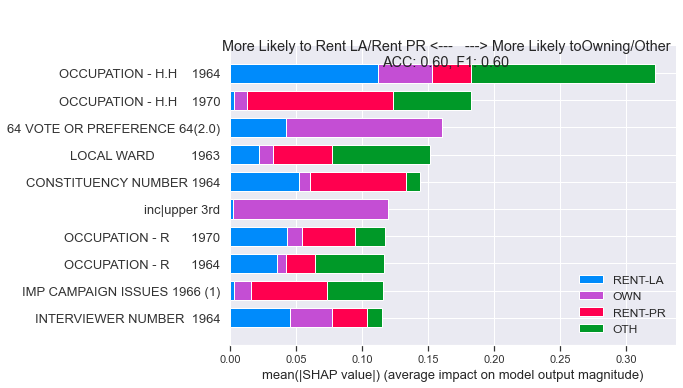

Wall time: 2min 11s


In [136]:
%%time
ge = "1964"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "housing_det"
target_var_replace_dict = {}
target_var_drop_list = ["housing_det|nan"]
target_var_title_pair = ["Rent LA/Rent PR","Owning/Other"]
var_stub = "housing_det"
min_features = 10
drop_vars = ['v915','v916','v917']
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


alg = get_xgboost_alg(classification_problem=True)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
house_pred = alg.predict(df_pred[train_columns])

ACC: 0.56,  F1: 0.56


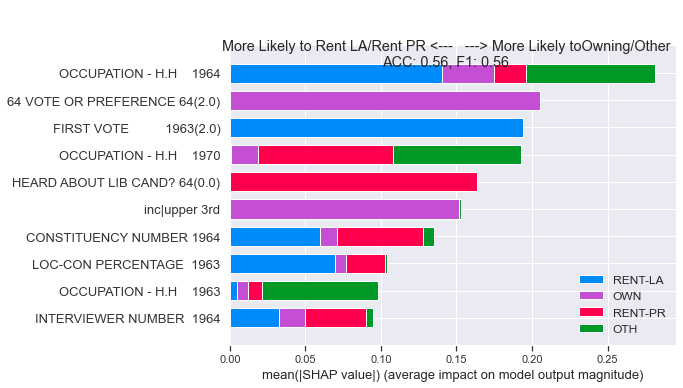

Wall time: 33.9 s


In [137]:
%%time
ge = "1964"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "housing_det"
target_var_replace_dict = {}
target_var_drop_list = ["housing_det|nan"]
target_var_title_pair = ["Rent LA/Rent PR","Owning/Other"]
var_stub = "housing_det"
min_features = 10
drop_vars = ['v915','v916','v917']
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
house_pred = alg.predict(df_pred[train_columns])

housing_vars.loc[housing_vars["1964"].isnull(),"1964"] = pd.Series(house_pred,index=housing_vars.index)[housing_vars["1964"].isnull()]


ACC: 0.56,  F1: 0.56


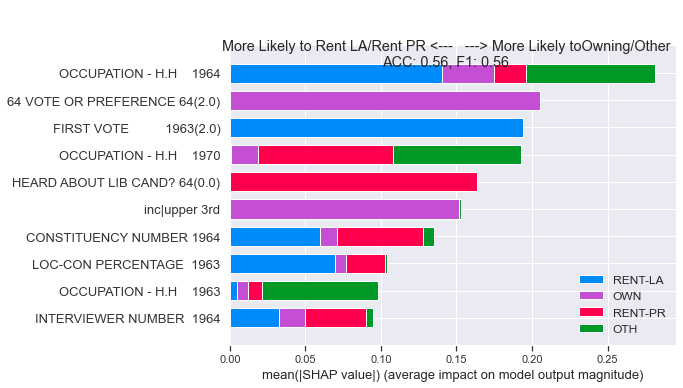

Wall time: 34.4 s


In [138]:
%%time
ge = "1964"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "housing_det"
target_var_replace_dict = {}
target_var_drop_list = ["housing_det|nan"]
target_var_title_pair = ["Rent LA/Rent PR","Owning/Other"]
var_stub = "housing_det"
min_features = 10
drop_vars = ['v915','v916','v917']
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
house_pred = alg.predict(df_pred[train_columns])

housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


ACC: 0.53,  F1: 0.53


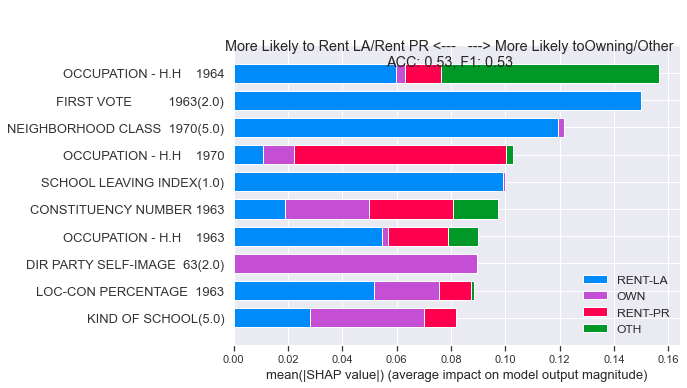

Wall time: 43.2 s


In [139]:
%%time
ge = "1959"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "housing_det"
target_var_replace_dict = {}
target_var_drop_list = ["housing_det|nan"]
target_var_title_pair = ["Rent LA/Rent PR","Owning/Other"]
var_stub = "housing_det"
min_features = 10
drop_vars = ['v915','v916','v917']
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
house_pred = alg.predict(df_pred[train_columns])

housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


ACC: 0.54,  F1: 0.54


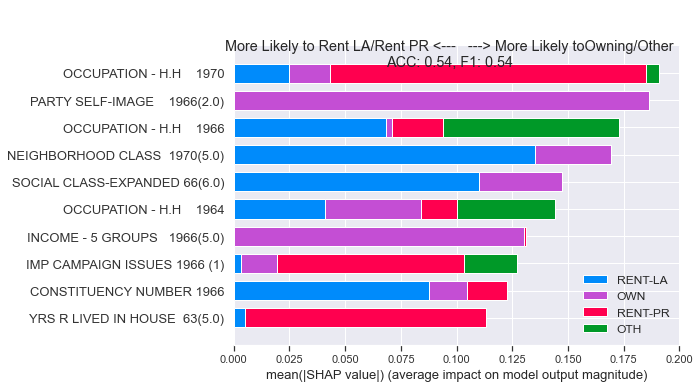

Wall time: 34.6 s


In [140]:
%%time
ge = "1966"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "housing_det"
target_var_replace_dict = {}
target_var_drop_list = ["housing_det|nan"]
target_var_title_pair = ["Rent LA/Rent PR","Owning/Other"]
var_stub = "housing_det"
min_features = 10
drop_vars = ['v915','v916','v917']
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
house_pred = alg.predict(df_pred[train_columns])

housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


ACC: 0.58,  F1: 0.58


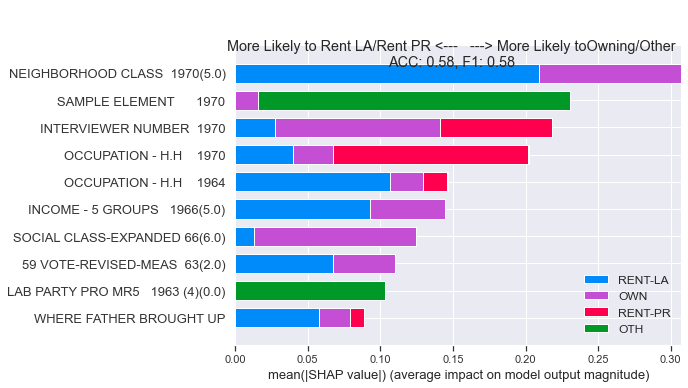

Wall time: 31.8 s


In [141]:
%%time
ge = "1970"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted"]
target_var = "housing_det"
target_var_replace_dict = {}
target_var_drop_list = ["housing_det|nan"]
target_var_title_pair = ["Rent LA/Rent PR","Owning/Other"]
var_stub = "housing_det"
min_features = 10
drop_vars = ['v915','v916','v917']
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
house_pred = alg.predict(df_pred[train_columns])

housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


In [142]:
housing_vars.isnull().sum()

1959      0
1963    291
1964      0
1966      0
1970      0
dtype: int64

In [143]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","housing_det"] = housing_vars["1959"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","housing_det"] = housing_vars["1964"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","housing_det"] = housing_vars["1966"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","housing_det"] = housing_vars["1970"].replace({1:"RENT-LA",2:"RENT-PR",3:"OWN",4:"OTH"})

In [144]:
# BES_df_list[ge]
{k:v for k,v in BES_label_list[ge].items() if "LOCAL ELECTION VOTE 1963" in v}

{'v545': 'LOCAL ELECTION VOTE 1963',
 'v1236': 'LOCAL ELECTION VOTE 1963 IF ELEC'}

In [145]:
### BUG FIX!!!
## repeated variable label name, even though 2nd instance not identical because include cat for 'no election'
# {'v545': 'LOCAL ELECTION VOTE 1963', 'v1236': 'LOCAL ELECTION VOTE 1963'}
BES_label_list["1959"]["v1236"] = 'LOCAL ELECTION VOTE 1963 IF ELEC'
BES_label_list["1964"]["v1236"] = 'LOCAL ELECTION VOTE 1963 IF ELEC'
BES_label_list["1966"]["v1236"] = 'LOCAL ELECTION VOTE 1963 IF ELEC'
BES_label_list["1970"]["v1236"] = 'LOCAL ELECTION VOTE 1963 IF ELEC'

In [146]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","birth_year"] = 1959 - f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","age"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","birth_year"] = 1964 - f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","age"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","birth_year"] = 1966 - f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","age"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","birth_year"] = 1970 - f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","age"]

In [147]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","housing"].value_counts()

RENT    1346
OWN     1188
OTH       97
Name: housing, dtype: int64

In [148]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","housing"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","housing_det"].replace({"RENT-LA":"RENT","RENT-PR":"RENT","OWN":"OWN","OTH":"OTH"})

In [149]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959"].isnull().sum()

dataset                0
uid                    0
housing_det            0
housing                0
inc                 1337
vote                   0
year                   0
wt                     0
age                    0
vote_simple          477
bloc                 477
birth_year             0
harmonised_voted     450
inc_det             2922
vote_complete          0
dtype: int64

In [150]:
### income!

In [151]:
ge = "1964"
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)

# df_pred[mask].corrwith(df_pred["housing_det|RENT-PR"][mask]).dropna().sort_values().head(50)

In [152]:
search(df_pred,"inc\|").index

Index(['inc|lowest 3rd', 'inc|middle 3rd', 'inc|upper 3rd', 'inc|nan'], dtype='object')

In [153]:
df_pred["inc"] = 0
df_pred.loc[:,"inc"] = ((df_pred.loc[:,'inc|middle 3rd']*1) + (df_pred.loc[:,"inc|upper 3rd"]*2))
# df_pred.loc[df_pred["inc|nan"]==1,"inc"] = np.nan

In [154]:
# df_pred["inc|middle 3rd"]*2
# df_pred.loc["inc"].shape,((df_pred.loc[:,'inc|middle 3rd']*1) + (df_pred.loc[:,"inc|upper 3rd"]*2)).shape
# df_pred.drop("inc",inplace=True)
df_pred.loc[:,"inc"].value_counts()

0.0    1968
1.0     515
2.0     439
Name: inc, dtype: int64

In [155]:
(df_pred.loc[:,'inc|middle 3rd']*1).shape
#+ (df_pred.loc[:,"inc|upper 3rd"]*2).values).shape

(2922,)

In [156]:
# df_pred["inc"]#.value_counts(dropna=False)
df_pred["inc"].shape

(2922,)

In [157]:
# df_pred.drop("inc",inplace=True)

In [158]:
df_pred[search(df_pred,"inc\|").index].sum()

inc|lowest 3rd     631.0
inc|middle 3rd     515.0
inc|upper 3rd      439.0
inc|nan           1337.0
dtype: float64

In [159]:
# df_pred.corrwith(df_pred["inc"]).dropna().sort_values().head(50)

In [160]:
# PERSON TO BE GRADED 1964(0.0)    -0.499055
# YRS R LIVED IN HOUSE  64(0.0)    -0.497517
# SIZE OF PLACE OF BIRTH64(9.0)    -0.497319
# OCCUP GRADE(6) - R  1964(9.0)    -0.497319
# MARITAL STATUS      1964(9.0)    -0.497319
# SOCIO-ECON GRP-FATHER 64(19.0)   -0.497319
# OCCUP GRADE(7)-FATHER 64(9.0)    -0.497319
# ECONOMIC STATUS - H.H 64(9.0)    -0.497319
# TYPE MILITARY SERVICE 64(9.0)    -0.497319
# EMPLOYMENT STATUS OF R64(9.0)    -0.497319
# SEX                 1964(0.0)    -0.497319
# SOCIO-ECON GROUP- H.H 64(19.0)   -0.497319
# URBAN/RURAL CODE    1964(0.0)    -0.497319
# IF RENTS OR OWNS HOME 64(8.0)    -0.497319
# INCOME GROUP - H.H    64(19.0)   -0.497319
# ECON STATUS - FATHER  64(9.0)    -0.497319
# TU MBR IN HOUSEHOLD?  64(8.0)    -0.497319
# SIZE OF PLACE R LIVED 64(9.0)    -0.497319
# SIZE TOWN FATHER FROM 64(9.0)    -0.497319
# INCOME GROUP - R    1964(19.0)   -0.497319
# IS INCOME ESTIMATED-HH64(9.0)    -0.497319
# REGION              1964(0.0)    -0.497319
# INCOME - 5 GROUPS   1964(9.0)    -0.497319
# IF R HAS JOB        1964(9.0)    -0.497319
# ECONOMIC STATUS - R 1964(9.0)    -0.497319
# MINING/RESORT/AGRIC   64(0.0)    -0.497319
# TYPE OF CONSTITUENCY  64(0.0)    -0.497319
# IF R IS MEMBER OF TU  64(8.0)    -0.497319
# SOCIO-ECON GROUP - R  64(19.0)   -0.497319
# IS INCOME ESTIMATED-R 64(9.0)    -0.497319
# OCCUPATION GRADE- H.H 64(9.0)    -0.497319
# SIZE TOWN MOTHER FROM 64(9.0)    -0.497319
# NO. CHILDREN IN HOME  64(0.0)    -0.441533
# POST-SCHOOL EDUC MR2 (1)(0.0)    -0.333214
# ED AFTER LEAVING SCHOOL(9.0)     -0.315090
# R LIVED IN CHILDHOOD(8.0)        -0.315090
# WHERE R HAS LIVED(8.0)           -0.315090
# NO. CHILDREN IN HOME  63(0.0)    -0.281000
# SERVED IN MILITARY(8.0)          -0.260124
# SERVED OVERSEAS(8.0)             -0.260124
# ECON STATUS - FATHER  66(5.0)    -0.242121
# INCOME - 5 GROUPS   1964(0.0)    -0.194046
# IS INCOME ESTIMATED-HH64(0.0)    -0.191588
# INCOME - 5 GROUPS   1963(1.0)    -0.190038
# INCOME GROUP - H.H    64(14.0)   -0.188791
# INCOME - 5 GROUPS   1964(2.0)    -0.183435

# OCCUPATION GRADE- H.H 64(1.0)     0.222466
# PERSON TO BE GRADED 1963(1.0)     0.227862
# INCOME GROUP - H.H    63(9.0)     0.231451
# ECON STATUS - FATHER  64(5.0)     0.236478
# SIZE TOWN MOTHER FROM 64(1.0)     0.238487
# ECONOMIC STATUS - R 1964(5.0)     0.238863
# IF R IS MEMBER OF TU  64(1.0)     0.246692
# PERSON TO BE GRADED 1964(4.0)     0.248536
# OCCUP GRADE(6) - R  1964(2.0)     0.249427
# TYPE OF CONSTITUENCY  64(1.0)     0.252237
# INCOME GROUP - H.H    64(11.0)    0.253981
# OCCUPATION GRADE- H.H 64(2.0)     0.255846
# ECONOMIC STATUS - H.H 64(3.0)     0.259837
# REGION              1964(6.0)     0.266934
# OCCUPATION GRADE- H.H 64(3.0)     0.267453
# TYPE MILITARY SERVICE 64(0.0)     0.267948
# INCOME - 5 GROUPS   1970(5.0)     0.275608
# IF R IS MEMBER OF TU  64(5.0)     0.276009
# INCOME GROUP - R    1964(10.0)    0.276384
# MARITAL STATUS      1963(2.0)     0.279297
# NO. CHILDREN IN HOME  64(2.0)     0.282012
# INCOME - 5 GROUPS   1963(5.0)     0.301413
# INCOME - 5 GROUPS   1963(4.0)     0.322744
# OCCUP GRADE(7)-FATHER 66(0.0)     0.330043
# ECON STATUS - FATHER  66(0.0)     0.330471
# SOCIO-ECON GRP-FATHER 66(0.0)     0.331755
# RESIDENTIAL MOBILITY  66(0.0)     0.335183
# INCOME GROUP - H.H    64(13.0)    0.335668
# ED AFTER LEAVING SCHOOL(1.0)      0.341655
# INCOME - 5 GROUPS   1966(5.0)     0.359068
# SEX                 1964(1.0)     0.385721
# MINING/RESORT/AGRIC   64(4.0)     0.385912
# PERSON TO BE GRADED 1964(1.0)     0.390724
# IS INCOME ESTIMATED-R 64(2.0)     0.394213
# SIZE OF PLACE OF BIRTH64(0.0)     0.394285
# INCOME GROUP - H.H    64(10.0)    0.396572
# SIZE OF PLACE R LIVED 64(0.0)     0.400437
# EMPLOYMENT STATUS OF R64(1.0)     0.404441
# INCOME GROUP - R    1964(9.0)     0.416397
# TU MBR IN HOUSEHOLD?  64(0.0)     0.419224
# IF R HAS JOB        1964(1.0)     0.421712
# IF RENTS OR OWNS HOME 64(3.0)     0.424240
# IS INCOME ESTIMATED-HH64(2.0)     0.526649
# MARITAL STATUS      1964(2.0)     0.533119
# INCOME GROUP - H.H    64(9.0)     0.537109
# INCOME - 5 GROUPS   1964(4.0)     0.549769
# INCOME - 5 GROUPS   1964(5.0)     0.631052


In [161]:
search(df_pred,"INCOME")

IS INCOME ESTIMATED-HH66(1.0)    2922
IS INCOME ESTIMATED-HH66(5.0)    2922
IS INCOME ESTIMATED-HH66(9.0)    2922
IS INCOME ESTIMATED-HH66(nan)    2922
INCOME GROUP - H.H    70(0.0)    2922
                                 ... 
IS INCOME ESTIMATED-R 70(0.0)    2922
IS INCOME ESTIMATED-R 70(1.0)    2922
IS INCOME ESTIMATED-R 70(2.0)    2922
IS INCOME ESTIMATED-R 70(9.0)    2922
IS INCOME ESTIMATED-R 70(nan)    2922
Length: 186, dtype: int64

In [162]:
{k:v for k,v in BES_label_list["1959"].items() if "INCOME" in v}
[k for k,v in BES_label_list["1959"].items() if "INCOME" in v]

['v1004',
 'v1005',
 'v1006',
 'v1007',
 'v1008',
 'v1009',
 'v1010',
 'v1011',
 'v1012',
 'v1013',
 'v1014',
 'v1015',
 'v1016',
 'v1017',
 'v1215',
 'v1216',
 'v1217',
 'v1218']

In [163]:
income_var_small = ['v1004',
  'v1005',
    'v1013',
  'v1006',
    'v1014',
  'v1007',
    'v1015',
]

income_var_smaller = ['v1004',
  'v1005',
  'v1006',
  'v1007',
] # 63, 64, 66, 70

income_var_resp = ['v1013','v1014','v1015',] # 64, 66, 70

replace_dict = {14:np.nan,15:np.nan,19:np.nan,0:np.nan}
income_var_df = BES_df_list["1959"][income_var_small].replace(replace_dict)
income_var_df_sm = BES_df_list["1959"][income_var_smaller].replace(replace_dict)
income_var_df_resp = BES_df_list["1959"][income_var_resp].replace(replace_dict)

#   'v1215',
#   'v1216',
#   'v1217',
#   'v1218'

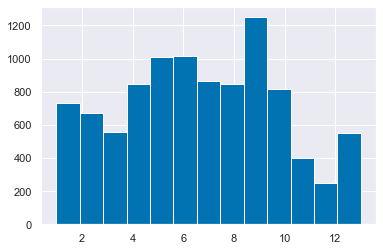

In [164]:
income_var_df.stack().hist(bins=13)

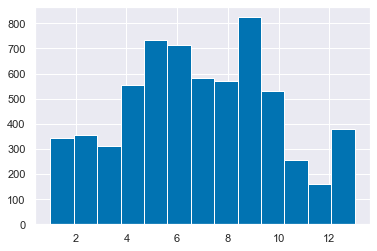

In [165]:
income_var_df_sm.stack().hist(bins=13)

In [166]:
income_var_df.isnull().sum()

v1004    1149
v1005    1337
v1013    1721
v1006    1117
v1014    1563
v1007    1777
v1015    1979
dtype: int64

In [167]:
income_var_df.isnull().all(axis=1).sum()

133

In [168]:
income_var_df_sm.isnull().all(axis=1).sum()

179

In [169]:
diffs = income_var_df.diff(axis=1)
diffs.stack().value_counts()

 0.0     3120
 1.0      724
 2.0      385
-1.0      305
 3.0      214
-2.0      191
-3.0      148
-4.0      129
 4.0      125
-5.0      107
-6.0       91
 5.0       84
-7.0       68
 6.0       66
-8.0       58
 8.0       54
 7.0       41
-9.0       33
 9.0       27
-10.0      22
 10.0      10
 11.0       7
-11.0       7
 12.0       4
-12.0       2
dtype: int64

In [170]:
diffs = income_var_df_sm.diff(axis=1)
diffs.stack().value_counts()

 1.0     874
 0.0     869
 2.0     465
-1.0     286
 3.0     233
-2.0     151
 4.0     122
-3.0      71
-4.0      42
 5.0      38
 6.0      32
-5.0      21
-6.0      13
 7.0       8
-7.0       5
 8.0       5
-9.0       4
 9.0       4
-8.0       4
-10.0      1
 10.0      1
dtype: int64

In [171]:
diffs.mean()


# for each df, for each row roll forwards and then backwards
# then use resp to fill in blanks for hh
# then use regression to fill in last blanks

# if pd.notnull(np.nan): print("fgfg")
# income_var_df_sm.columns[::-1]

v1004         NaN
v1005    0.402500
v1006    0.595707
v1007    1.182599
dtype: float64

In [172]:
income_var_df_sm = BES_df_list["1959"][income_var_smaller].replace(replace_dict)
income_var_df_resp = BES_df_list["1959"][income_var_resp].replace(replace_dict)

income_var_df_sm   = income_var_df_sm.rename(columns={"v1004":"1963","v1005":"1964","v1006":"1966","v1007":"1970"})
income_var_df_resp = income_var_df_resp.rename(columns={"v1013":"1964","v1014":"1966","v1015":"1970"})
income_var_df_sm["1959"]=np.nan
income_var_df_sm = income_var_df_sm[['1959', '1963', '1964', '1966', '1970']]

income_var_df_resp["1959"]=np.nan
income_var_df_resp = income_var_df_resp[['1959', '1964', '1966', '1970']]

In [173]:
# I think easiest solution might be to actually do it manually
for ind in income_var_df_sm.index:
    # for each df, for each row roll forwards and then backwards (because 63 closer to 64 than 70 is to 66)
    reading = np.nan
    adj_dict = {'1959':0,'1963':1.01,'1964':.4,'1966':.65,'1970':1.2}
    for col in income_var_df_sm.columns:
        if pd.notnull(reading) and pd.isnull(income_var_df_sm.loc[ind,col]):
            income_var_df_sm.loc[ind,col] = reading+adj_dict[col]
            reading =   income_var_df_sm.loc[ind,col]
        elif pd.notnull(income_var_df_sm.loc[ind,col]):
            reading =   income_var_df_sm.loc[ind,col]
        
    reading = np.nan
    adj_dict = {'1959':-1.01,'1963':-.4,'1964':-.6,'1966':-1.2,'1970':0}
    for col in income_var_df_sm.columns[::-1]:
        if pd.notnull(reading) and pd.isnull(income_var_df_sm.loc[ind,col]):
            income_var_df_sm.loc[ind,col] = reading+adj_dict[col]
            reading =   income_var_df_sm.loc[ind,col]
        elif pd.notnull(income_var_df_sm.loc[ind,col]):
            reading =   income_var_df_sm.loc[ind,col]
        
for ind in income_var_df_resp.index:
    # for each df, for each row roll forwards and then backwards (because 63 closer to 64 than 70 is to 66)
    reading = np.nan
    adj_dict = {'1959':0,'1964':1.01, '1966':.69, '1970':1.33}
    for col in income_var_df_resp.columns:
        if pd.notnull(reading) and pd.isnull(income_var_df_resp.loc[ind,col]):
            income_var_df_resp.loc[ind,col] = reading+adj_dict[col]
            reading =   income_var_df_resp.loc[ind,col]
        elif pd.notnull(income_var_df_resp.loc[ind,col]):
            reading =   income_var_df_resp.loc[ind,col]
        
    reading = np.nan
    adj_dict = {'1959':-1.01,'1964':-.69, '1966':-1.33, '1970':0}
    for col in income_var_df_resp.columns[::-1]:
        if pd.notnull(reading) and pd.isnull(income_var_df_resp.loc[ind,col]):
            income_var_df_resp.loc[ind,col] = reading+adj_dict[col]
            reading =   income_var_df_resp.loc[ind,col]
        elif pd.notnull(income_var_df_resp.loc[ind,col]):
            reading =   income_var_df_resp.loc[ind,col]
            
income_var_df_resp = income_var_df_resp.apply(np.floor)
income_var_df_sm = income_var_df_sm.apply(np.floor)[['1959', '1964', '1966', '1970']]
income_var_df_sm = income_var_df_sm.where(income_var_df_sm.notnull(),income_var_df_resp)

In [174]:
## we retain some projection, but don't try to project back to 1959

income_var_df_sm = BES_df_list["1959"][income_var_smaller].replace(replace_dict)
income_var_df_resp = BES_df_list["1959"][income_var_resp].replace(replace_dict)

income_var_df_sm   = income_var_df_sm.rename(columns={"v1004":"1963","v1005":"1964","v1006":"1966","v1007":"1970"})
income_var_df_resp = income_var_df_resp.rename(columns={"v1013":"1964","v1014":"1966","v1015":"1970"})

# income_var_df_sm = income_var_df_sm[['1963', '1964', '1966', '1970']]

# income_var_df_resp = income_var_df_resp[['1964', '1966', '1970']]

income_var_df_sm.loc[:,["1964","1966","1970"]] = income_var_df_sm.loc[:,["1964","1966","1970"]]\
    .where(income_var_df_sm.loc[:,["1964","1966","1970"]].notnull(),income_var_df_resp)

# I think easiest solution might be to actually do it manually
for ind in income_var_df_sm.index:
    # for each df, for each row roll forwards and then backwards (because 63 closer to 64 than 70 is to 66)
    reading = np.nan
#     adj_dict = {'1959':0,'1963':1.01,'1964':.4,'1966':.65,'1970':1.2}
    adj_dict = {'1963':0,'1964':1.01,'1966':.4,'1970':.65}
    for col in income_var_df_sm.columns:
        if pd.notnull(reading) and pd.isnull(income_var_df_sm.loc[ind,col]):
            income_var_df_sm.loc[ind,col] = reading+adj_dict[col]
            reading =   income_var_df_sm.loc[ind,col]
        elif pd.notnull(income_var_df_sm.loc[ind,col]):
            reading =   income_var_df_sm.loc[ind,col]
        
    reading = np.nan
#     adj_dict = {'1959':-1.01,'1963':-.4,'1964':-.6,'1966':-1.2,'1970':0}
    adj_dict = {'1963':-.4,'1964':-.6,'1966':-1.2,'1970':0}
    for col in income_var_df_sm.columns[::-1]:
        if pd.notnull(reading) and pd.isnull(income_var_df_sm.loc[ind,col]):
            income_var_df_sm.loc[ind,col] = reading+adj_dict[col]
            reading =   income_var_df_sm.loc[ind,col]
        elif pd.notnull(income_var_df_sm.loc[ind,col]):
            reading =   income_var_df_sm.loc[ind,col]

income_var_df_sm = (income_var_df_sm).apply(np.floor).applymap(lambda x: min(x,13)).applymap(lambda x: max(x,1))

In [175]:
# 1004 income group hh 63 (income group of *head of household*)
# 1-13 (A-M) annual income levels
# 14 DK (refused)
# 15 NA
# 19 Not interviewed in 63



# 1004
# same
# 15. CODE NOT USED
# 19. RESPONDENT NOT INTERVIEWED 1964
# 00. NA

# 1006
# same
# 19. RESPONDENT NOT INTERVIEWED 1966

# 1007
# same 
# 15. CODE NOT USED
# 19. RESPONDENT NOT INTERVIEWED 1970
# 00. NA

# 1008 is income estimated hh 63 *head of household's income group estimated?*
# 1. MARKED AS ESTIMATED
# 5. NOT MARKED AS ESTIMATE
# 9. RESP NOT INTERVIEWED 1963
# 0. NA

# 1009 is income estimated hh 64 *head of household's income group estimated?*
# 1. MARKED AS ESTIMATED
# 2. NOT MARKED AS ESTIMATE
# 9. RESP NOT INTERVIEWED 1964
# 0. NA

# 1010 is income estimated hh 66 *head of household's income group estimated?*
# 1. MARKED AS ESTIMATED
# 5. NOT MARKED AS ESTIMATE
# 9. RESP NOT INTERVIEWED 1966

# 1011 is income estimated hh 70 *head of household's income group estimated?*
# 1. MARKED AS ESTIMATED
# 2. NOT MARKED AS ESTIMATE
# 9. RESP NOT INTERVIEWED 1970
# 0. NA

# 1012 WHETHER STATED INCOME IS FOR SOMEONE OTHER THAN HEAD OF HOUSEHOLD
# 1. MAY BE RESP INC NOT HEAD OF HH
# 5 NO
# 9 RESP NOT INTERVIEWED 1963
# 0 NA

# 1013 1964-INCOME GROUP OF RESPONDENT
# 1-13 (A-M) income groups
# 14 (N) refused
# 15/19? RESP NOT INTERVIEWED 1964
# 00 NA/IMAP (RESP IS HOUSEWIFE)

# 1014 1966-INCOME GROUP OF RESPONDENT
# same
# 15 NA
# 19 RESP NOT INT 1966
# 00 IMAP

# 1015 1970-INCOME GROUP OF RESPONDENT
# # same
# 19 RESP NOT INT

# 1016 1964- WHETHER R INCOME GROUP IS ESTIMATED
# 1 ESTIMATED
# 2 NOT ESTIMATED
# 9 RESP NOT INT 1964
# 0 NA IMAP

# 1017 1970- WHETHER R INCOME GROUP IS ESTIMATED
# 1 ESTIMATED
# 2 NOT ESTIMATED
# 9 RESP NOT INT 1964
# 0 NA IMAP


# 1215 1963 head of hh income group (5 groups)
# <350/<550/<750/<1200/1200+
# 9 not interviewed
# 0 dk/na

# 1216 1964/1217 1966*/1218 1970

# *0 dk/na/refused/no occupation
# income_var_df_sm

In [176]:
f2f_harmonised["inc_det"] = np.nan
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","inc_det"] = income_var_df_sm["1964"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","inc_det"] = income_var_df_sm["1966"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","inc_det"] = income_var_df_sm["1970"]

MSE: 4.12, MAE: 1.56, EV: 0.58, R2: 0.58


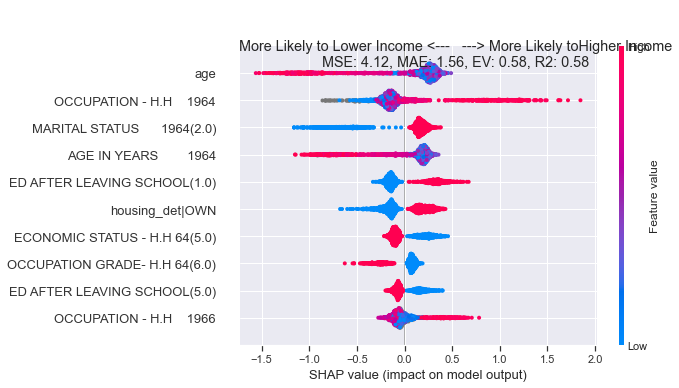

<Figure size 1152x720 with 0 Axes>

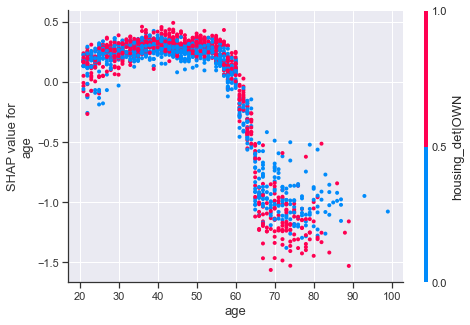

<Figure size 1152x720 with 0 Axes>

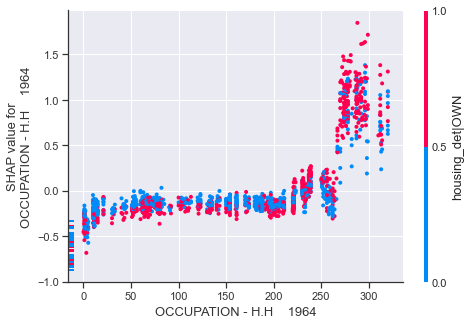

<Figure size 1152x720 with 0 Axes>

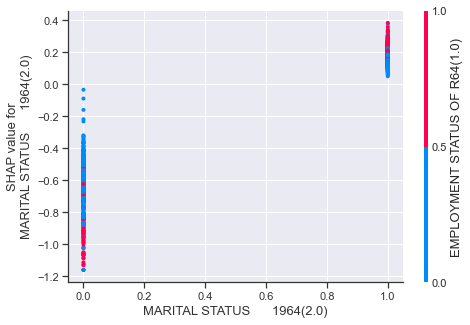

<Figure size 1152x720 with 0 Axes>

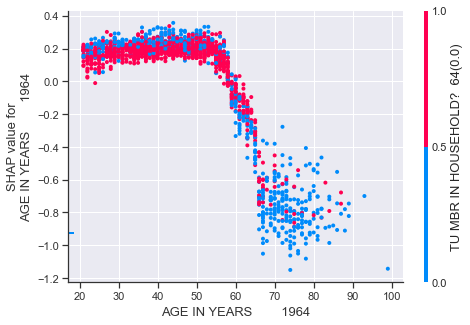

<Figure size 1152x720 with 0 Axes>

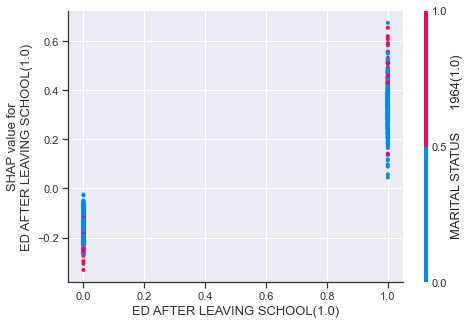

<Figure size 1152x720 with 0 Axes>

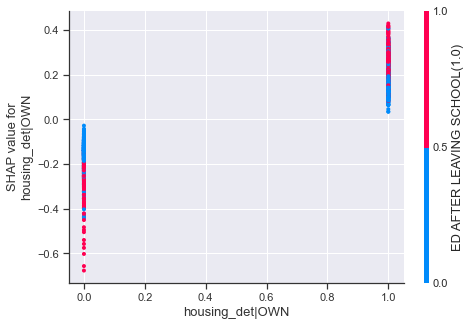

<Figure size 1152x720 with 0 Axes>

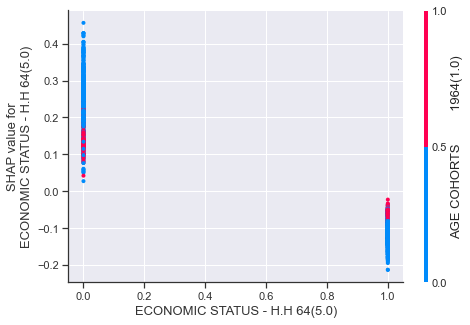

<Figure size 1152x720 with 0 Axes>

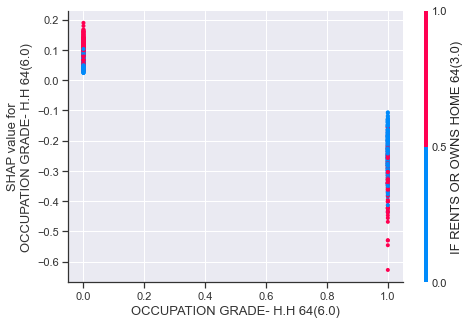

<Figure size 1152x720 with 0 Axes>

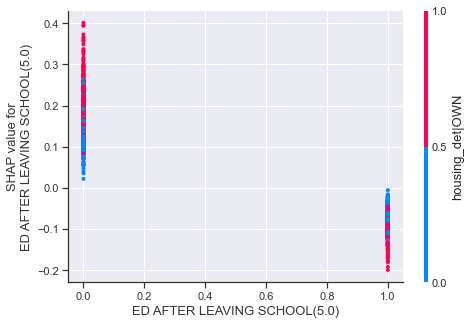

<Figure size 1152x720 with 0 Axes>

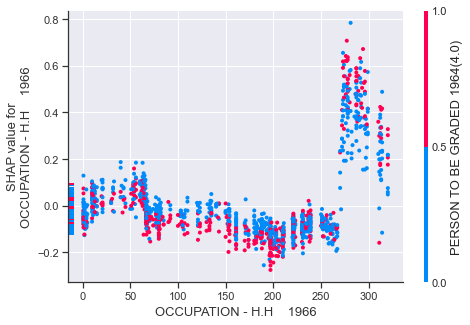

In [177]:
ge = "1964"
harm_vars = ["wt","age","housing_det","harmonised_voted","inc_det"]
target_var = "inc_det"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = "inc_det"
min_features = 10
drop_vars = ['v1004',
 'v1005',
 'v1006',
 'v1007',
 'v1008',
 'v1009',
 'v1010',
 'v1011',
 'v1012',
 'v1013',
 'v1014',
 'v1015',
 'v1016',
 'v1017',
 'v1215',
 'v1216',
 'v1217',
 'v1218']

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=True)

# setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=True)
# use fitted algorithm to predict values
inc_pred = alg.predict(df_pred[train_columns])
income_var_df_sm.loc[income_var_df_sm[ge].isnull(),ge] = pd.Series(inc_pred,index=income_var_df_sm[ge].index).apply(round)[income_var_df_sm[ge].isnull()]

MSE: 4.71, MAE: 1.69, EV: 0.51, R2: 0.51


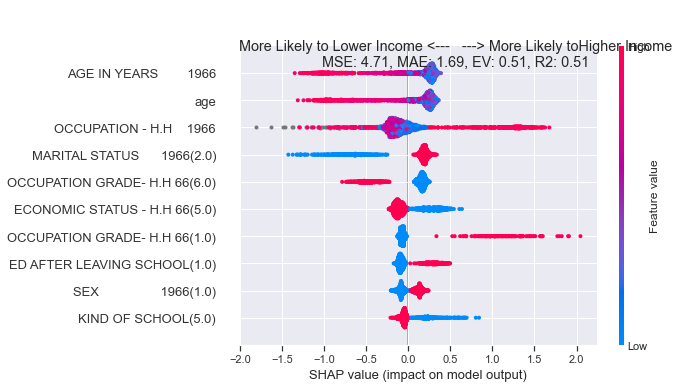

<Figure size 1152x720 with 0 Axes>

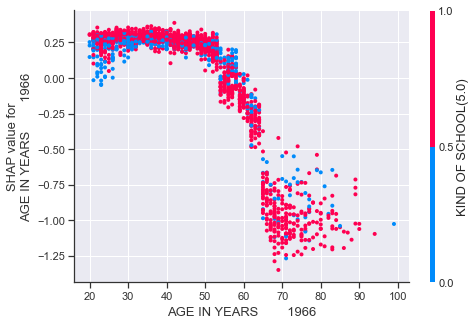

<Figure size 1152x720 with 0 Axes>

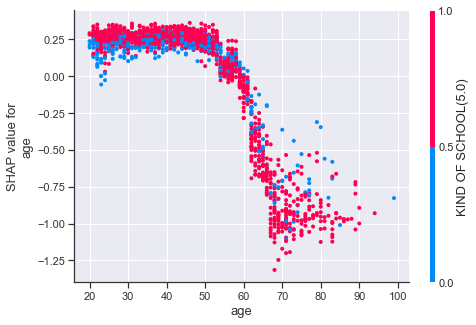

<Figure size 1152x720 with 0 Axes>

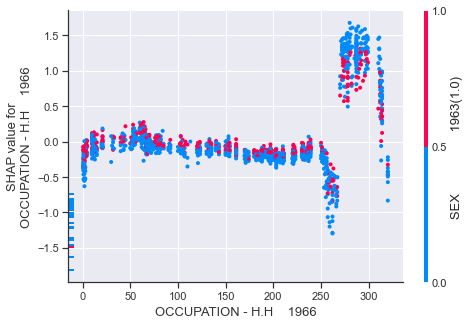

<Figure size 1152x720 with 0 Axes>

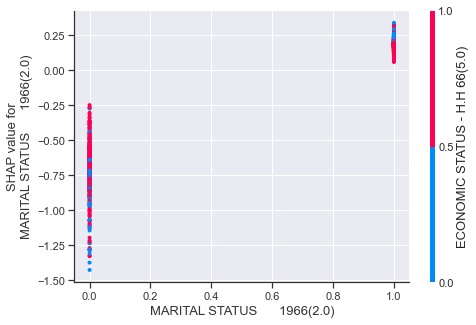

<Figure size 1152x720 with 0 Axes>

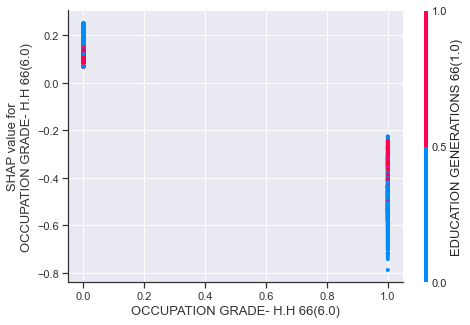

<Figure size 1152x720 with 0 Axes>

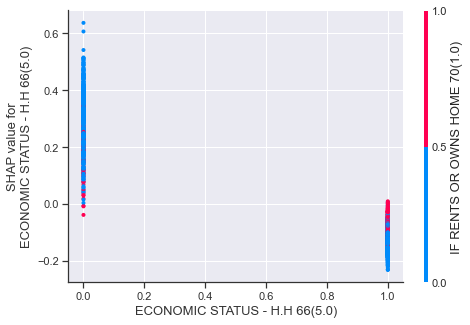

<Figure size 1152x720 with 0 Axes>

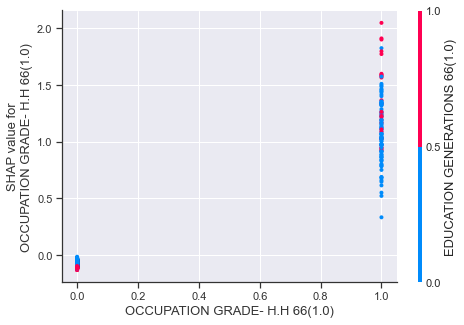

<Figure size 1152x720 with 0 Axes>

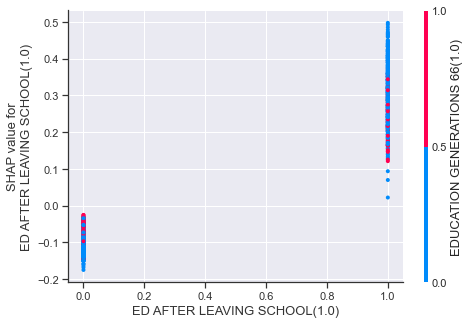

<Figure size 1152x720 with 0 Axes>

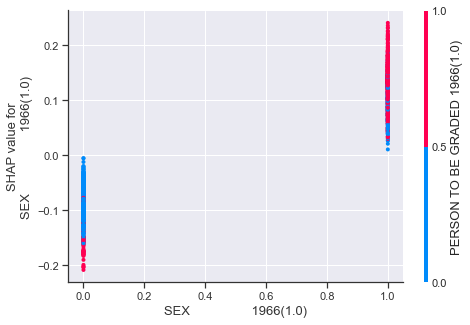

<Figure size 1152x720 with 0 Axes>

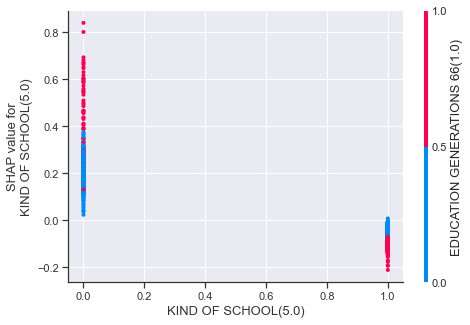

In [178]:
ge = "1966"
harm_vars = ["wt","age","housing_det","harmonised_voted","inc_det"]
target_var = "inc_det"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = "inc_det"
min_features = 10
drop_vars = ['v1004',
 'v1005',
 'v1006',
 'v1007',
 'v1008',
 'v1009',
 'v1010',
 'v1011',
 'v1012',
 'v1013',
 'v1014',
 'v1015',
 'v1016',
 'v1017',
 'v1215',
 'v1216',
 'v1217',
 'v1218']

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=True)

# setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=True)
# use fitted algorithm to predict values
inc_pred = alg.predict(df_pred[train_columns])
income_var_df_sm.loc[income_var_df_sm[ge].isnull(),ge] = pd.Series(inc_pred,index=income_var_df_sm[ge].index).apply(round)[income_var_df_sm[ge].isnull()]

MSE: 5.98, MAE: 1.84, EV: 0.50, R2: 0.49


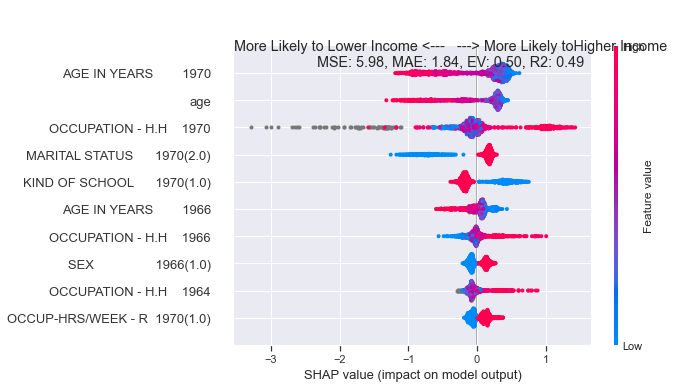

<Figure size 1152x720 with 0 Axes>

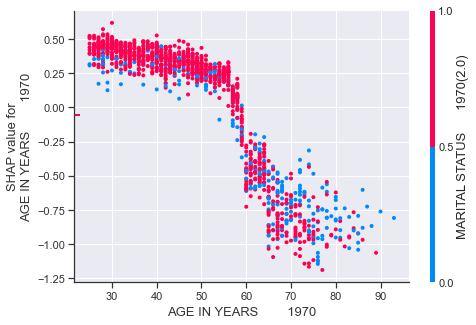

<Figure size 1152x720 with 0 Axes>

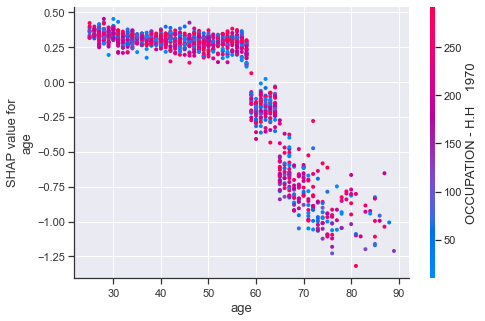

<Figure size 1152x720 with 0 Axes>

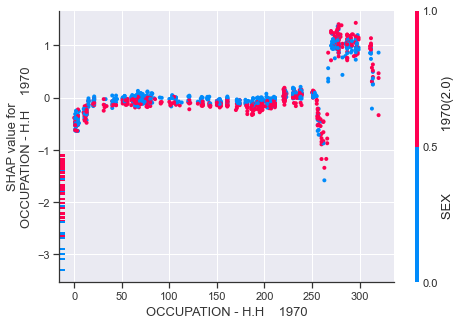

<Figure size 1152x720 with 0 Axes>

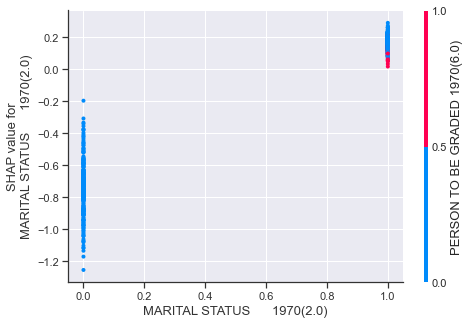

<Figure size 1152x720 with 0 Axes>

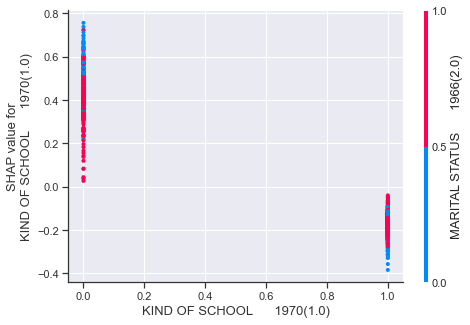

<Figure size 1152x720 with 0 Axes>

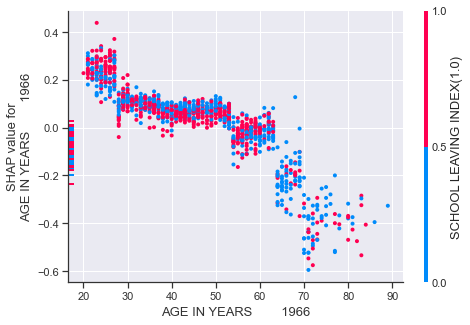

<Figure size 1152x720 with 0 Axes>

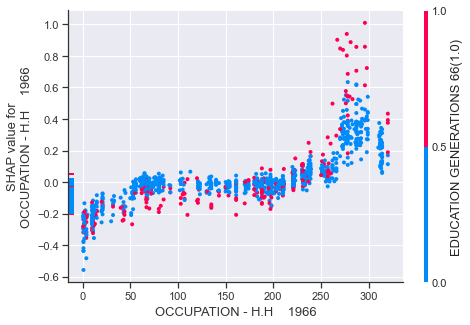

<Figure size 1152x720 with 0 Axes>

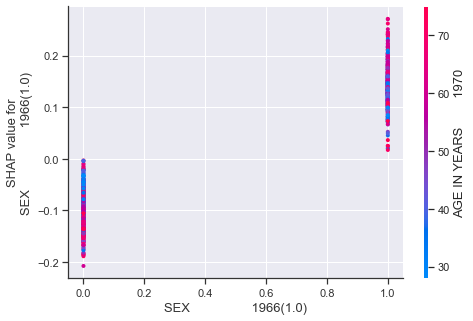

<Figure size 1152x720 with 0 Axes>

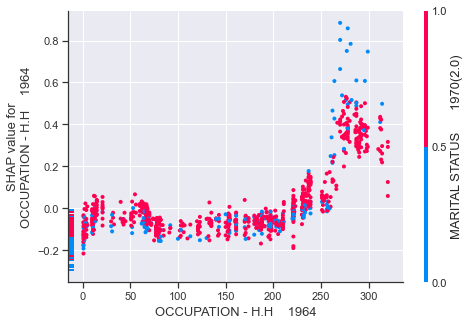

<Figure size 1152x720 with 0 Axes>

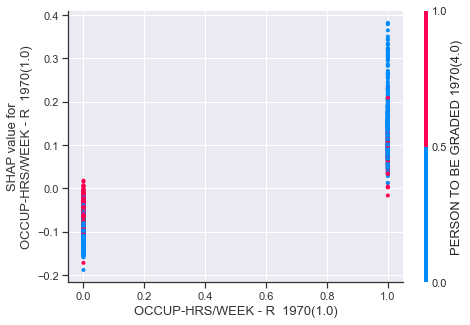

In [179]:
ge = "1970"
harm_vars = ["wt","age","housing_det","harmonised_voted","inc_det"]
target_var = "inc_det"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = "inc_det"
min_features = 10
drop_vars = ['v1004',
 'v1005',
 'v1006',
 'v1007',
 'v1008',
 'v1009',
 'v1010',
 'v1011',
 'v1012',
 'v1013',
 'v1014',
 'v1015',
 'v1016',
 'v1017',
 'v1215',
 'v1216',
 'v1217',
 'v1218']

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=True)

# setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=True)
# use fitted algorithm to predict values
inc_pred = alg.predict(df_pred[train_columns])
income_var_df_sm.loc[income_var_df_sm[ge].isnull(),ge] = pd.Series(inc_pred,index=income_var_df_sm[ge].index).apply(round)[income_var_df_sm[ge].isnull()]

In [180]:
pd.Series(inc_pred,index=income_var_df_sm["1970"].index).apply(round)[income_var_df_sm["1970"].isnull()]

Series([], dtype: int64)

In [181]:
f2f_harmonised["inc_det"] = np.nan
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","inc_det"] = income_var_df_sm["1964"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","inc_det"] = income_var_df_sm["1966"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","inc_det"] = income_var_df_sm["1970"]

In [230]:
# f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","inc_det"].isnull().sum()

In [182]:
age_drop_vars = ['v937','v938',
 'v939',
 'v940',
 'v941',
 'v942',
 'v943',
 'v944',
 'v945',
 'v1208',
 'v1209',
 'v1210',
 'v1211',
 'v1212',
 'v1213']
inc_drop_vars = ['v1004',
 'v1005',
 'v1006',
 'v1007',
 'v1008',
 'v1009',
 'v1010',
 'v1011',
 'v1012',
 'v1013',
 'v1014',
 'v1015',
 'v1016',
 'v1017',
 'v1215',
 'v1216',
 'v1217',
 'v1218']
house_drop_vars = ['v915','v916','v917']
# vote_vars = ["v521","v522","v523","v524","v525","v526","v527","v528","v1153","v1154","v1155","v1156","v1168","v1169","v1170"]

vote_vars = ["v356","v357","v358","v363","v364","v365",
             "v512","v513","v514","v515","v516","v517","v518","v519","v520",
             "v521","v522","v523","v524","v525","v526","v527","v528",
             "v1153","v1154","v1155","v1156",
             "v1157","v1158","v1159","v1160","v1161","v1162","v1163","v1164","v1165","v1166","v1167",
             "v1168","v1169","v1170","v1171"]

MSE: 0.09, MAE: 0.20, EV: 0.00, R2: -0.00


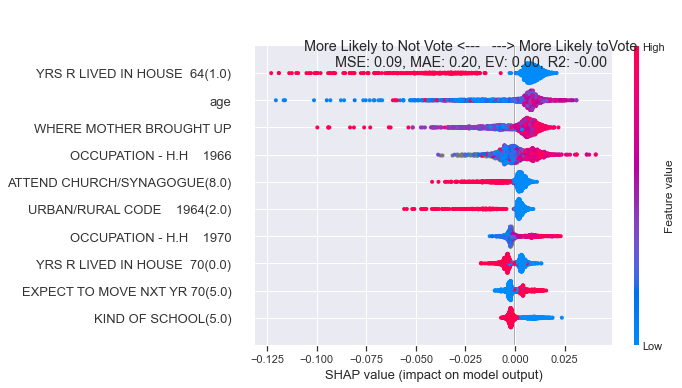

<Figure size 1152x720 with 0 Axes>

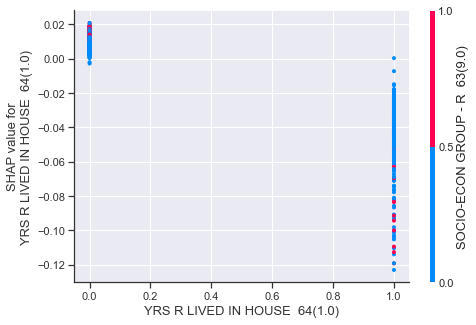

<Figure size 1152x720 with 0 Axes>

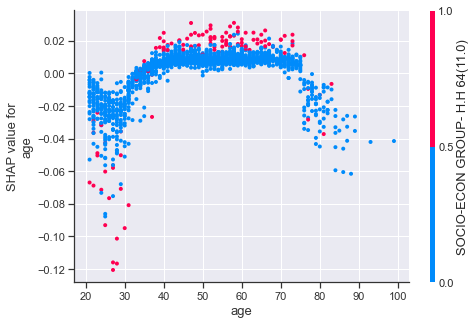

<Figure size 1152x720 with 0 Axes>

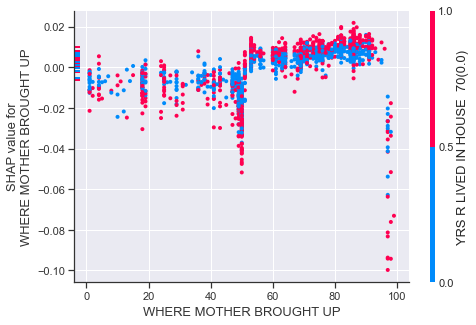

<Figure size 1152x720 with 0 Axes>

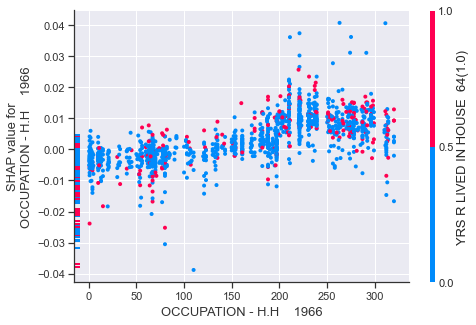

<Figure size 1152x720 with 0 Axes>

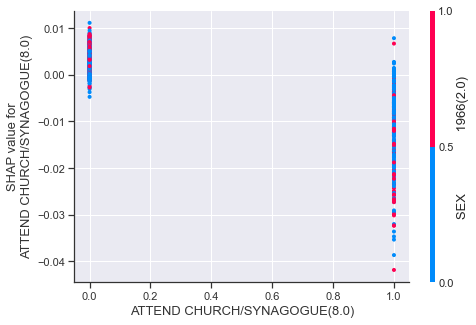

<Figure size 1152x720 with 0 Axes>

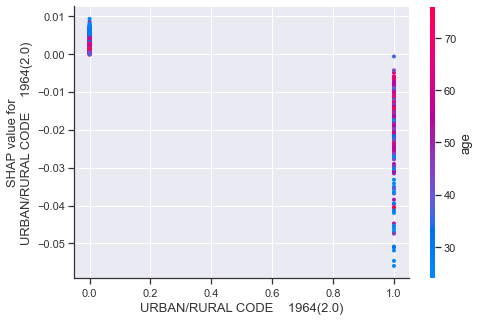

<Figure size 1152x720 with 0 Axes>

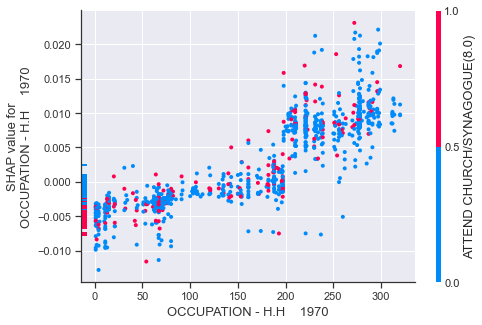

<Figure size 1152x720 with 0 Axes>

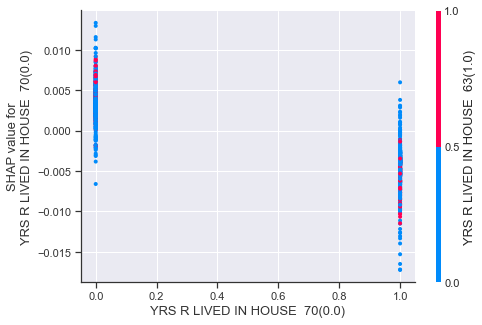

<Figure size 1152x720 with 0 Axes>

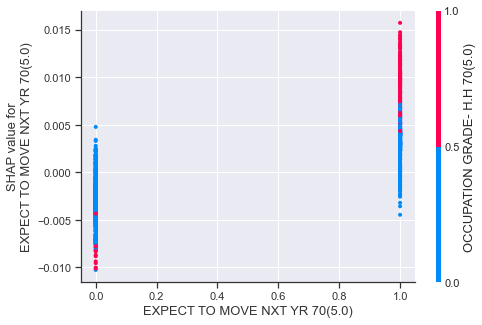

<Figure size 1152x720 with 0 Axes>

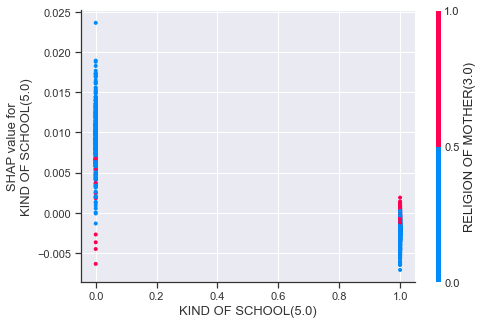

In [183]:
ge="1964"
harm_vars = ["wt","age","housing_det","inc","harmonised_voted","inc_det"]
target_var = "harmonised_voted"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Not Vote","Vote"]
var_stub = "harmonised_voted"
min_features = 10
drop_vars = age_drop_vars+inc_drop_vars+house_drop_vars+vote_vars

# prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
#        var_stub,harm_vars,min_features,dependence_plots=True)
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=age_drop_vars,demo_var_only=True)

ACC: 0.98,  F1: 0.98


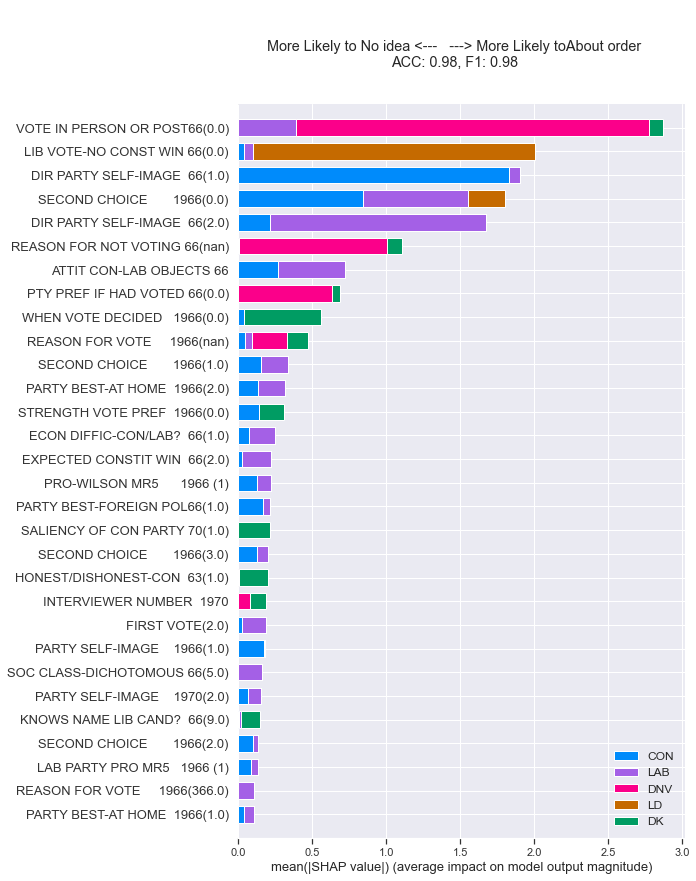

Wall time: 44.2 s


In [184]:
%%time
ge = "1966"
harm_vars = ["wt","age","housing_det","inc","inc_det","vote_simple"]
target_var = "vote_simple"
target_var_replace_dict = {}
target_var_drop_list = ["PC","SNP"]
target_var_title_pair = ["No idea","About order"]
var_stub = "vote_simple"
min_features = 30
drop_vars = age_drop_vars+inc_drop_vars+house_drop_vars+vote_vars
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # # setup df back up
# df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
#        var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
#         multi_class_target=True)
# # # use fitted algorithm to predict values
# house_pred = alg.predict(df_pred[train_columns])

# housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


In [185]:
# ['CON', 'DK', 'DNV', 'LAB', 'LD']
f2f_harmonised["bloc"].astype('category')

0        Neither
1        Neither
2       Left-Lib
3        Neither
4        Neither
          ...   
2917         NaN
2918         NaN
2919         NaN
2920    Left-Lib
2921         NaN
Name: bloc, Length: 58540, dtype: category
Categories (3, object): ['Left-Lib', 'Neither', 'Right-Auth']

In [186]:
f2f_harmonised[f2f_harmonised["dataset"]=="1970"]["vote_simple"].astype('category').cat.remove_categories(target_var_drop_list)

# DK *very high* here!

0        DK
1        DK
2        DK
3        DK
4        DK
       ... 
2917     DK
2918     DK
2919     DK
2920    LAB
2921     DK
Name: vote_simple, Length: 2922, dtype: category
Categories (5, object): ['CON', 'DK', 'DNV', 'LAB', 'LD']

In [187]:
f2f_harmonised[f2f_harmonised["dataset"]=="1966"]["vote_simple"].value_counts()

# DK *very high* here!

target_var_drop_list = ["PC","SNP"]

In [188]:
f2f_harmonised["vote_simple"].value_counts()

CON      15096
LAB      14996
DNV       9059
DK        6516
LD        6049
SNP       1118
REFUK      509
GP         277
PC         252
OTH          3
Name: vote_simple, dtype: int64

In [189]:
f2f_harmonised[f2f_harmonised["dataset"]=="1964"]["vote_simple"].value_counts(dropna=False)

DK     1118
LAB     743
CON     662
DNV     211
LD      170
NaN      13
PC        5
Name: vote_simple, dtype: int64

In [190]:
mask = f2f_harmonised[f2f_harmonised["dataset"]=="1964"]["wt"].notnull()
f2f_harmonised[f2f_harmonised["dataset"]=="1964"]["vote"][mask].value_counts(dropna=False)

LAB    716
CON    650
DNV    196
LIB    165
DK      24
NaN      9
PC       5
OTH      3
COM      1
Name: vote, dtype: int64

In [191]:
f2f_harmonised[f2f_harmonised["dataset"]=="1964"]["vote"].value_counts(dropna=False)

DK     1118
LAB     743
CON     662
DNV     211
LIB     170
NaN       9
PC        5
OTH       3
COM       1
Name: vote, dtype: int64

In [192]:
f2f_harmonised[f2f_harmonised["dataset"]=="1970"]["vote"].value_counts(dropna=False)

DK     1569
CON     552
LAB     454
DNV     219
LIB      98
NaN      15
PC       13
OTH       1
SNP       1
Name: vote, dtype: int64

In [193]:
f2f_harmonised[f2f_harmonised["dataset"]=="1966"]["vote"].value_counts(dropna=False)

LAB    884
DK     854
CON    678
DNV    339
LIB    140
NaN     18
PC       8
OTH      1
Name: vote, dtype: int64

In [194]:
f2f_harmonised[f2f_harmonised["dataset"]=="1959"]["vote"].value_counts(dropna=False)

CON      1007
LAB       975
TY        424
DNV       361
LD         99
VOTED      27
DK         26
OTH         3
Name: vote, dtype: int64

In [195]:
vote_vars = ["v356","v357","v358","v363","v364","v365",
             "v512","v513","v514","v515","v516","v517","v518","v519","v520",
             "v521","v522","v523","v524","v525","v526","v527","v528",
             "v1153","v1154","v1155","v1156",
             "v1157","v1158","v1159","v1160","v1161","v1162","v1163","v1164","v1165","v1166","v1167",
             "v1168","v1169","v1170","v1171"]

In [196]:
smaller_vote_vars = ["v1153","v1154","v1155","v1156","v1157","v1158","v1159",
                     "v1160","v1161","v1162","v1163","v1164",]

In [197]:
## BUG change type type to nominal for REASON variables

## variables should be treated as nominal

var_type_dict_nonans["1959"].update({x:"nominal" for x in [k for k,v in BES_label_list[ge].items() if re.search("REASON",v)]})
var_type_dict_nonans["1964"].update({x:"nominal" for x in [k for k,v in BES_label_list[ge].items() if re.search("REASON",v)]})
var_type_dict_nonans["1966"].update({x:"nominal" for x in [k for k,v in BES_label_list[ge].items() if re.search("REASON",v)]})
var_type_dict_nonans["1970"].update({x:"nominal" for x in [k for k,v in BES_label_list[ge].items() if re.search("REASON",v)]})

In [198]:
# "v356","v357","v358",
{1:"VOTED",5:"DNV",8:np.nan,9:np.nan,0:np.nan}
# "v363","v364",
{1:"CON",2:"LAB",3:"LIB",4:"PC",5:"COM",6:"BNP",7:np.nan,8:"OTH",9:"DK",0:np.nan}
# strictly speaking, "patriotic party" but same party format/same guy
# "v365",
{1:"CON",2:"LAB",3:"LIB",4:"PC",5:"COM",6:"SNP",7:np.nan,8:"OTH",9:"DK",0:np.nan}
# "v512" # 66 turnout
{1:"DEF VOTED",2:"PROB VOTED",5:"DNV",8:np.nan,9:np.nan,0:np.nan}
# "v513" # 66 vote
{1:"CON",2:"LAB",3:"LIB",6:"SNP",7:"PC",8:np.nan,9:np.nan,0:np.nan}
# "v514" # 66 pref
{1:"CON",2:"LAB",3:"LIB",6:"SNP",7:"PC",8:np.nan,9:np.nan,0:np.nan}
# "v515" ## 64 turnout
{1:"DEF VOTED",2:"PROB VOTED",5:"DNV",7:"TY",8:np.nan,9:np.nan,0:np.nan}


# #521-523 {8/9/0 -> not there/dk/na}
# {1:"DEF VOTED",2:"PROB VOTED",5:"DNV",6:"TY"}
# #524-528 {9/9/0 -> not there/dk/na}
# {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}
# #1153-1156 built from the above *and age* {8/9/0 -> still not there/dk/na}
# #1168-1170 59-63 change of vote {9/0 not there/dk} 4 includes did not vote/too young

# # 1153: 59 vote including prefs
# # 1154: 59 vote
# # 1155: 59 pref
# # 1156: 59 vote (from vote+turnout)
# {1:"CON",2:"LAB",3:"LD",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV"}

# # 1157: 64
# # 1158: 64
# # 1159: 64
# # 1160: 64
# # 1161: 64
# # 1162: 66
# # 1163: 66
# # 1164: 70
{1:"CON",2:"LAB",3:"LIB",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV",8:np.nan,9:np.nan,0:np.nan}

# # 1168: vote/intention
# # 1169: same but sampled in 1964
# # 1170: vote/vote
# {1:"CON59:CON63",
#  2:"LAB59:LAB63",
#  3:"LD59:LD64",
#  4:"OTH/TY/DNV59:OTH/DNV63",
#  5:"TO-CON/AWAY-LAB",
#  6:"TO-LAB/AWAY-CON",
#  7:"TO-LD/AWAY-LD",
# }

{1: 'CON',
 2: 'LAB',
 3: 'LIB',
 4: 'OTH',
 5: 'DNV/NP',
 6: 'TY',
 7: 'DNV',
 8: nan,
 9: nan,
 0: nan}

In [199]:
ge = "1964"
repl_dict = {1:"CON",2:"LAB",3:"LIB",4:"OTH",5:"DNV/NP",6:"TY",7:"DNV",8:np.nan,9:np.nan,0:np.nan}
vote_df = BES_df_list[ge][smaller_vote_vars].replace(repl_dict)

In [200]:
vote_df.stack().value_counts()

LAB       7727
CON       7338
DNV/NP    1937
LIB       1258
DNV        497
TY         317
OTH         83
dtype: int64

In [201]:
vote_df.isnull().sum()

v1153     960
v1154    1170
v1155    1231
v1156     946
v1157    1130
v1158     892
v1159    1652
v1160    2724
v1161    1140
v1162     872
v1163    1606
v1164    1584
dtype: int64

In [202]:
vote_df.isnull().all(axis=1).sum()

20

In [203]:
vote_df

,v1153,v1154,v1155,v1156,v1157,v1158,v1159,v1160,v1161,v1162,v1163,v1164
0,LAB,LAB,LAB,NaN,NaN,NaN,NaN,NaN,OTH,NaN,NaN,NaN
1,NaN,CON,CON,NaN,NaN,NaN,NaN,NaN,CON,NaN,NaN,NaN
2,LAB,LAB,LAB,LAB,NaN,LAB,NaN,NaN,LAB,LAB,NaN,NaN
3,CON,NaN,NaN,CON,NaN,CON,NaN,NaN,NaN,LIB,NaN,NaN
4,LAB,LAB,LAB,LAB,NaN,LAB,NaN,NaN,NaN,LAB,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2917,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,LAB,NaN,NaN
2918,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,DNV/NP,NaN,NaN
2919,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,DNV/NP,NaN,NaN
2920,NaN,NaN,NaN,LAB,NaN,LAB,LAB,NaN,NaN,LAB,LAB,LAB


In [204]:
ge = "1964"
vote_df.columns = [BES_label_list[ge][x] for x in vote_df.columns]

In [205]:
vote_df

,59 VOTE-REVISED-MEAS 63,59 VOTE-REVISED 64,59 VOTE OR PREF 1964,59 VOTE-REV MEAS 2 1966,64 VOTE-REVISED MEAS 64,64 VOTE-REVISED MEAS 66,64 VOTE-REVISED MEAS 70,64 PREF-NON-VOTERS 1964,64 VOTE OR PREFERENCE 64,66 VOTE-REVISED MEAS 66,66 VOTE-REVISED MEAS 70,70 VOTE-REVISED MEAS 70
0,LAB,LAB,LAB,NaN,NaN,NaN,NaN,NaN,OTH,NaN,NaN,NaN
1,NaN,CON,CON,NaN,NaN,NaN,NaN,NaN,CON,NaN,NaN,NaN
2,LAB,LAB,LAB,LAB,NaN,LAB,NaN,NaN,LAB,LAB,NaN,NaN
3,CON,NaN,NaN,CON,NaN,CON,NaN,NaN,NaN,LIB,NaN,NaN
4,LAB,LAB,LAB,LAB,NaN,LAB,NaN,NaN,NaN,LAB,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2917,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,LAB,NaN,NaN
2918,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,DNV/NP,NaN,NaN
2919,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,DNV/NP,NaN,NaN
2920,NaN,NaN,NaN,LAB,NaN,LAB,LAB,NaN,NaN,LAB,LAB,LAB


In [206]:
## add f2fharm 59 vote column
## get predictions for 64/66/70
    # allow vote vars from other years???

## decide how to fill in gaps

In [207]:
vote_df["vote59"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote"]

In [208]:
## get predictions

In [209]:
f2f_harmonised["vote_complete"] = np.nan

f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"].replace("DK",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"].replace("PC",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"].replace("OTH",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"].replace("COM",np.nan)

f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"].replace("DK",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"].replace("PC",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"].replace("OTH",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"].replace("COM",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"].replace("SNP",np.nan)

f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote"]
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"].replace("DK",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"].replace("PC",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"].replace("OTH",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"].replace("COM",np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1970","vote_complete"].replace("SNP",np.nan)

ACC: 0.79,  F1: 0.79


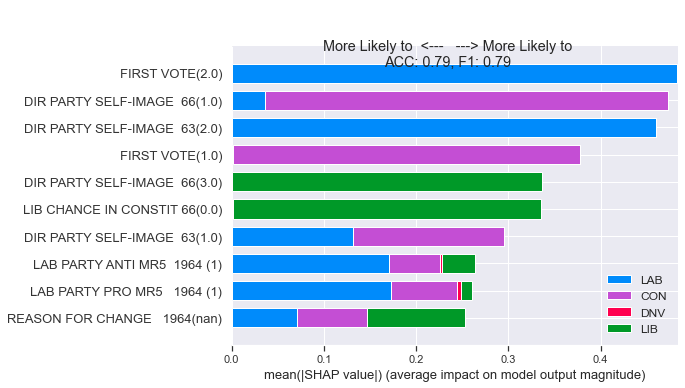

Wall time: 18.7 s


In [210]:
%%time
ge = "1964"
harm_vars = ["wt","age","housing_det","inc","vote_complete"]
target_var = "vote_complete"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["",""]
var_stub = "vote_complete"
min_features = 10
stds= BES_df_list[ge][f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"].isnull()].std()/BES_df_list[ge].max()
drop_vars = vote_vars+[x for x in list(stds[stds<.2].index)+list(stds[stds.isnull()].index) if x in BES_label_list[ge].keys()]
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
vote_pred = alg.predict(df_pred[train_columns])

vote_df["vote"+ge[2:]] = vote_pred
# housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


ACC: 0.79,  F1: 0.79


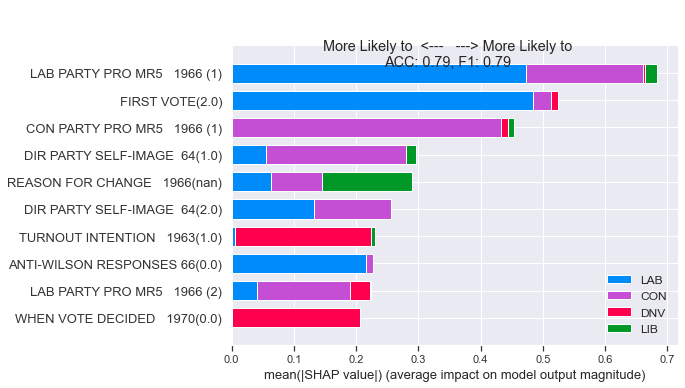

Wall time: 20.7 s


In [211]:
%%time
ge = "1966"
harm_vars = ["wt","age","housing_det","inc","vote_complete"]
target_var = "vote_complete"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["",""]
var_stub = "vote_complete"
min_features = 10
stds= BES_df_list[ge][f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"].isnull()].std()/BES_df_list[ge].max()
drop_vars = vote_vars+[x for x in list(stds[stds<.2].index)+list(stds[stds.isnull()].index) if x in BES_label_list[ge].keys()]
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
vote_pred = alg.predict(df_pred[train_columns])

vote_df["vote"+ge[2:]] = vote_pred
# housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


ACC: 0.71,  F1: 0.71


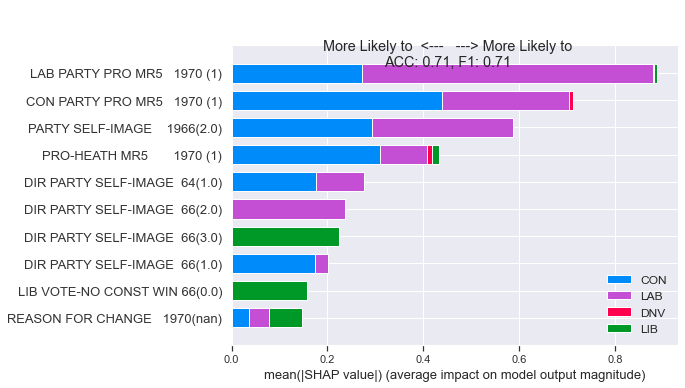

Wall time: 18.8 s


In [212]:
%%time
ge = "1970"
harm_vars = ["wt","age","housing_det","inc","vote_complete"]
target_var = "vote_complete"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["",""]
var_stub = "vote_complete"
min_features = 10
stds= BES_df_list[ge][f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"].isnull()].std()/BES_df_list[ge].max()
drop_vars = vote_vars+[x for x in list(stds[stds<.2].index)+list(stds[stds.isnull()].index) if x in BES_label_list[ge].keys()]
# drop_vars = ['IF RENTS OR OWNS HOME 63','IF RENTS OR OWNS HOME 64','IF RENTS OR OWNS HOME 70']


# alg = get_xgboost_alg(classification_problem=True)
alg = XGBClassifier()
(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
       alg=alg,multi_class_target=True)

# # setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars=drop_vars,demo_var_only=False,
        multi_class_target=True)
# # use fitted algorithm to predict values
vote_pred = alg.predict(df_pred[train_columns])

vote_df["vote"+ge[2:]] = vote_pred
# housing_vars.loc[housing_vars[ge].isnull(),ge] = pd.Series(house_pred,index=housing_vars.index)[housing_vars[ge].isnull()]


In [213]:
# ge="1964"
# # variances = BES_df_list[ge][f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"].isnull()].var()
# stds= BES_df_list[ge][f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"].isnull()].std()/BES_df_list[ge].max()

In [214]:
vote_df

,59 VOTE-REVISED-MEAS 63,59 VOTE-REVISED 64,59 VOTE OR PREF 1964,59 VOTE-REV MEAS 2 1966,64 VOTE-REVISED MEAS 64,64 VOTE-REVISED MEAS 66,64 VOTE-REVISED MEAS 70,64 PREF-NON-VOTERS 1964,64 VOTE OR PREFERENCE 64,66 VOTE-REVISED MEAS 66,66 VOTE-REVISED MEAS 70,70 VOTE-REVISED MEAS 70,vote59,vote64,vote66,vote70
0,LAB,LAB,LAB,NaN,NaN,NaN,NaN,NaN,OTH,NaN,NaN,NaN,LAB,LAB,DNV,DNV
1,NaN,CON,CON,NaN,NaN,NaN,NaN,NaN,CON,NaN,NaN,NaN,CON,CON,CON,CON
2,LAB,LAB,LAB,LAB,NaN,LAB,NaN,NaN,LAB,LAB,NaN,NaN,LAB,LAB,LAB,LAB
3,CON,NaN,NaN,CON,NaN,CON,NaN,NaN,NaN,LIB,NaN,NaN,CON,DNV,LIB,LIB
4,LAB,LAB,LAB,LAB,NaN,LAB,NaN,NaN,NaN,LAB,NaN,NaN,LAB,LAB,LAB,CON
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2917,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,LAB,NaN,NaN,TY,LAB,LAB,LAB
2918,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,DNV/NP,NaN,NaN,TY,DNV,DNV,LAB
2919,NaN,NaN,NaN,DNV/NP,NaN,DNV/NP,NaN,NaN,NaN,DNV/NP,NaN,NaN,TY,DNV,DNV,DNV
2920,NaN,NaN,NaN,LAB,NaN,LAB,LAB,NaN,NaN,LAB,LAB,LAB,LAB,LAB,LAB,LAB


In [215]:
vote_df.isnull().sum()

59 VOTE-REVISED-MEAS  63     960
59 VOTE-REVISED       64    1170
59 VOTE OR PREF     1964    1231
59 VOTE-REV MEAS 2  1966     946
64 VOTE-REVISED MEAS  64    1130
64 VOTE-REVISED MEAS  66     892
64 VOTE-REVISED MEAS  70    1652
64 PREF-NON-VOTERS  1964    2724
64 VOTE OR PREFERENCE 64    1140
66 VOTE-REVISED MEAS  66     872
66 VOTE-REVISED MEAS  70    1606
70 VOTE-REVISED MEAS  70    1584
vote59                         0
vote64                         0
vote66                         0
vote70                         0
dtype: int64

In [216]:
vote_df["64vote_comb"] = vote_df[ search(vote_df,"64 VOTE-REVISED").index ].fillna(method='ffill',axis=1)[search(vote_df,"64 VOTE-REVISED").index[-1]]
vote_df["66vote_comb"] = vote_df[ search(vote_df,"66 VOTE-REVISED").index ].fillna(method='ffill',axis=1)[search(vote_df,"66 VOTE-REVISED").index[-1]]
vote_df["70vote_comb"] = vote_df[ search(vote_df,"70 VOTE-REVISED").index ].fillna(method='ffill',axis=1)[search(vote_df,"70 VOTE-REVISED").index[-1]]

In [217]:
vote_df["64vote_complete"] = vote_df["64vote_comb"]
vote_df.loc[vote_df["64vote_comb"].isnull(),"64vote_complete"]=vote_df.loc[vote_df["64vote_comb"].isnull(),"vote64"]
vote_df["64vote_complete"] = vote_df["64vote_complete"].replace("DNV/NP","DNV")
vote_df["66vote_complete"] = vote_df["66vote_comb"]
vote_df.loc[vote_df["66vote_comb"].isnull(),"66vote_complete"]=vote_df.loc[vote_df["66vote_comb"].isnull(),"vote66"]
vote_df["66vote_complete"] = vote_df["66vote_complete"].replace("DNV/NP","DNV")
vote_df["70vote_complete"] = vote_df["70vote_comb"]
vote_df.loc[vote_df["70vote_comb"].isnull(),"70vote_complete"]=vote_df.loc[vote_df["70vote_comb"].isnull(),"vote70"]
vote_df["70vote_complete"] = vote_df["70vote_complete"].replace("DNV/NP","DNV")

In [218]:
vote_df["70vote_comb"].value_counts()

CON       552
LAB       454
DNV/NP    219
LIB        98
OTH        15
Name: 70vote_comb, dtype: int64

In [219]:
ge="1970"
small_parties =["PC","SNP","COM"]
small_party_ind = f2f_harmonised[f2f_harmonised["dataset"]==ge]["vote"].apply(lambda x: x in small_parties)
vote_df["70vote_complete"].loc[small_party_ind] = f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote"].loc[small_party_ind]

ge="1966"
small_parties =["PC","SNP","COM"]
small_party_ind = f2f_harmonised[f2f_harmonised["dataset"]==ge]["vote"].apply(lambda x: x in small_parties)
vote_df["66vote_complete"].loc[small_party_ind] = f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote"].loc[small_party_ind]

ge="1964"
small_parties =["PC","SNP","COM"]
small_party_ind = f2f_harmonised[f2f_harmonised["dataset"]==ge]["vote"].apply(lambda x: x in small_parties)
vote_df["64vote_complete"].loc[small_party_ind] = f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote"].loc[small_party_ind]

In [220]:
ge="1970"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"] = vote_df["70vote_complete"]

ge="1966"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"] = vote_df["66vote_complete"]

ge="1964"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"] = vote_df["64vote_complete"]

ge="1959"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"] = vote_df["vote59"]

In [221]:
{(k,stds[k].round(2)):v for k,v in BES_label_list[ge].items() if re.search("REASON FOR CHANGE",v)}

{('v469', 0.24): 'REASON FOR CHANGE   1963',
 ('v470', 0.26): 'REASON FOR CHANGE   1964',
 ('v471', 0.22): 'REASON FOR CHANGE   1966',
 ('v472', 0.29): 'REASON FOR CHANGE   1970'}

In [222]:
### save f2f_harmonised

In [223]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964"].isnull().sum()

dataset                0
uid                    0
housing_det            0
housing             1112
inc                 1337
vote                   9
year                   0
wt                  1153
age                    0
vote_simple           13
bloc                   9
birth_year             0
harmonised_voted       0
inc_det                0
vote_complete          0
dtype: int64

In [233]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959"].isnull().sum()

dataset                0
uid                    0
housing_det            0
housing                0
inc                 1337
vote                   0
year                   0
wt                     0
age                    0
vote_simple          477
bloc                 477
birth_year             0
harmonised_voted     450
inc_det             2922
vote_complete          0
dtype: int64

In [ ]:
#####


# * copy inc_det from 1964 to 1959 (just remember it's dodgy as fuck!)
# * do a '_complete' verison of simple, bloc, voted/turnout
# * save!

In [249]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","inc_det"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","inc_det"]

In [235]:
f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","bloc"]

0         Left-Lib
1       Right-Auth
2         Left-Lib
3       Right-Auth
4         Left-Lib
           ...    
2917           NaN
2918           NaN
2919           NaN
2920      Left-Lib
2921           NaN
Name: bloc, Length: 2922, dtype: object

In [237]:
f2f_harmonised["vote_simple"].replace({"CON":"Right-Auth","LAB":"Left-Lib","LD":"Left-Lib","DNV":"Neither","OTH":"Neither"}).value_counts()

Left-Lib      21045
Right-Auth    15096
Neither        9062
DK             6516
SNP            1118
REFUK           509
GP              277
PC              252
Name: vote_simple, dtype: int64

In [238]:
f2f_harmonised["vote_simple"].value_counts()

CON      15096
LAB      14996
DNV       9059
DK        6516
LD        6049
SNP       1118
REFUK      509
GP         277
PC         252
OTH          3
Name: vote_simple, dtype: int64

In [240]:
f2f_harmonised["vote"].value_counts()
simple_dict = {"LD":"LD","LIB":"LD","ALL":"LD","UKIP":"REFUK","BXP":"REFUK","BNP":"REFUK","VOTED":"DK","OTH":"DK","TY":"DK",
 "SD":"LD","REF":"REFUK","COM":"DK"}
f2f_harmonised["vote"].replace(simple_dict).value_counts()

CON      15096
LAB      14996
DNV       9059
DK        7162
LD        6143
SNP       1118
REFUK      509
GP         277
PC         252
Name: vote, dtype: int64

In [241]:
bloc_dict = {"CON":"Right-Auth","REFUK":"Right-Auth",
             "LAB":"Left-Lib","LD":"Left-Lib","PC":"Left-Lib","SNP":"Left-Lib","GP":"Left-Lib",
             "DNV":"Neither","DK":np.nan}
f2f_harmonised["vote"].replace(simple_dict).replace(bloc_dict).value_counts()

Left-Lib      22786
Right-Auth    15605
Neither        9059
Name: vote, dtype: int64

In [252]:
# f2f_harmonised["harmonised_voted"] = (f2f_harmonised["vote_simple"]!="DNV").astype('float')
turnout_dict = {"CON":"VOTED","REFUK":"VOTED",
             "LAB":"VOTED","LD":"VOTED","PC":"VOTED","SNP":"VOTED","GP":"VOTED",
             "DNV":"DNV","DK":np.nan,
             "LIB":"VOTED","ALL":"VOTED","UKIP":"VOTED","BXP":"VOTED","BNP":"VOTED","VOTED":"VOTED","OTH":"VOTED",
             "SD":"VOTED","REF":"VOTED","COM":"VOTED",
             "TY":"CNV",
               }



In [253]:
f2f_harmonised["vote_complete_simple"] = f2f_harmonised["vote_complete"].replace(simple_dict)
f2f_harmonised["bloc_complete"] = f2f_harmonised["vote_complete_simple"].replace(bloc_dict)
f2f_harmonised["turnout_complete"] = f2f_harmonised["vote_complete"].replace(turnout_dict)

In [254]:
f2f_harmonised.to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')
pickle.dump( demo_var_dict, open( "E:\\BES_analysis_data\\Face_to_face\\demo_var_dict.pickle", "wb" ) )
pickle.dump( var_type_dict_nonans, open( "E:\\BES_analysis_data\\Face_to_face\\var_type_dict_nonans.pickle", "wb" ) )

In [255]:
f2f_harmonised["turnout_complete"]

0         NaN
1         NaN
2         NaN
3         NaN
4         NaN
        ...  
2917      CNV
2918      CNV
2919      CNV
2920    VOTED
2921      CNV
Name: turnout_complete, Length: 58540, dtype: object

In [232]:
# income_var_df_sm.isnull().sum()

In [226]:
# f2f_harmonised["inc_det"].value_counts(dropna=False)